# Links: <a name='Links' /> 

<a href=#Initial>Initial stuff</a>

<a href=#Functions>Functions</a>

<a href=#Network>Network</a>

<a href=#Training>Training</a>

<a href=#Road>Road count</a>

<a href=#Combination>Combination count</a>

<a href=#Efficiency>Efficiency by parameters</a>

<a href=#Score>Score distributions</a>

<a href=#Model>Model analysis</a>

<a href=#Rileys>Rileys method</a>

# Initial stuff <a name='Initial' /> 
<a href=#Links>Home</a>

In [2]:
#Importing libraries
import torch
import time
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import random
import awkward as ak

import torch.nn as nn
import torch.optim as optim
from torch.nn import Linear, Conv2d, Dropout, MaxPool2d, BatchNorm1d
from torch.nn.functional import relu, elu, sigmoid, tanh, softmax
from IPython.display import clear_output

#File names and folders
MinBiasdir = "minbiasdir06-05\\" # MB folder name
MinBiastrainfilename = "minbias_train.h5" # MB train test and validation name
MinBiastestfilename = "minbias_test.h5"
MinBiasvalidfilename = "minbias_valid.h5"
MinBiasvalidptestfilename = "minbias_valid_p_test.h5" # Valid and test set added together for larger set

LoneMuondir = "lonemuondir06-05\\" # Same for LM
LoneMuontrainfilename = "lone_muon_train_new.h5"
LoneMuontestfilename = "lone_muon_test_new.h5"
LoneMuonvalidfilename = "lone_muon_valid_new.h5"
LoneMuonvalidptestfilename = "lone_muon_valid_p_test_13-10_new.h5"


#Starting parameters
units = 7 #Currenlty loaded in minibatches of 8. This means 7 minibatches of 8 are loaded.
#Notice some mini batches can be smaller.
base = 8 #Mini batch size
bs = units * base #Expected total batch size
nSl = 6 # Number of slices
iusedSl = 3
nL = 8
usedL = [0,1,2,3,4,5,6,7,8]
nusedL = 9

nbinsphi0 = 216+2*6 #phi-bins
nbinsQOpT = 216+2*2 #pT-bins

size_x = nbinsphi0
size_y = nbinsQOpT

phi0min0 = 0.3 #phi-range (excluding padding)
phi0max0 = 0.5

phi0minstep = (phi0max0-phi0min0)/216 #phi-bin-size

phi0minmin = phi0min0 - 6*phi0minstep #Minimal phi-value including padding
phi0minmid = phi0minmin + 0.5*phi0minstep #Mid of lowest phi bin


QOpTmin0 = -1
QOpTmax0 = 1 #GeV^-1

QOpTminstep = (QOpTmax0-QOpTmin0)/216

QOpTminmin = QOpTmin0 - 2*QOpTminstep
QOpTminmid = QOpTminmin + 0.5*QOpTminstep

req_layers = 6 #Require atleast 6 hit layers

p = 2716/4459232 #Part of bins in minbias+muon that have at least 6 hit layers that actually is a target bin
p6 = 171/3904041
p7 = 958/563841
p8 = 1646/65801

In [3]:
#Getting the files

#Train HDF5 file
MinBiastrainstorage = pd.HDFStore(MinBiasdir + MinBiastrainfilename)
LoneMuontrainstorage = pd.HDFStore(LoneMuondir + LoneMuontrainfilename)

#Train key list to file
Minbiastrainlist = MinBiastrainstorage.keys()
LoneMuontrainlist = LoneMuontrainstorage.keys()

#Length of lists
nMinbiastrainlist = len(Minbiastrainlist)
nLoneMuontrainlist = len(LoneMuontrainlist)

ntrainmax = np.min((len(Minbiastrainlist), len(LoneMuontrainlist)))



MinBiasvalidstorage = pd.HDFStore(MinBiasdir + MinBiasvalidfilename)
LoneMuonvalidstorage = pd.HDFStore(LoneMuondir + LoneMuonvalidfilename)

Minbiasvalidlist = MinBiasvalidstorage.keys()
LoneMuonvalidlist = LoneMuonvalidstorage.keys()

nMinbiasvalidlist = len(Minbiasvalidlist)
nLoneMuonvalidlist = len(LoneMuonvalidlist)

nvalidmax = np.min((len(Minbiasvalidlist), len(LoneMuonvalidlist)))



MinBiasteststorage = pd.HDFStore(MinBiasdir + MinBiastestfilename)
LoneMuonteststorage = pd.HDFStore(LoneMuondir + LoneMuontestfilename)

Minbiastestlist = MinBiasteststorage.keys()
LoneMuontestlist = LoneMuonteststorage.keys()

nMinbiastestlist = len(Minbiastestlist)
nLoneMuontestlist = len(LoneMuontestlist)

ntestmax = np.min((len(Minbiastestlist), len(LoneMuontestlist)))



MinBiasvalidpteststorage = pd.HDFStore(MinBiasdir + MinBiasvalidptestfilename)
LoneMuonvalidpteststorage = pd.HDFStore(LoneMuondir + LoneMuonvalidptestfilename)

Minbiasvalidptestlist = MinBiasvalidpteststorage.keys()
LoneMuonvalidptestlist = LoneMuonvalidpteststorage.keys()

nMinbiasvalidptestlist = len(Minbiasvalidptestlist)
nLoneMuonvalidptestlist = len(LoneMuonvalidptestlist)

# nvalidptestmax = np.min((len(Minbiasvalidptestlist), len(LoneMuonvalidptestlist)))
nvalidptestmax = nLoneMuonvalidptestlist #UPDATED this is better when using the deterministic shuffle, but not the random one.


nmax = ntrainmax

# Functions <a name='Functions' /> 
<a href=#Links>Home</a>

In [4]:
def eff_bayes_binomial_std(k,n): #Used uncertainty is std, notice that the closer to 0/100% the more misleading
    return np.sqrt((k+1)/(n+2)*((k+2)/(n+3)-(k+1)/(n+2)))

In [5]:
def get_max_center_2_all_slices(image): #Used measure for target finding
    summedimage = torch.sum(image.gt(0),2) #Summing layers
    batchlist = []
    for ievent, event in enumerate(summedimage): #Looping through events
        imagemax = torch.max(event) #Max of entire events
        for islice, slice in enumerate(event): #For every slice
            slicelist = []
            slicemax = torch.max(slice)
            if slicemax >= 6: #Only if event has sufficient number of hit layers in any bin in this slice
                for q in range(nbinsQOpT): #For every pT-bin
                    for phi in range(nbinsphi0): #for every phi-bin 
                        if slice[q,phi] == slicemax: #Finding all bins that are maximal within the slice
                            slicelist += [[q,phi]] #Saving position

            else:
                slicelist += []


            batchlist += [slicelist] #Adding to list
            

    newlist = []
    
    for islice, slice in enumerate(batchlist):
        if len(slice)>0:
            torchslice = torch.tensor(slice)
            meanval = torch.mean(torchslice.float(),0) #making sure the center is within some outer bound
            if (meanval[0] >= 1 - 0.5) and (meanval[0] <= (nbinsQOpT - 1) - 1 - 0.5) and (meanval[1] >= 2 - 0.5) and (meanval[1] <= (nbinsphi0 - 1) - 2 - 0.5):
                itrueevent = int(islice/nSl) #Eventnumber
                itrueslice = islice - itrueevent*nSl #slicenumber
                slicemax = torch.max(summedimage[itrueevent, itrueslice])

                p0 = int(meanval[0]+1/2) #Integerifying
                p1 = int(meanval[1]+1/2)

                p0lowerbound = 0 + 1
                p1lowerbound = 0 + 2
                p0upperbound = (nbinsQOpT - 1) - 1
                p1upperbound = (nbinsphi0 - 1) - 2

                p0min1 = max(p0 - 1, p0lowerbound) #Defining allowed area for targetfinding
                p1min1 = max(p1 - 2, p1lowerbound)
                p0max1 = min(p0 + 2, p0upperbound)
                p1max1 = min(p1 + 3, p1upperbound)

                vicinity1 = summedimage[itrueevent, itrueslice, p0min1:p0max1, p1min1:p1max1]
                sufficients = vicinity1.eq(slicemax) #Possible targets within area
                if torch.sum(sufficients) > 0: #Validity check, can delete
            

                    steepness_along = 2*vicinity1 - (summedimage[itrueevent, itrueslice, p0min1 - 1:p0max1 - 1, p1min1 - 2:p1max1 - 2]
                                                     + summedimage[itrueevent, itrueslice, p0min1 + 1:p0max1 + 1, p1min1 + 2:p1max1 + 2])

                    steepness_across = 2*vicinity1 - (summedimage[itrueevent, itrueslice, p0min1 - 1:p0max1 - 1, p1min1 + 1:p1max1 + 1]
                                                     + summedimage[itrueevent, itrueslice, p0min1 + 1:p0max1 + 1, p1min1 - 1:p1max1 - 1])
                    #Two steepness measures for tie breaking

                    indices = torch.nonzero(sufficients)

                    score = - steepness_along + 0.01*steepness_across

                    best = torch.argmax(score[sufficients])

                    bestpoint = indices[best] #Finding the best point from steepnesses


                    newlist += [[itrueevent, itrueslice, bestpoint[0] + p0min1, bestpoint[1] + p1min1]] #Targetlist
                
                else:
                    print(slicemax)
                    print(vicinity1)
        
    return slicelist, newlist

In [6]:
def get_batch(storage, keys, i):
    batch = storage[keys[i]]
    return batch

In [7]:
def get_batch_shuffle_tv(MBstorage, LMstorage, MBlist, LMlist, i): #circular with automatic shuffle
    
    nMBlist = len(MBlist)
    nLMlist = len(LMlist)
    
    if i % nMBlist:
        random.shuffle(MBlist)
    if i % nLMlist:
        random.shuffle(LMlist)
        
    MinBiasbatch = MBstorage[MBlist[i - nMBlist*int(i/nMBlist)]]
    LoneMuonbatch = LMstorage[LMlist[i - nLMlist*int(i/nLMlist)]]
    
    MinBiaslen = len(MinBiasbatch.index)
    LoneMuonlen = len(LoneMuonbatch.index)
    
    if MinBiaslen < LoneMuonlen:
        LoneMuonbatch.drop(LoneMuonbatch.tail(max(LoneMuonlen - MinBiaslen, 0)).index, inplace = True)
        
    if MinBiaslen > LoneMuonlen:
        MinBiasbatch.drop(MinBiasbatch.tail(max(MinBiaslen - LoneMuonlen, 0)).index, inplace = True)
        
    return (MinBiasbatch, LoneMuonbatch), (MBlist, LMlist)

In [8]:
def get_batch_Deterministic_shuffle(MBstorage, LMstorage, MBlist, LMlist, i): #circular with automatic shuffle
    
    nMBlist = len(MBlist)
    nLMlist = len(LMlist)
    nmin = min(nLMlist, nMBlist)
#     current = int(i/nMBlist)
#     print(MBlist)
    
    if i % nmin == 0:
#         print("permuting")
        MBlist = MBlist[1:] + [MBlist[0]]
#         print(MBlist)
        
    MinBiasbatch = MBstorage[MBlist[i - nmin*int(i/nmin)]]
    LoneMuonbatch = LMstorage[LMlist[i - nmin*int(i/nmin)]]
    
    MinBiaslen = len(MinBiasbatch.index)
    LoneMuonlen = len(LoneMuonbatch.index)
    
    if MinBiaslen < LoneMuonlen:
        LoneMuonbatch.drop(LoneMuonbatch.tail(max(LoneMuonlen - MinBiaslen, 0)).index, inplace = True)
        
    if MinBiaslen > LoneMuonlen:
        MinBiasbatch.drop(MinBiasbatch.tail(max(MinBiaslen - LoneMuonlen, 0)).index, inplace = True)
        
    return (MinBiasbatch, LoneMuonbatch), (MBlist, LMlist)

In [9]:
def get_images_allslices(df):
    n_events = int(len(df.index)/nSl/nL)
    
    images = torch.empty(0,nSl,nL,nbinsQOpT,nbinsphi0, dtype = torch.int)
    for i in range(n_events):
        slices = torch.empty(0,nL,nbinsQOpT,nbinsphi0, dtype = torch.int)
        for j in range(nSl):
            layers = torch.empty(0,nbinsQOpT,nbinsphi0, dtype = torch.int)
            for k in range(nL):
                layer = torch.zeros((nbinsQOpT,nbinsphi0), dtype = torch.int)
                layerx = df['x_pos'].iloc[i*nSl*nL + j*nL + k]
                layery = df['y_pos'].iloc[i*nSl*nL + j*nL + k]
                value = df['value'].iloc[i*nSl*nL + j*nL + k]
                layerxnp = ak.to_numpy(layerx).astype(int)
                layerynp = ak.to_numpy(layery).astype(int)
                valuenp = ak.to_numpy(value).astype(int)
                layer[layerynp,layerxnp] = torch.from_numpy(valuenp)

                layers = torch.cat((layers, layer.unsqueeze(0)),0)

            slices = torch.cat((slices, layers.unsqueeze(0)),0)
    
        images = torch.cat((images, slices.unsqueeze(0)),0)
                
    return images
                

In [10]:
def get_saved_truth(df):
    n_events = int(len(df.index)/nSl/nL)

    truthlist = []
    for i in range(n_events):
        for j in range(nSl):
            iqOpT = df['truth_qOpT'].iloc[i*nSl*nL + j*nL]
            if iqOpT != -1:
                iphi0 = df['truth_phi0'].iloc[i*nSl*nL + j*nL]
                
                truthlist += [[i, j, iqOpT, iphi0]]
                     
    return truthlist
                

In [11]:
def translate_truth(idxphi0, idxQOpT, strdphi0, strdQOpT): #If you use maxpooling/stride
    idxphi0 = (idxphi0/strdphi0).astype(int)
    idxQOpT = (idxQOpT/strdQOpT).astype(int)
    
    truth = idxphi0 + (nbinsphi0/strdphi0)*idxQOpT
    
    return truth, idxphi0, idxQOpT

In [12]:
def normalize(images):#(bs,nsl,nL,nbinsQOpt,nbinsphi0)
    images = images.permute(1,2,0,3,4)
    for i, slice in enumerate(images):
        for j, layer in enumerate(slice):
            if np.max(layer.numpy()) > 0: images[i,j,:,:,:] = layer/np.mean(layer.numpy())
            
    images = images.permute(2,0,1,3,4)
    return images

In [13]:
def get_classic_data(images): #(bs,nSl,nL,nQopT,nphi0)
    images = images.gt(0)
    images = torch.sum(images,2)
    return images #(bs,nSl,nQopT,nphi0)

In [14]:
def get_positions_with_truth(positions, targets):
    positions_with_truth = []
    is_in = False
    for position in positions:
        is_in = False
        for target in targets.cpu():
            if torch.equal(target, position):
                positions_with_truth += [position.tolist() + [1]]
                is_in = True
        
        if is_in == False:
            positions_with_truth += [position.tolist() + [0]]
                
    return positions_with_truth

In [15]:
def conv_dim(dim_size,krnlsz,pdding,strde):
    return int((dim_size - krnlsz + 2 * pdding) / strde + 1)

# Network <a name='Network' /> 
<a href=#Links>Home</a>

Below is the two layer model, activate one at a time

In [17]:
height, width, nLayers, nSlices = nbinsQOpT, nbinsphi0, nL, nSl
reduch = 1 #Reduction of image size in height and width
reducw = 1



## Layers 1

chnls_in_layers = 1 #Channels in
conv_out_chnls_layers1 = 4 #Channels out of layer 1


krnl_sz_w_layers1 = 5  #krnl size in width layer 1
strd_w_layers1 = 1       # <-- Stride  in width layer 1
pad_w_layers1 = int((krnl_sz_w_layers1 - 1)/2)      # <-- Padding in width layer 1.


conv_out_shp_w_layers1 = conv_dim(width, krnl_sz_w_layers1, pad_w_layers1, strd_w_layers1) #Width of output


krnl_sz_h_layers1 = 3       #See above
strd_h_layers1 = 1       # <-- Stride
pad_h_layers1 = int((krnl_sz_h_layers1 - 1)/2)      # <-- Padding

conv_out_shp_h_layers1 = conv_dim(height, krnl_sz_h_layers1, pad_h_layers1, strd_h_layers1)



# Layers 2
chnls_in_layers2 = conv_out_chnls_layers1 + 1
conv_out_chnls_layers2 = 2 #Output channels. One representing prob one representing 1-prob


krnl_sz_w_layers2 = 5      
strd_w_layers2 = 1       # <-- Stride
pad_w_layers2 = int((krnl_sz_w_layers2 - 1)/2)      # <-- Padding


conv_out_shp_w_layers2 = conv_dim(conv_out_shp_w_layers1, krnl_sz_w_layers2, pad_w_layers2, strd_w_layers2)


krnl_sz_h_layers2 = 3     
strd_h_layers2 = 1       # <-- Stride
pad_h_layers2 = int((krnl_sz_h_layers2 - 1)/2)      # <-- Padding

conv_out_shp_h_layers2 = conv_dim(conv_out_shp_h_layers1, krnl_sz_h_layers2, pad_h_layers2, strd_h_layers2)




# ## Post layers slice conv
# chnls_in_slices = conv_out_chnls_layers2
# chnls_out_slices = 2

# krnl_sz_slices = 3       # 
# strd_slices = 1       # <-- Stride
# pad_slices = int((krnl_sz_slices - 1)/2)      # <-- Padding




#I dislike BN. It will distort the lines.
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        
        self.dropCNN = nn.Dropout(p = 0) #Dropout
        
        self.relu = nn.ReLU() #Rectified linear unit
        
        self.conv_layers_1 = Conv2d(in_channels = chnls_in_layers,
                             out_channels = conv_out_chnls_layers1,
                             kernel_size = (krnl_sz_h_layers1, krnl_sz_w_layers1),
                             stride = (strd_h_layers1, strd_w_layers1),
                             padding = (pad_h_layers1,pad_w_layers1),
                             bias = True) #First convolutional layer
        
        self.conv_1_to_1 = Conv2d(in_channels = chnls_in_layers,
                             out_channels = 1,
                             kernel_size = (1, 1),
                             stride = (1, 1),
                             padding = (0, 0),
                             bias = True) # The value in each bin
    
        self.conv_layers_2 = Conv2d(in_channels = chnls_in_layers2,
                             out_channels = conv_out_chnls_layers2,
                             kernel_size = (krnl_sz_h_layers2, krnl_sz_w_layers2),
                             stride = (strd_h_layers2, strd_w_layers2),
                             padding = (pad_h_layers2,pad_w_layers2)) # Second layer
        
        self.conv_layers_2.bias = torch.nn.Parameter(torch.tensor([0,  np.log((1-p)/p)], dtype = torch.float)) # mapping to 
        #Prior probability initially.
        
        

        
        
    def forward(self, slicesUnSummed): 
        btch_sz_cur = slicesUnSummed.size()[0] #Batch size

        slices = torch.sum(slicesUnSummed.gt(0),2) #Summing hit layers
        slices = torch.true_divide(slices,8) # Choice of normalization
        
        pos_muons = slices.ge(3/4) # alteat 6 hit layers
        pos_muons.requires_grad = False
        
        pointvals = slices[pos_muons] #Values in at least 6 hit layers
        pointvals.requires_grad = False
                
        slices = slices.unsqueeze(2) #Adding extra dimension
        

        imval = self.conv_1_to_1(slices.view(btch_sz_cur * nSl, 1, slices.shape[-2], slices.shape[-1])) #Bin value
        
        slices = self.conv_layers_1(slices.view(btch_sz_cur * nSl, chnls_in_layers, slices.shape[-2], slices.shape[-1])) # first
        # layer conv


        
        
        slices = slices.view((btch_sz_cur, nSl, conv_out_chnls_layers1, slices.size()[-2], slices.size()[-1]))
        imval = imval.view((btch_sz_cur, nSl, 1, slices.size()[-2], slices.size()[-1])) #Changing shape to fit further operations
        
        
        for i in range(conv_out_chnls_layers1):
            slices[:,:,i][pos_muons] = torch.div(slices[:,:,i][pos_muons], pointvals) #Should probably change this
            #I can see that it only divides in bins that have 6 or more hit layers, but really should do in all bins with one
            #or more hit layers. Works clearly, but I think you should change this! make an all greater than 0 mask and insert instead.
     
        slices = self.relu(torch.cat((slices,imval),2)) #ReLU

        
        prob = self.conv_layers_2(slices.view(btch_sz_cur * nSl, chnls_in_layers2, slices.shape[-2], slices.shape[-1]))
        #Second layer

        
        
        prob = prob.view((btch_sz_cur, nSl, 2, slices.size()[-2], slices.size()[-1]))

        prob = torch.softmax(prob, 2) #Making it a 2 channeled image where each can be interpreted as prob and 1-prob

        
        prob = prob[:,:,0][pos_muons] #Only keeping probs (not 1-p) and only non-zero
        indices = torch.nonzero(pos_muons).cpu() #Positions
        
        
        
        return prob, indices
    

Below is the single layer model

In [18]:
height, width, nLayers, nSlices = nbinsQOpT, nbinsphi0, nL, nSl 
reduch = 1
reducw = 1
n_allhitmerge = 2
n_multihitmerge = 0


## Layers 1

chnls_in_layers = 1
conv_out_chnls_layers1 = 2 #


krnl_sz_w_layers1 = 5       # <-- Kernel size 
strd_w_layers1 = 1       # <-- Stride
pad_w_layers1 = int((krnl_sz_w_layers1 - 1)/2)      # <-- Padding


conv_out_shp_w_layers1 = conv_dim(width, krnl_sz_w_layers1, pad_w_layers1, strd_w_layers1)


krnl_sz_h_layers1 = 3       # <-- Kernel size
strd_h_layers1 = 1       # <-- Stride
pad_h_layers1 = int((krnl_sz_h_layers1 - 1)/2)      # <-- Padding

conv_out_shp_h_layers1 = conv_dim(height, krnl_sz_h_layers1, pad_h_layers1, strd_h_layers1)



# Layers 2
chnls_in_layers2 = conv_out_chnls_layers1 + 1
conv_out_chnls_layers2 = 2 #


krnl_sz_w_layers2 = 5       # <-- Kernel size
strd_w_layers2 = 1       # <-- Stride
pad_w_layers2 = int((krnl_sz_w_layers2 - 1)/2)      # <-- Padding


conv_out_shp_w_layers2 = conv_dim(conv_out_shp_w_layers1, krnl_sz_w_layers2, pad_w_layers2, strd_w_layers2)


krnl_sz_h_layers2 = 3       # <-- Kernel size 
strd_h_layers2 = 1       # <-- Stride
pad_h_layers2 = int((krnl_sz_h_layers2 - 1)/2)      # <-- Padding

conv_out_shp_h_layers2 = conv_dim(conv_out_shp_h_layers1, krnl_sz_h_layers2, pad_h_layers2, strd_h_layers2)


# ## Layers 3
chnls_in_layers3 = conv_out_chnls_layers2
conv_out_chnls_layers3 = 2 # 


krnl_sz_w_layers3 = 5       # <-- Kernel size 
strd_w_layers3 = 1       # <-- Stride
pad_w_layers3 = int((krnl_sz_w_layers3 - 1)/2)      # <-- Padding


conv_out_shp_w_layers3 = conv_dim(conv_out_shp_w_layers2, krnl_sz_w_layers3, pad_w_layers3, strd_w_layers3)


krnl_sz_h_layers3 = 3       # <-- Kernel size 
strd_h_layers3 = 1       # <-- Stride
pad_h_layers3 = int((krnl_sz_h_layers3 - 1)/2)      # <-- Padding

conv_out_shp_h_layers3 = conv_dim(conv_out_shp_h_layers2, krnl_sz_h_layers3, pad_h_layers3, strd_h_layers3)


# ## Post layers slice conv
chnls_in_slices = conv_out_chnls_layers2
chnls_out_slices = 2

krnl_sz_slices = 3       # 
strd_slices = 1       # <-- Stride
pad_slices = int((krnl_sz_slices - 1)/2)      # <-- Padding




#I dislike BN. It will distort the lines.
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        
        self.dropCNN = nn.Dropout(p = 0)
        
        self.relu = nn.ReLU()
        
        self.conv_layers_1 = Conv2d(in_channels = chnls_in_layers,
                             out_channels = conv_out_chnls_layers1,
                             kernel_size = (krnl_sz_h_layers1, krnl_sz_w_layers1),
                             stride = (strd_h_layers1, strd_w_layers1),
                             padding = (pad_h_layers1,pad_w_layers1),
                             bias = True)
        
        self.conv_1_to_1 = Conv2d(in_channels = chnls_in_layers,
                             out_channels = 2,
                             kernel_size = (1, 1),
                             stride = (1, 1),
                             padding = (0, 0),
                             bias = True)
        
        
        self.conv_layers_1.bias = torch.nn.Parameter(torch.tensor([0,  np.log((1-p)/p)], dtype = torch.float))
        

        
        
    def forward(self, slicesUnSummed):
        btch_sz_cur = slicesUnSummed.size()[0]


        slices = torch.sum(slicesUnSummed.gt(0),2)
        slices = torch.true_divide(slices,8)
        
        pos_muons = slices.ge(3/4)
        pos_muons.requires_grad = False
        
        pointvals = slices[pos_muons]
        pointvals.requires_grad = False
                
        slices = slices.unsqueeze(2)


        imval = self.conv_1_to_1(slices.view(btch_sz_cur * nSl, 1, slices.shape[-2], slices.shape[-1]))
        
 
        slices = self.conv_layers_1(slices.view(btch_sz_cur * nSl, chnls_in_layers, slices.shape[-2], slices.shape[-1]))


        
        
        slices = slices.view((btch_sz_cur, nSl, conv_out_chnls_layers1, slices.size()[-2], slices.size()[-1]))
        imval = imval.view((btch_sz_cur, nSl, 2, slices.size()[-2], slices.size()[-1]))
        
        
        for i in range(conv_out_chnls_layers1):
            slices[:,:,i][pos_muons] = torch.div(slices[:,:,i][pos_muons], pointvals) #Not problematic here as there is no
            #posterior convolution.
            
            
        prob = slices + imval.view(btch_sz_cur, nSl, 2, slices.size()[-2], slices.size()[-1]) #Simply added together

        
        prob = prob.view((btch_sz_cur, nSl, 2, slices.size()[-2], slices.size()[-1]))

        prob = torch.softmax(prob, 2) #Making it a 2 channeled image

        
        prob = prob[:,:,0][pos_muons] #Only keeping probs
        indices = torch.nonzero(pos_muons).cpu()
        
        
        
        return prob, indices


In [20]:
net = Net()
net.cuda()
print(net)

Net(
  (dropCNN): Dropout(p=0, inplace=False)
  (relu): ReLU()
  (conv_layers_1): Conv2d(3, 6, kernel_size=(3, 5), stride=(1, 1), padding=(1, 2), groups=3)
  (conv_layers_2): Conv2d(6, 3, kernel_size=(3, 5), stride=(1, 1), padding=(1, 2), groups=3)
)


In [21]:
for param in net.parameters():
    print(param)

Parameter containing:
tensor([[[[ 6.5572e-01,  2.3310e-01, -1.8748e-01,  3.5934e-01,  3.6494e-02],
          [-9.5472e-02, -1.5685e-01, -1.7828e-01,  4.2386e-01,  2.3173e-01],
          [-8.0270e-02,  1.3511e-01, -2.0719e-01, -2.6516e-01, -1.9446e-01]]],


        [[[-6.6500e-02, -4.2802e-02,  8.2483e-02, -7.1919e-02, -6.0627e-02],
          [ 9.8827e-02,  3.5564e-02, -1.3516e-01,  2.2183e-01, -1.1829e-01],
          [-1.0434e-01,  2.0587e-01,  4.5763e-02, -1.5110e-01,  2.4937e-03]]],


        [[[-3.1715e-01, -2.4882e-02,  2.3298e-01, -8.2087e-02, -6.3416e-04],
          [ 1.5083e-01,  4.3357e-02,  1.3041e-01, -3.8913e-02, -8.6513e-02],
          [ 3.1800e-01,  4.6334e-01,  1.5463e-02, -1.6224e-02, -1.9411e-01]]],


        [[[-3.1423e-02, -1.3964e-01, -1.0432e-01,  3.1087e-02, -1.5022e-02],
          [-2.4956e-01,  2.4569e-01,  1.6890e-01,  1.1118e-01, -2.5069e-02],
          [ 1.1772e-01,  2.2871e-01, -9.1799e-02, -3.2250e-01, -1.5717e-01]]],


        [[[ 2.5904e-02,  5.0884e-02,  

In [22]:
def crossentropy_from_list_sparseprobs_2(probs, positions, targetlist, pseudotargetlist): #Currently not used
    positions = positions.cuda()
    loss = -torch.sum(torch.log(1 - probs))
    
    for line in targetlist.cuda():
        idx = (line[0] == positions[:,0]) * (line[1] == positions[:,1]) * (line[2] == positions[:,2]) * (line[3] == positions[:,3])
        loss += torch.log(1 - probs[idx][0]) - torch.log(probs[idx][0])
    
    for line in pseudotargetlist.cuda():
        idx = (line[0] == positions[:,0]) * (line[1] == positions[:,1]) * (line[2] == positions[:,2]) * (line[3] == positions[:,3])
        loss += torch.log(1 - probs[idx][0]) - torch.log(probs[idx][0])
        
    nprobs = len(probs)
    return loss/nprobs

In [23]:
def crossentropy_from_list_sparseprobs(probs, positions, targetlist):
    positions = positions.cuda()
    loss = -torch.sum(torch.log(1 - probs))
    
    for line in targetlist.cuda():
        idx = (line[0] == positions[:,0]) * (line[1] == positions[:,1]) * (line[2] == positions[:,2]) * (line[3] == positions[:,3])
        loss += torch.log(1 - probs[idx][0]) - torch.log(probs[idx][0])
        
    nprobs = len(probs)
    return loss/nprobs

In [24]:
LEARNING_RATE = 0.001#
criterion = crossentropy_from_list_sparseprobs
truth_func_lonemuon = get_saved_truth

optimizer = optim.Adam(net.parameters(), lr = LEARNING_RATE, weight_decay=0)

In [67]:
#
# net = Net()
# net.load_state_dict(torch.load("model0614-allmultimatrix-req6-noedgeeval"))
# net.cuda()

# Training <a name='Training' /> 
<a href=#Links>Home</a>

In [68]:
# Setup settings for training 
log_every = 11
eval_every = 10

# Initialize lists for training and validation
train_iter = []
train_loss, train_accs = [], []
valid_iter = []
valid_loss, valid_accs = [], []
net.train()
i = 0
j = 0
epochs = 400
ival = 0
itrain = 0
trainlists = (Minbiastrainlist, LoneMuontrainlist)
validlists = (Minbiasvalidlist, LoneMuonvalidlist)

# goodbadconvprev = torch.zeros(1,3,3)


for ep in range(epochs): 
    for i in range(int(ntrainmax/units)):
        if i % eval_every == 0:

            # Do the validaiton
            print("evaluating")
            net.eval()
            validstartingevent = 0
            with torch.no_grad():
                for j in range(units): #We burrow slightly from next epoch in each epoch, but don't see it as problematic.
#                     before_batchload = time.time() #Getting randomly shuffled batch
                    validbatches, validlists = get_batch_shuffle_tv(MinBiasvalidstorage, LoneMuonvalidstorage, validlists[0], validlists[1], ival)
#                     after_batchload = time.time()
                    
                    validpdMinBiasimage = validbatches[0]
                    validMinBiasimage = get_images_allslices(validpdMinBiasimage) #Image extraction from pd table

                    validpdLoneMuonimage = validbatches[1]
                    validLoneMuonimage = get_images_allslices(validpdLoneMuonimage) #Image extraction from pd table
        
                    validsummedimage = validLoneMuonimage.gt(0)
                    validsummedimage = torch.sum(validsummedimage,2) #number of hit layers in each bin of LM

                    validtruthpointmuon = truth_func_lonemuon(validpdLoneMuonimage) #Loading saved truth

                    validtruthpoint = validtruthpointmuon
                    validtruthpoint = np.array(validtruthpoint)
                    if len(validtruthpoint) > 0:
                        validtruthpoint[:,0] += validstartingevent #adding to the eventnumber
                        validiphi0 = validtruthpoint[:,3].astype(int)
                        validiqOpT = validtruthpoint[:,2].astype(int)
                        validtruthslices = validtruthpoint[:,:2] #Hit events and slices
                
                    else: #Shouldn't happen with reasonable amount of event per batch
                        validiphi0 = torch.tensor([])
                        validiqOpT = torch.tensor([])
                        validtruthslices = np.empty((0,2))

                    validimage = validMinBiasimage + validLoneMuonimage #Adding LM and MB

                    validstartingevent += validimage.shape[0]

                    if j == 0: #Intializing or appending current minibatch to current batch
                        validfullimage = validimage.cuda()
                        validfullmuonimage = validsummedimage
#                         if len(validtruthpoint) > 0:
                        validfulliphi0 = validiphi0
                        validfulliqOpT = validiqOpT
                        validfulltruthslices = validtruthslices

                    else:
                        validfullimage = torch.cat((validfullimage, validimage.cuda()), 0)
                        validfullmuonimage = torch.cat((validfullmuonimage, validsummedimage), 0)
                        if len(validtruthpoint) > 0:
                            validfulliphi0 = np.append(validfulliphi0, validiphi0)
                            validfulliqOpT = np.append(validfulliqOpT, validiqOpT)
                            validfulltruthslices = np.row_stack((validfulltruthslices, validtruthslices))

                    ival += 1
            
#             fulltruth, fulliphi0, fulliqOpT = translate_truth(fulliphi0, fulliqOpT, reducw, reduch)
                validfulltruth = np.column_stack((validfulltruthslices, validfulliqOpT, validfulliphi0))

                validoutput, points = net(validfullimage) #runnning neural network
                
                # Calculating loss
                val_losses = criterion(validoutput, points, torch.from_numpy(validfulltruth.astype(int)).type(torch.int64).cuda()).item()
            
                valid_loss.append(val_losses) #logging
                valid_iter.append(itrain)

                validoutput = validoutput.cpu().detach() #Transforming list of targets into dense 2D representation
                validprobs = torch.sparse_coo_tensor(points.permute(1,0), validoutput-torch.min(validoutput), (len(validfullimage),nSl,nbinsQOpT,nbinsphi0))
                validprobs = validprobs.to_dense()
#                 plt.imshow(s.to_dense()[0,0])

                validfullsummed = validfullimage.cpu().detach().gt(0) #CPU-version for np use
                validfullsummed = torch.sum(validfullsummed,2)
        
                for validipar, validparam in enumerate(net.parameters()):
#                             if validipar == 0:
#                                 validgoodbadconvnew = validparam[0].detach().clone().cpu() - validparam[1].detach().clone().cpu()
#                                 print("current", validgoodbadconvnew)
#                             else:
#                                 print("bias", validparam)
                    print("parameter:", validparam)
    

                for validindex, (validievent, validiSl, validphi, validqopT) in enumerate(validfulltruth):
                    validievent = int(validievent)
                    validiSl = int(validiSl)
                    
                    if validievent%8 == 0:
                        print(validievent, validiSl)
#                         plt.imshow(validfullmuonimage[validievent,validiSl], vmax = torch.max(validfullmuonimage[validievent,validiSl]))
#                         plt.scatter(validfulliphi0[validindex], validfulliqOpT[validindex])
#                         plt.show()

#                         plt.imshow(validfullsummed[validievent,validiSl], vmax = torch.max(validfullsummed[validievent,validiSl]))
#                         plt.scatter(validfulliphi0[validindex], validfulliqOpT[validindex])
#                         plt.show()

#                         plt.imshow(validprobs[validievent,validiSl], vmax = torch.max(validprobs[validievent,validiSl]))
#                         plt.scatter(validfulliphi0[validindex], validfulliqOpT[validindex])
#                         plt.show()
                    
                        plt.imshow(validfullmuonimage[validievent,validiSl][1:-1,1:-1], vmax = torch.max(validfullmuonimage[validievent,validiSl][1:-1,1:-1]))
                        plt.scatter(validfulliphi0[validindex]-1, validfulliqOpT[validindex]-1, alpha=0.2, color = "r")
                        plt.show() #Plotting LM+MB

                        plt.imshow(validfullsummed[validievent,validiSl][1:-1,1:-1], vmax = torch.max(validfullsummed[validievent,validiSl][1:-1,1:-1]))
                        plt.scatter(validfulliphi0[validindex]-1, validfulliqOpT[validindex]-1, alpha=0.2, color = "r")
                        plt.show() #Plotting LM

                        plt.imshow(validprobs[validievent,validiSl][1:-1,1:-1], vmax = torch.max(validprobs[validievent,0][1:-1,1:-1]))
                        plt.scatter(validfulliphi0[validindex]-1, validfulliqOpT[validindex]-1, alpha=0.2, color = "r")
                        plt.show() #Plotting model output
            

        #training
        trainstartingevent = 0
        net.train()
        print("training")
        for j in range(units): #Doing same things for training set
            trainbatches, trainlists = get_batch_shuffle_tv(MinBiastrainstorage, LoneMuontrainstorage, trainlists[0], trainlists[1], itrain)
            
            trainpdMinBiasimage = trainbatches[0]
            trainMinBiasimage = get_images_allslices(trainpdMinBiasimage)

            trainpdLoneMuonimage = trainbatches[1]
            trainLoneMuonimage = get_images_allslices(trainpdLoneMuonimage)
            trainsummedimage = trainLoneMuonimage.gt(0)
            trainsummedimage = torch.sum(trainsummedimage,2)
            
            traintruthpointmuon = truth_func_lonemuon(trainpdLoneMuonimage)
            traintruthpoint = traintruthpointmuon

            traintruthpoint = np.array(traintruthpoint)
            if len(traintruthpoint) > 0:
                traintruthpoint[:,0] += trainstartingevent #adding to the eventnumber
                trainiphi0 = traintruthpoint[:,3].astype(int)
                trainiqOpT = traintruthpoint[:,2].astype(int)
                traintruthslices = traintruthpoint[:,:2] #Hit events and slices
                
            else:
                trainiphi0 = torch.tensor([])
                trainiqOpT = torch.tensor([])
                traintruthslices = np.empty((0,2))
                
            trainimage = trainMinBiasimage + trainLoneMuonimage #Adding LM and MB
            
            trainstartingevent += trainimage.shape[0]
            

            if j == 0:
                trainfullimage = trainimage.cuda()
                trainfulliphi0 = trainiphi0
                trainfulliqOpT = trainiqOpT
                trainfulltruthslices = traintruthslices

            else:
                trainfullimage = torch.cat((trainfullimage, trainimage.cuda()), 0)
                if len(traintruthpoint) > 0:
                    trainfulliphi0 = np.append(trainfulliphi0, trainiphi0)
                    trainfulliqOpT = np.append(trainfulliqOpT, trainiqOpT)
                    trainfulltruthslices = np.row_stack((trainfulltruthslices, traintruthslices))
            
            itrain += 1
            
#         fulltruth, fulliphi0, fulliqOpT = translate_truth(fulliphi0, fulliqOpT, reducw, reduch)
        trainfulltruth = np.column_stack((trainfulltruthslices, trainfulliqOpT, trainfulliphi0))

        trainoutput, points = net(trainfullimage) #Returns a line representing the matrix of probabilities

        trainbatch_loss = criterion(trainoutput, points, torch.from_numpy(trainfulltruth.astype(int)).type(torch.int64).cuda())
        optimizer.zero_grad()
        
        print("Before bakcward")
#         t = torch.cuda.get_device_properties(0).total_memory
        r = torch.cuda.memory_reserved(0) 
#         a = torch.cuda.memory_allocated(0)
#         f = r-a  # free inside reserved
        print(r)
        trainbatch_loss.backward() #Calculating current gradients
        optimizer.step() #Optimizing with respect to calculated gradient
        
        
        net.eval() #GRadientless loss, don't think it is necessary
        trainclean_loss = criterion(trainoutput, points, torch.from_numpy(trainfulltruth.astype(int)).type(torch.int64).cuda()).item()
        net.train()
        
        train_iter.append(itrain)
        train_loss.append(trainclean_loss)
        
        if i % log_every == 0:
            print("epoch: ", str(ep))
            print("last 10 validation losses", np.mean(valid_loss[-10:])) #outputting info stuff
            print("last 10 train losses", np.mean(train_loss[-100:]), " naturally lower than valid if still converging!!")
            fig = plt.figure(figsize=(12,6))
#             plt.subplot(1, 2, 1)
            plt.plot(train_iter, train_loss, label='train_loss')
            plt.plot(valid_iter, valid_loss, label='valid_loss')
            plt.legend()
            plt.yscale('log')
            plt.show()

#             clear_output(wait=True)

evaluating


<ipython-input-63-e682e27987da>:267: UserWarning: This overload of nonzero is deprecated:
	nonzero(Tensor input, *, Tensor out)
Consider using one of the following signatures instead:
	nonzero(Tensor input, *, bool as_tuple) (Triggered internally at  ..\torch\csrc\utils\python_arg_parser.cpp:766.)
  indices = torch.nonzero(pos_muons).cpu()


TypeError: crossentropy_from_list() takes 2 positional arguments but 3 were given

In [ ]:
torch.save(net.state_dict(), "modeldescription") #Saving model- Good idea to describe the model in the text.

# Road count <a name='Road' /> 
<a href=#Links>Home</a>

Very important: A low loss, does not necessarily mean that it is the model that solves the problem the best. It is all about testing how often we mistakenly take MB for signal at some given efficiency -> the road count or better the combination number.

In [ ]:
model = Net()
model.load_state_dict(torch.load("modeldescription"))
model.cuda()
model.eval()

In [ ]:
print(model1)

In [ ]:
for par in model.parameters():
    print(par)

We are going to count the number of roads found for each given efficiency.

In [150]:
#Going to calculate the scores needed to find the muon in each event. These will be used to determine the threshold required
# to acquire given efficiencies.
#finding thresholts FOR 3x3 MAXFINDINGMETHOD
validptestlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
maxprobs = torch.tensor([[]])
probslist = []
neventscurrent = 0

# net.eval()

for i in range(3*nvalidptestmax): #Can increase this number to increase the number of tested combinations
    #Using deterministic shuffle for consistent result comparrison                     
    batches, validptestlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, validptestlists[0], validptestlists[1], i)
    
    pdMinBiasimage = batches[0] #See validation section in the training algorithm
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage + LoneMuonimage).cuda()
    
    truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage))
    

    if len(truthpoint) > 0:
        truthpoint[:,0] += startingevent #adding to the eventnumber
        iphi0 = (truthpoint[:,3]+1/2).astype(int)
        iqOpT = (truthpoint[:,2]+1/2).astype(int)
        truthslices = truthpoint[:,:2] #Hit events and slices
        
    else:
        iphi0 = torch.tensor([])
        iqOpT = torch.tensor([])
        truthslices = np.empty((0,2))
    
    startingevent += image.shape[0]
    print(i,3*nvalidptestmax)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage
        fulltruthslices = truthslices
        fulliphi0 = iphi0
        fulliqOpT = iqOpT
    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
        if len(truthpoint) > 0:
            fulltruthslices = np.row_stack((fulltruthslices, truthslices))
            fulliphi0 = np.append(fulliphi0, iphi0)
            fulliqOpT = np.append(fulliqOpT, iqOpT)
        
    fulltruth = np.column_stack((fulltruthslices, fulliqOpT, fulliphi0))
#     muonimage = fullmuonimage.view(-1, nSl, nbinsQOpT*nbinsphi0)
    muonimage = fullmuonimage.view(-1, nSl, nbinsQOpT, nbinsphi0)
    
    fullsummed = fullimage.cpu().detach().gt(0)
    fullsummed = torch.sum(fullsummed,2)
    
    
    if (i + 1) % units == 0:
        print("evaluating")
        startingevent = 0
        output, points = model(fullimage) #Model used
        output = output.detach()
        points = points.detach()
        
        probs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0)).cpu()
        probs = probs.to_dense() #Transforming output to 2D representation
    
        curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0))
        curprobs = curprobs.to_dense()[:,:,1:-1,1:-1] #Same as above, just cutting the outmost edge. This is a choice, evaluate as you
        #like, but you will have to correct further down also.
        
        muonimage = muonimage[:,:,1:-1,1:-1]
        padcurprobs = torch.zeros((curprobs.shape[0], curprobs.shape[1] + 2, curprobs.shape[2] + 2, curprobs.shape[3] + 2)).cuda()
        padcurprobs[:,1:-1,1:-1,1:-1] = curprobs #This is 2D-images with an empty edge
        peakprobpoints = torch.ones_like(curprobs).bool().cuda() #A boolean image of all trues
        
        for iq in range(-1,2): #Looping through a 3x3 area arround each point
            for ip in range(-1,2):
                if (iq != 0 or ip != 0): #Only true if ge any point within a 3x3 area
                    peakprobpoints *= curprobs.ge(padcurprobs[:, 1: nSl+1, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    
        
        peakprobs = torch.zeros_like(curprobs).cuda()
        peakprobs[peakprobpoints] = curprobs[peakprobpoints] #Image where all non-max points are 0
        
        
        for ievent, event in enumerate(fullimage):
            maxslice = torch.max(muonimage[ievent]).item() #Odd name, but maximal value
    
            masks = muonimage[ievent].ge(6) #All sufficient bins. If any of these is found, the muon is found!
            
#             if torch.sum(masks) > 0: #If muon is findable
                if maxslice.ge(6): 
                    maxprob = torch.max(torch.masked_select(peakprobs[ievent], masks)) #Maximal value of sufficient bins


                    if maxprobs.nelement() == 0: #If first event
                        maxprobs = torch.tensor([[maxprob]])

                    else:
                        maxprobs = torch.cat((maxprobs, torch.tensor([[maxprob]])), 1) #Make list of highest scoring sufficient
                        #bins

                else:
                    neventscurrent -= 1 #If unfindable don't count it

                

        neventscurrent += output.shape[0] #Adding number of events

ntotal = output.shape[-1]*nSl*torch.numel(maxprobs)

thresholt100p = torch.min(maxprobs)

print("Total roads: ", ntotal)
print("Thresholt100p: ", thresholt100p)

ntruth = maxprobs.shape[-1]
n0p = 0
np15p = int(0.15*ntruth/100 + 0.5) #Calculating the index that corresponds to at least xx% efficiency.
np3p = int(0.3*ntruth/100 + 0.5)
np4p = int(0.4*ntruth/100 + 0.5)
np5p = int(0.5*ntruth/100 + 0.5)
n1p = int(ntruth/100 + 0.5)
n1p3p = int(1.3*ntruth/100 + 0.5)
n1p5p = int(1.5*ntruth/100 + 0.5)
n2p = int(2*ntruth/100 + 0.5)
n5p = int(5*ntruth/100 + 0.5)
n10p = int(10*ntruth/100 + 0.5)

_10plowest = torch.topk(maxprobs.squeeze(), n10p+1, largest=False) #want to find the first that is not within the 10 %
print(_10plowest[0])
_100p = _10plowest[0][n0p] #The score that corresponds to xx% efficiency.
_99p85p = _10plowest[0][np15p]
_99p7p = _10plowest[0][np3p]
_99p6p = _10plowest[0][np4p]
_99p5p = _10plowest[0][np5p]
_98p = _10plowest[0][n2p]
_98p5p = _10plowest[0][n1p5p]
_98p7p = _10plowest[0][n1p3p]
_99p = _10plowest[0][n1p] #-1 for 0 indexing +1 for 99 % side not 1% side.
_95p = _10plowest[0][n5p]
_90p = _10plowest[0][n10p]

print(_100p, _99p85p, _99p7p, _99p6p, _99p5p, _99p, _98p7p, _98p5p, _98p, _95p, _90p)

0 474
1 474
2 474
3 474
evaluating
4 474
5 474
6 474
7 474
evaluating
8 474
9 474
10 474
11 474
evaluating
12 474
13 474
14 474
15 474
evaluating
16 474
17 474
18 474
19 474
evaluating
20 474
21 474
22 474
23 474
evaluating
24 474
25 474
26 474
27 474
evaluating
28 474
29 474
30 474
31 474
evaluating
32 474
33 474
34 474
35 474
evaluating
36 474
37 474
38 474
39 474
evaluating
40 474
41 474
42 474
43 474
evaluating
44 474
45 474
46 474
47 474
evaluating
48 474
49 474
50 474
51 474
evaluating
52 474
53 474
54 474
55 474
evaluating
56 474
57 474
58 474
59 474
evaluating
60 474
61 474
62 474
63 474
evaluating
64 474
65 474
66 474
67 474
evaluating
68 474
69 474
70 474
71 474
evaluating
72 474
73 474
74 474
75 474
evaluating
76 474
77 474
78 474
79 474
evaluating
80 474
81 474
82 474
83 474
evaluating
84 474
85 474
86 474
87 474
evaluating
88 474
89 474
90 474
91 474
evaluating
92 474
93 474
94 474
95 474
evaluating
96 474
97 474
98 474
99 474
evaluating
100 474
101 474
102 474
103 474
eva

In [151]:
#Going to count how many roads we get in each MB image for a given threshold.
#Evaluating without muon
#see 3x3 maxfinding method
thresholt_95p = _95p #The thresholds needed to acquire given efficiencies
thresholt_98p = _98p
thresholt_98p5p = _98p5p
thresholt_98p7p = _98p7p
thresholt_99p = _99p
thresholt_99p5p = _99p5p
thresholt_99p6p = _99p6p
thresholt_99p7p = _99p7p
thresholt_99p85p = _99p85p
thresholt_100p = _100p
testlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
nroads_95p = 0
nroads_98p = 0
nroads_98p5p = 0
nroads_98p7p = 0
nroads_99p = 0
nroads_99p5p = 0
nroads_99p6p = 0
nroads_99p7p = 0
nroads_99p85p = 0
nroads_100p = 0
ntot = 0
nevents = 0

for i in range(nMinbiasvalidptestlist): #Only running once as there is no mixing when evluating on MB only
    batches, testlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, testlists[0], testlists[1], i)
    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = MinBiasimage.cuda() #No LM in this evluation

    startingevent += image.shape[0]
    print(i,nMinbiasvalidptestlist)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage

    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
    
    if (i + 1) % units == 0:
        print("evaluating")
        startingevent = 0
    
        output, points = model(fullimage)
        output = output.detach()
        points = points.detach()

        curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0))
        curprobs = curprobs.to_dense()[:,:,1:-1,1:-1]
        
        padcurprobs = torch.zeros((curprobs.shape[0], curprobs.shape[1] + 2, curprobs.shape[2] + 2, curprobs.shape[3] + 2)).cuda()
        padcurprobs[:,1:-1,1:-1,1:-1] = curprobs
        peakprobpoints = torch.ones_like(curprobs).bool().cuda()
        
        for iq in range(-1,2):
            for ip in range(-1,2):
                if (iq != 0 or ip != 0):
                    peakprobpoints *= curprobs.ge(padcurprobs[:, 1: nSl+1, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    
        peakprobs = torch.zeros_like(curprobs).cuda()
        peakprobs[peakprobpoints] = curprobs[peakprobpoints]
        

    
        nroads_95p += torch.sum(peakprobs.ge(thresholt_95p)) #Summing all above each threshold
        nroads_98p += torch.sum(peakprobs.ge(thresholt_98p))
        nroads_98p5p += torch.sum(peakprobs.ge(thresholt_98p5p))
        nroads_98p7p += torch.sum(peakprobs.ge(thresholt_98p7p))
        nroads_99p += torch.sum(peakprobs.ge(thresholt_99p))
        nroads_99p5p += torch.sum(peakprobs.ge(thresholt_99p5p))
        nroads_99p6p += torch.sum(peakprobs.ge(thresholt_99p6p))
        nroads_99p7p += torch.sum(peakprobs.ge(thresholt_99p7p))
        nroads_99p85p += torch.sum(peakprobs.ge(thresholt_99p85p))
        nroads_100p += torch.sum(peakprobs.ge(thresholt_100p))
        ntot += torch.numel(peakprobs)
        nevents += peakprobs.shape[0]

print(nroads_100p.item()/nevents)
print(nroads_99p85p.item()/nevents)
print(nroads_99p7p.item()/nevents)
print(nroads_99p6p.item()/nevents)
print(nroads_99p5p.item()/nevents)
print(nroads_99p.item()/nevents)
print(nroads_98p7p.item()/nevents)
print(nroads_98p5p.item()/nevents)
print(nroads_98p.item()/nevents)
print(nroads_95p.item()/nevents)

0 59
1 59
2 59
3 59
evaluating
4 59
5 59
6 59
7 59
evaluating
8 59
9 59
10 59
11 59
evaluating
12 59
13 59
14 59
15 59
evaluating
16 59
17 59
18 59
19 59
evaluating
20 59
21 59
22 59
23 59
evaluating
24 59
25 59
26 59
27 59
evaluating
28 59
29 59
30 59
31 59
evaluating
32 59
33 59
34 59
35 59
evaluating
36 59
37 59
38 59
39 59
evaluating
40 59
41 59
42 59
43 59
evaluating
44 59
45 59
46 59
47 59
evaluating
48 59
49 59
50 59
51 59
evaluating
52 59
53 59
54 59
55 59
evaluating
56 59
57 59
58 59
295608.0
295608.0
393.01601830663617
303.3066361556064
270.6521739130435
135.79405034324944
112.9771167048055
100.28146453089245
71.08695652173913
31.25629290617849


In [ ]:
#finding thresholts for normal method.
validptestlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
maxprobs = torch.tensor([[]])
probslist = []
neventscurrent = 0

for i in range(3*nvalidptestmax):
    batches, validptestlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, validptestlists[0], validptestlists[1], i)

    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage + LoneMuonimage).cuda()
    
    truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage))
    
#     truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage,iusedSl))
    if len(truthpoint) > 0:
        truthpoint[:,0] += startingevent #adding to the eventnumber
        iphi0 = (truthpoint[:,3]+1/2).astype(int)
        iqOpT = (truthpoint[:,2]+1/2).astype(int)
        truthslices = truthpoint[:,:2] #Hit events and slices
        
    else:
        iphi0 = torch.tensor([])
        iqOpT = torch.tensor([])
        truthslices = np.empty((0,2))
    
    startingevent += image.shape[0]
    print(i,3*nvalidptestmax)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage
        fulltruthslices = truthslices
        fulliphi0 = iphi0
        fulliqOpT = iqOpT
    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
        if len(truthpoint) > 0:
            fulltruthslices = np.row_stack((fulltruthslices, truthslices))
            fulliphi0 = np.append(fulliphi0, iphi0)
            fulliqOpT = np.append(fulliqOpT, iqOpT)
        
#     fulltruth, fulliphi0, fulliqOpT = translate_truth(fulliphi0, fulliqOpT, reducw, reduch)
#     fulltruth = fulliphi0 + nbinsphi0*fulliqOpT
    fulltruth = np.column_stack((fulltruthslices, fulliqOpT, fulliphi0))
    muonimage = fullmuonimage.view(-1, nSl, nbinsQOpT, nbinsphi0)
    
    fullsummed = fullimage.cpu().detach().gt(0)
    fullsummed = torch.sum(fullsummed,2)
    
    
    if (i + 1) % units == 0:
        print("evaluating")
        firstevent = True
        startingevent = 0
        output, points = model(fullimage)
        output = output.detach()
        points = points.detach()
        

        probs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0)).cpu()
        probs = probs.to_dense()
    

        curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0))
        curprobs = curprobs.to_dense()[:,:,1:-1,1:-1]
#         masks = muonimage.gt(0)
    
        iprevevent = -1
        
#         muonimage = muonimage.reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        muonimage = muonimage.reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        
        for ievent, event in enumerate(fullimage):
#             print("eventnumber",ievent)
            maxslice = torch.max(muonimage[ievent]).item() 
    
            masks = muonimage[ievent].ge(6) #
            
            if torch.sum(masks) > 0:
                if torch.max(muonimage[ievent]).ge(6):
                    maxprob = torch.max(torch.masked_select(curprobs[ievent], masks))


                    for islice in range(nSl):
                        if torch.max(muonimage[ievent,islice]).item() == maxslice:
                            probslist += [[neventscurrent + ievent, islice, maxslice, maxprob.item()]]


                    if maxprobs.nelement() == 0:
                        maxprobs = torch.tensor([[maxprob]])

                    else:
                        maxprobs = torch.cat((maxprobs, torch.tensor([[maxprob]])), 1)

                else:
                    neventscurrent -= 1
    
            else:
                neventscurrent -= 1
                

        neventscurrent += output.shape[0]

ntotal = output.shape[-1]*nSl*torch.numel(maxprobs)

thresholt100p = torch.min(maxprobs)

print("Total roads: ", ntotal)
print("Thresholt100p: ", thresholt100p)

ntruth = maxprobs.shape[-1]
n0p = 0
np15p = int(0.15*ntruth/100 + 0.5)
np3p = int(0.3*ntruth/100 + 0.5)
np4p = int(0.4*ntruth/100 + 0.5)
np5p = int(0.5*ntruth/100 + 0.5)
n1p = int(ntruth/100 + 0.5)
n1p3p = int(1.3*ntruth/100 + 0.5)
n1p5p = int(1.5*ntruth/100 + 0.5)
n2p = int(2*ntruth/100 + 0.5)
n5p = int(5*ntruth/100 + 0.5)
n10p = int(10*ntruth/100 + 0.5)

_10plowest = torch.topk(maxprobs.squeeze(), n10p+1, largest=False) #want to find the first that is not within the 2 %
print(_10plowest[0])
_100p = _10plowest[0][n0p]
_99p85p = _10plowest[0][np15p]
_99p7p = _10plowest[0][np3p]
_99p6p = _10plowest[0][np4p]
_99p5p = _10plowest[0][np5p]
_98p = _10plowest[0][n2p]
_98p5p = _10plowest[0][n1p5p]
_98p7p = _10plowest[0][n1p3p]
_99p = _10plowest[0][n1p] #-1 for 0 indexing +1 for 99 % side not 1% side.
_95p = _10plowest[0][n5p]
_90p = _10plowest[0][n10p]

print(_100p, _99p85p, _99p7p, _99p6p, _99p5p, _99p, _98p7p, _98p5p, _98p, _95p, _90p)

In [ ]:
#Evaluating without muon
thresholt_95p = _95p
thresholt_98p = _98p
thresholt_98p5p = _98p5p
thresholt_98p7p = _98p7p
thresholt_99p = _99p
thresholt_99p5p = _99p5p
thresholt_99p6p = _99p6p
thresholt_99p7p = _99p7p
thresholt_99p85p = _99p85p
thresholt_100p = _100p
validptestlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
nroads_95p = 0
nroads_98p = 0
nroads_98p5p = 0
nroads_98p7p = 0
nroads_99p = 0
nroads_99p5p = 0
nroads_99p6p = 0
nroads_99p7p = 0
nroads_99p85p = 0
nroads_100p = 0
ntot = 0
nevents = 0


for i in range(1*nMinbiasvalidptestlist):
    batches, validptestlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, validptestlists[0], validptestlists[1], i)
    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = MinBiasimage.cuda()


    startingevent += image.shape[0]
    print(i,1*nMinbiasvalidptestlist)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage

    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
    
    if (i + 1) % units == 0:
        print("evaluating")
        startingevent = 0

    
        output, points = model(fullimage)
        output = output.detach()
        points = points.detach()

        curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0))
        curprobs = curprobs.to_dense()[:,:,1:-1,1:-1]
    
        nroads_95p += torch.sum(curprobs.ge(thresholt_95p))
        nroads_98p += torch.sum(curprobs.ge(thresholt_98p))
        nroads_98p5p += torch.sum(curprobs.ge(thresholt_98p5p))
        nroads_98p7p += torch.sum(curprobs.ge(thresholt_98p7p))
        nroads_99p += torch.sum(curprobs.ge(thresholt_99p))
        nroads_99p5p += torch.sum(curprobs.ge(thresholt_99p5p))
        nroads_99p6p += torch.sum(curprobs.ge(thresholt_99p6p))
        nroads_99p7p += torch.sum(curprobs.ge(thresholt_99p7p))
        nroads_99p85p += torch.sum(curprobs.ge(thresholt_99p85p))
        nroads_100p += torch.sum(curprobs.ge(thresholt_100p))
        ntot += torch.numel(curprobs)
        nevents += curprobs.shape[0]

print(nroads_100p.item()/nevents)
print(nroads_99p85p.item()/nevents)
print(nroads_99p7p.item()/nevents)
print(nroads_99p6p.item()/nevents)
print(nroads_99p5p.item()/nevents)
print(nroads_99p.item()/nevents)
print(nroads_98p7p.item()/nevents)
print(nroads_98p5p.item()/nevents)
print(nroads_98p.item()/nevents)
print(nroads_95p.item()/nevents)

# Combination count <a name='Combination' /> 
<a href=#Links>Home</a>

# Efficiency by parameters <a name='Efficiency' /> 
<a href=#Links>Home</a>

We are now gonna find efficiency as a function of different parameters

0 474
1 474
2 474
3 474
4 474
5 474
6 474
evaluating
0 2


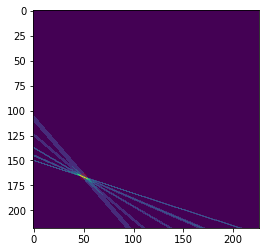

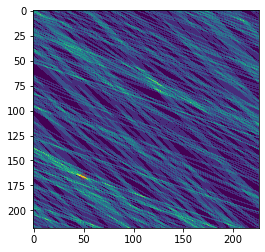

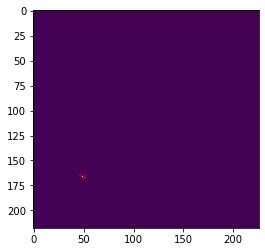

1 0


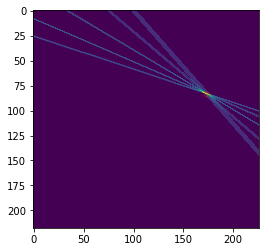

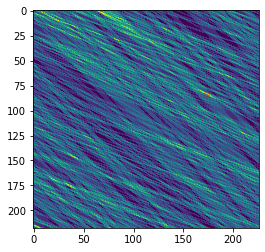

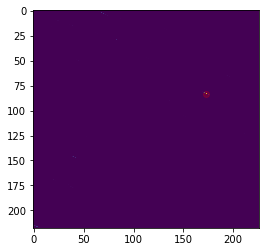

1 5


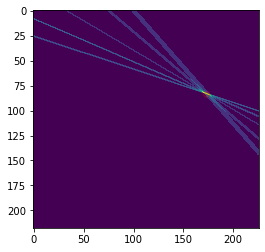

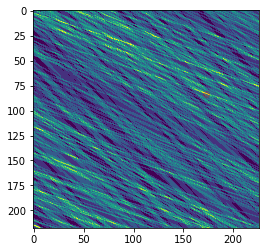

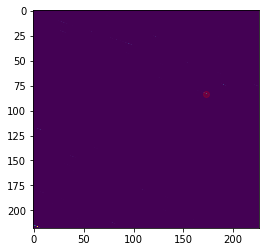

2 4


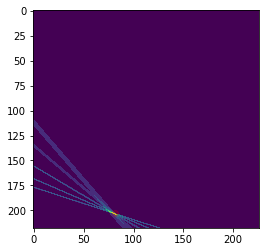

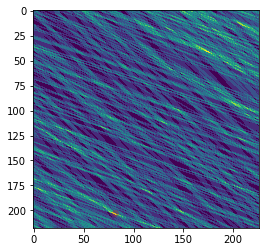

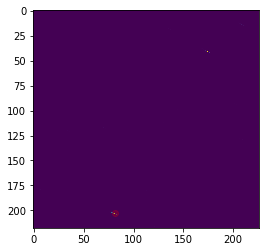

2 5


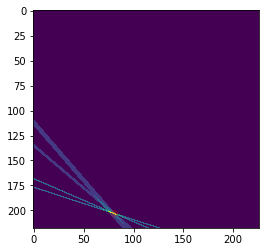

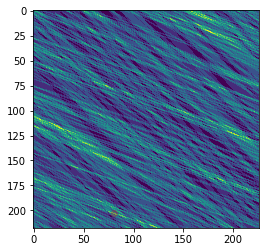

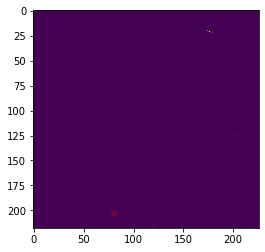

3 0


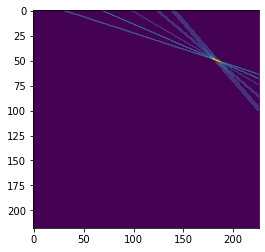

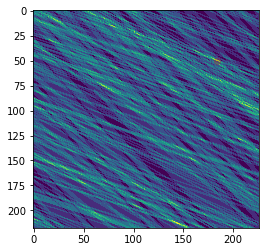

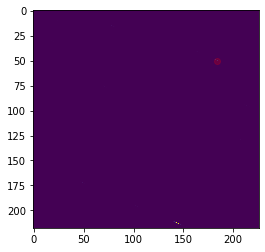

7 474
8 474
9 474
10 474
11 474
12 474
13 474
evaluating
0 0


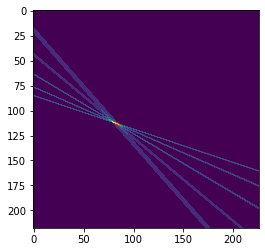

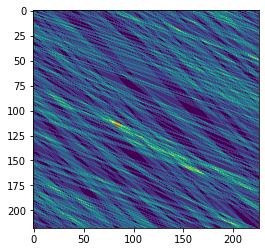

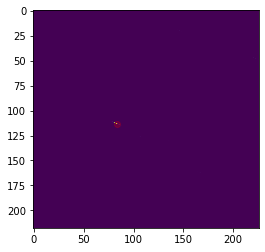

0 1


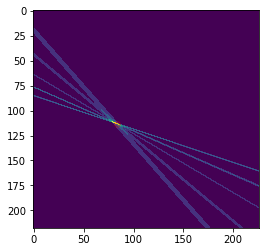

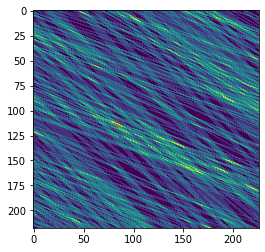

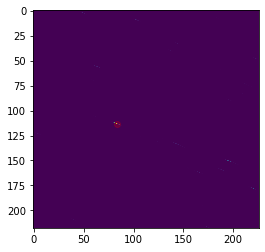

1 2


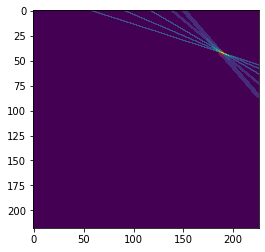

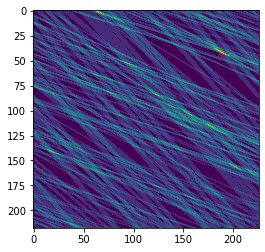

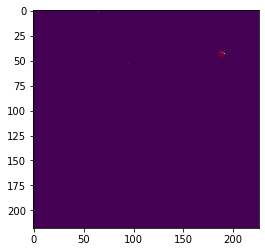

2 2


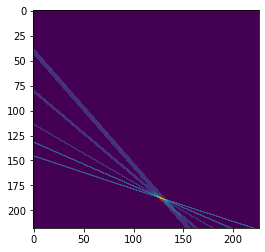

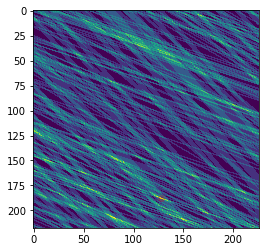

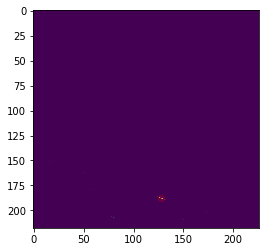

2 4


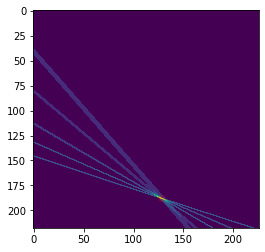

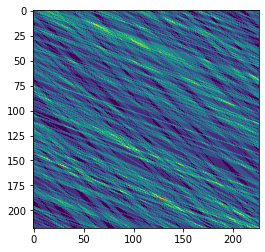

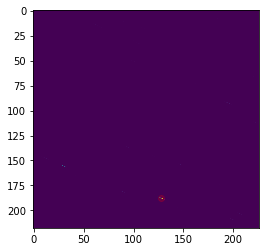

3 3


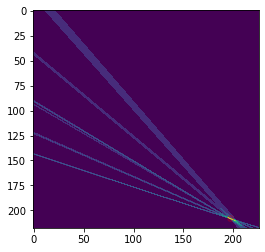

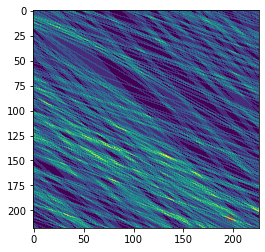

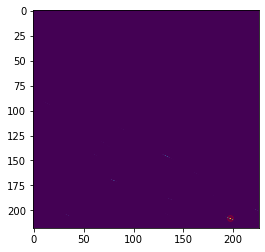

14 474
15 474
16 474
17 474
18 474
19 474
20 474
evaluating
1 2


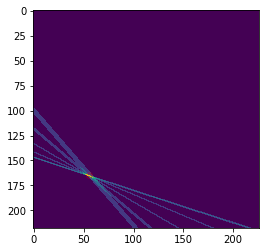

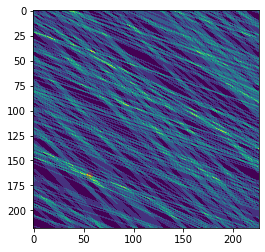

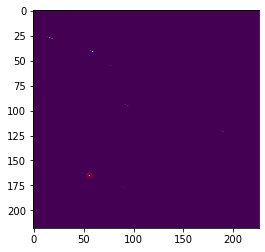

1 4


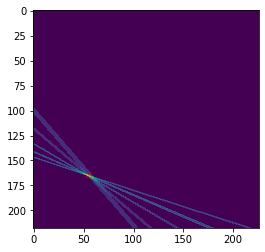

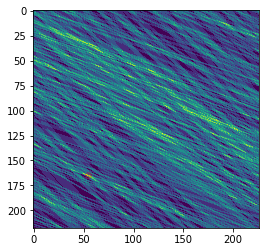

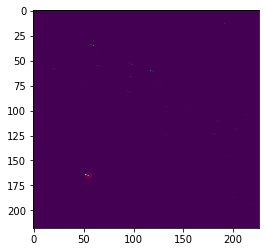

2 4


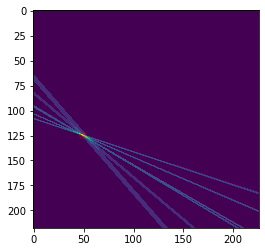

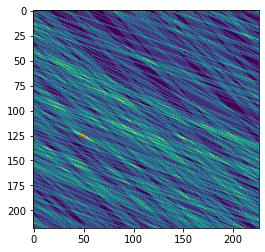

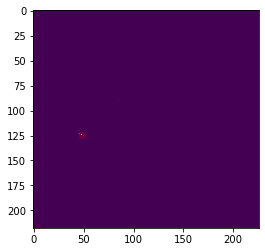

3 0


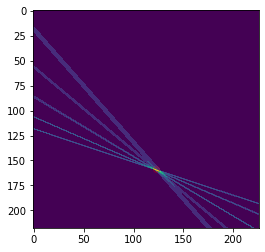

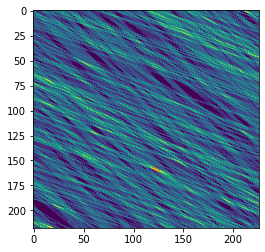

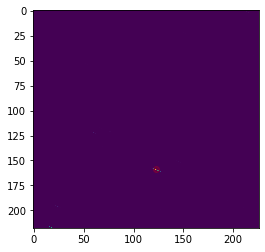

3 5


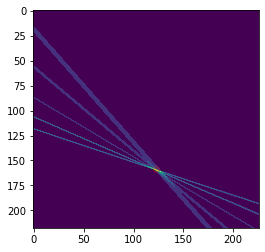

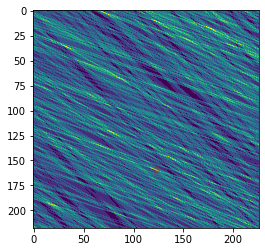

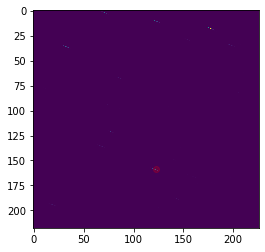

4 0


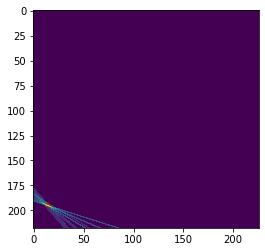

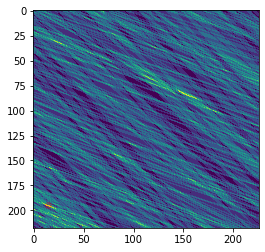

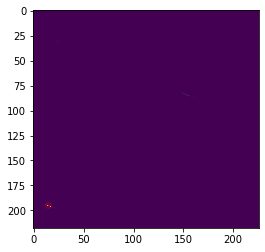

21 474
22 474
23 474
24 474
25 474
26 474
27 474
evaluating
0 0


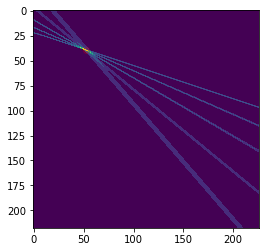

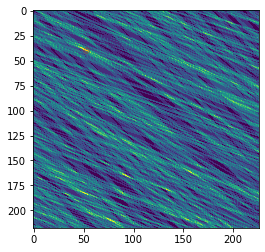

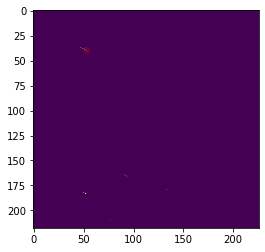

0 5


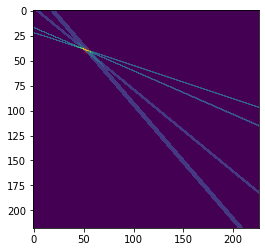

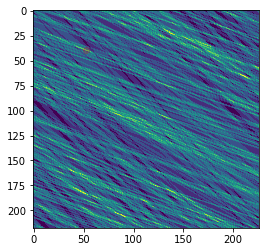

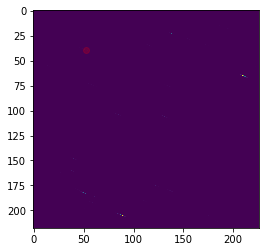

1 4


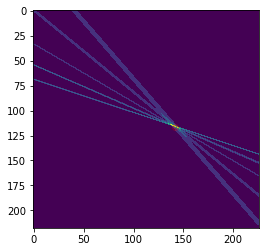

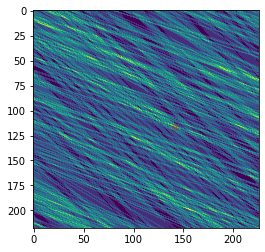

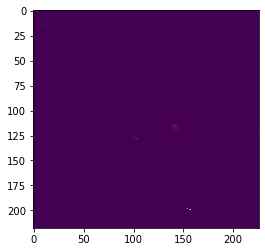

1 5


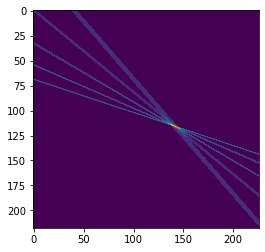

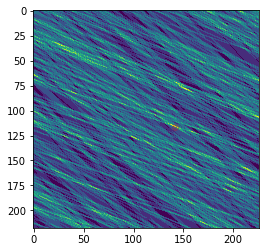

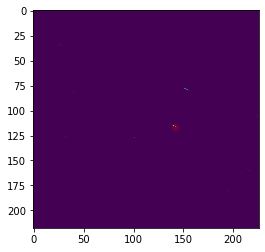

2 3


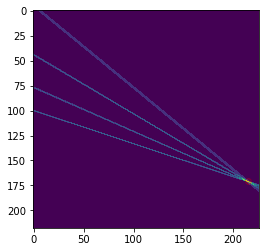

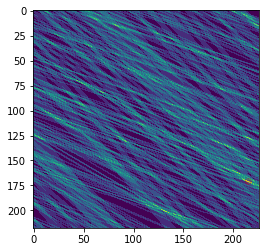

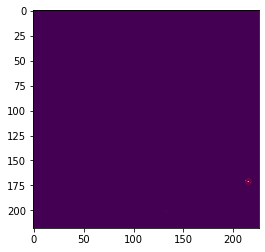

3 0


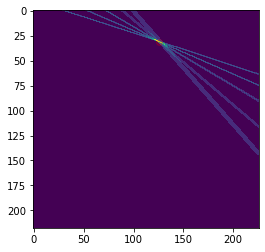

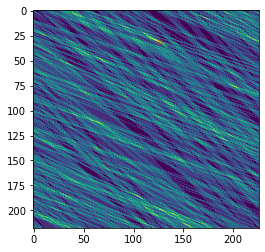

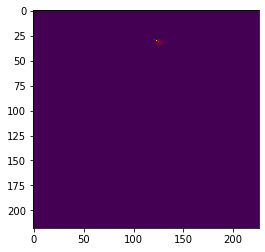

28 474
29 474
30 474
31 474
32 474
33 474
34 474
evaluating
0 4


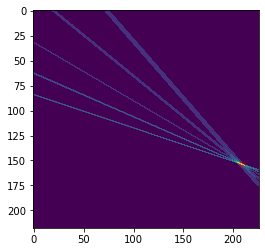

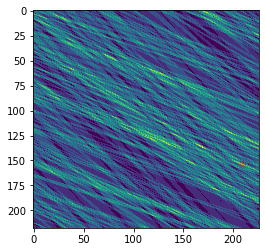

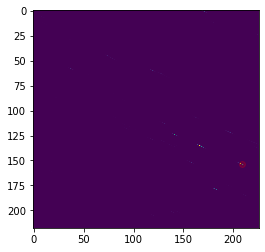

0 5


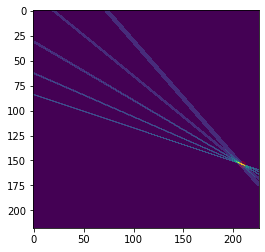

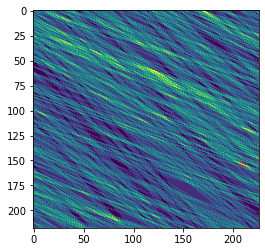

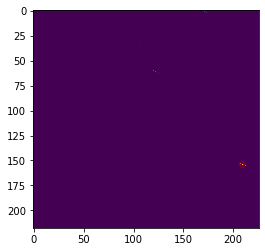

1 3


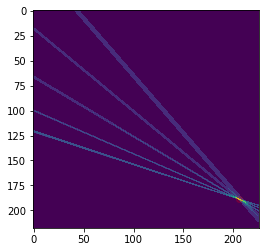

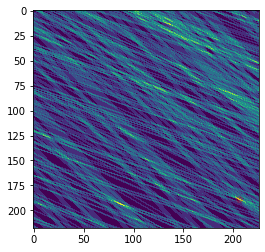

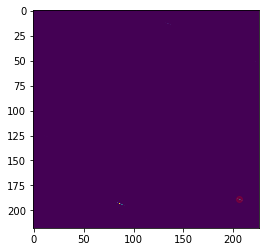

2 0


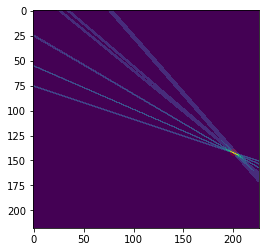

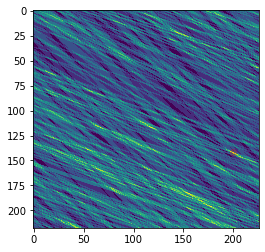

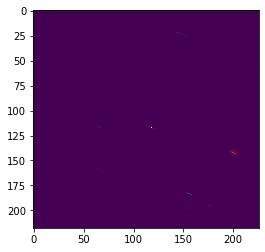

3 4


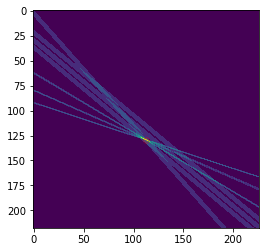

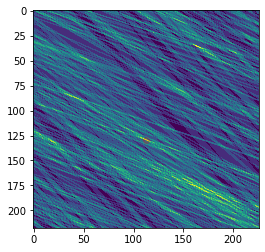

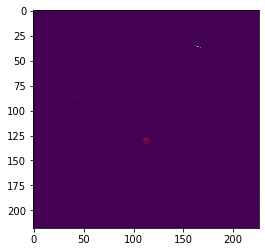

3 5


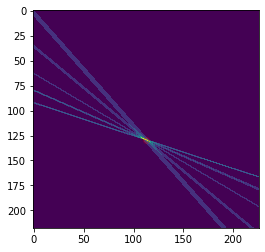

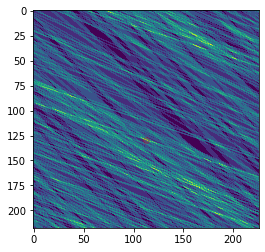

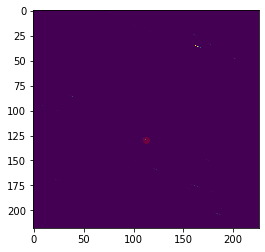

35 474
36 474
37 474
38 474
39 474
40 474
41 474
evaluating
0 0


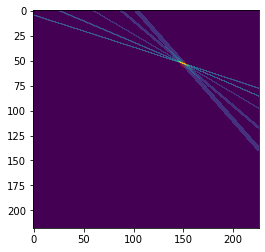

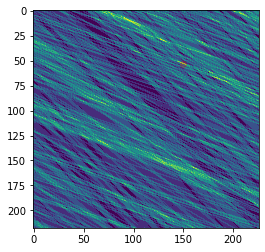

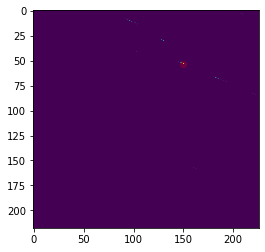

0 5


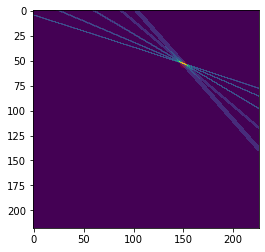

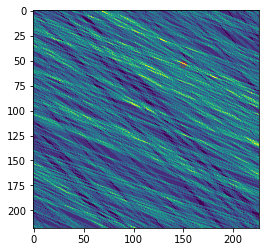

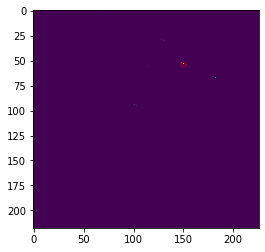

1 0


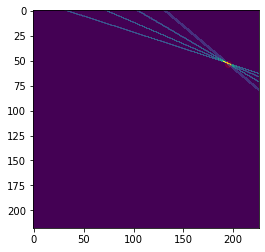

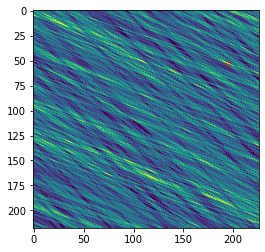

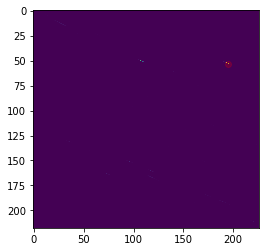

1 5


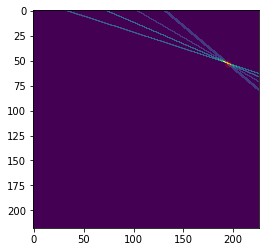

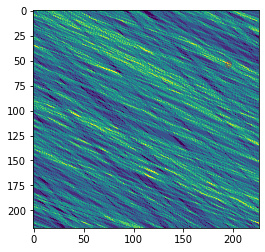

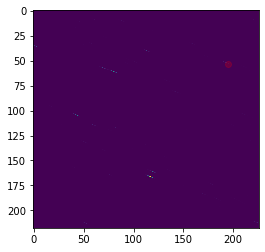

2 4


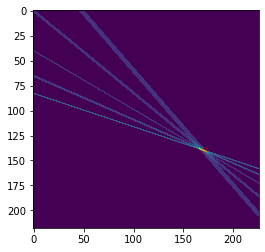

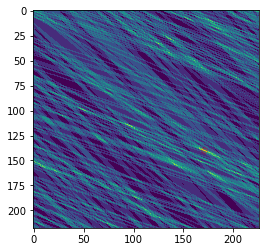

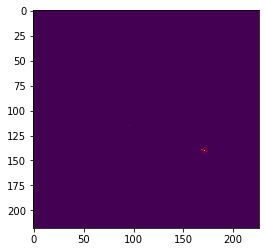

2 5


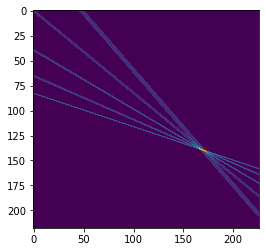

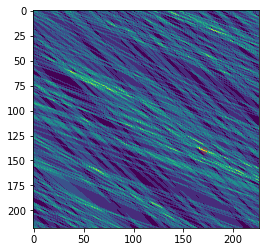

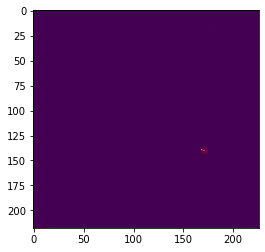

42 474
43 474
44 474
45 474
46 474
47 474
48 474
evaluating
0 3


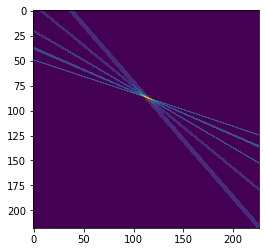

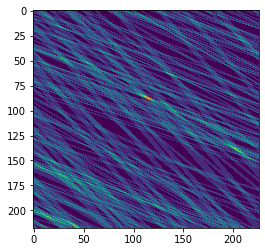

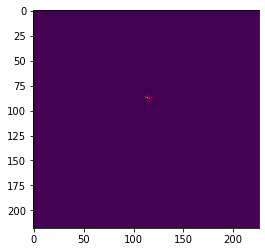

1 0


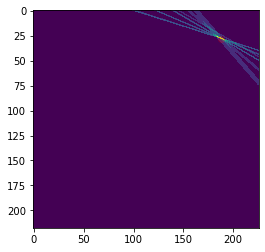

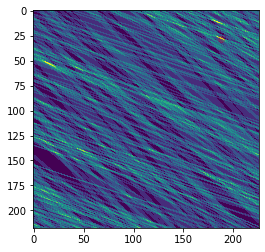

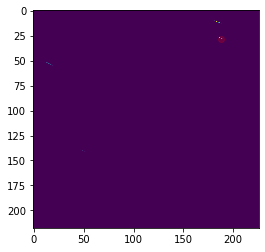

1 5


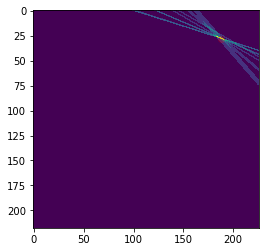

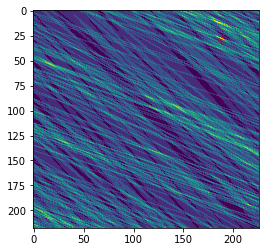

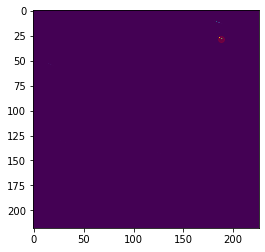

2 0


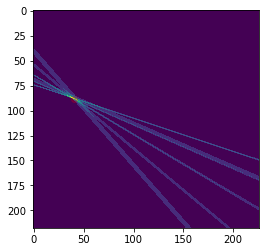

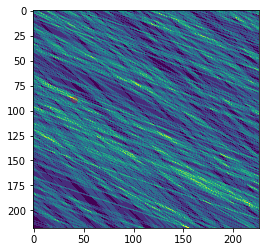

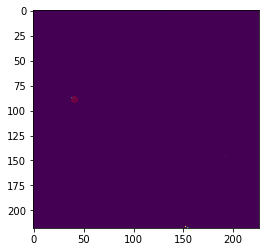

2 5


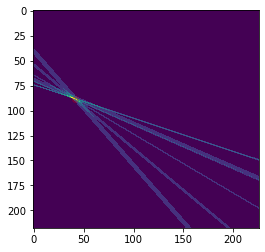

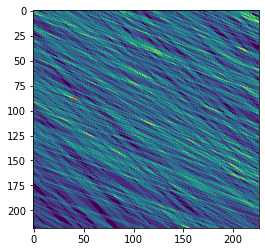

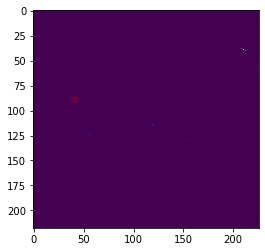

3 4


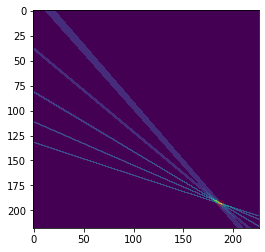

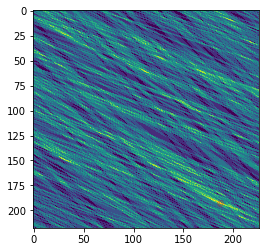

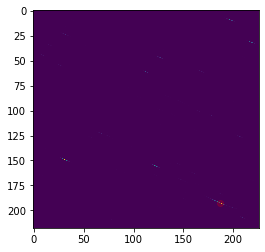

49 474
50 474
51 474
52 474
53 474
54 474
55 474
evaluating
0 0


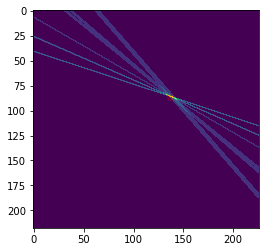

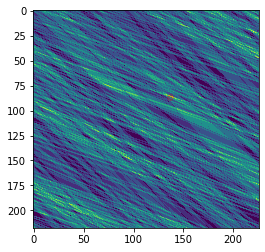

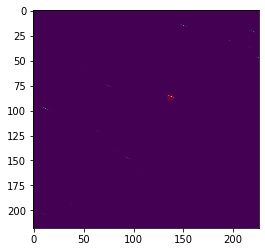

0 5


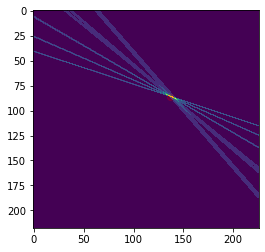

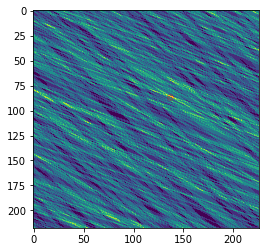

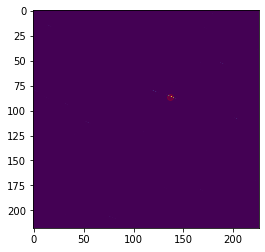

1 0


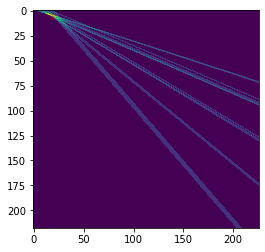

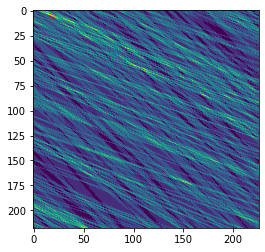

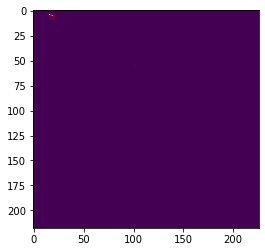

2 0


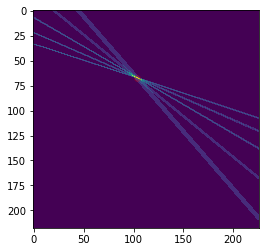

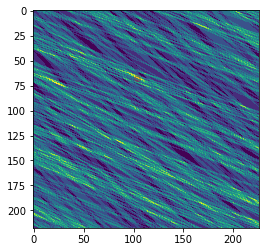

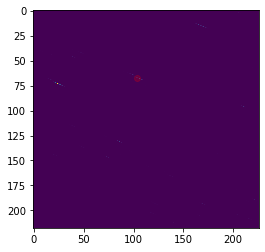

2 1


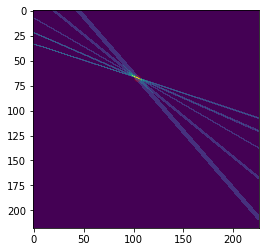

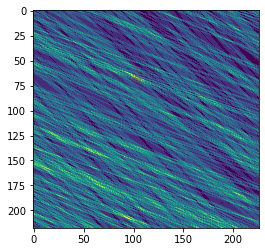

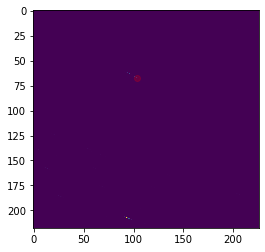

3 0


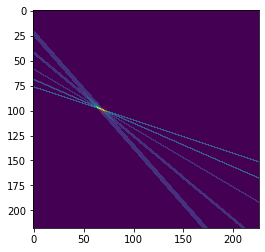

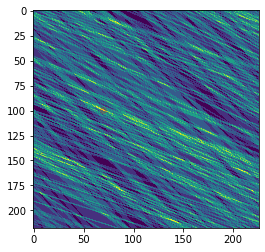

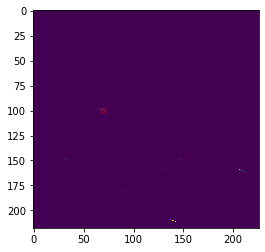

56 474
57 474
58 474
59 474
60 474
61 474
62 474
evaluating
0 0


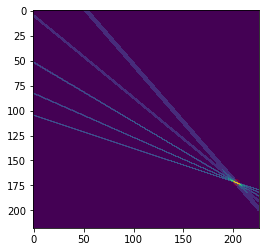

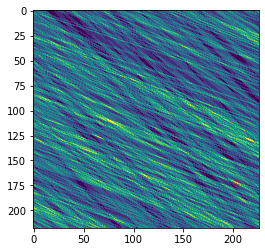

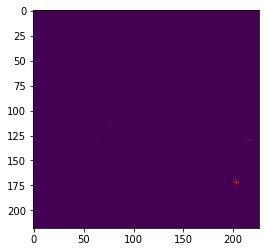

0 1


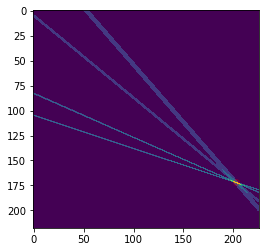

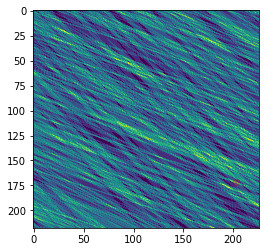

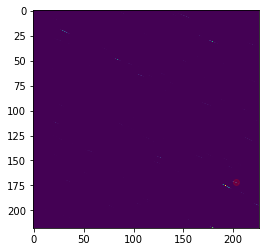

1 1


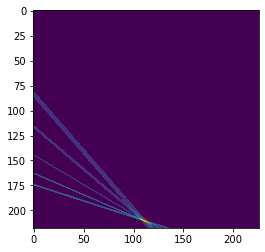

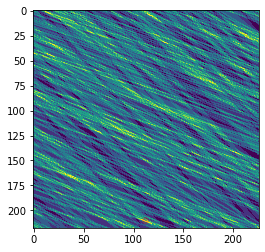

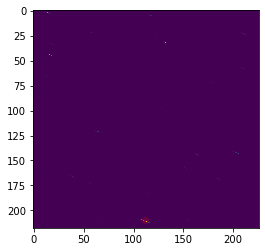

1 3


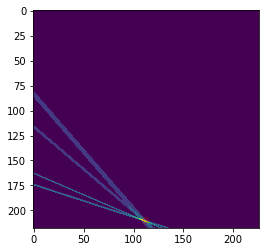

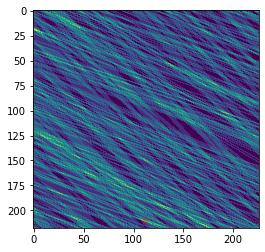

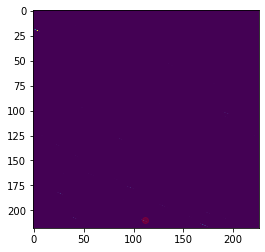

2 1


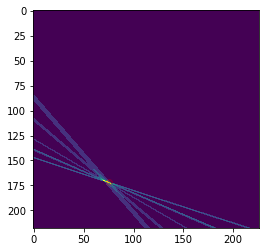

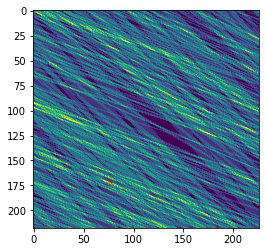

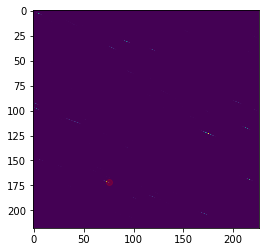

2 3


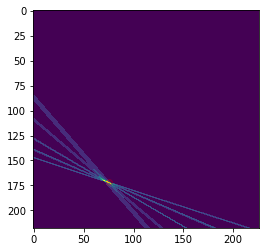

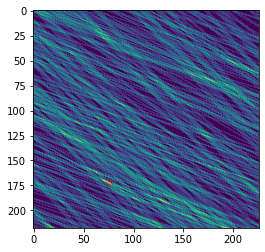

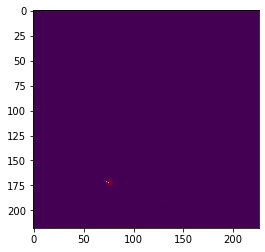

63 474
64 474
65 474
66 474
67 474
68 474
69 474
evaluating
0 0


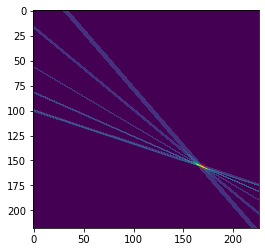

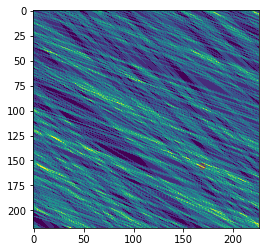

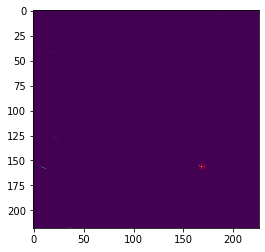

0 5


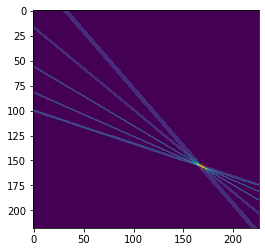

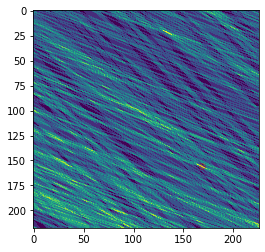

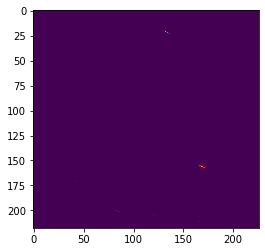

1 0


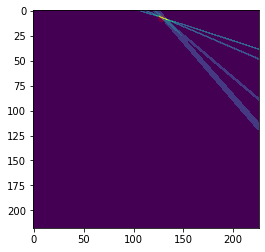

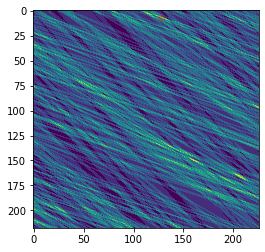

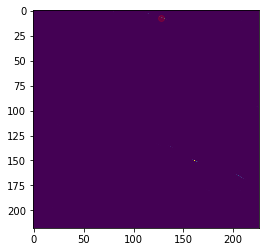

1 1


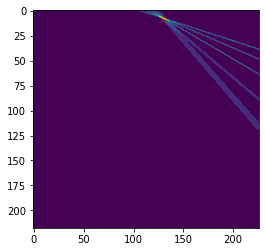

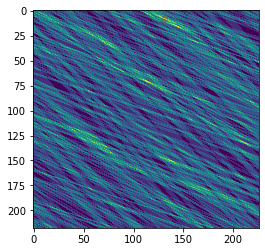

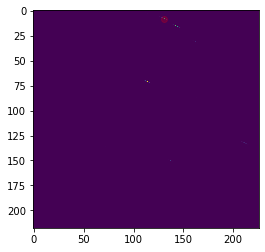

2 0


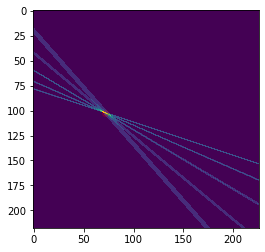

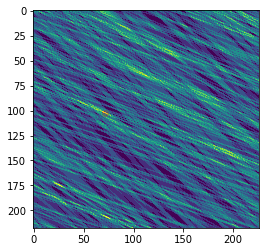

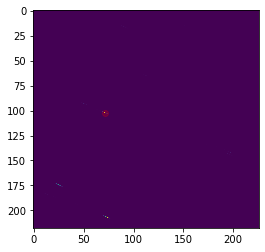

2 1


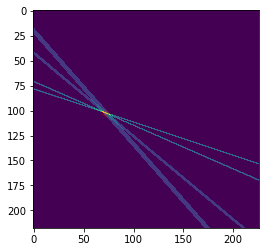

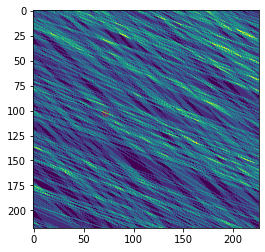

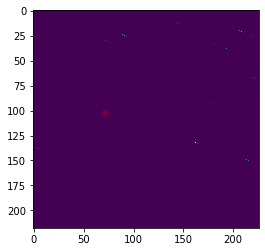

70 474
71 474
72 474
73 474
74 474
75 474
76 474
evaluating
0 4


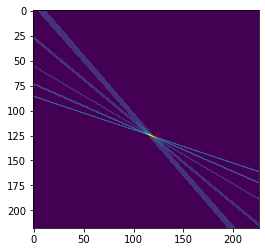

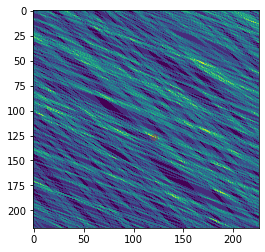

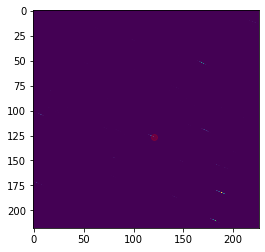

0 5


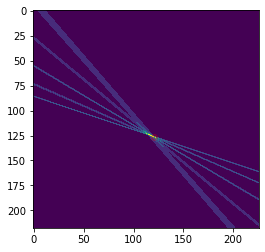

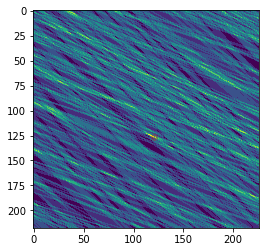

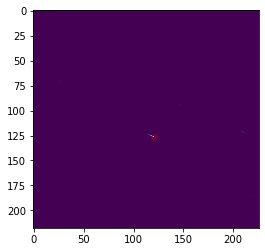

1 1


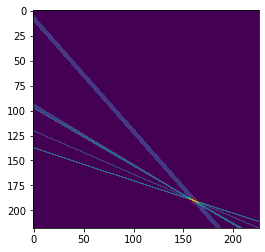

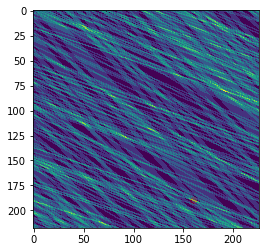

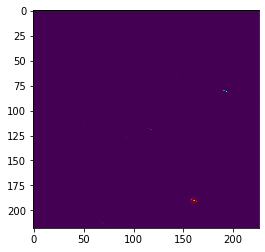

2 4


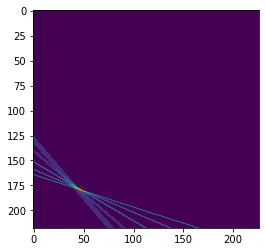

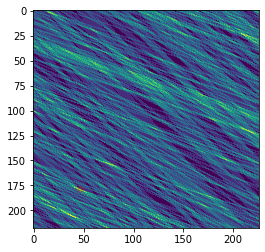

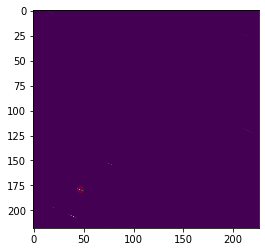

2 5


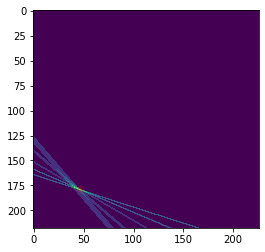

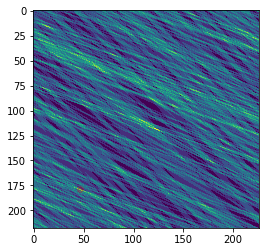

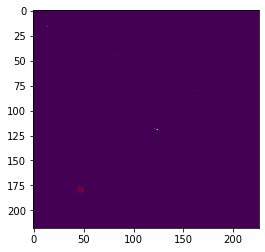

3 0


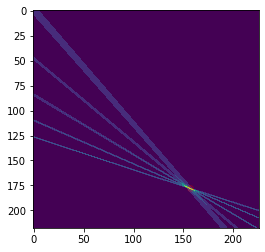

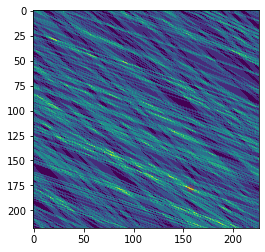

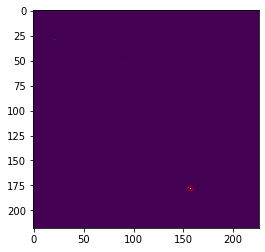

77 474
78 474
79 474
80 474
81 474
82 474
83 474
evaluating
0 4


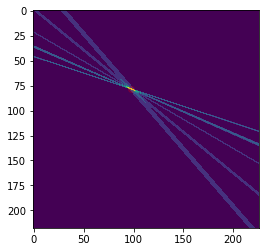

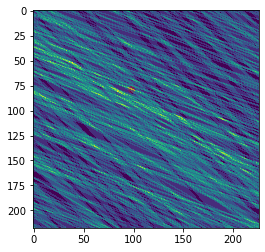

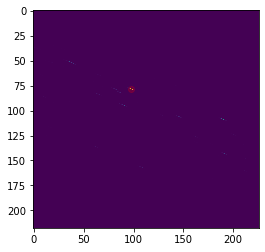

0 5


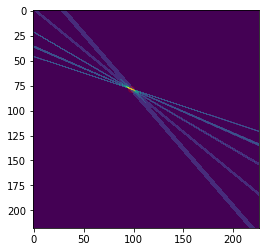

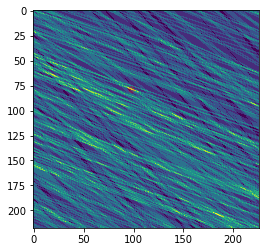

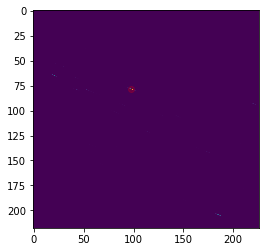

1 4


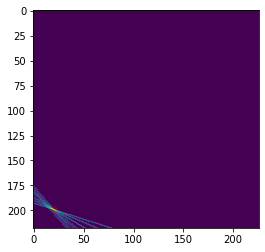

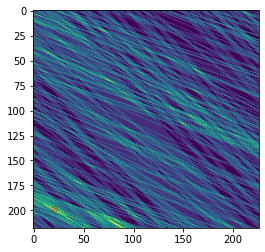

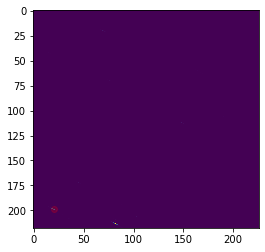

1 5


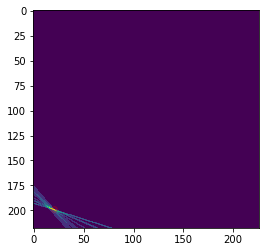

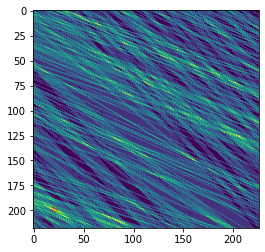

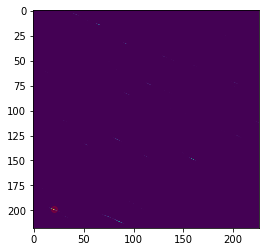

2 1


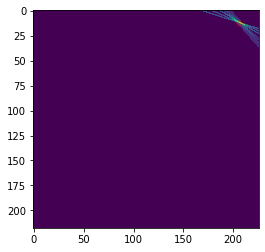

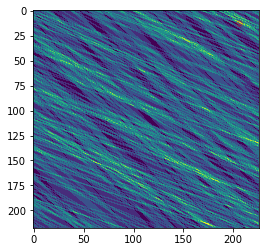

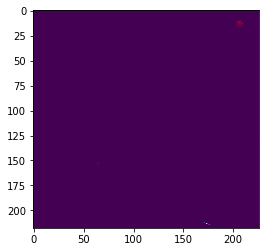

3 2


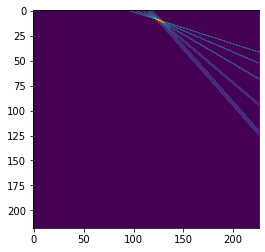

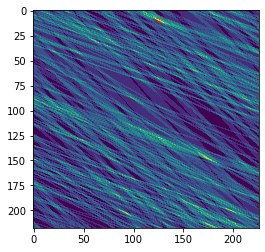

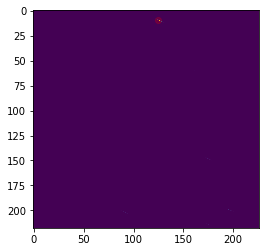

84 474
85 474
86 474
87 474
88 474
89 474
90 474
evaluating
0 2


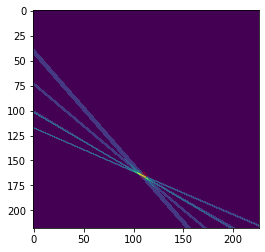

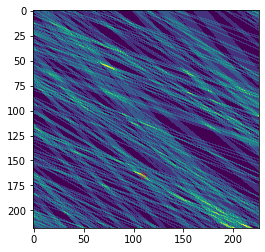

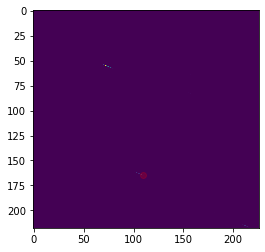

0 4


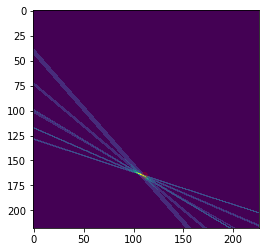

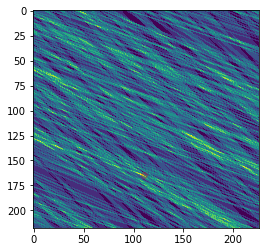

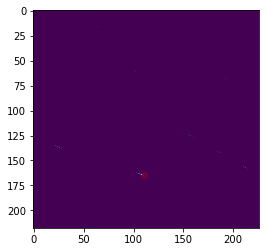

1 2


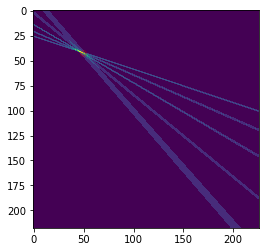

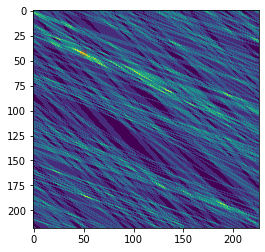

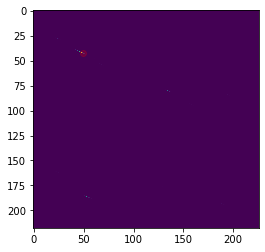

2 4


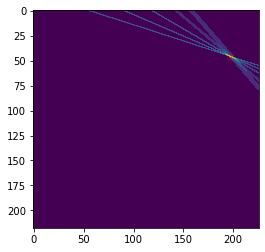

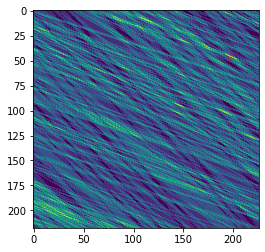

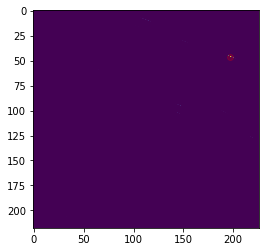

2 5


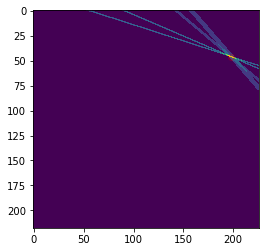

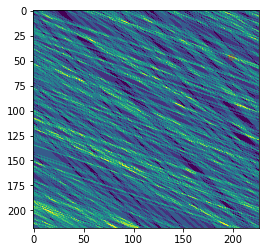

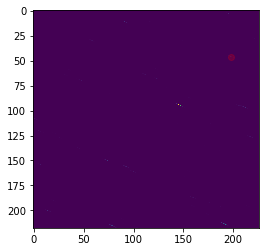

3 0


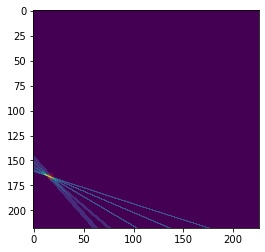

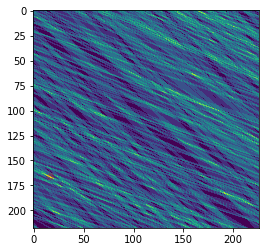

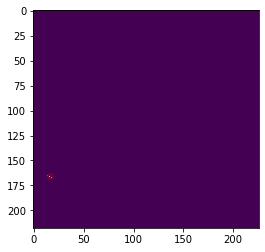

91 474
92 474
93 474
94 474
95 474
96 474
97 474
evaluating
0 0


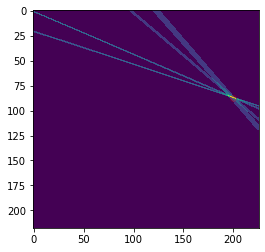

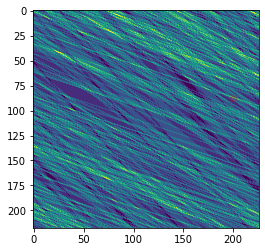

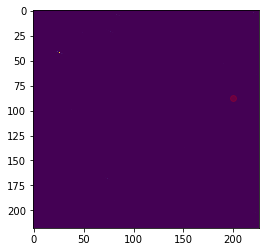

0 1


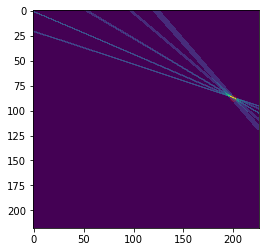

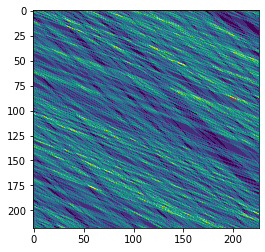

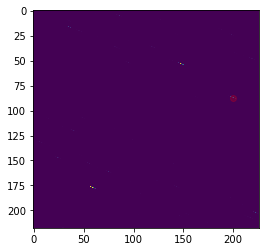

1 0


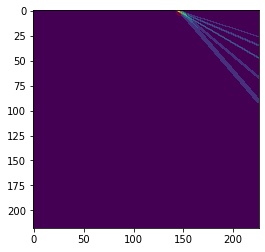

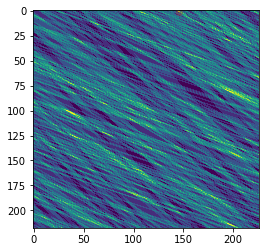

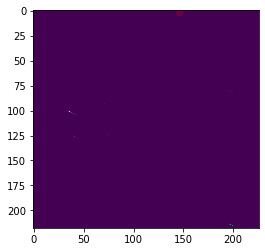

1 5


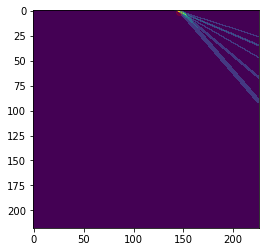

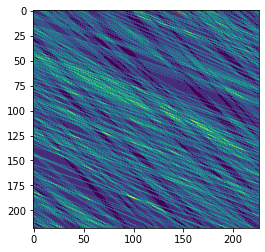

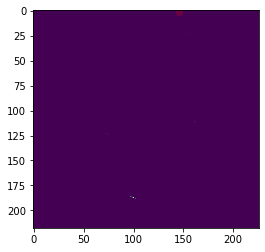

2 0


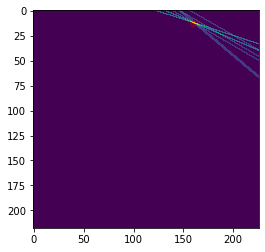

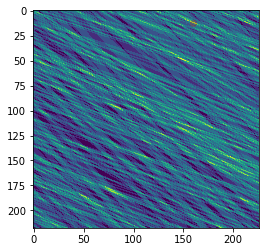

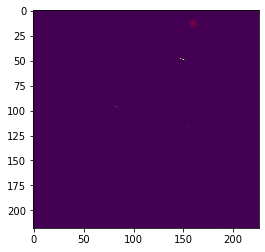

2 1


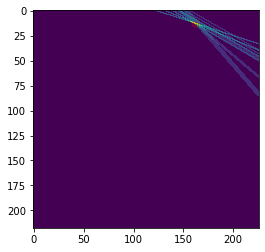

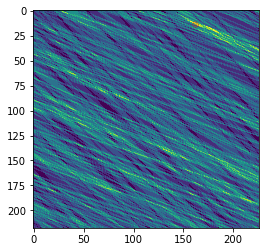

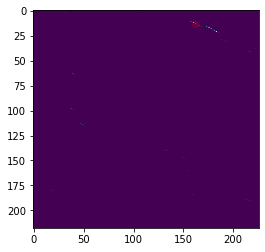

98 474
99 474
100 474
101 474
102 474
103 474
104 474
evaluating
0 4


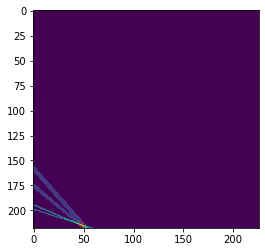

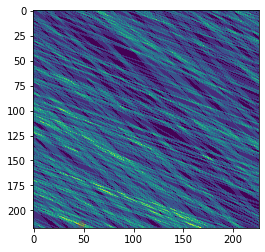

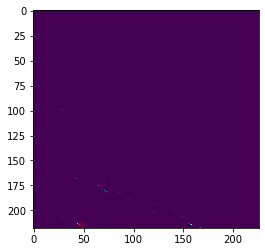

0 5


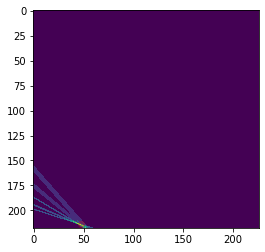

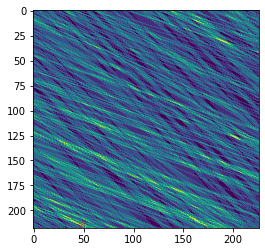

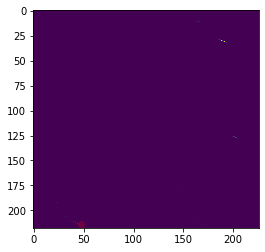

1 4


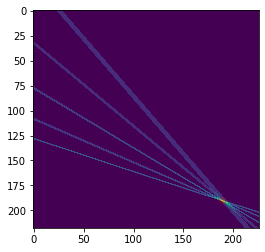

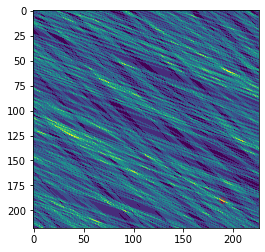

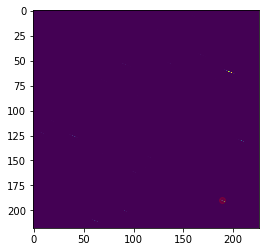

2 0


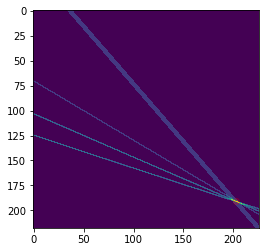

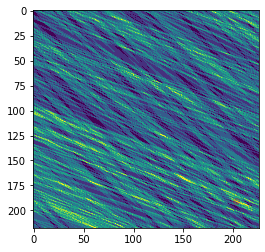

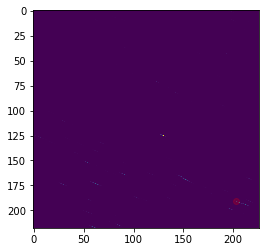

2 5


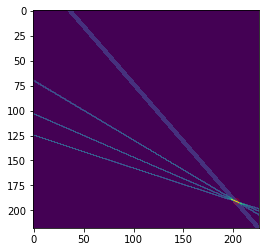

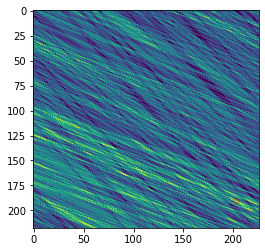

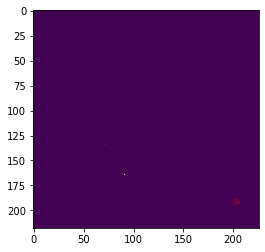

3 4


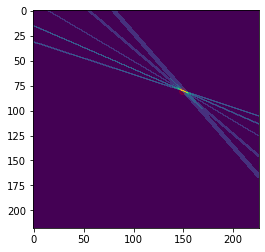

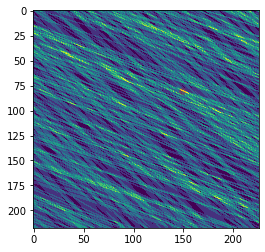

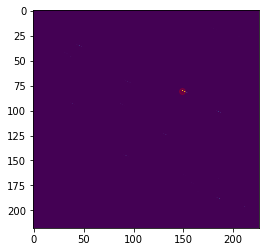

105 474
106 474
107 474
108 474
109 474
110 474
111 474
evaluating
0 0


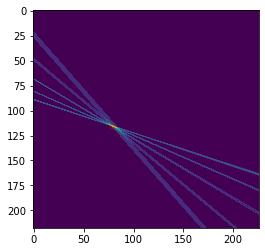

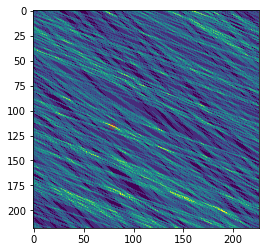

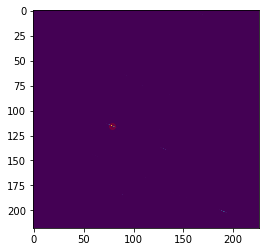

0 1


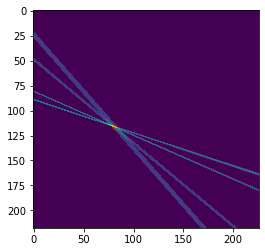

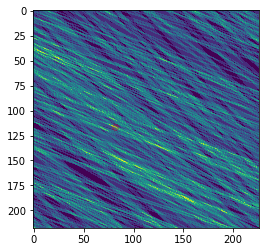

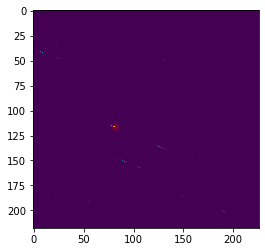

1 0


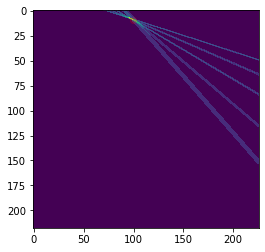

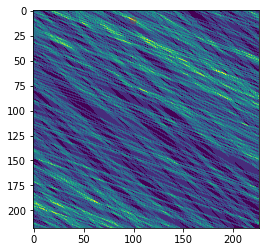

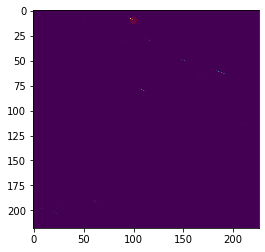

1 5


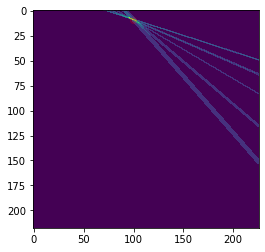

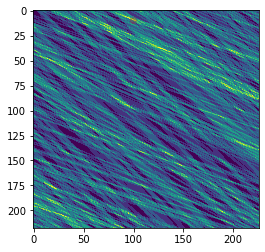

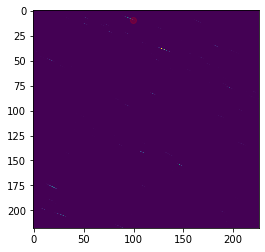

2 1


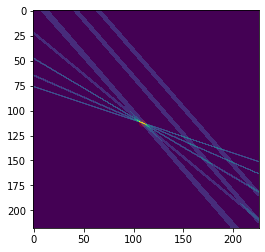

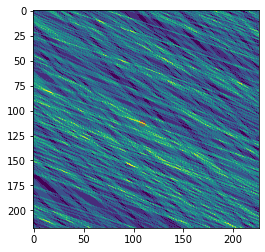

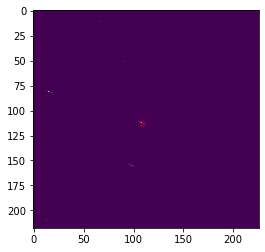

3 1


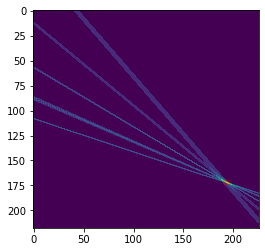

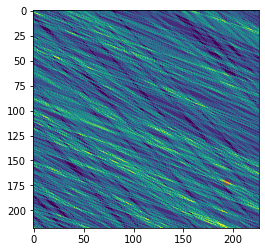

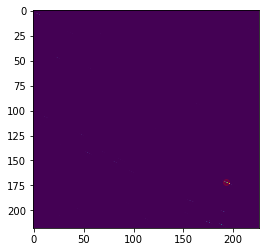

112 474
113 474
114 474
115 474
116 474
117 474
118 474
evaluating
0 3


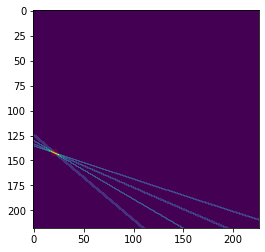

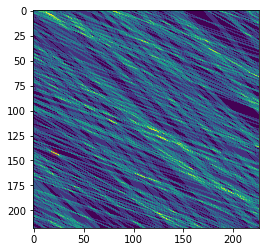

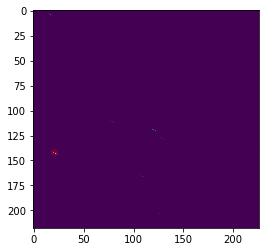

1 4


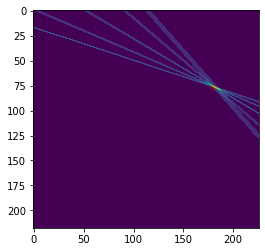

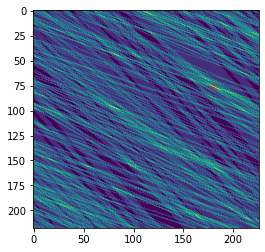

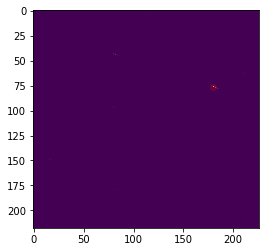

2 4


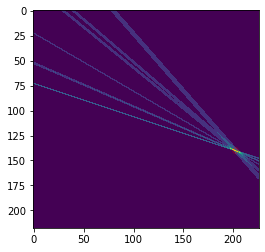

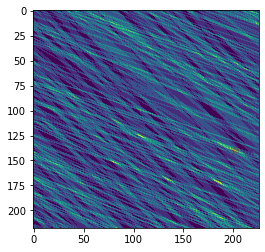

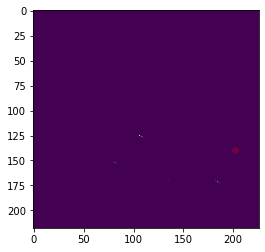

2 5


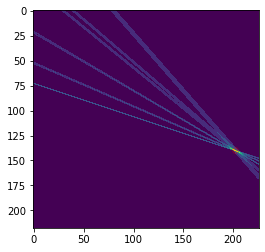

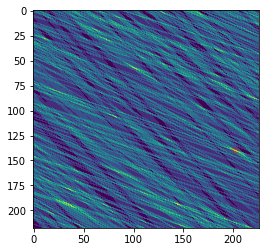

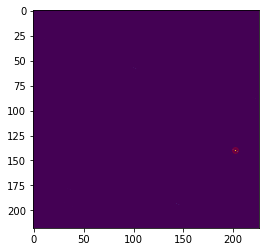

3 5


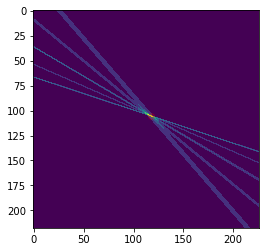

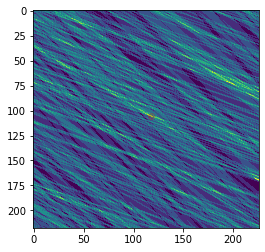

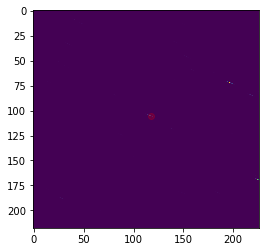

4 0


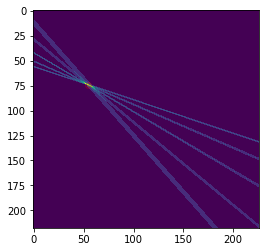

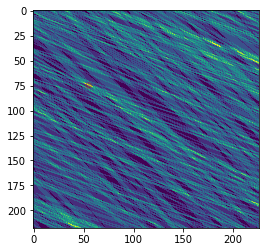

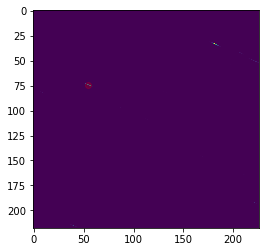

119 474
120 474
121 474
122 474
123 474
124 474
125 474
evaluating
0 0


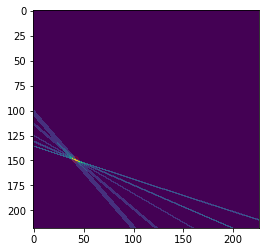

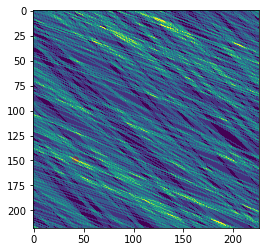

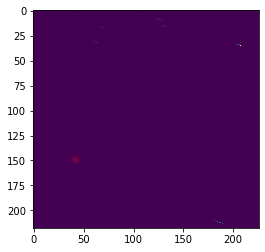

0 5


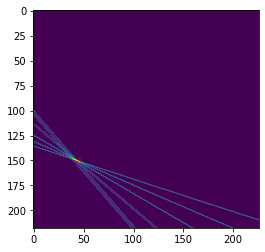

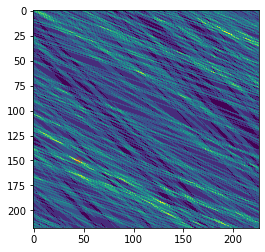

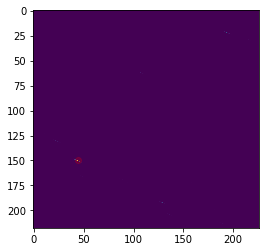

1 0


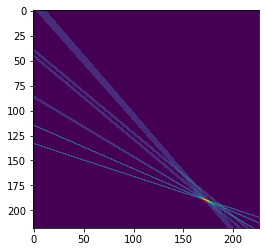

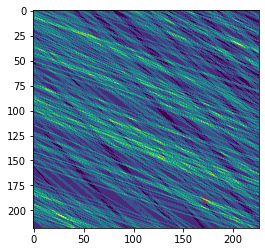

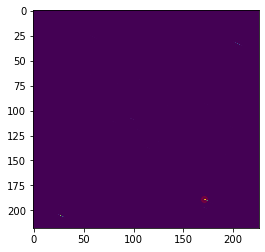

1 5


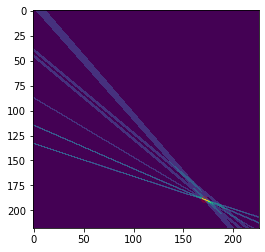

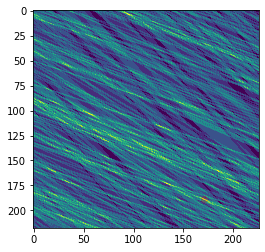

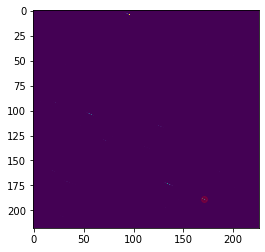

2 4


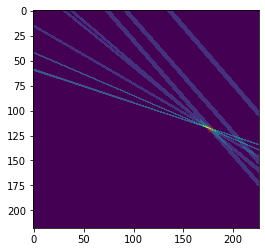

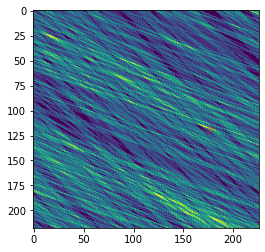

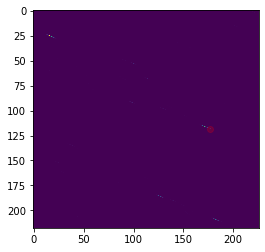

2 5


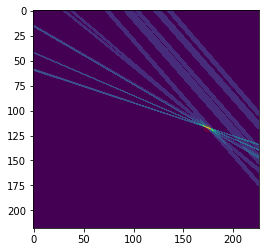

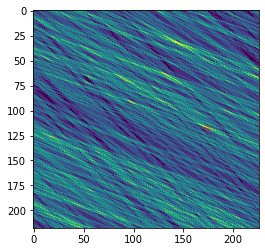

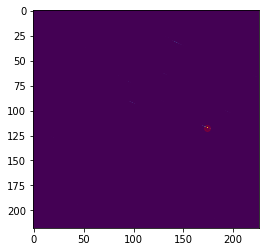

126 474
127 474
128 474
129 474
130 474
131 474
132 474
evaluating
0 1


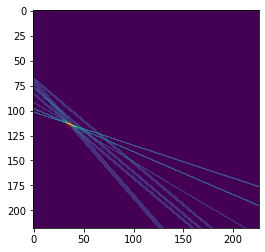

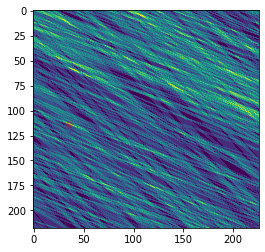

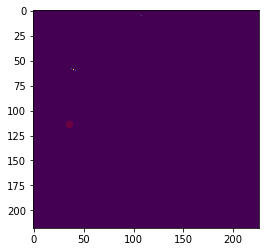

0 3


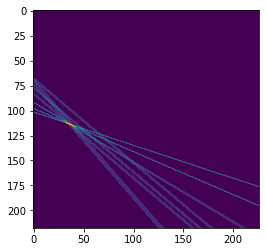

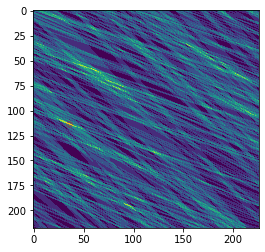

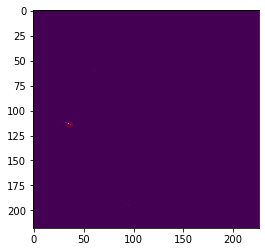

1 0


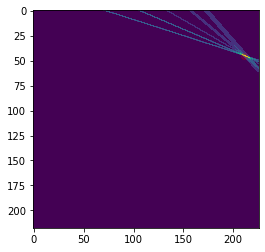

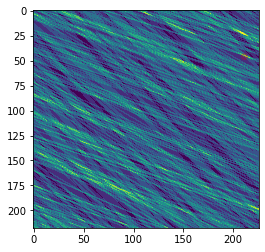

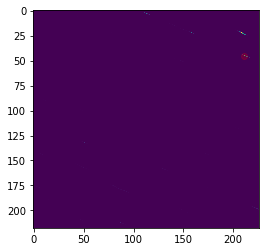

1 5


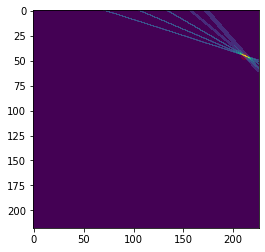

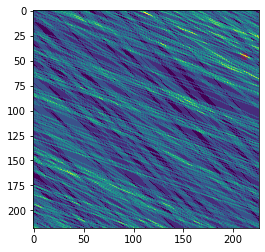

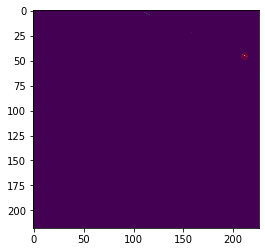

2 4


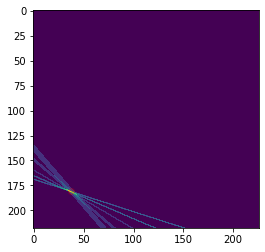

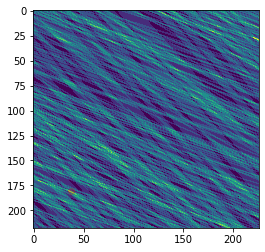

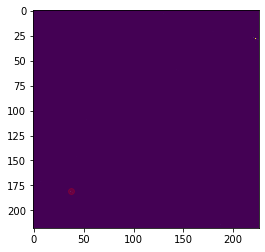

2 5


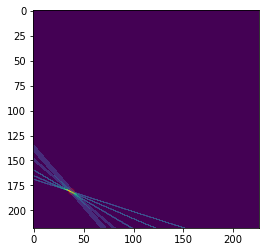

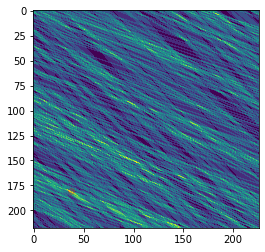

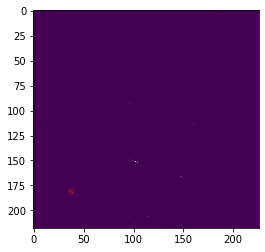

133 474
134 474
135 474
136 474
137 474
138 474
139 474
evaluating
0 0


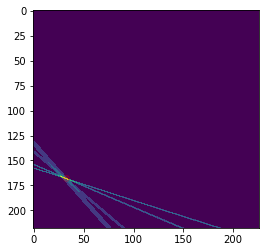

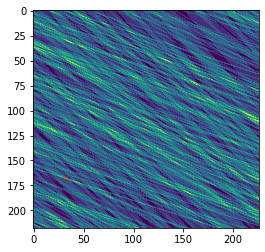

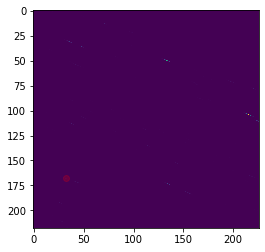

0 1


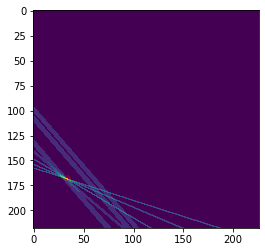

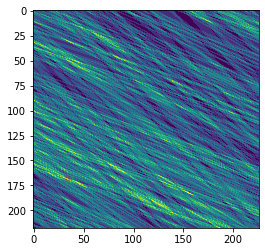

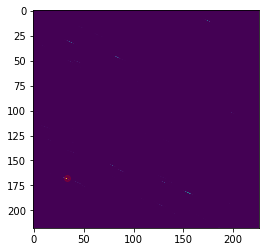

1 4


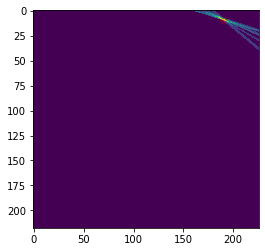

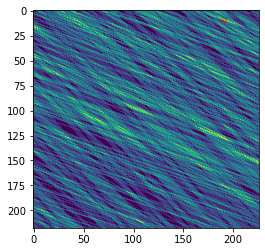

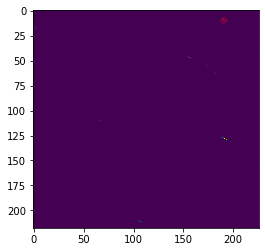

1 5


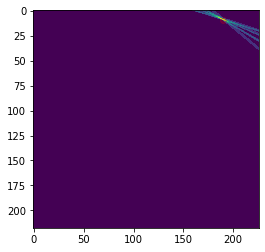

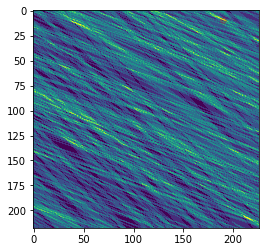

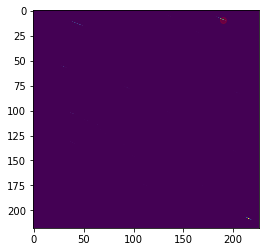

2 0


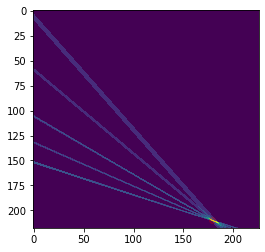

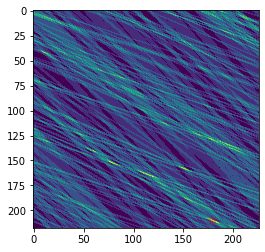

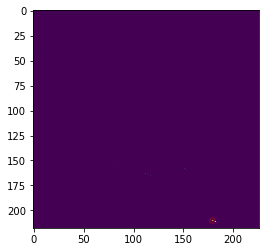

2 1


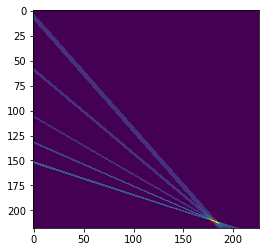

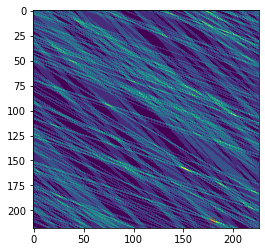

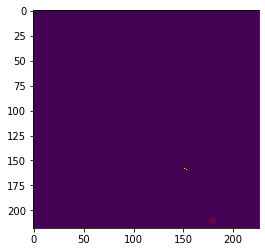

140 474
141 474
142 474
143 474
144 474
145 474
146 474
evaluating
0 0


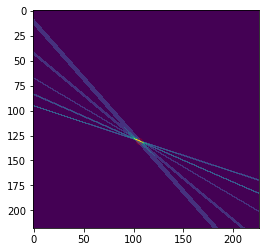

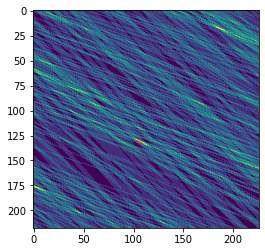

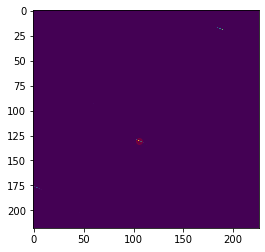

0 5


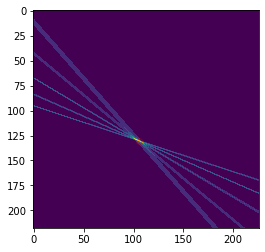

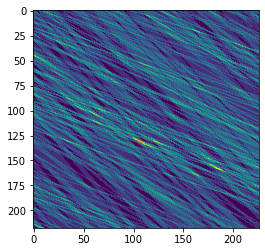

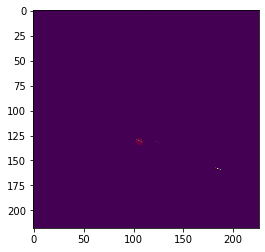

1 0


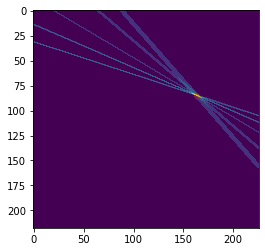

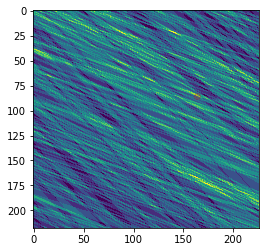

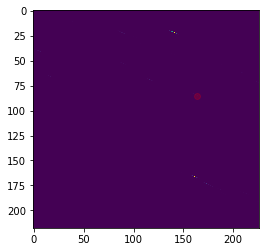

1 5


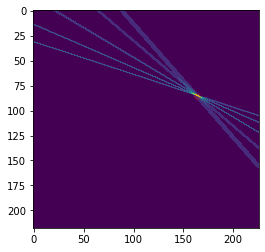

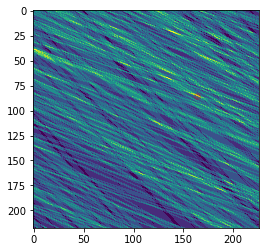

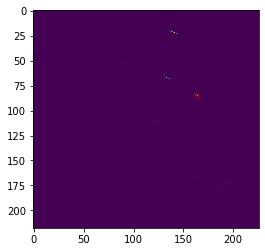

2 0


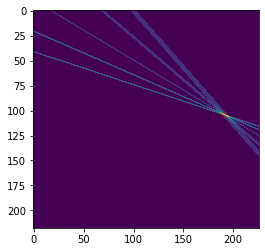

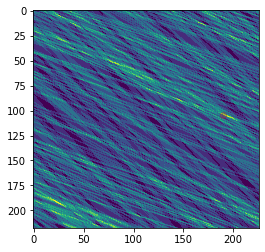

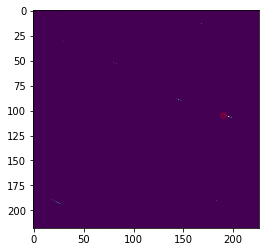

2 5


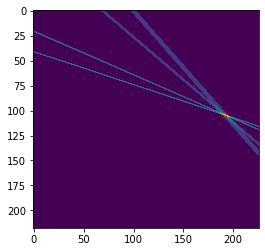

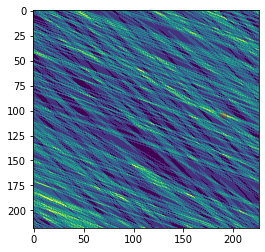

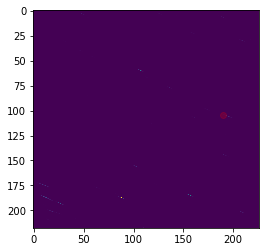

147 474
148 474
149 474
150 474
151 474
152 474
153 474
evaluating
0 0


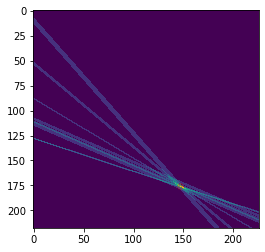

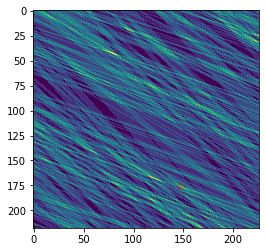

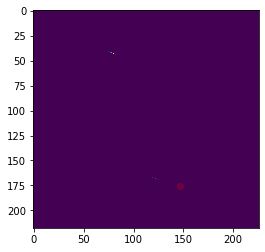

0 1


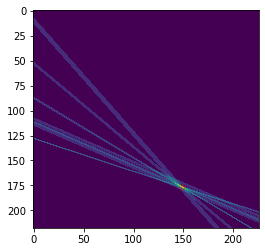

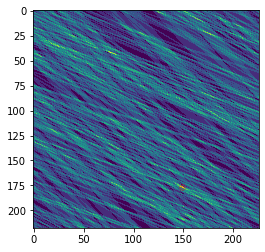

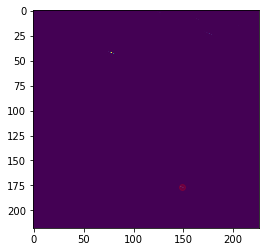

1 1


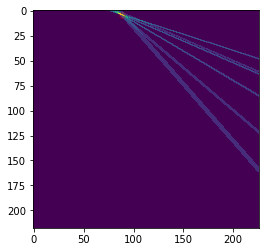

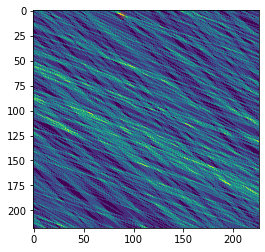

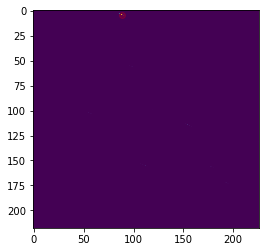

1 3


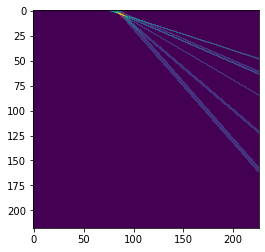

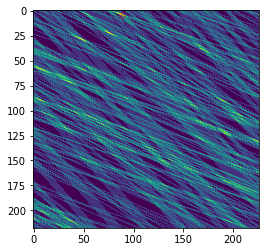

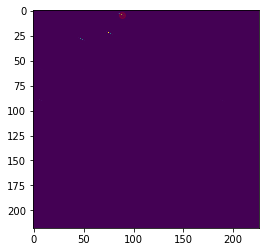

2 3


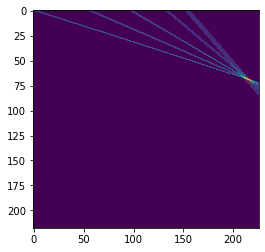

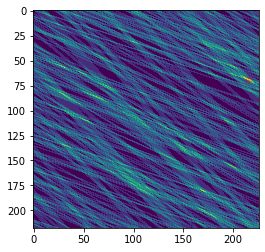

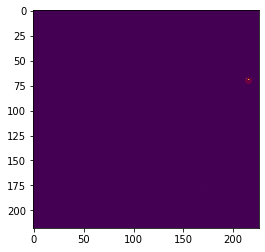

3 0


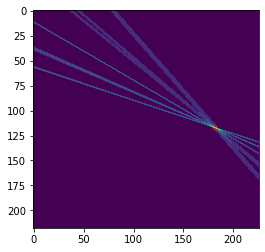

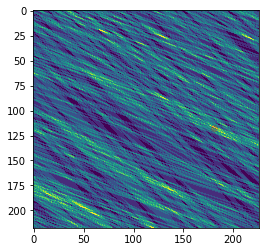

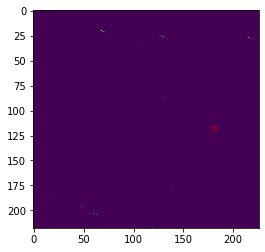

154 474
155 474
156 474
157 474
158 474
159 474
160 474
evaluating
0 0


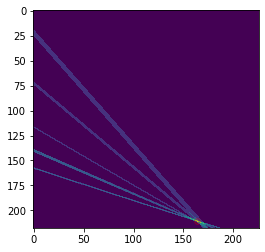

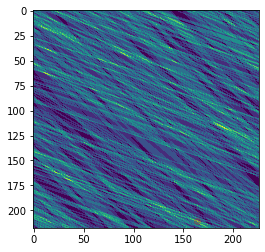

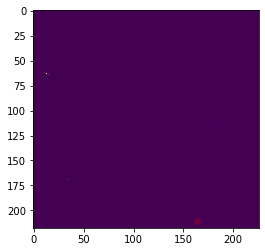

0 1


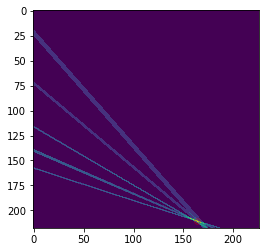

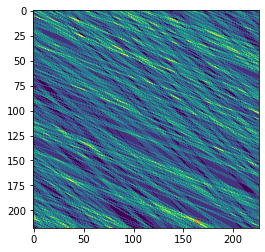

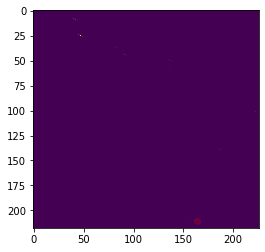

1 0


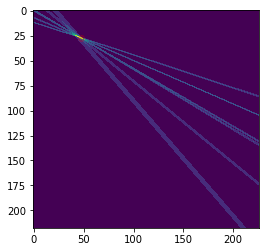

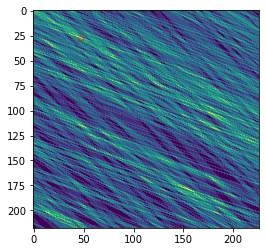

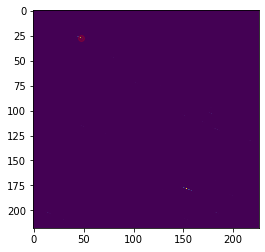

2 1


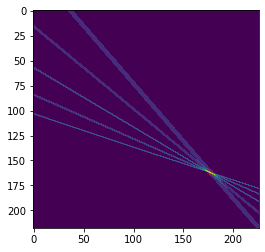

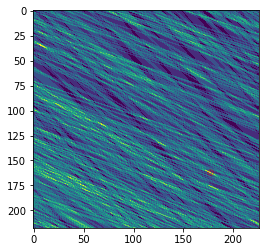

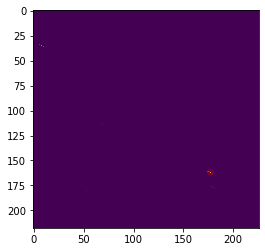

3 0


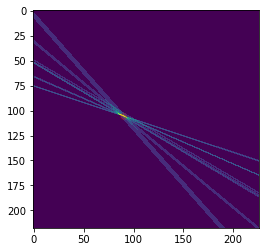

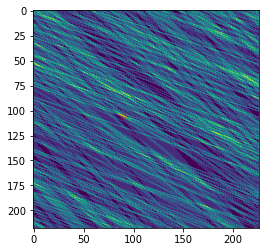

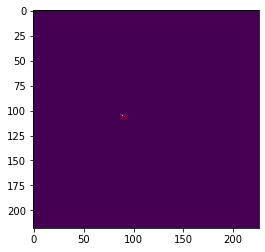

4 5


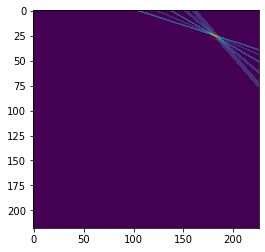

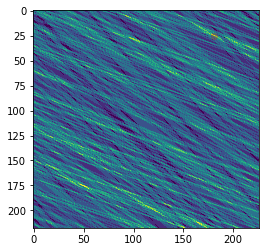

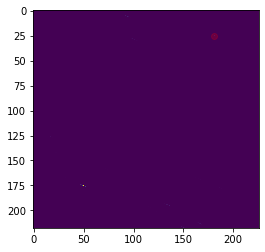

161 474
162 474
163 474
164 474
165 474
166 474
167 474
evaluating
0 0


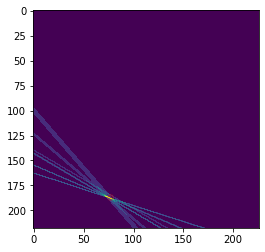

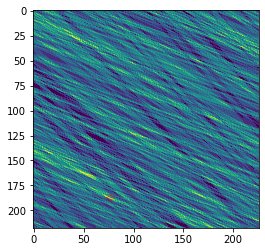

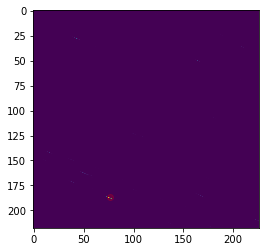

0 5


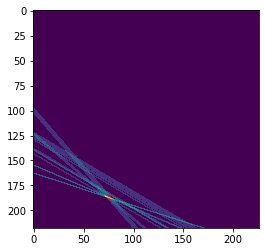

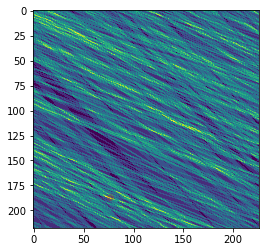

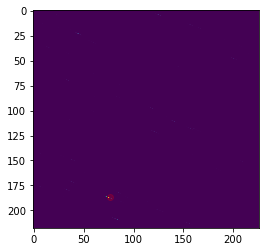

1 0


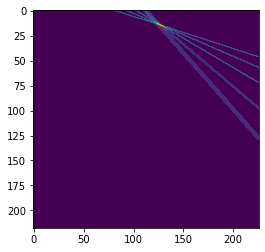

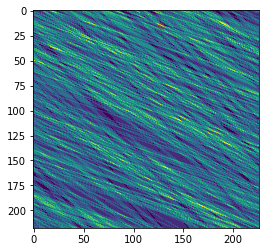

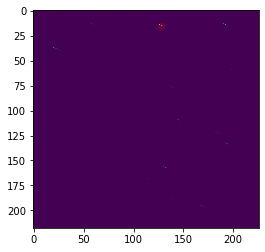

2 0


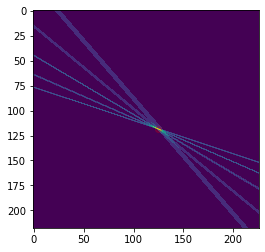

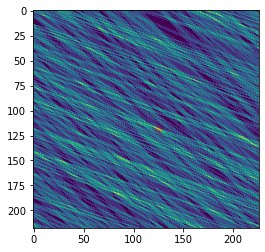

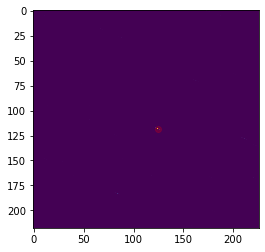

2 5


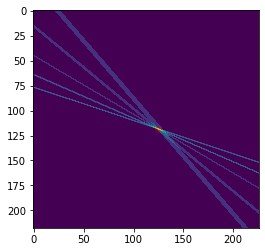

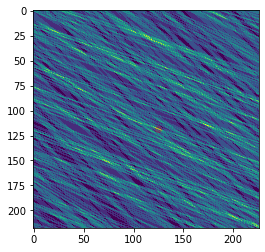

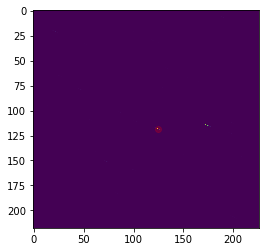

3 4


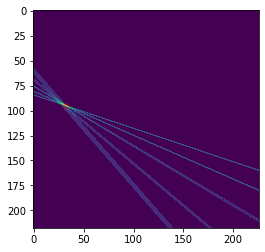

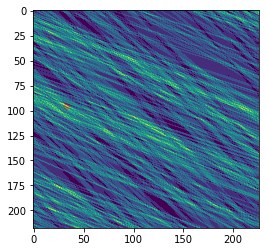

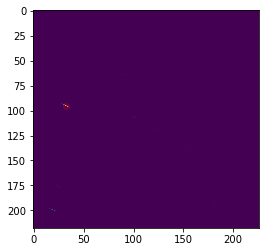

168 474
169 474
170 474
171 474
172 474
173 474
174 474
evaluating
0 5


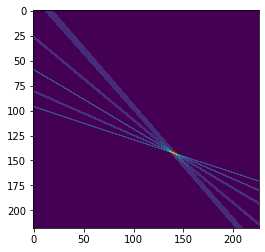

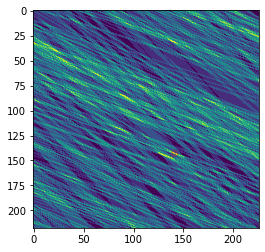

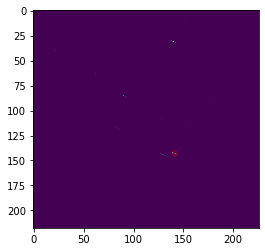

1 1


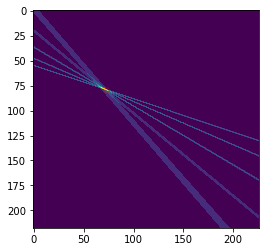

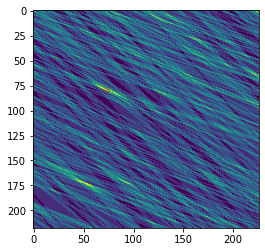

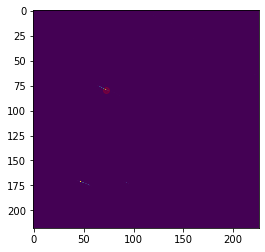

1 3


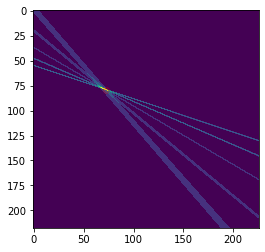

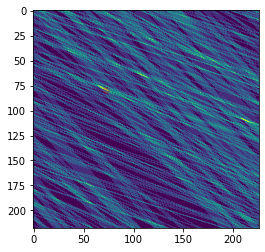

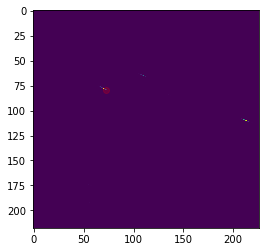

2 0


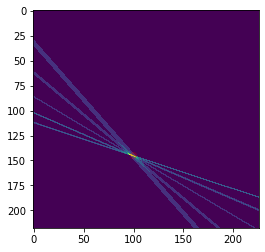

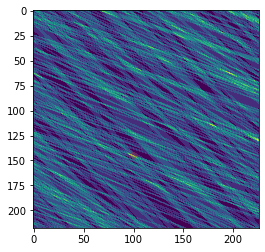

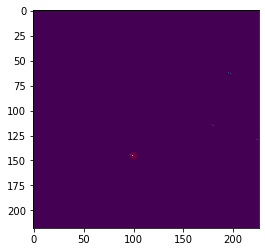

2 1


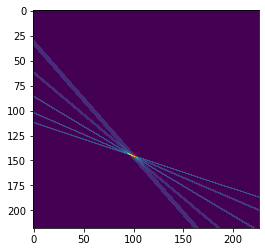

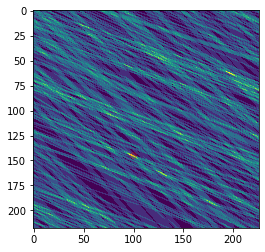

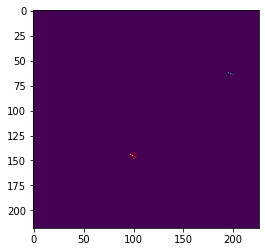

3 2


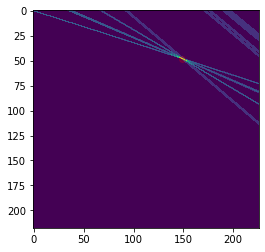

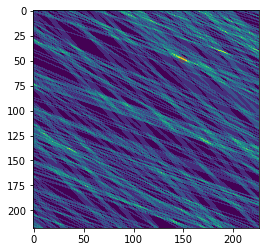

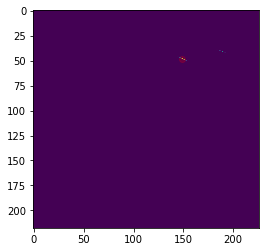

175 474
176 474
177 474
178 474
179 474
180 474
181 474
evaluating
0 1


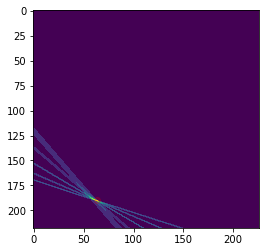

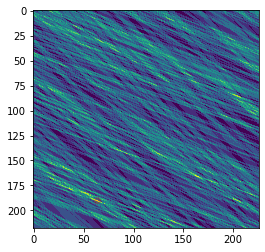

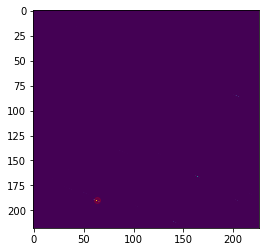

1 2


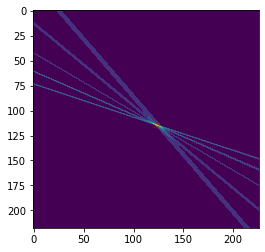

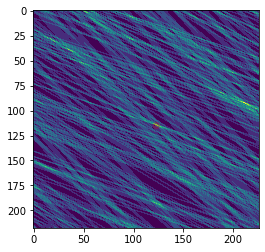

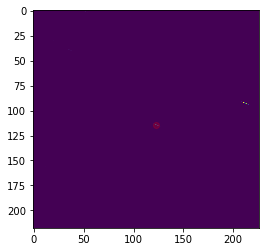

1 4


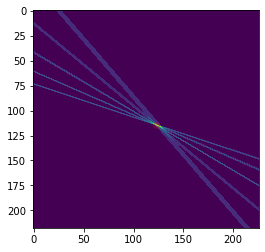

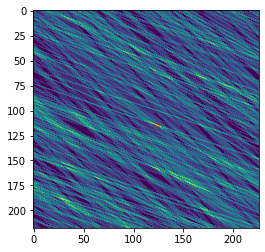

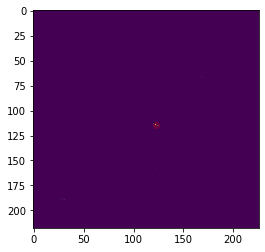

2 0


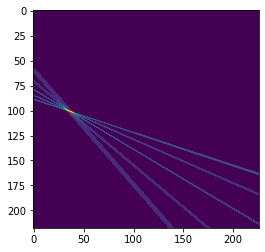

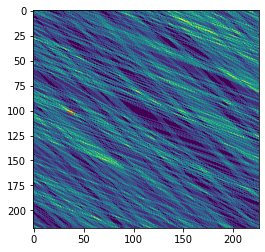

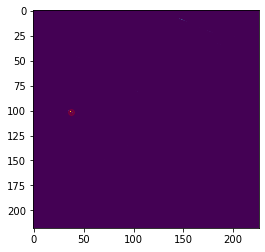

2 1


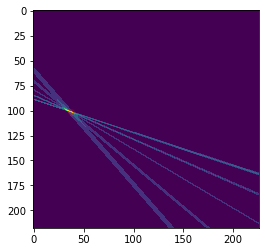

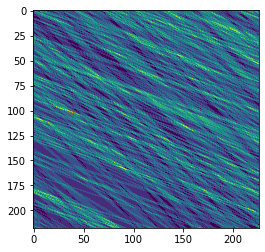

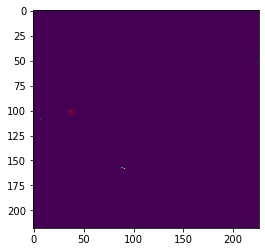

3 2


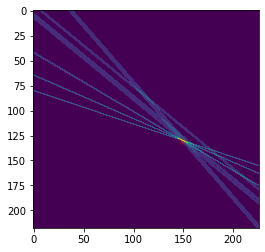

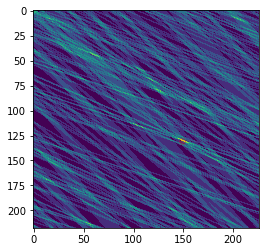

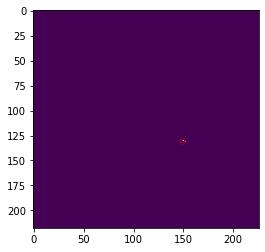

182 474
183 474
184 474
185 474
186 474
187 474
188 474
evaluating
0 1


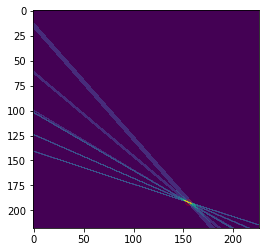

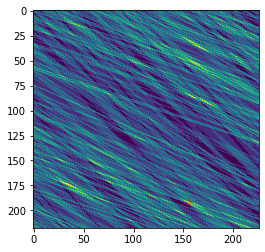

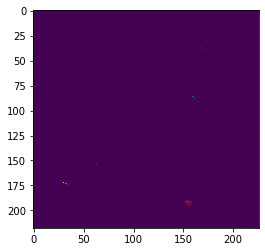

0 3


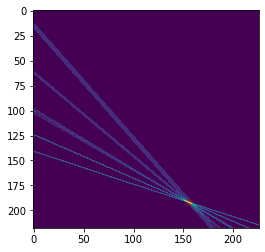

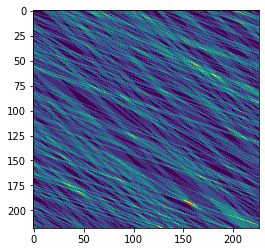

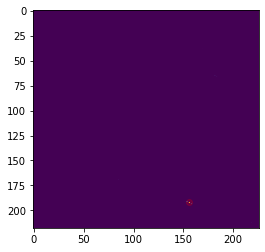

1 1


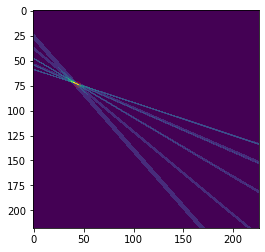

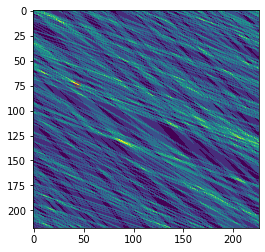

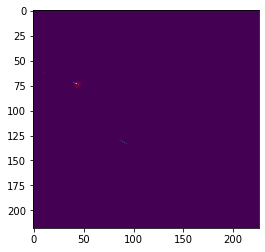

2 0


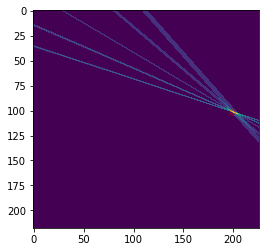

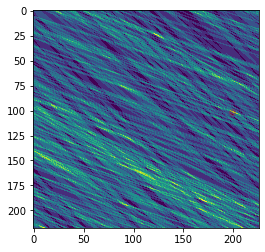

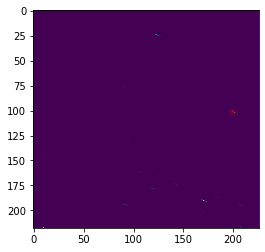

2 5


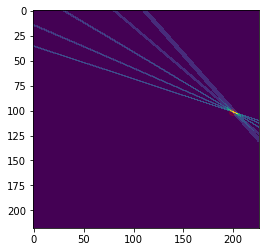

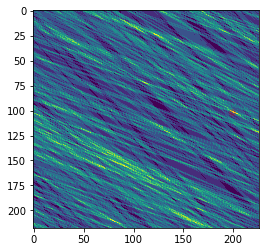

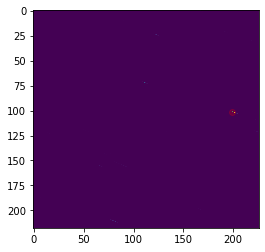

3 0


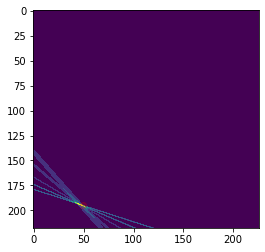

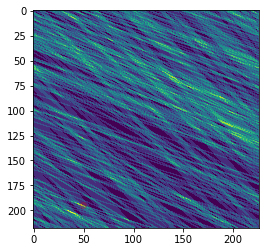

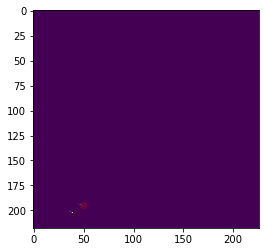

189 474
190 474
191 474
192 474
193 474
194 474
195 474
evaluating
0 4


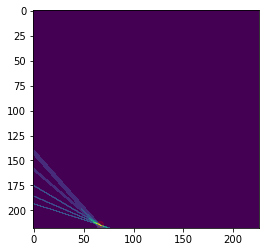

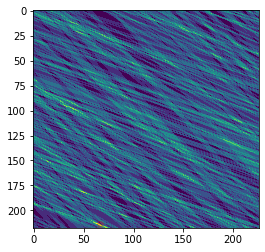

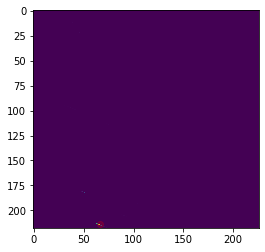

0 5


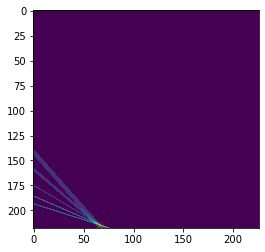

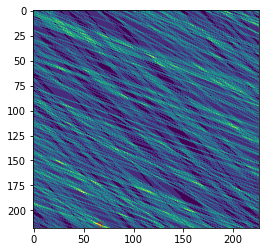

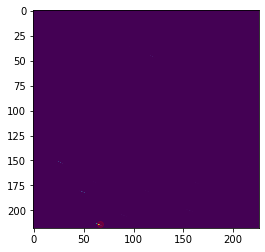

1 4


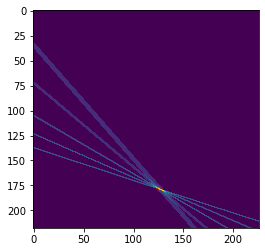

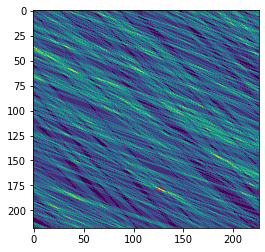

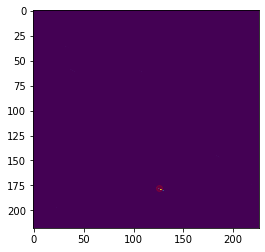

1 5


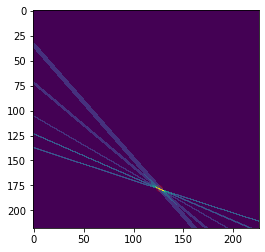

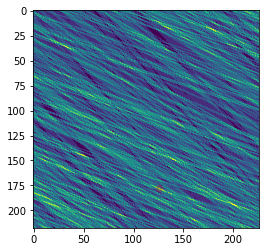

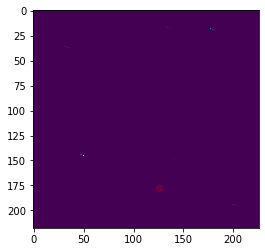

2 1


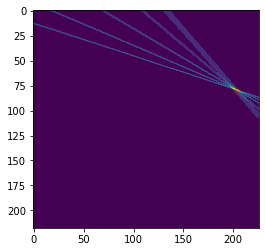

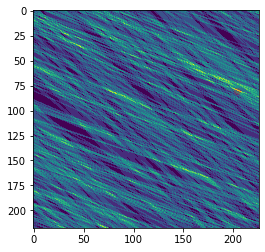

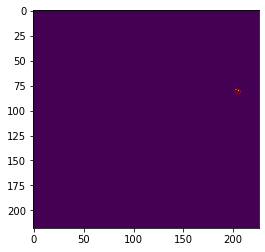

3 4


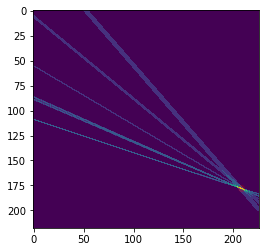

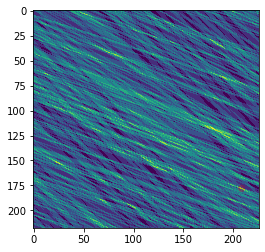

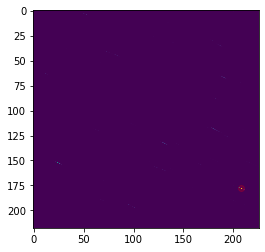

196 474
197 474
198 474
199 474
200 474
201 474
202 474
evaluating
0 0


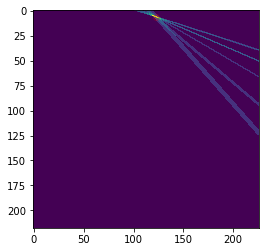

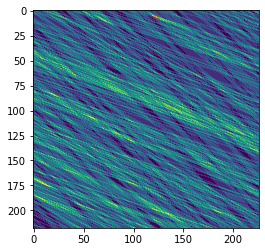

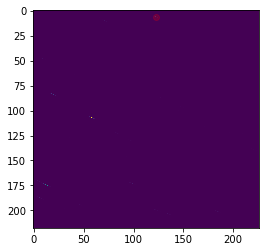

0 5


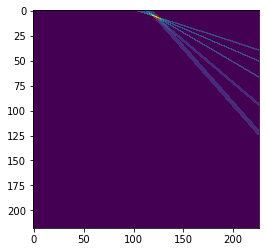

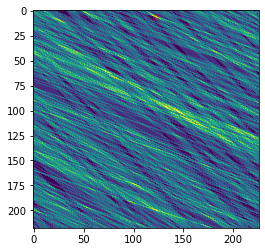

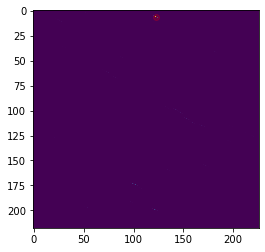

1 4


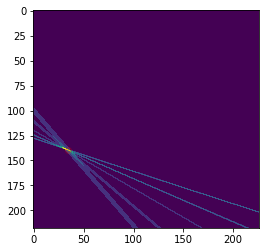

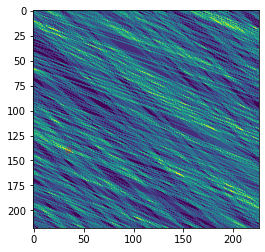

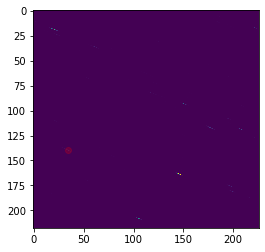

1 5


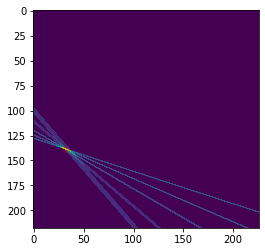

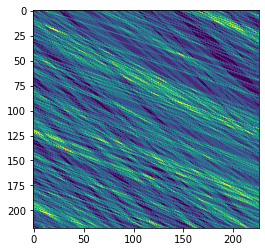

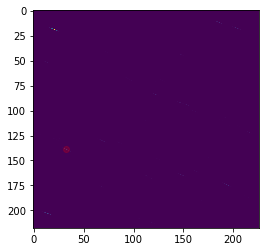

2 5


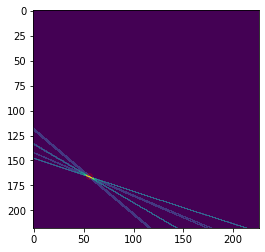

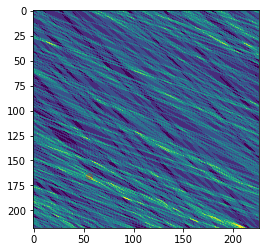

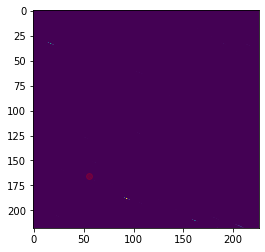

3 2


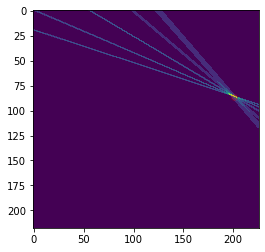

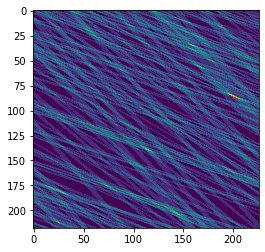

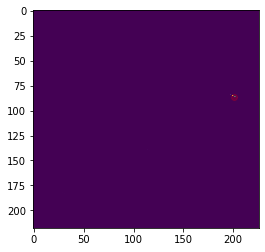

203 474
204 474
205 474
206 474
207 474
208 474
209 474
evaluating
0 0


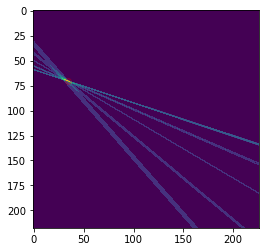

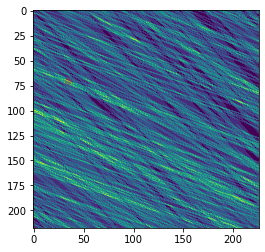

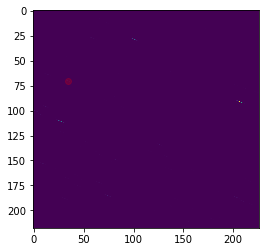

0 1


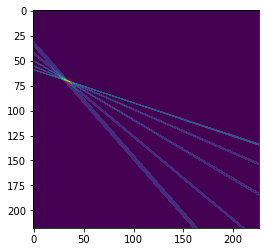

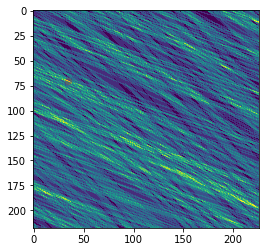

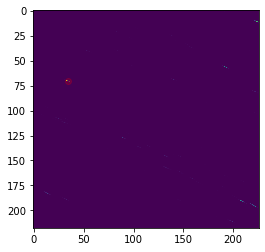

1 1


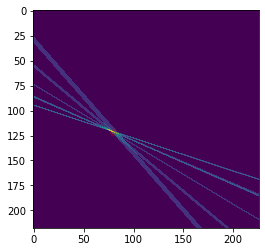

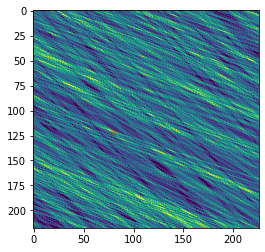

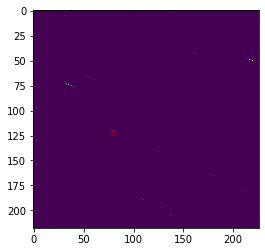

2 0


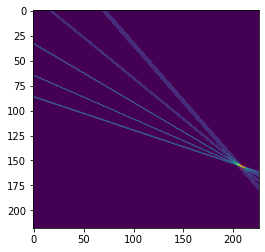

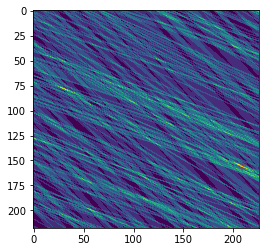

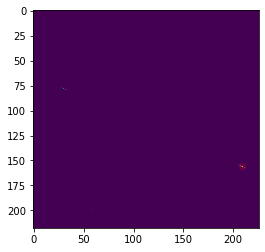

2 5


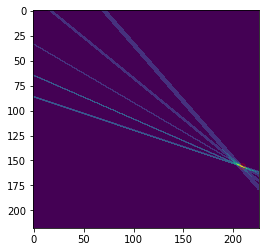

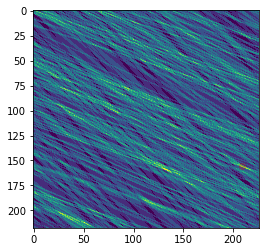

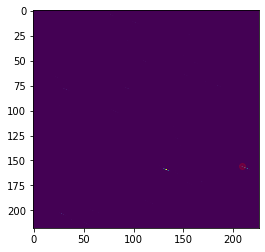

3 0


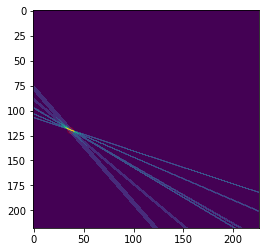

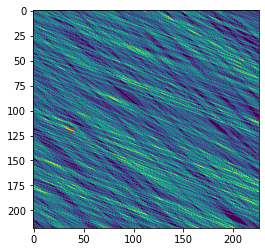

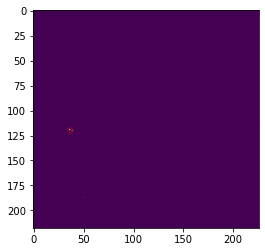

210 474
211 474
212 474
213 474
214 474
215 474
216 474
evaluating
0 1


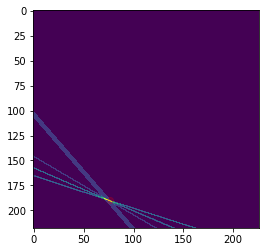

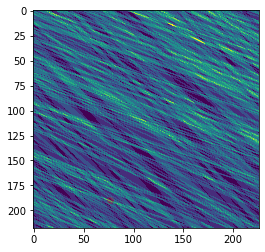

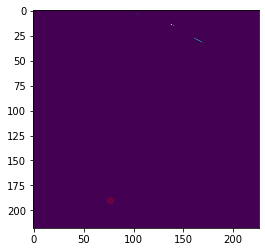

0 3


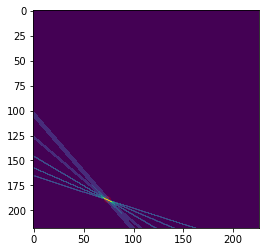

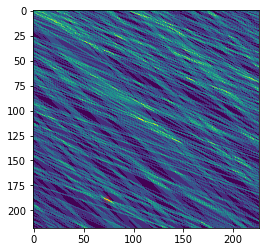

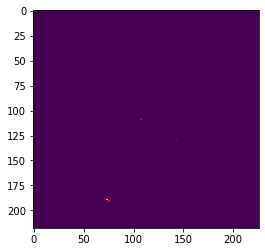

1 5


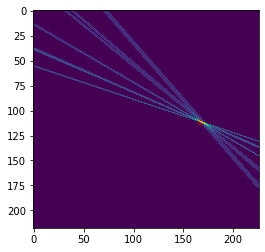

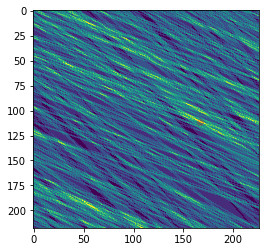

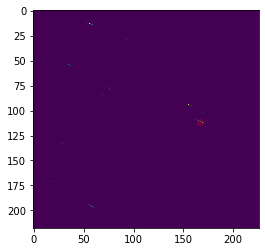

2 0


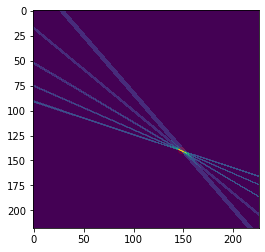

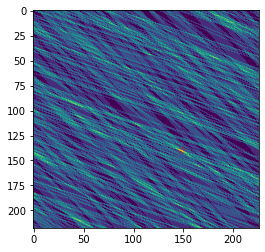

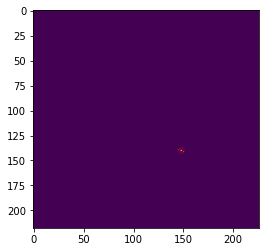

2 5


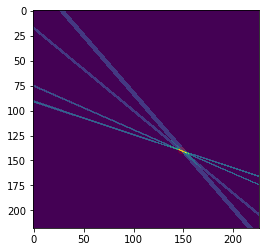

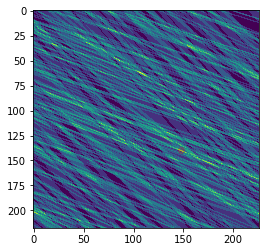

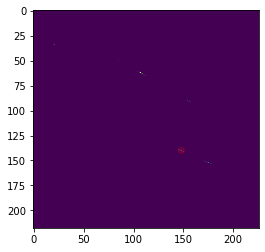

3 0


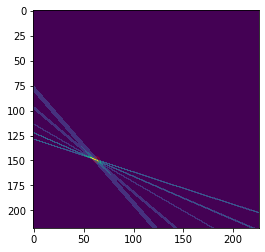

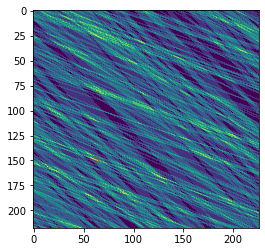

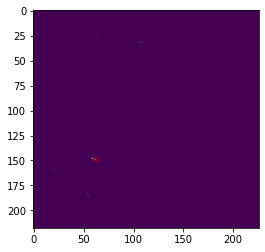

217 474
218 474
219 474
220 474
221 474
222 474
223 474
evaluating
0 5


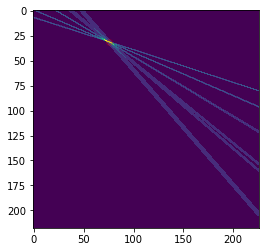

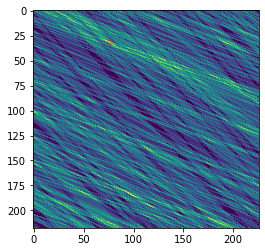

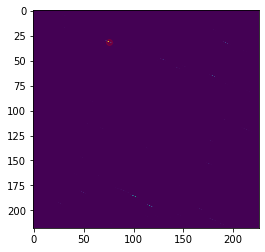

1 0


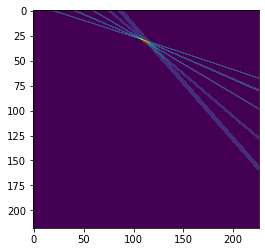

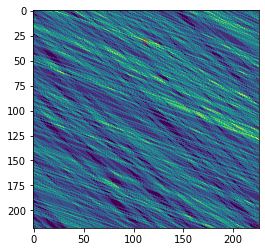

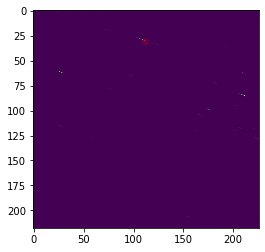

1 5


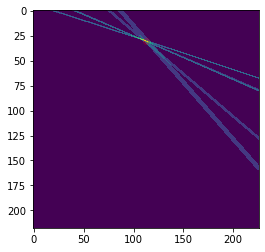

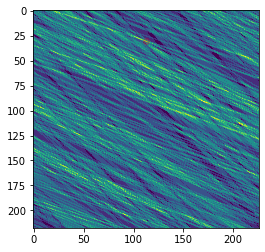

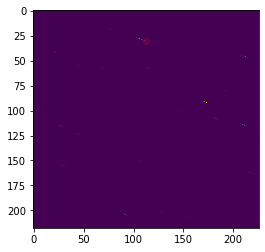

2 4


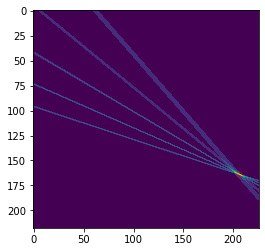

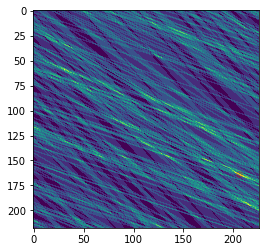

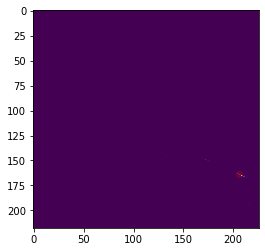

2 5


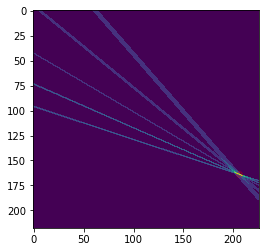

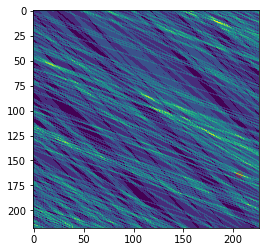

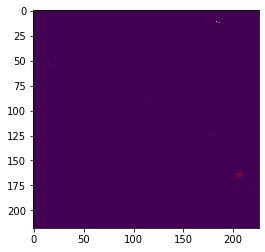

3 4


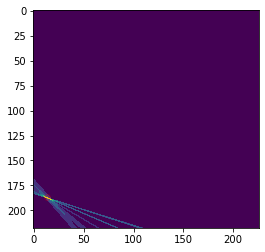

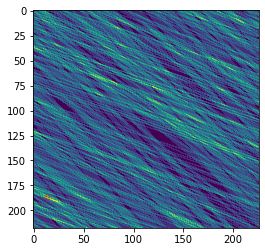

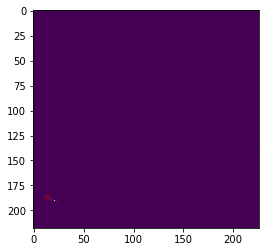

224 474
225 474
226 474
227 474
228 474
229 474
230 474
evaluating
0 2


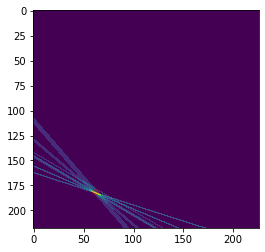

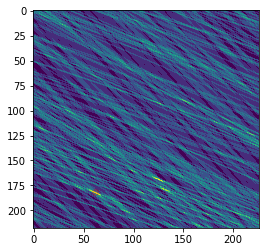

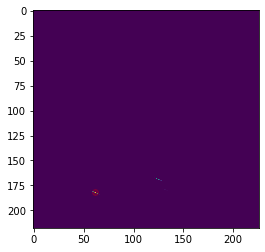

0 4


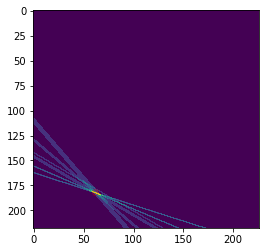

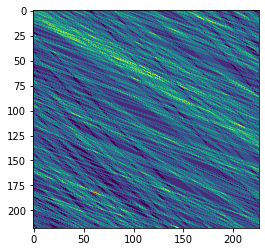

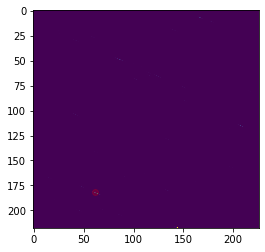

2 0


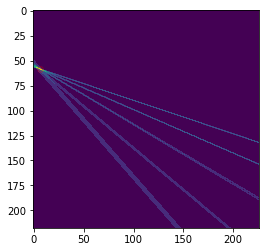

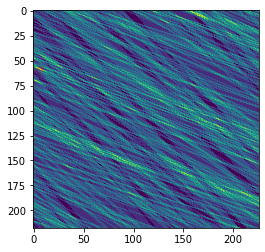

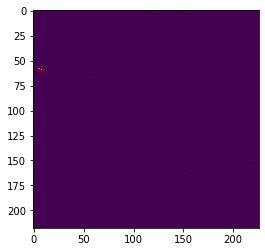

2 5


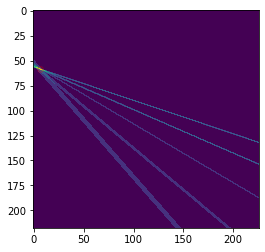

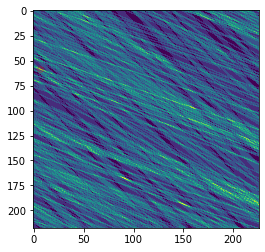

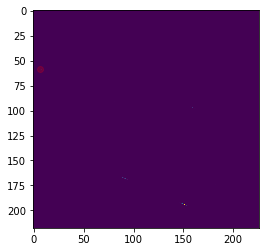

3 0


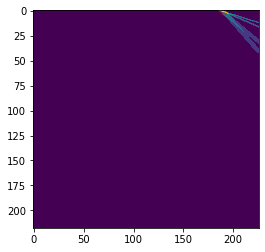

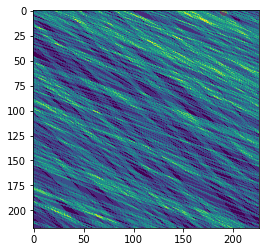

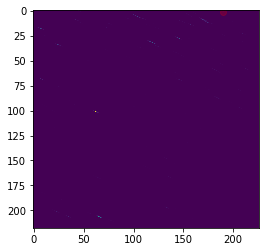

3 1


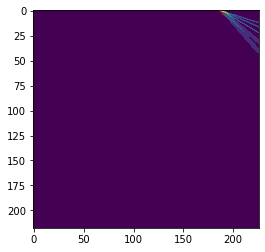

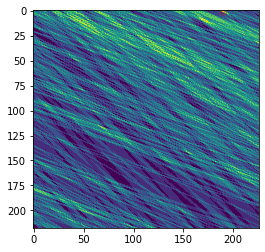

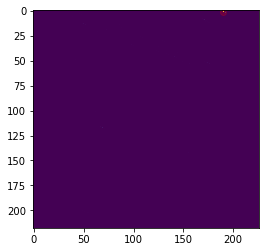

231 474
232 474
233 474
234 474
235 474
236 474
237 474
evaluating
0 1


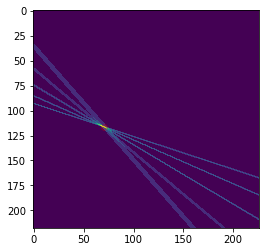

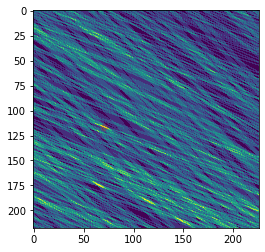

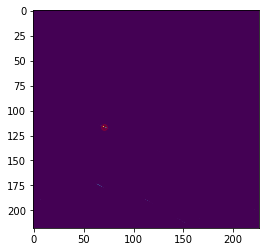

1 3


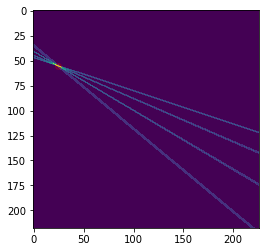

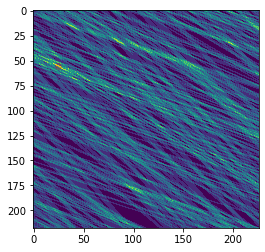

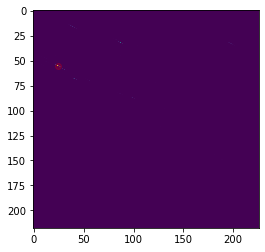

2 0


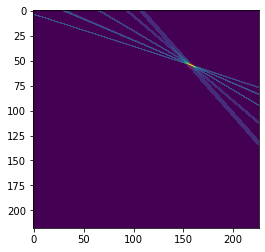

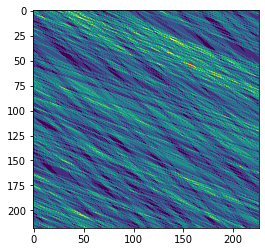

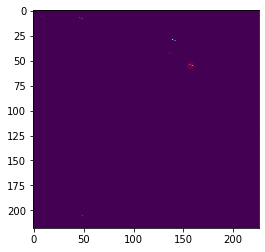

2 5


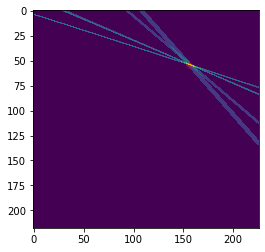

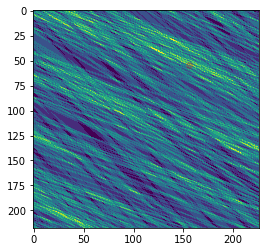

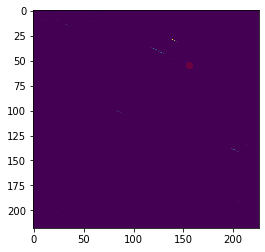

3 0


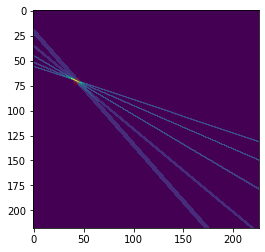

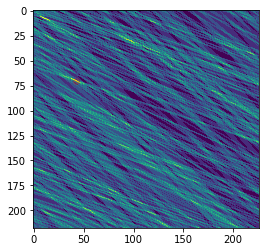

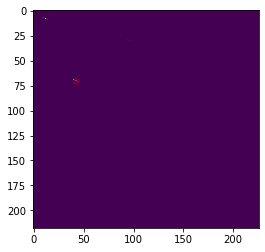

3 1


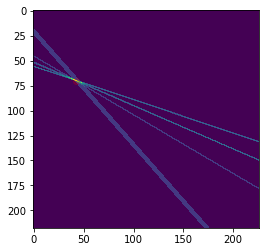

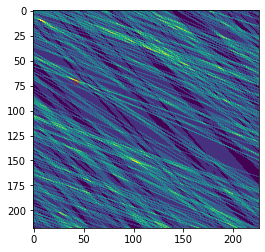

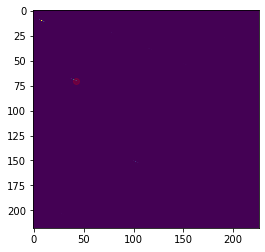

238 474
239 474
240 474
241 474
242 474
243 474
244 474
evaluating
0 0


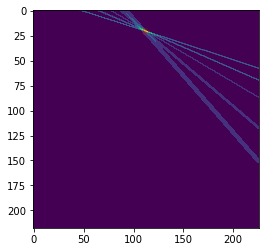

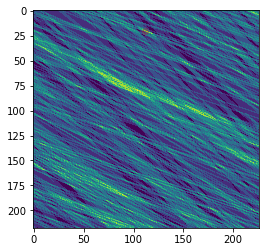

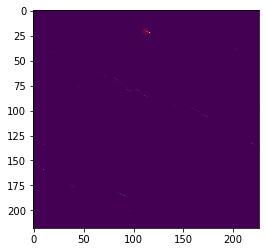

0 5


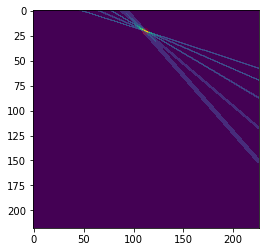

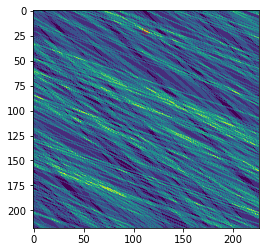

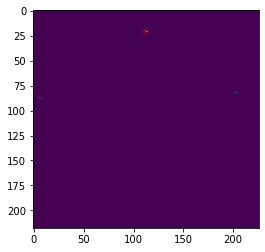

1 4


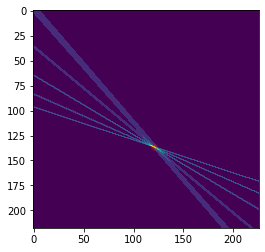

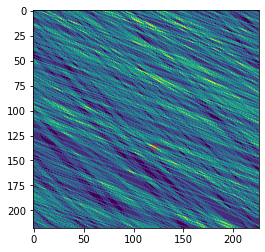

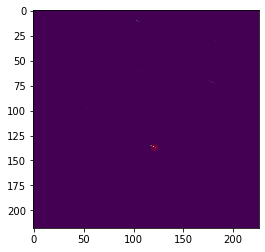

2 2


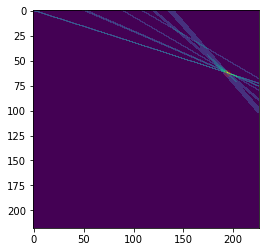

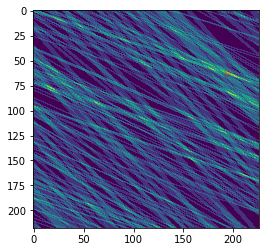

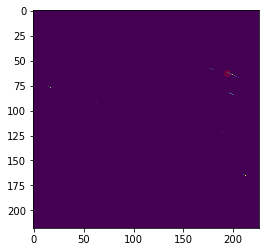

3 4


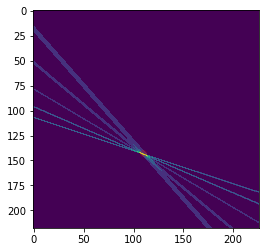

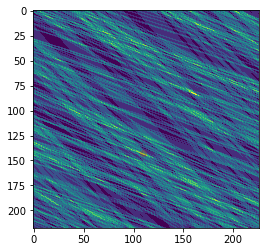

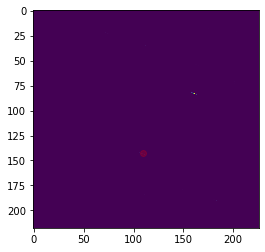

3 5


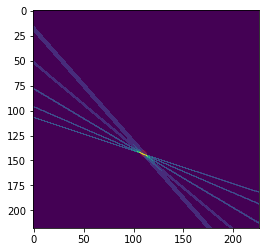

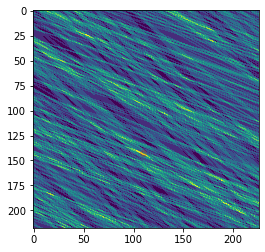

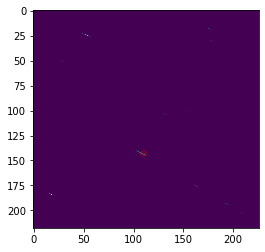

245 474
246 474
247 474
248 474
249 474
250 474
251 474
evaluating
1 0


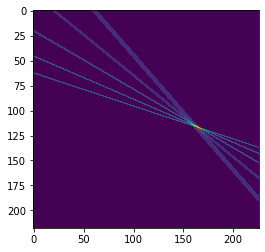

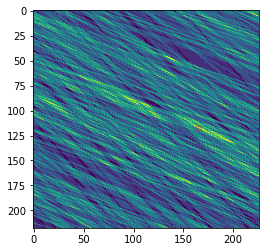

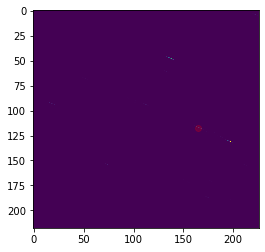

1 1


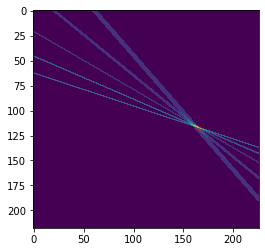

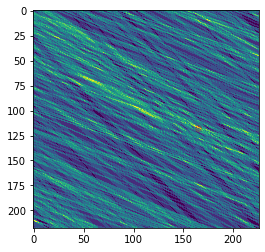

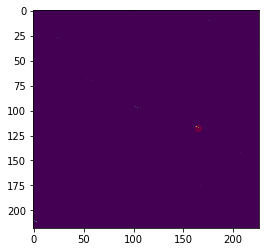

2 4


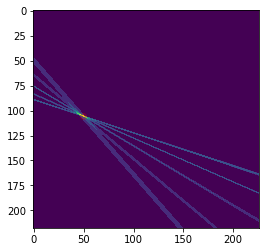

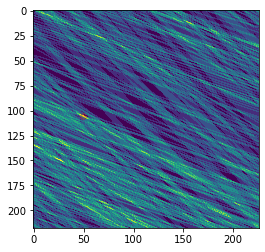

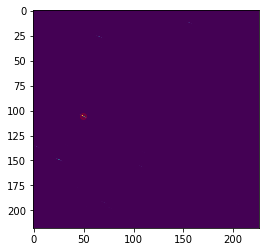

3 3


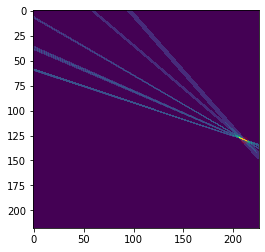

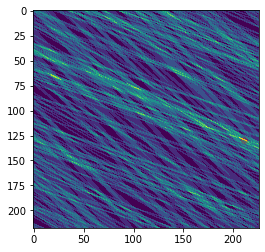

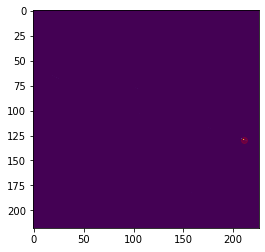

4 5


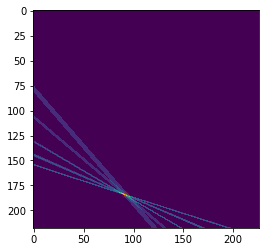

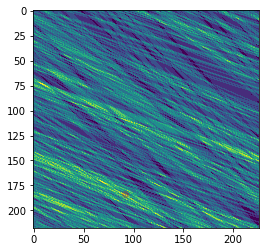

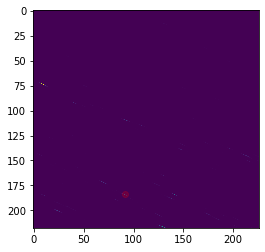

5 0


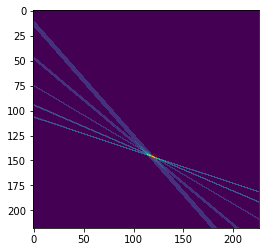

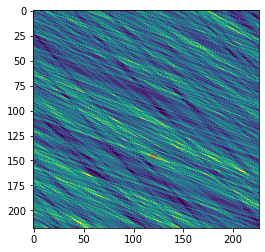

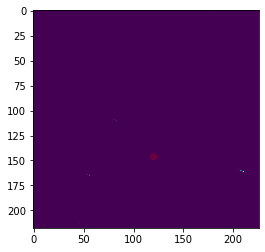

252 474
253 474
254 474
255 474
256 474
257 474
258 474
evaluating
0 5


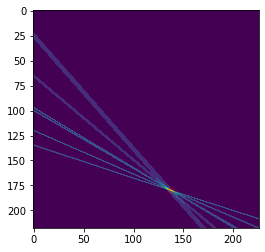

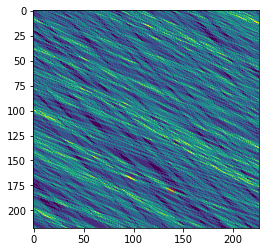

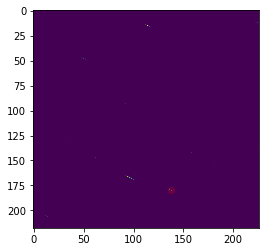

1 4


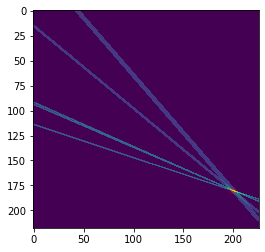

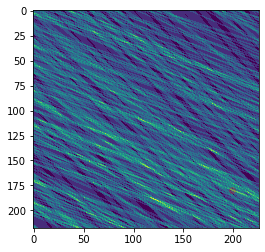

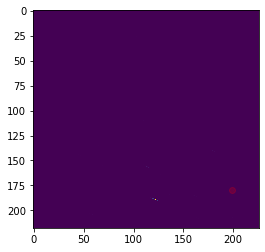

1 5


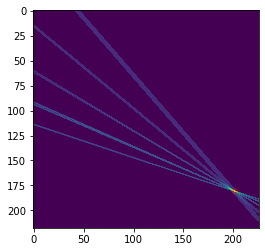

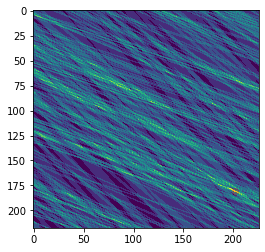

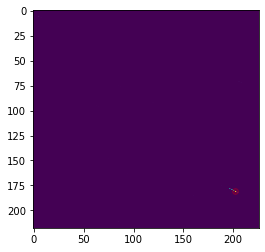

2 0


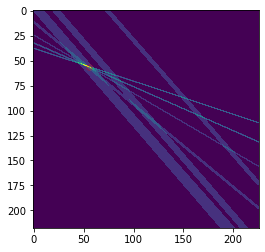

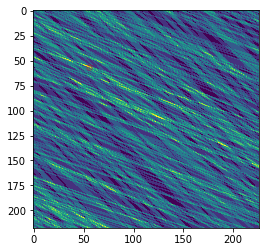

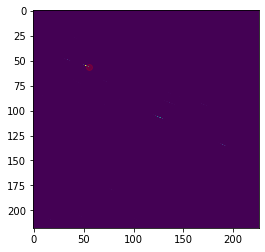

2 1


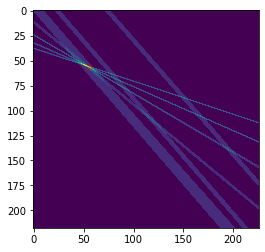

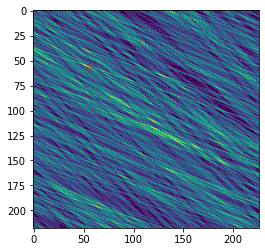

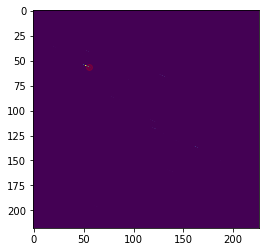

3 5


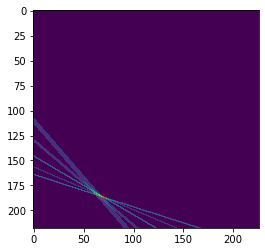

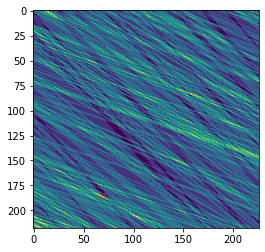

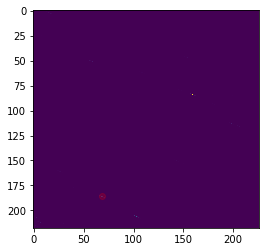

259 474
260 474
261 474
262 474
263 474
264 474
265 474
evaluating
0 3


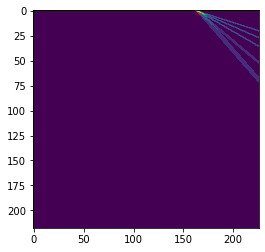

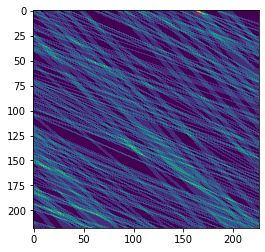

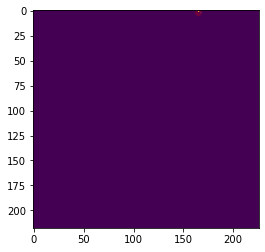

1 0


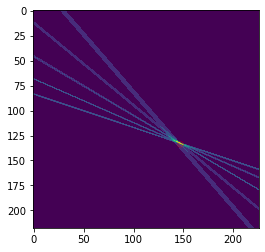

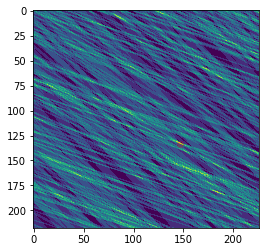

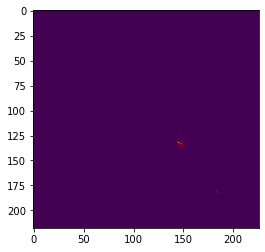

1 5


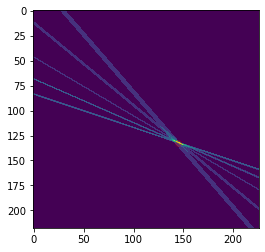

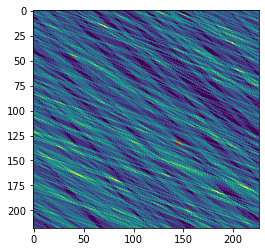

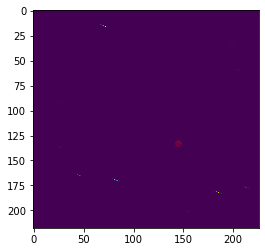

2 5


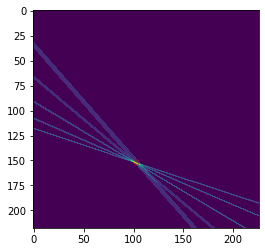

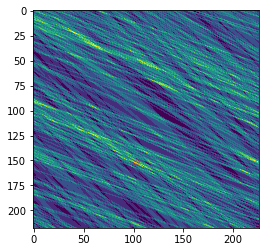

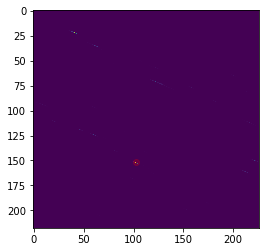

3 4


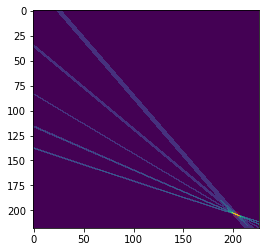

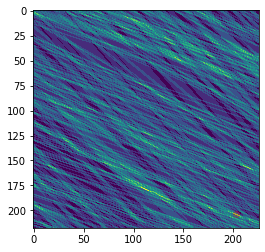

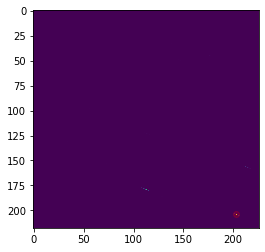

3 5


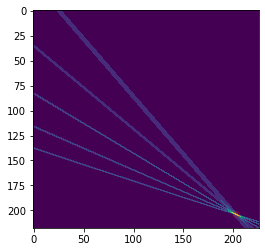

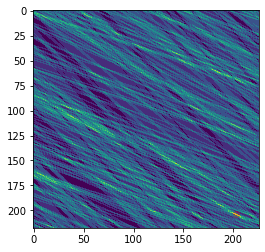

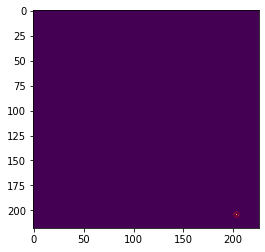

266 474
267 474
268 474
269 474
270 474
271 474
272 474
evaluating
0 0


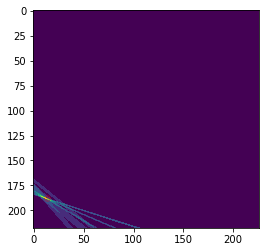

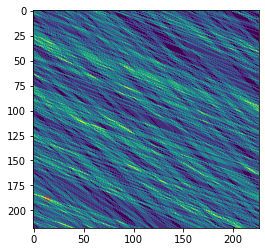

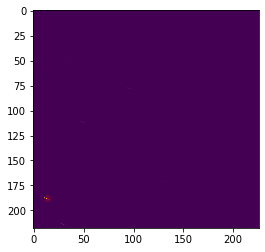

0 5


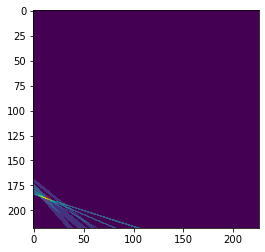

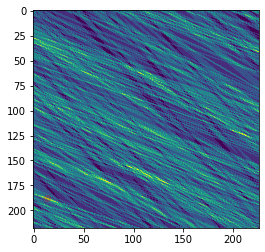

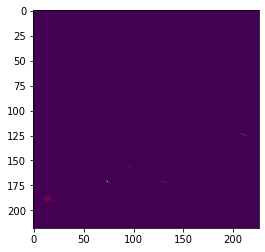

1 4


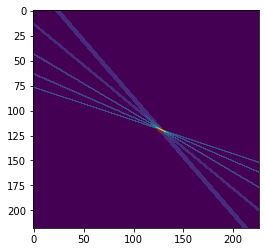

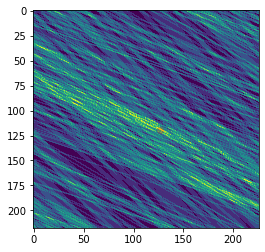

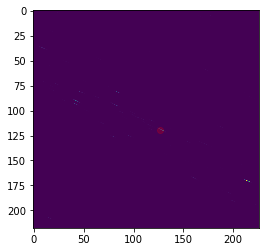

1 5


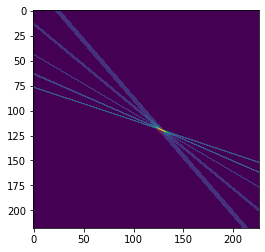

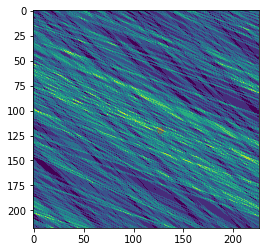

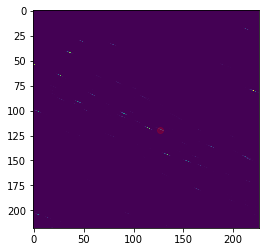

2 0


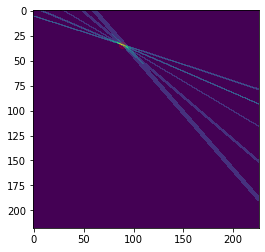

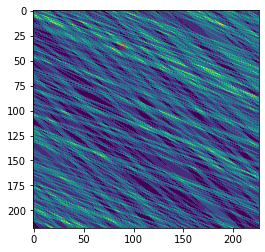

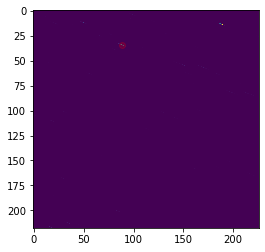

2 5


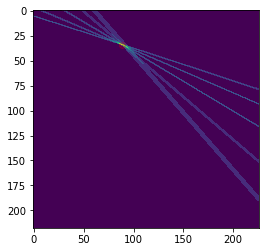

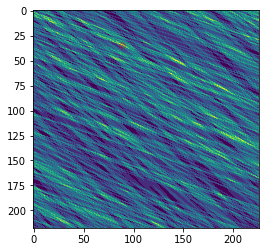

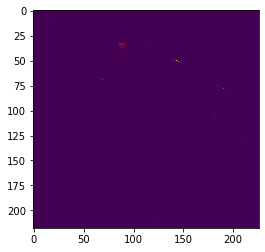

273 474
274 474
275 474
276 474
277 474
278 474
279 474
evaluating
0 4


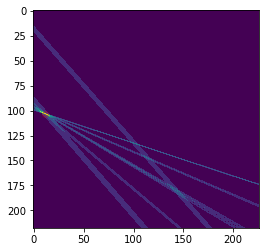

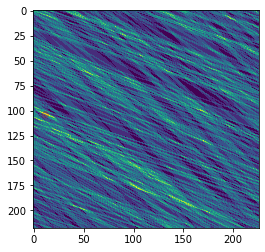

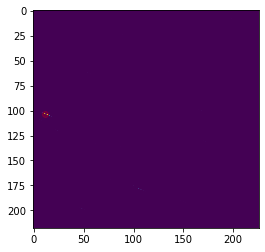

1 0


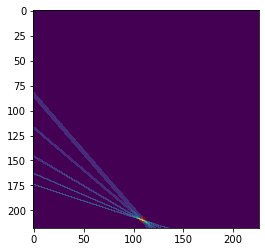

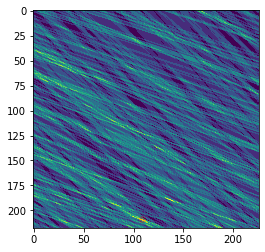

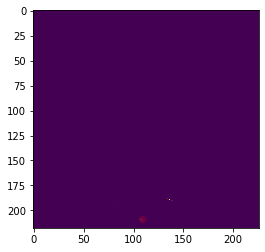

1 5


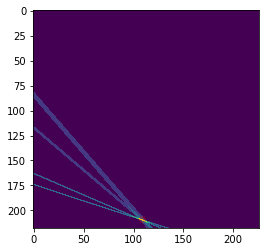

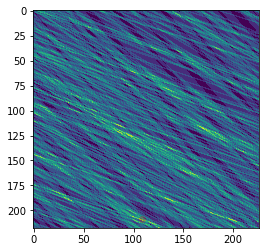

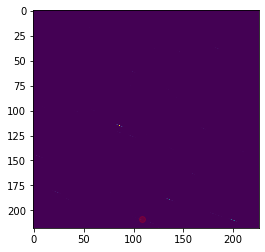

2 0


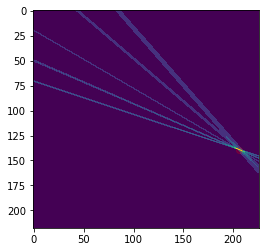

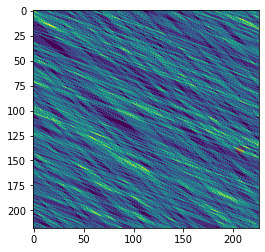

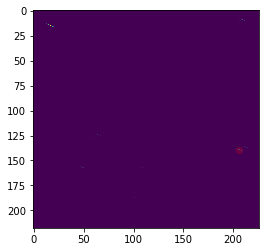

2 5


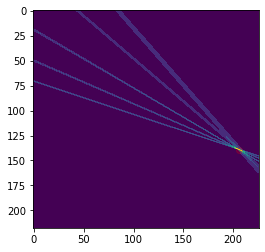

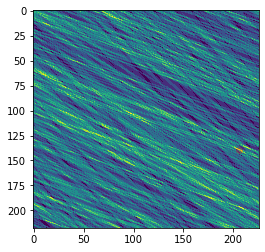

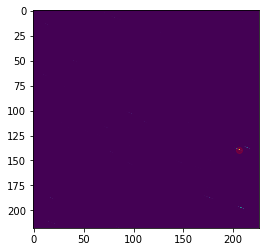

3 1


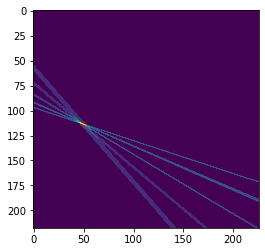

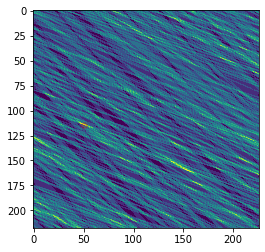

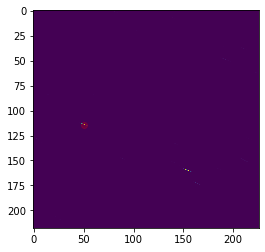

280 474
281 474
282 474
283 474
284 474
285 474
286 474
evaluating
0 4


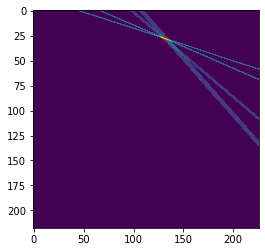

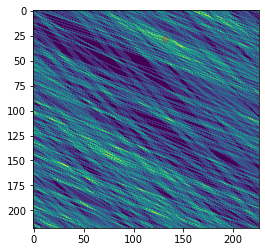

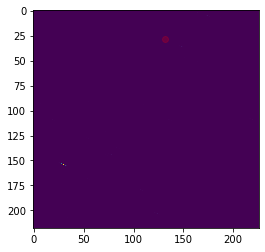

0 5


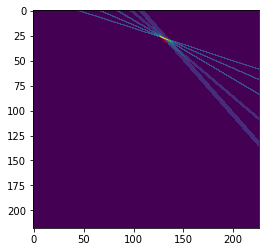

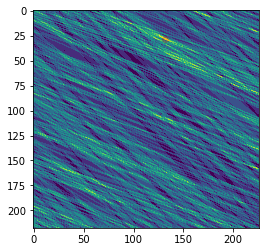

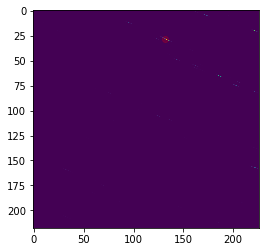

1 0


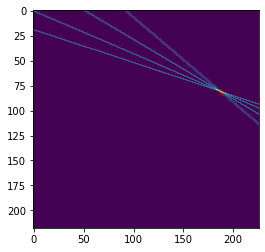

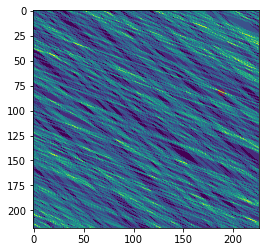

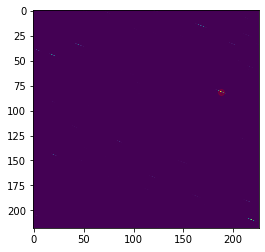

2 0


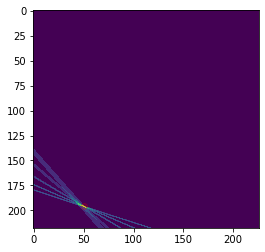

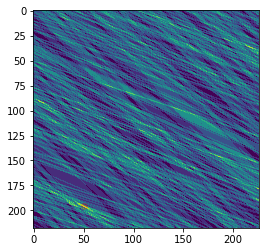

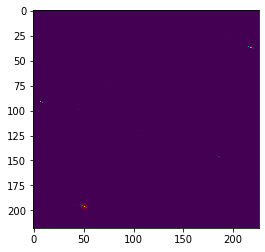

2 1


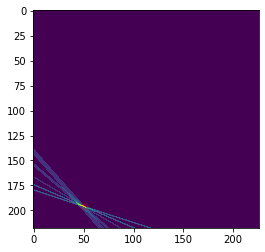

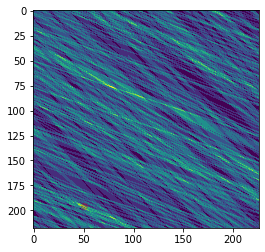

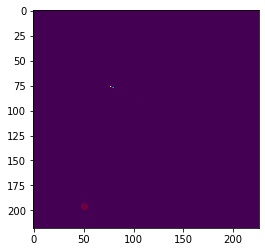

3 0


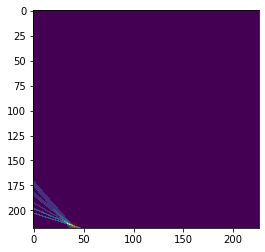

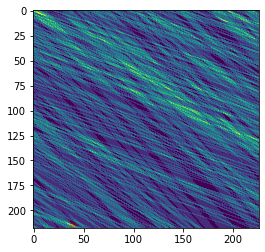

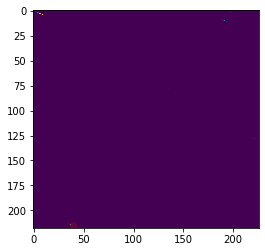

287 474
288 474
289 474
290 474
291 474
292 474
293 474
evaluating
0 0


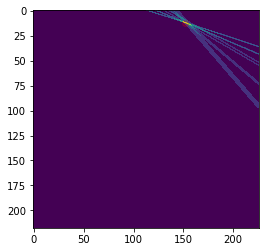

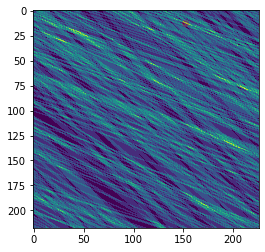

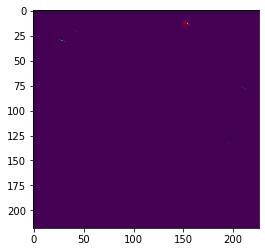

0 5


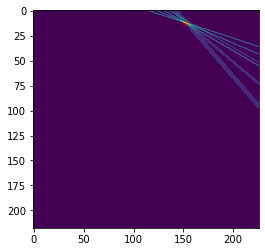

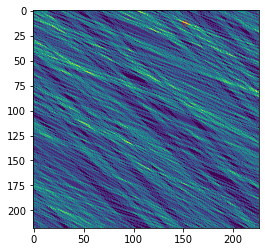

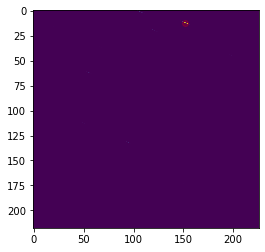

1 2


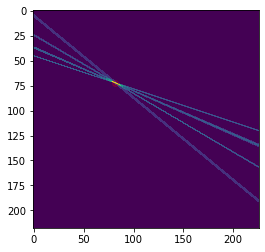

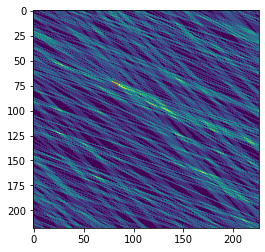

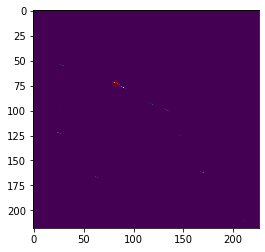

2 0


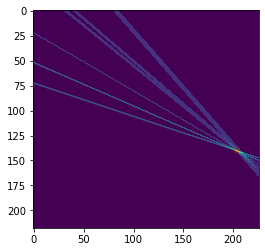

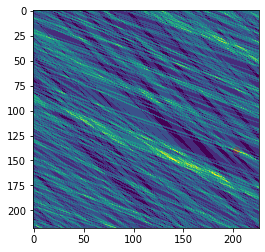

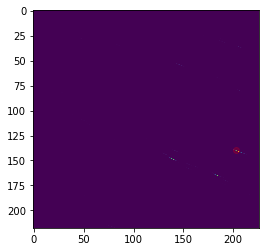

2 5


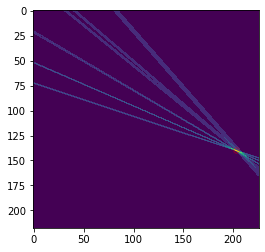

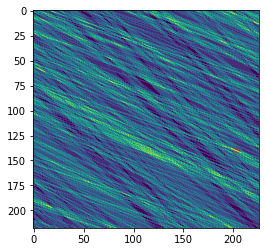

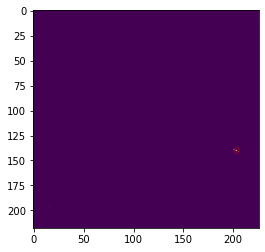

3 0


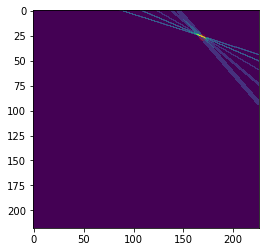

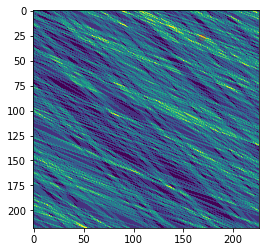

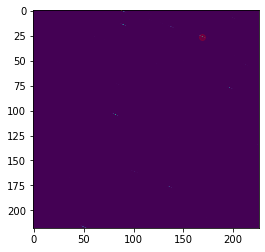

294 474
295 474
296 474
297 474
298 474
299 474
300 474
evaluating
0 0


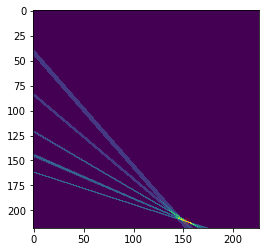

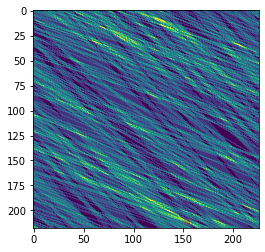

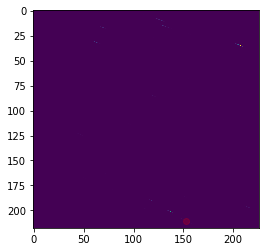

1 4


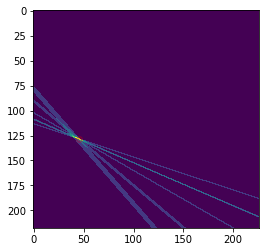

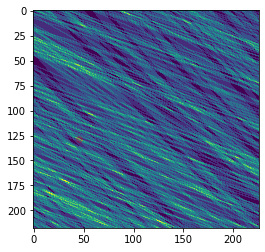

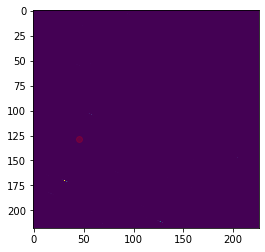

1 5


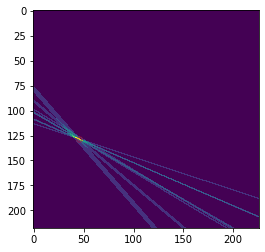

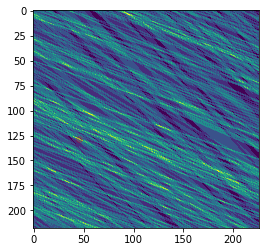

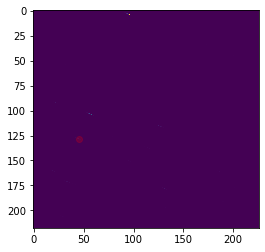

2 4


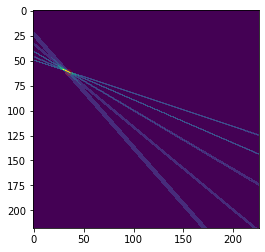

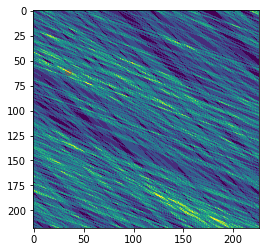

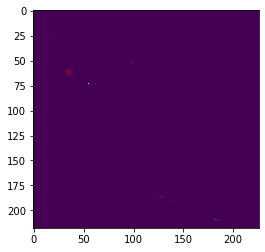

2 5


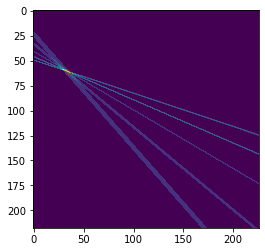

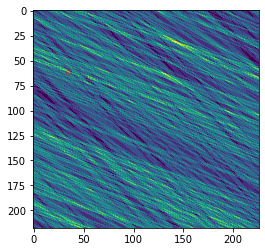

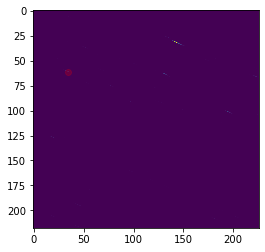

3 4


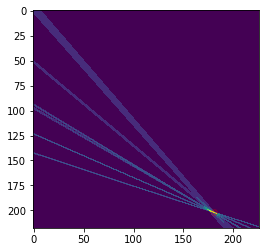

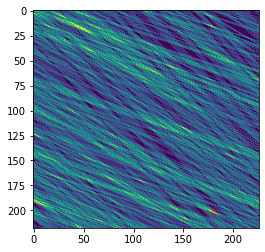

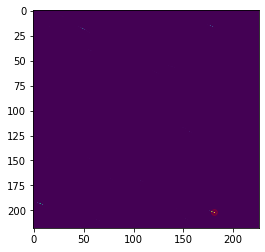

301 474
302 474
303 474
304 474
305 474
306 474
307 474
evaluating
0 0


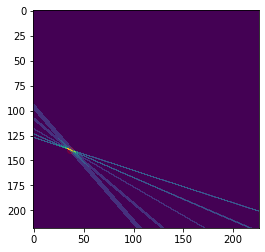

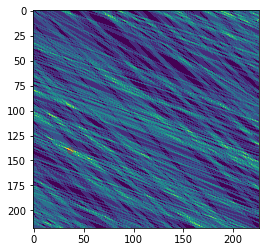

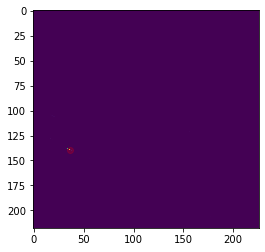

0 5


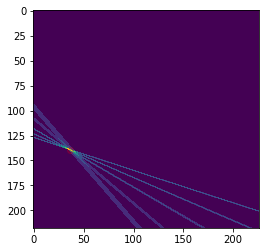

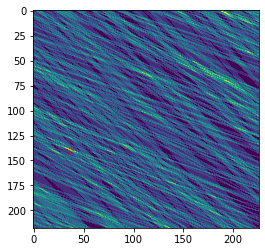

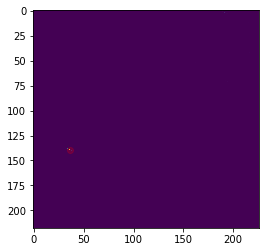

1 4


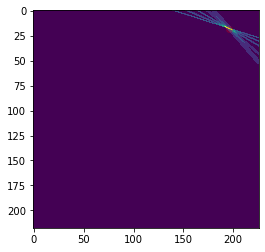

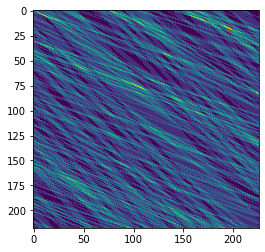

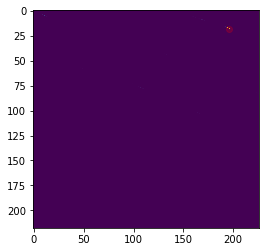

1 5


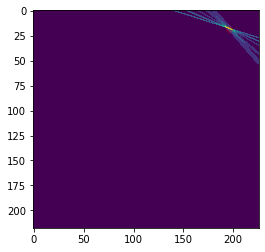

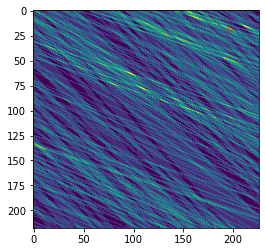

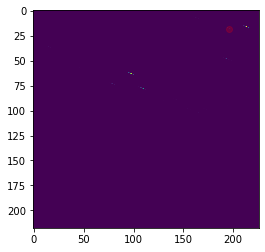

2 0


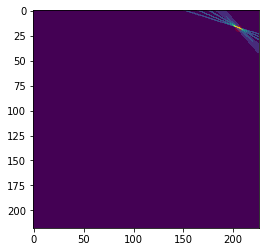

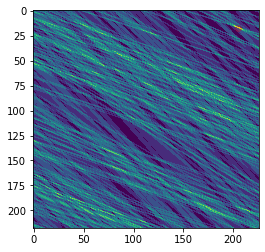

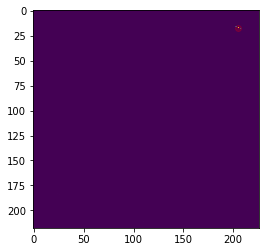

2 5


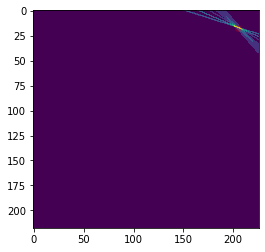

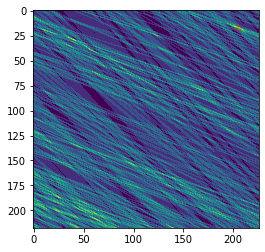

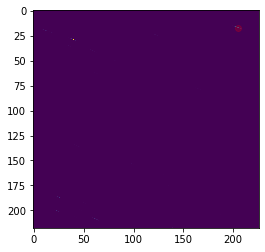

308 474
309 474
310 474
311 474
312 474
313 474
314 474
evaluating
0 0


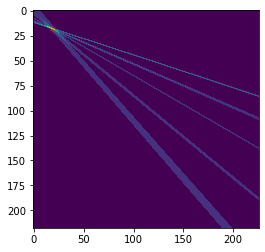

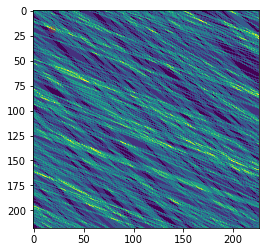

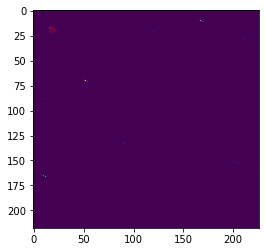

0 1


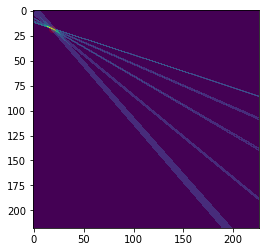

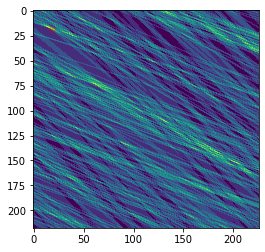

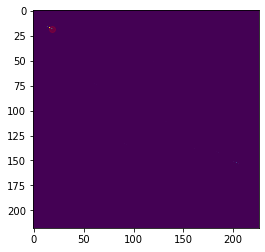

1 0


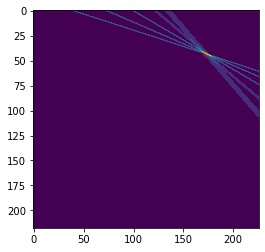

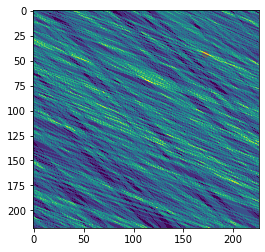

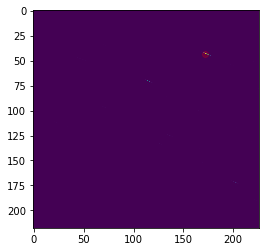

2 0


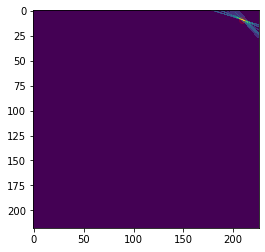

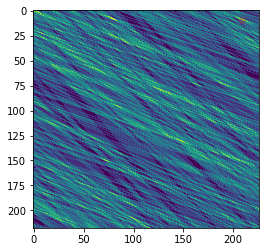

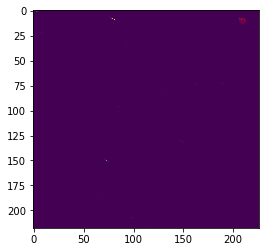

2 1


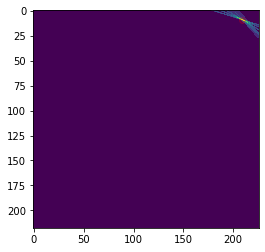

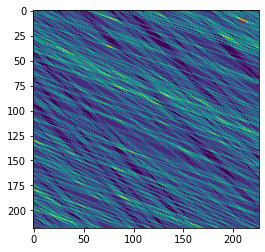

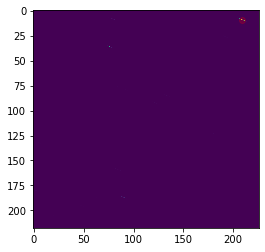

4 1


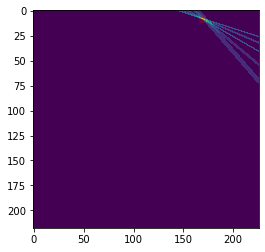

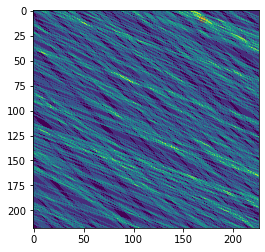

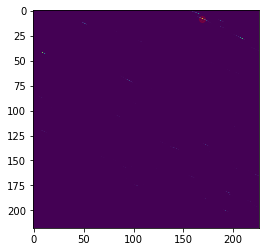

315 474
316 474
317 474
318 474
319 474
320 474
321 474
evaluating
1 0


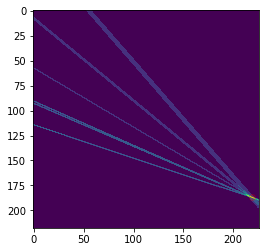

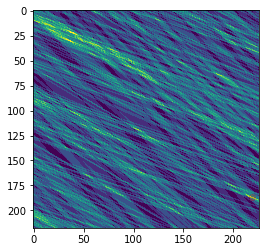

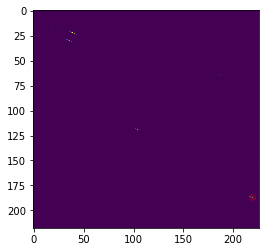

1 1


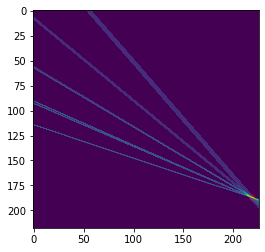

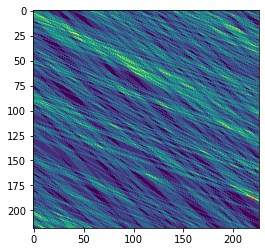

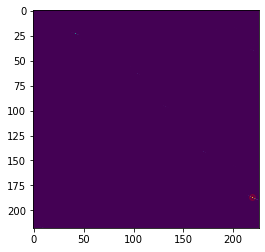

2 0


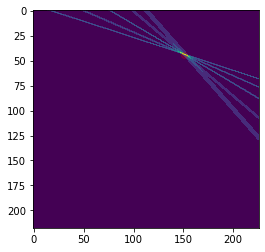

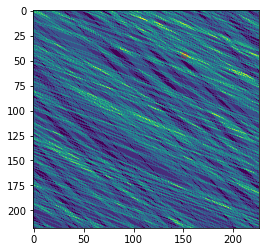

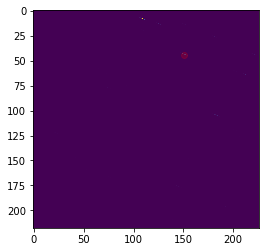

2 1


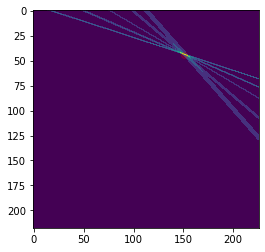

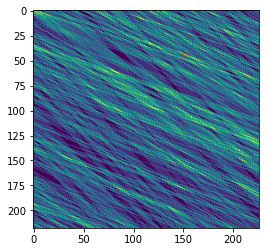

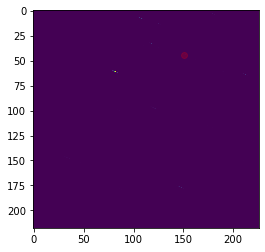

3 0


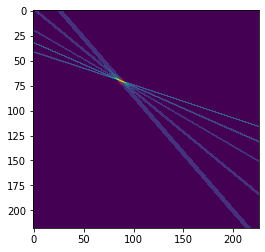

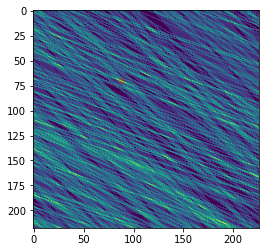

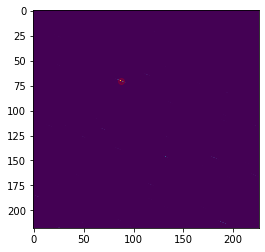

3 5


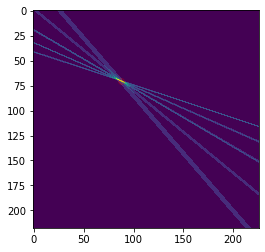

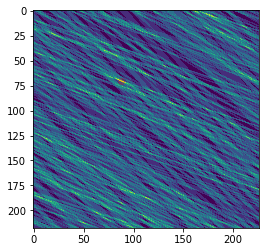

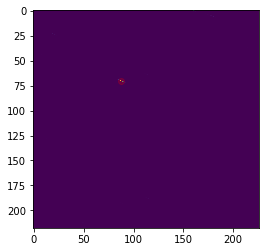

322 474
323 474
324 474
325 474
326 474
327 474
328 474
evaluating
0 1


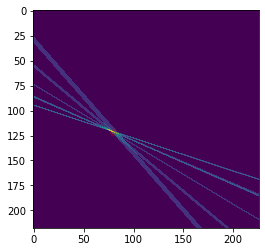

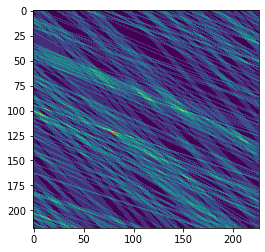

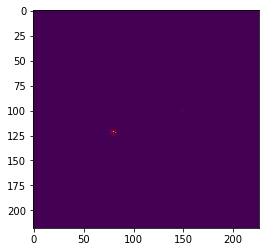

1 0


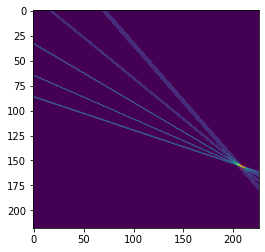

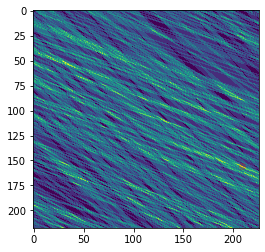

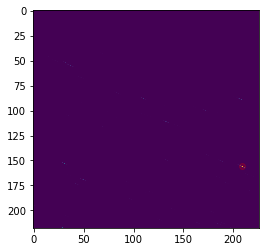

1 5


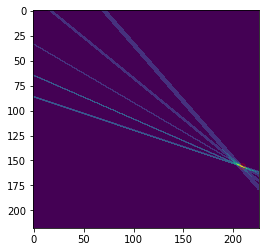

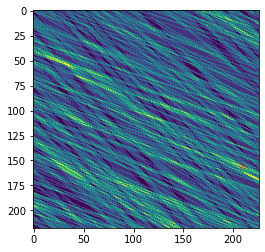

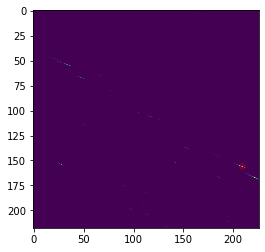

2 0


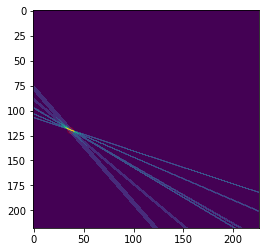

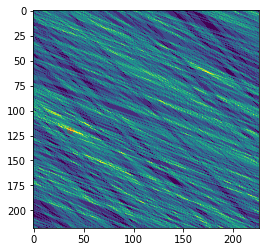

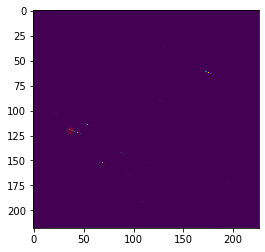

2 1


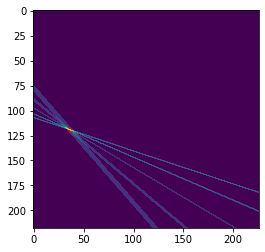

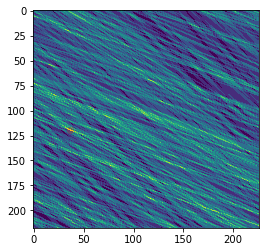

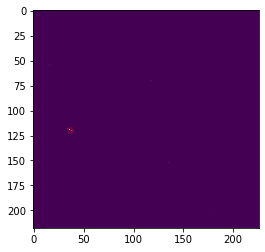

3 0


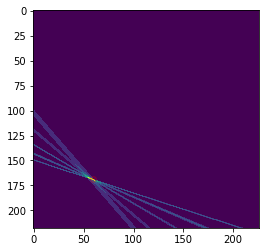

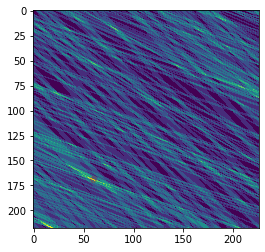

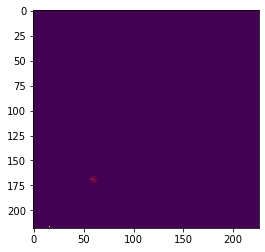

329 474
330 474
331 474
332 474
333 474
334 474
335 474
evaluating
0 0


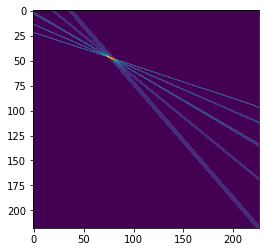

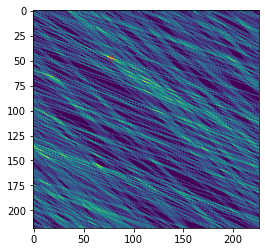

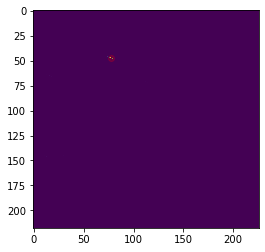

0 5


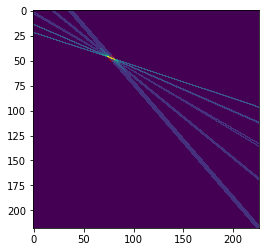

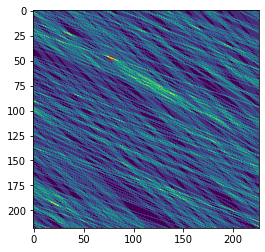

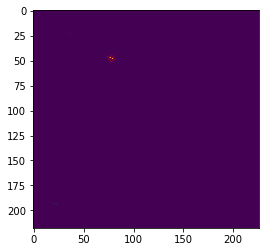

1 4


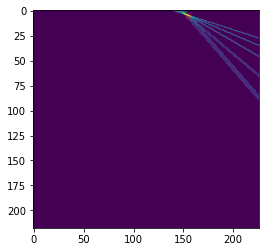

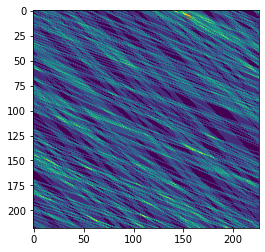

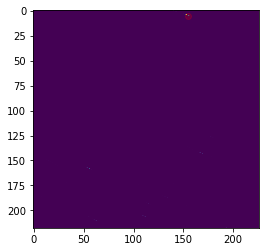

2 0


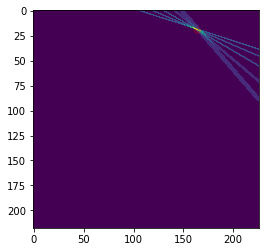

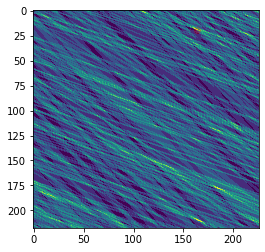

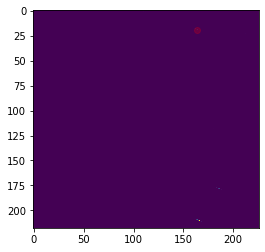

2 5


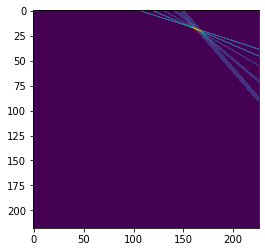

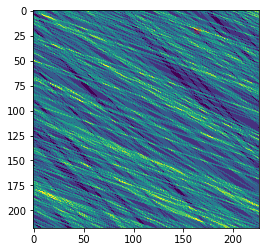

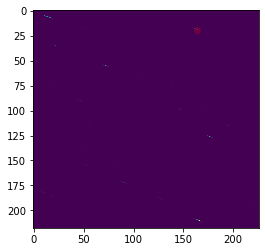

3 3


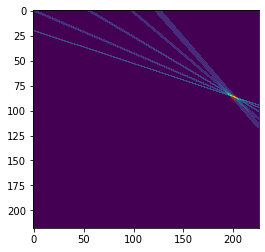

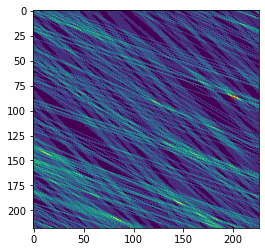

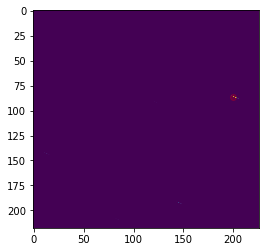

336 474
337 474
338 474
339 474
340 474
341 474
342 474
evaluating
0 0


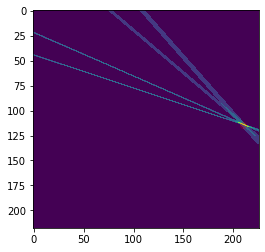

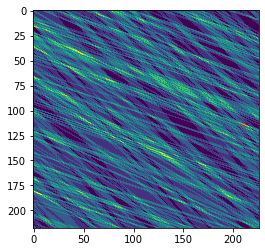

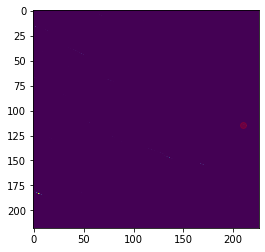

0 1


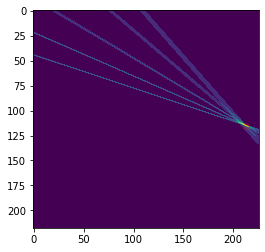

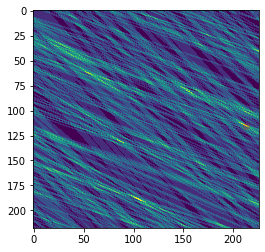

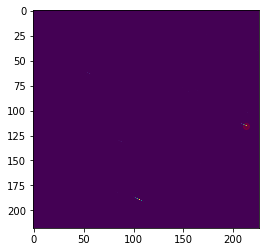

1 2


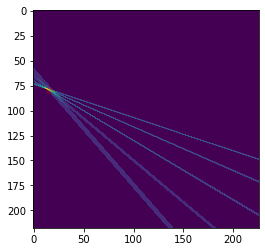

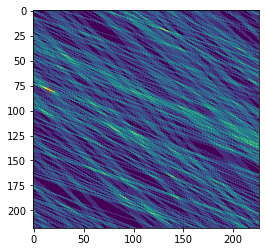

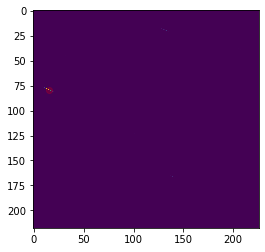

2 0


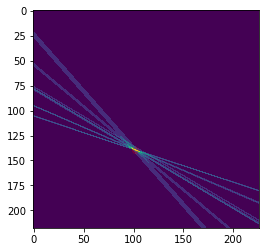

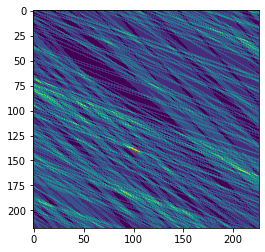

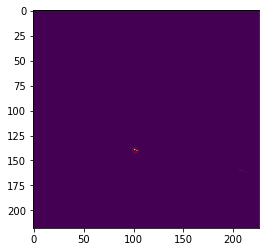

2 1


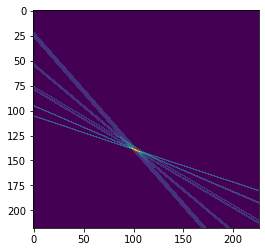

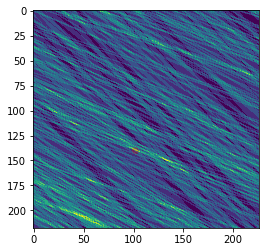

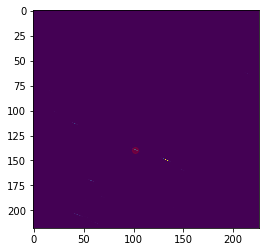

3 3


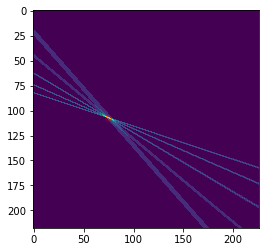

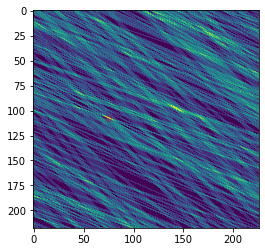

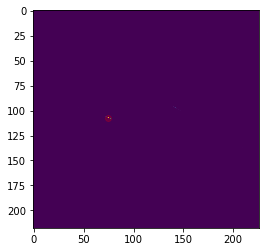

343 474
344 474
345 474
346 474
347 474
348 474
349 474
evaluating
0 0


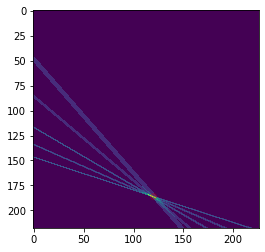

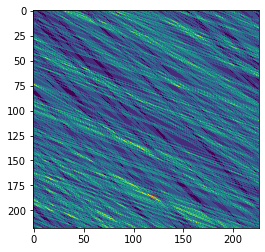

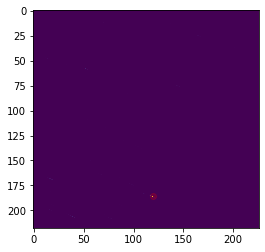

0 5


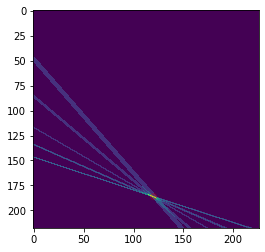

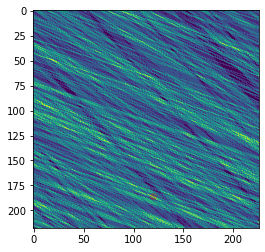

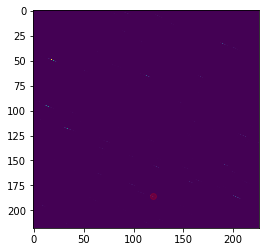

1 0


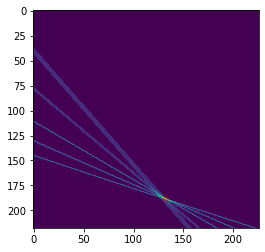

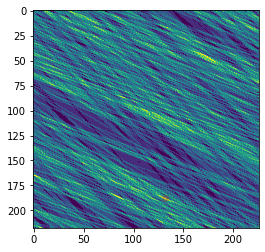

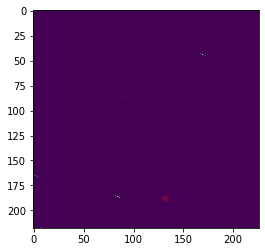

2 1


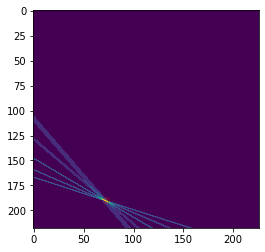

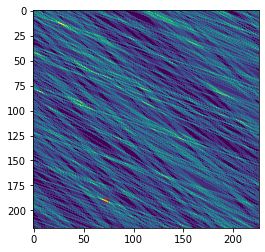

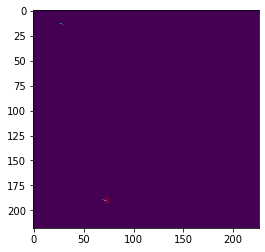

3 1


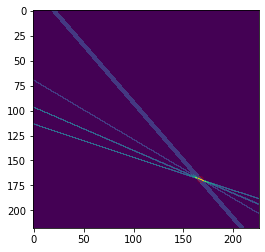

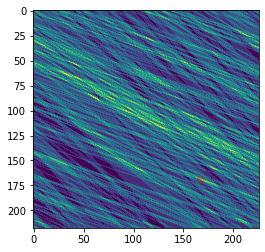

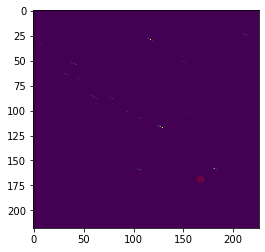

3 3


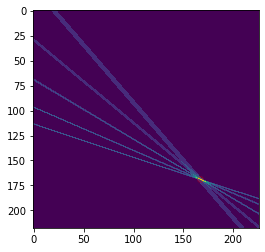

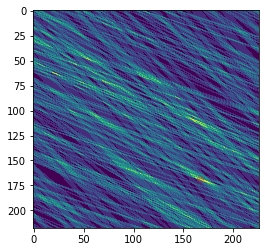

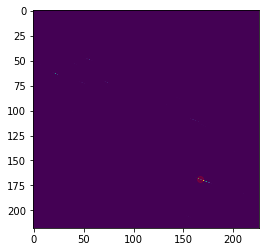

350 474
351 474
352 474
353 474
354 474
355 474
356 474
evaluating
0 2


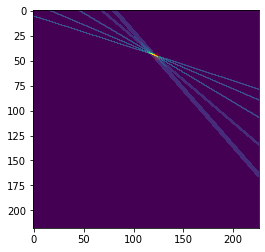

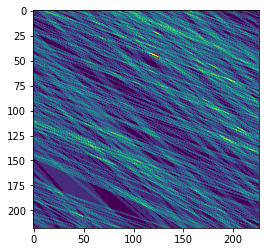

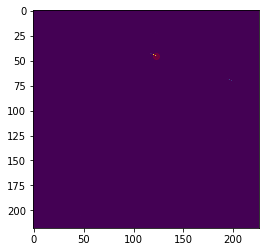

0 4


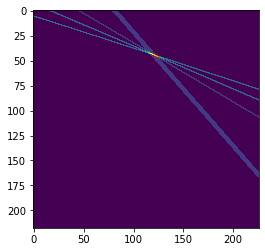

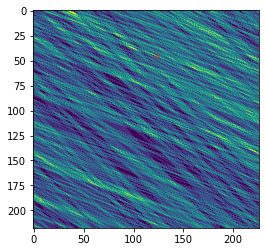

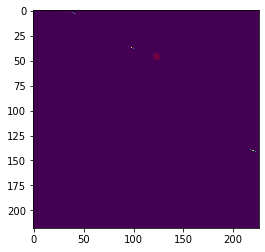

1 0


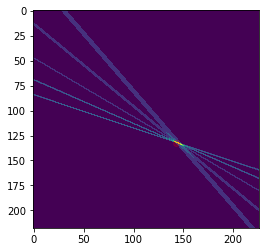

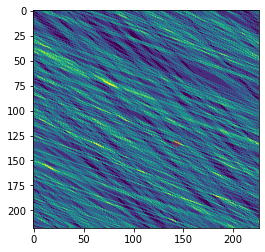

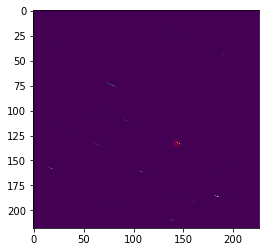

1 1


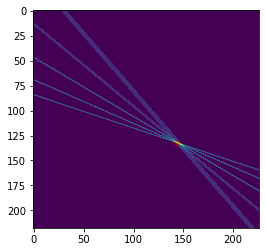

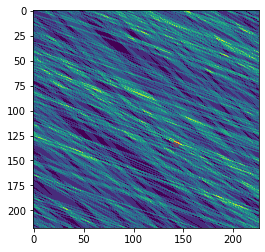

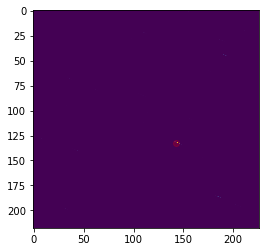

2 0


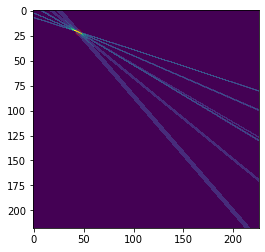

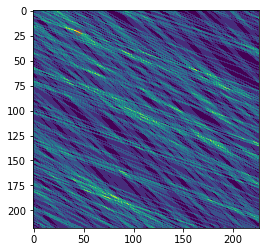

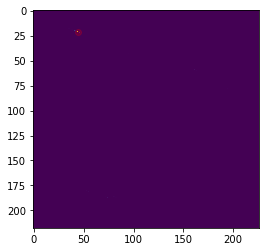

2 5


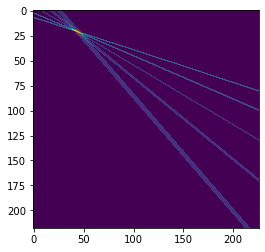

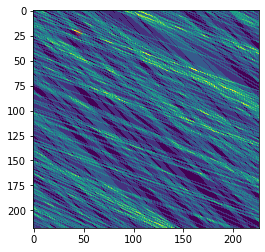

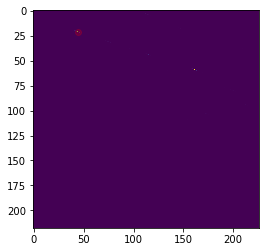

357 474
358 474
359 474
360 474
361 474
362 474
363 474
evaluating
0 4


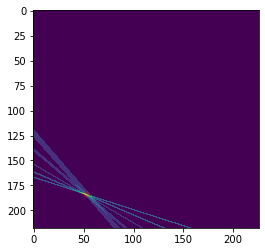

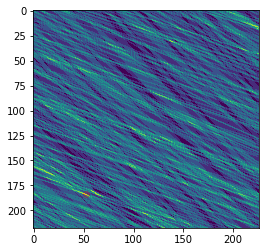

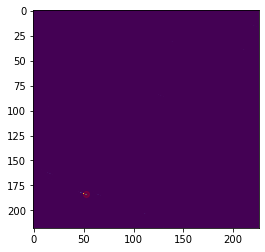

0 5


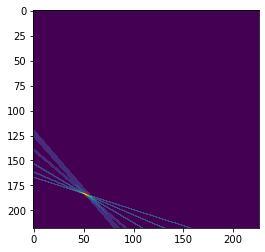

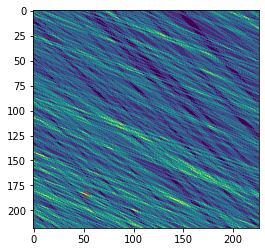

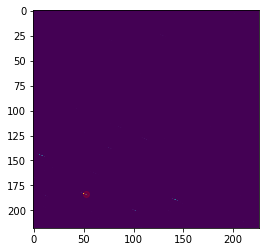

1 2


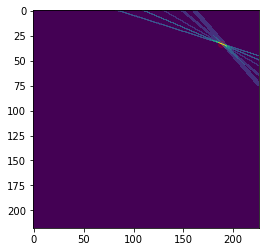

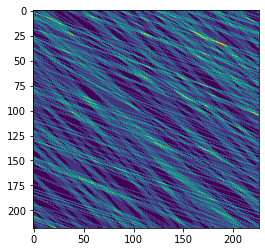

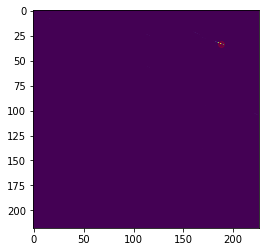

1 4


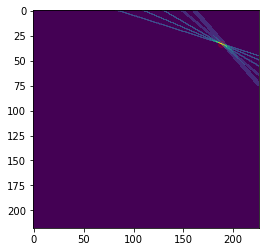

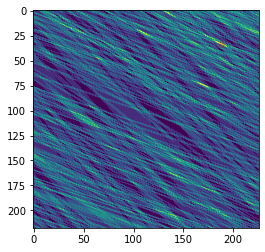

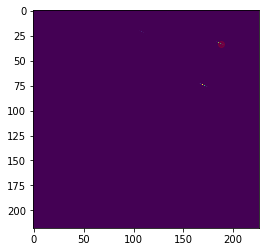

2 0


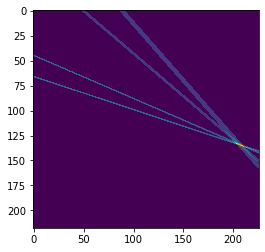

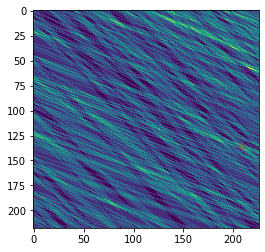

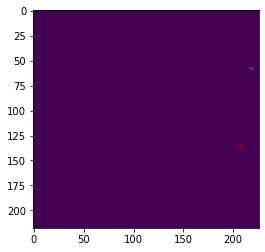

2 1


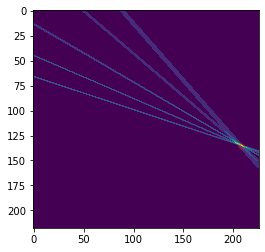

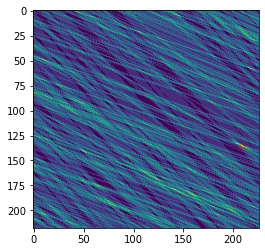

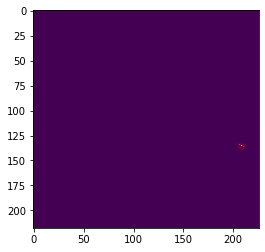

364 474
365 474
366 474
367 474
368 474
369 474
370 474
evaluating
0 3


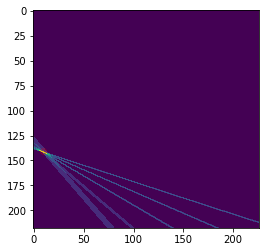

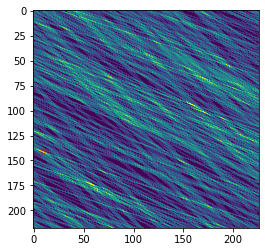

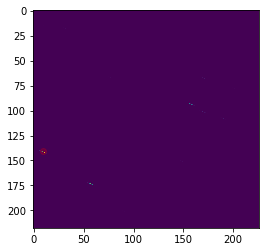

1 0


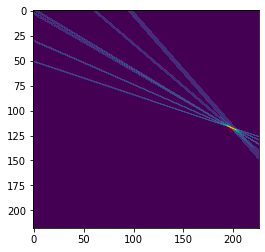

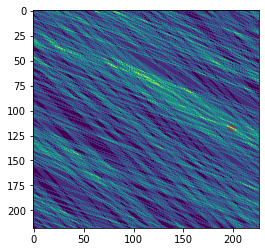

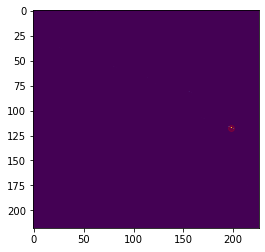

1 5


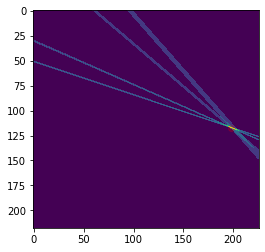

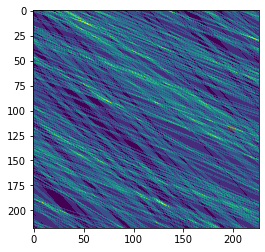

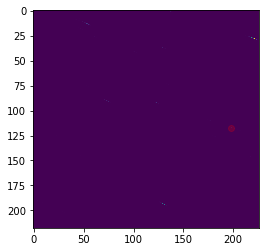

2 0


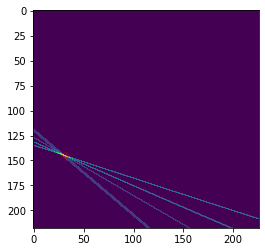

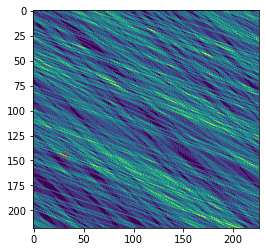

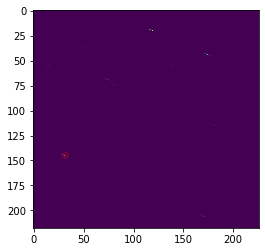

2 1


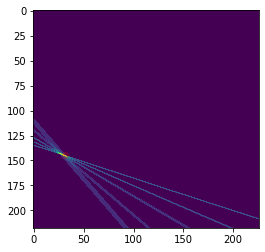

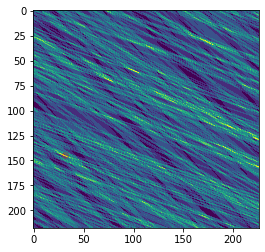

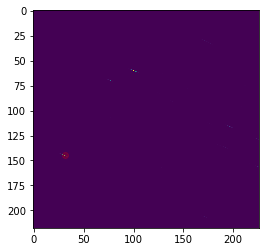

3 4


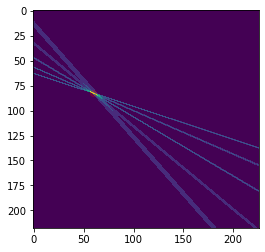

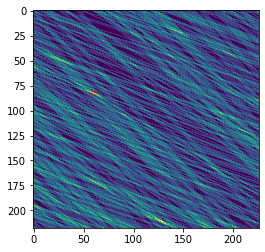

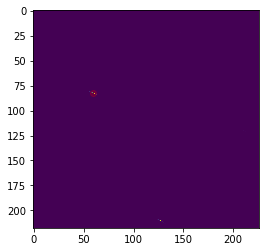

371 474
372 474
373 474
374 474
375 474
376 474
377 474
evaluating
1 0


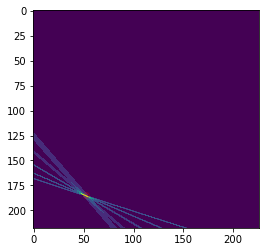

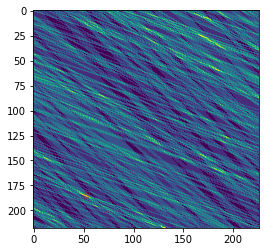

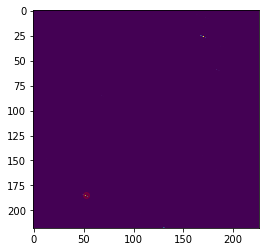

1 5


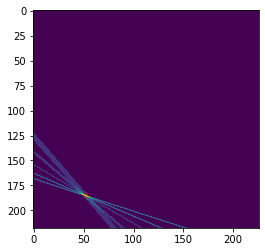

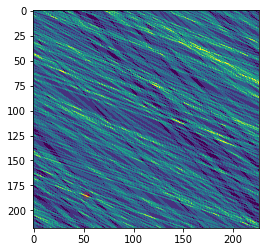

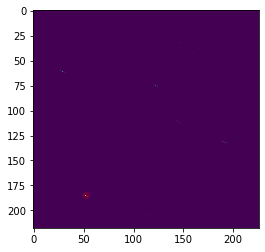

2 2


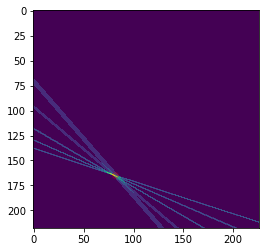

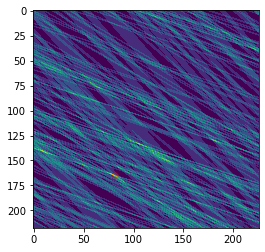

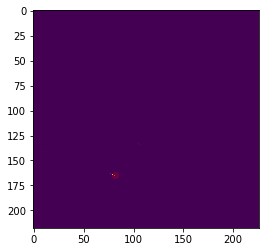

3 1


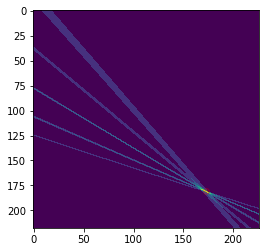

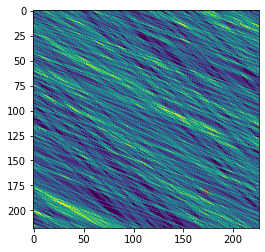

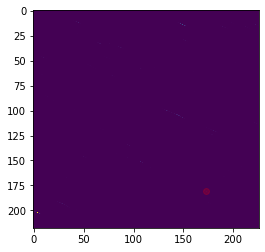

4 5


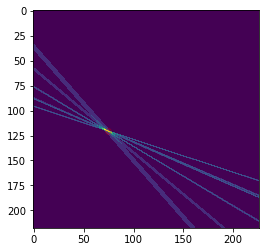

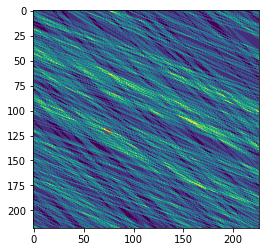

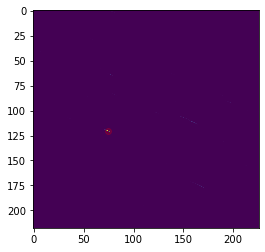

5 2


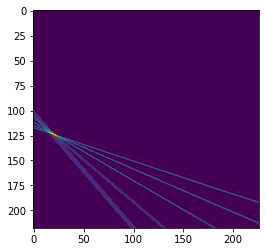

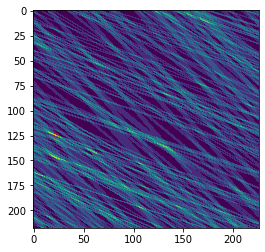

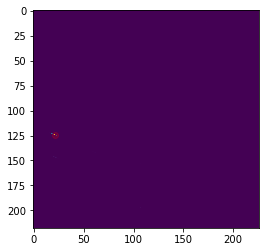

378 474
379 474
380 474
381 474
382 474
383 474
384 474
evaluating
0 0


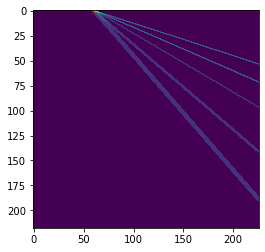

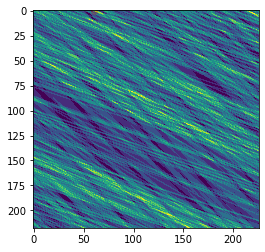

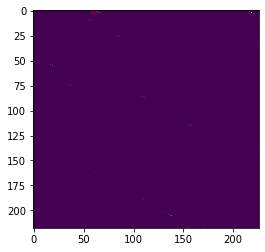

0 5


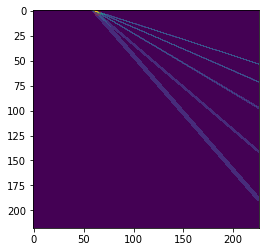

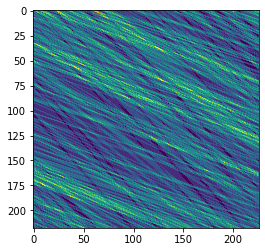

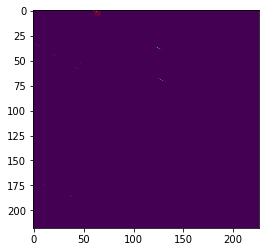

1 4


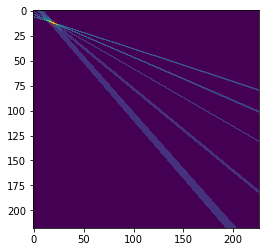

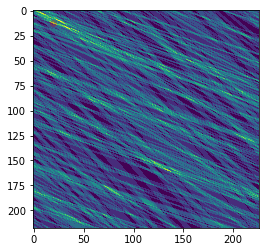

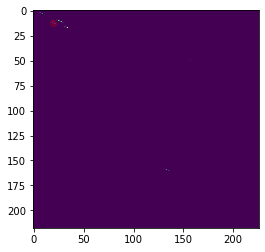

1 5


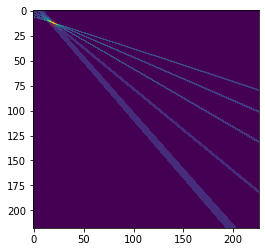

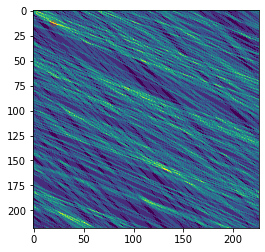

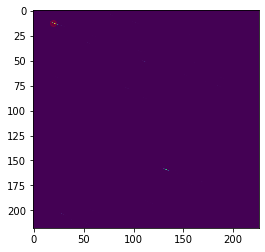

2 3


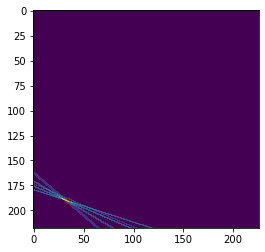

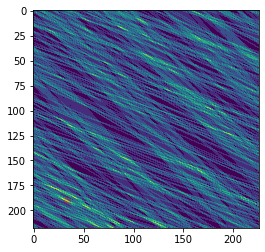

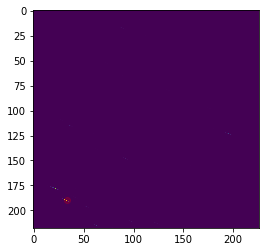

3 3


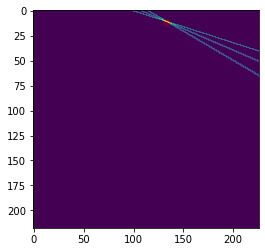

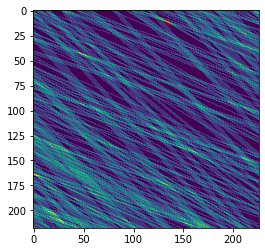

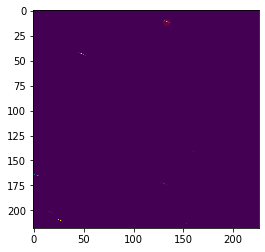

385 474
386 474
387 474
388 474
389 474
390 474
391 474
evaluating
0 5


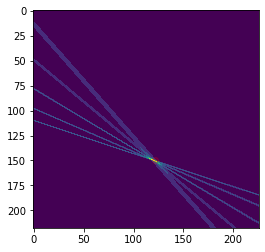

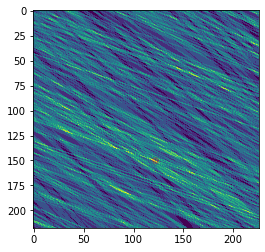

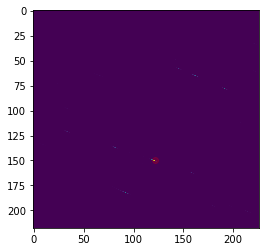

2 0


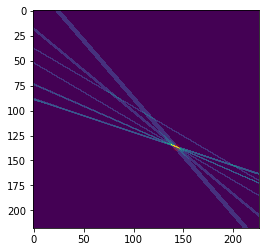

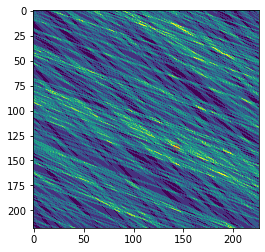

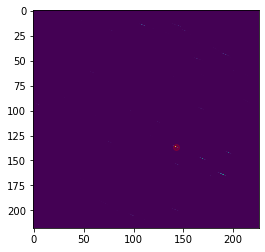

2 1


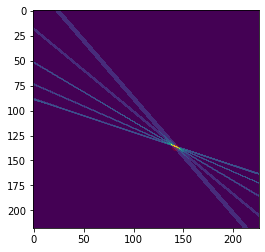

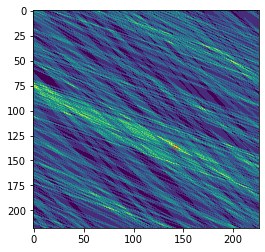

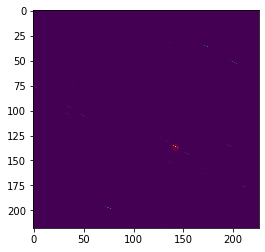

3 1


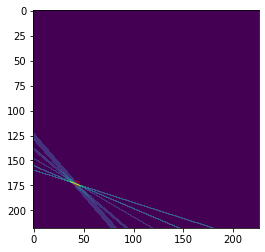

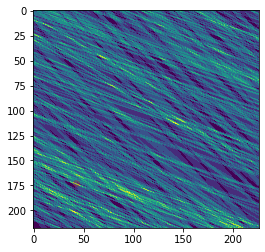

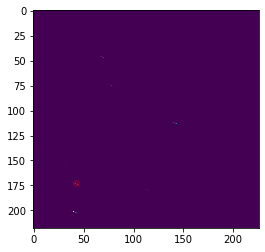

3 3


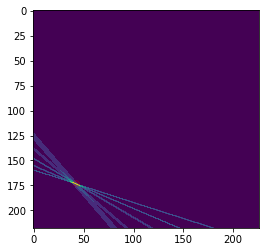

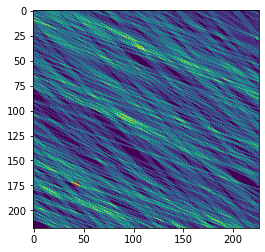

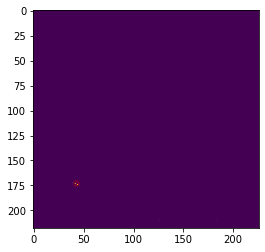

4 4


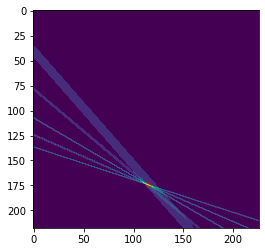

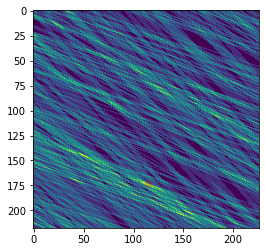

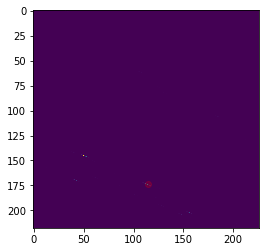

392 474
393 474
394 474
395 474
396 474
397 474
398 474
evaluating
0 0


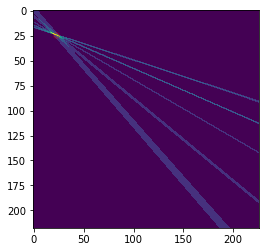

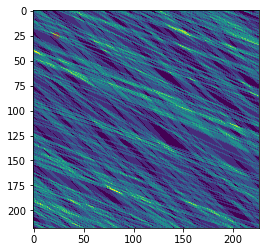

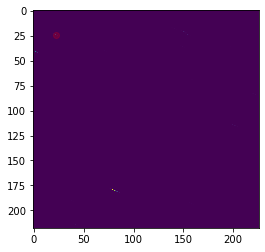

0 5


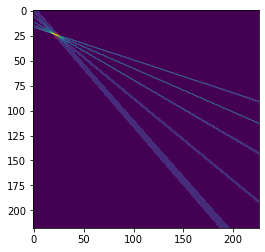

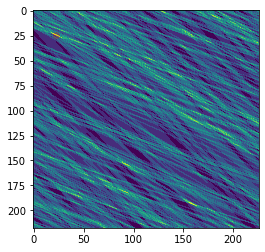

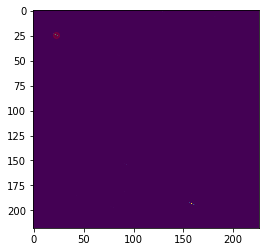

1 3


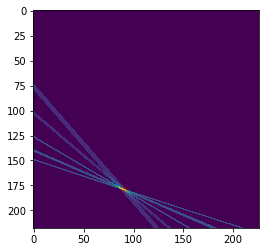

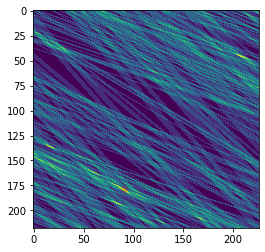

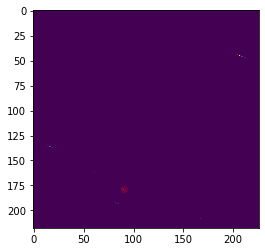

2 4


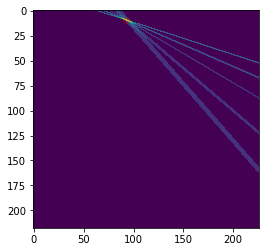

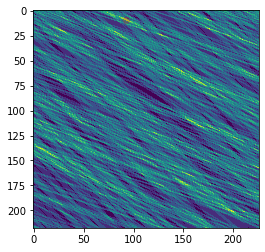

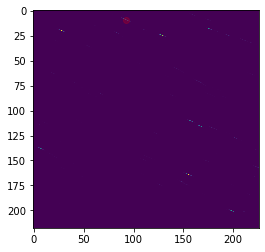

2 5


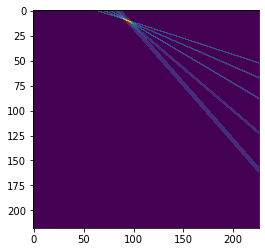

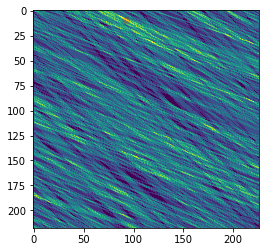

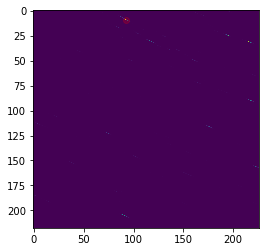

3 0


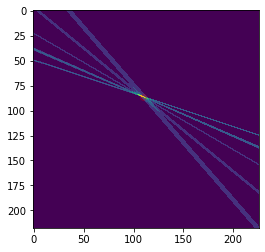

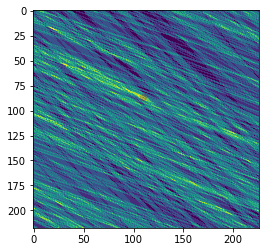

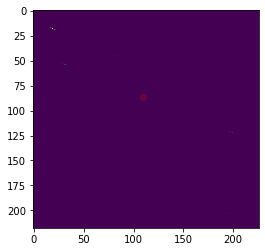

399 474
400 474
401 474
402 474
403 474
404 474
405 474
evaluating
0 4


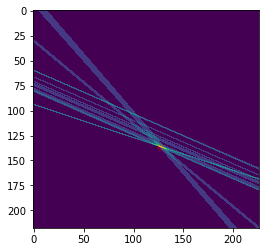

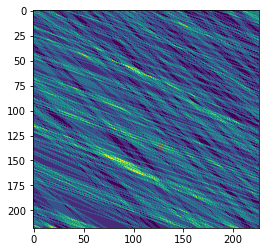

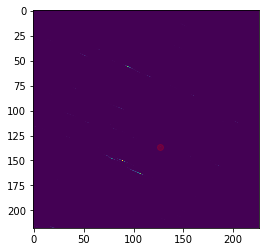

0 5


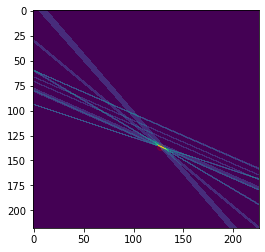

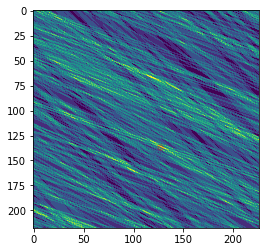

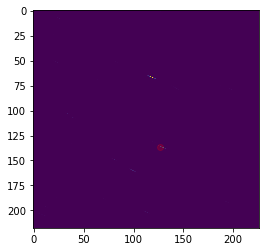

1 5


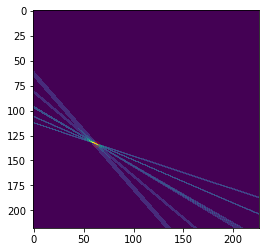

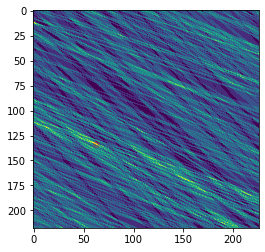

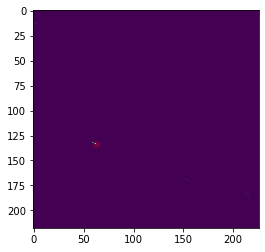

2 0


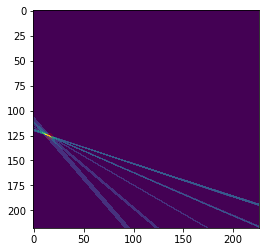

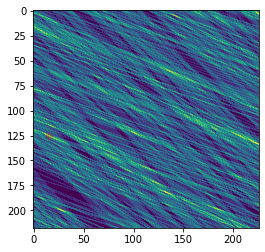

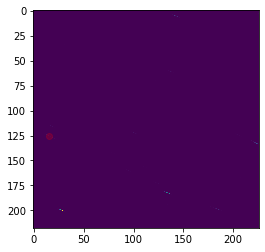

2 1


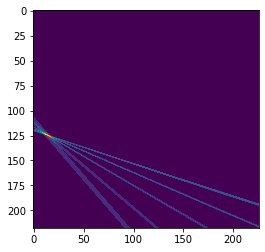

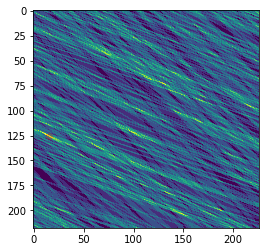

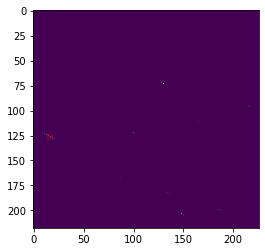

3 5


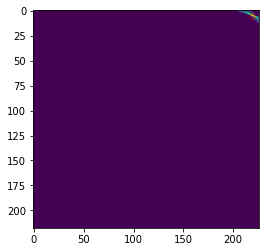

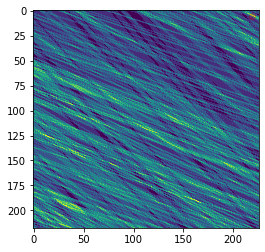

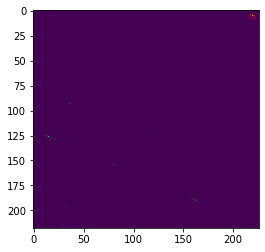

406 474
407 474
408 474
409 474
410 474
411 474
412 474
evaluating
0 4


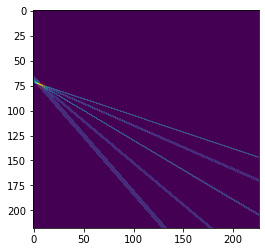

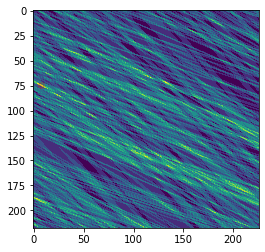

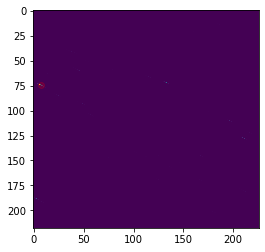

0 5


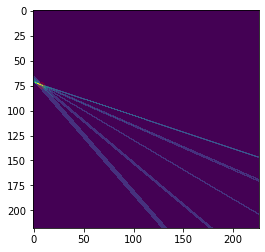

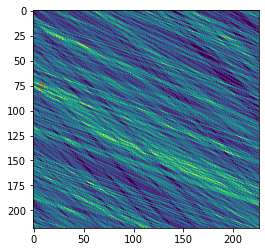

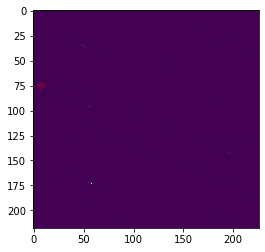

1 0


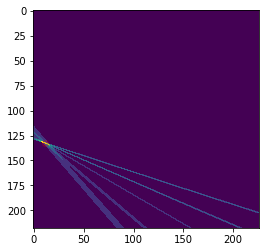

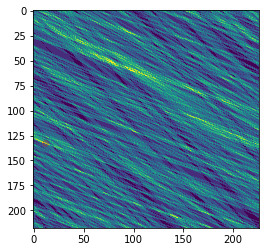

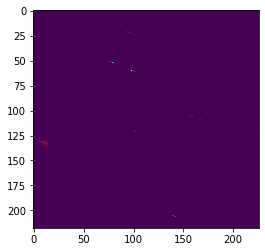

1 1


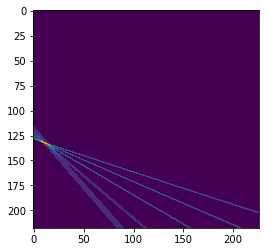

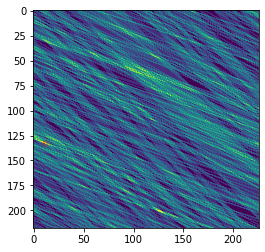

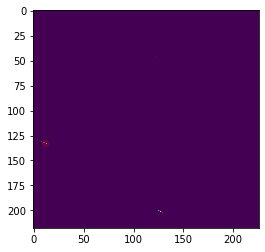

2 5


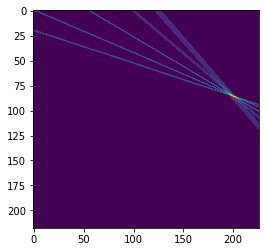

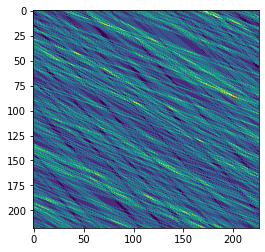

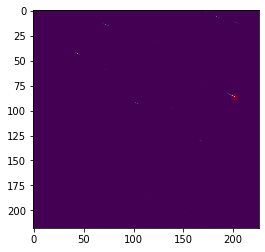

3 2


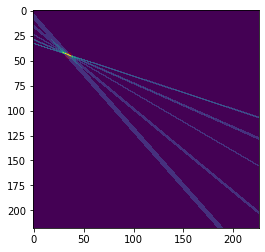

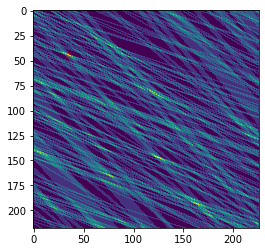

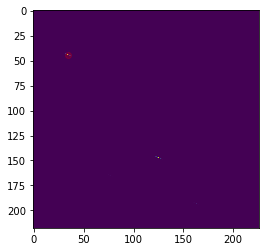

413 474
414 474
415 474
416 474
417 474
418 474
419 474
evaluating
0 2


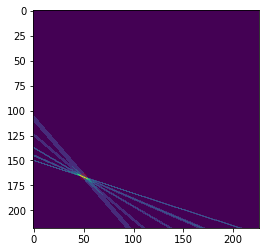

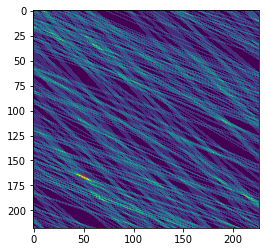

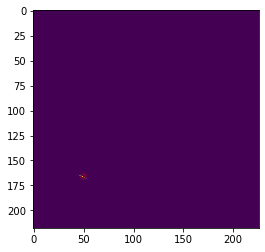

1 0


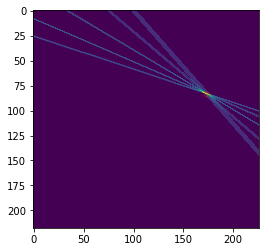

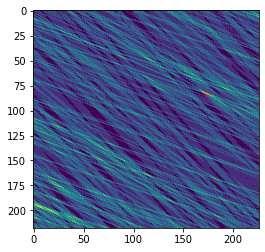

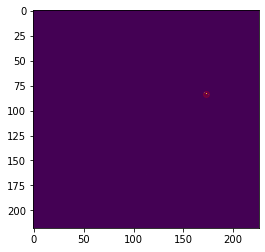

1 5


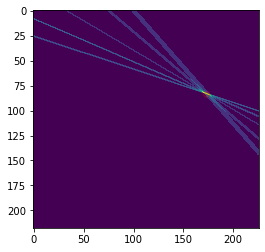

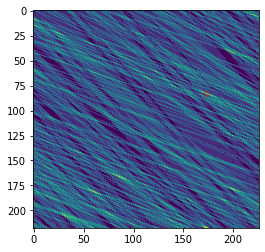

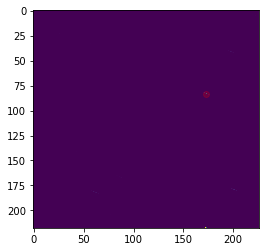

2 4


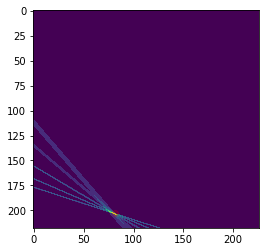

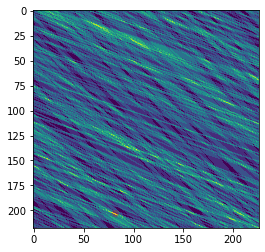

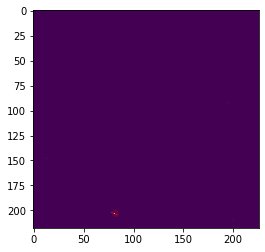

2 5


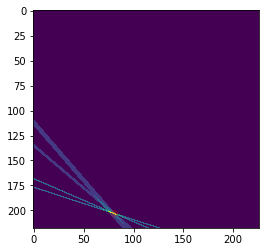

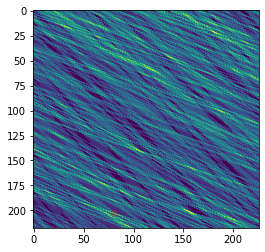

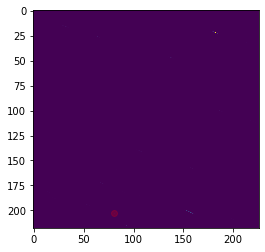

3 0


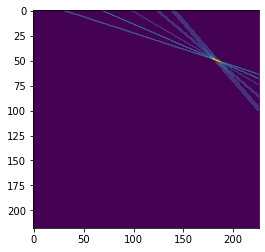

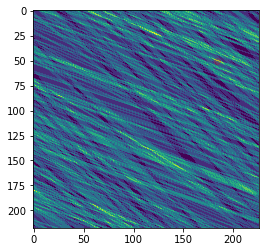

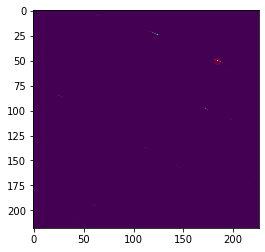

420 474
421 474
422 474
423 474
424 474
425 474
426 474
evaluating
0 0


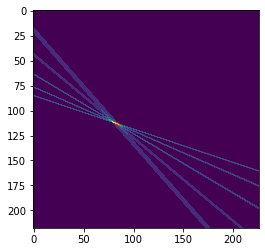

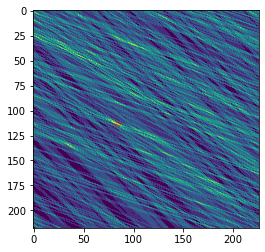

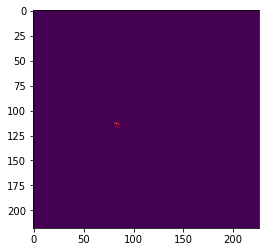

0 1


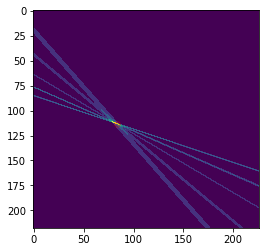

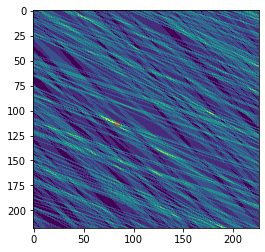

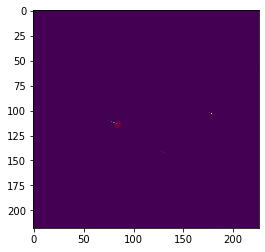

1 2


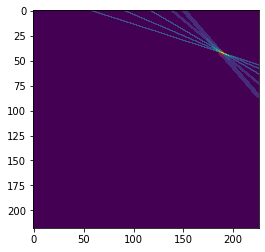

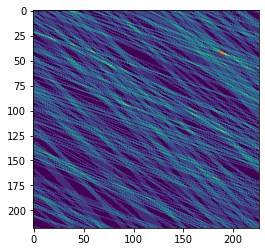

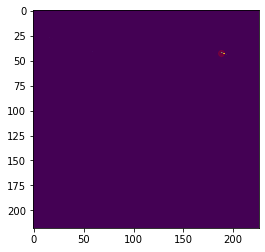

2 2


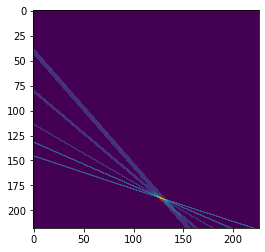

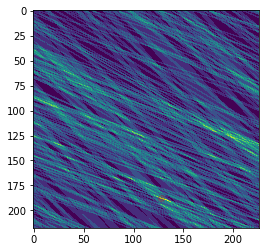

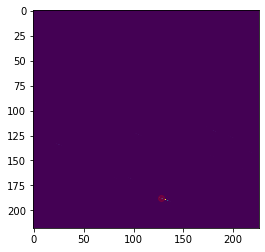

2 4


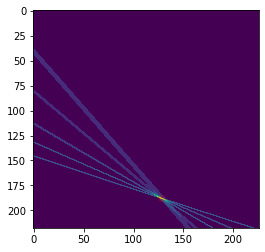

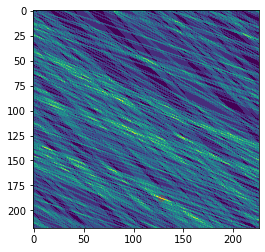

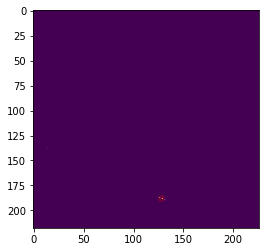

3 3


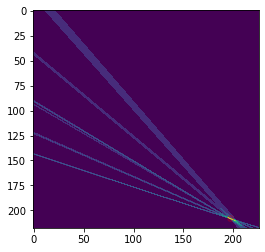

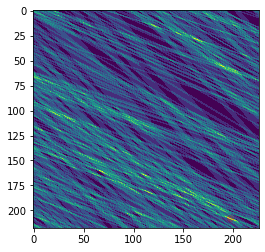

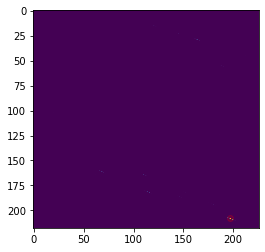

427 474
428 474
429 474
430 474
431 474
432 474
433 474
evaluating
1 2


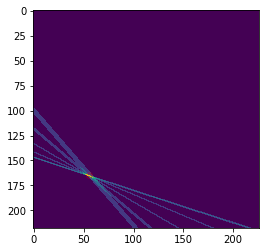

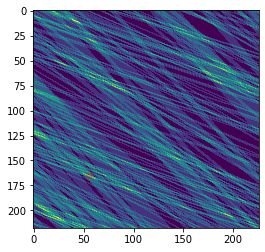

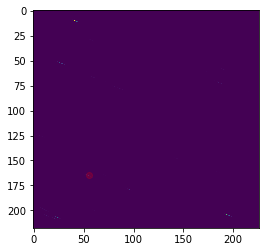

1 4


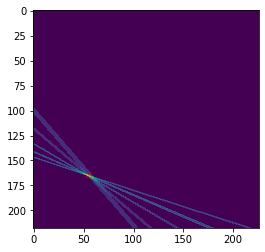

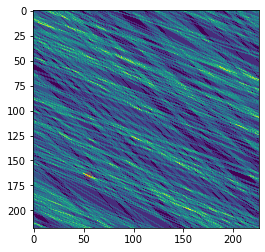

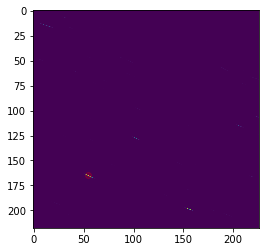

2 4


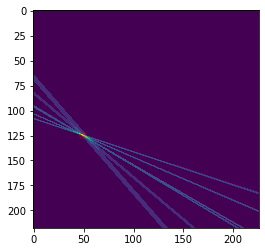

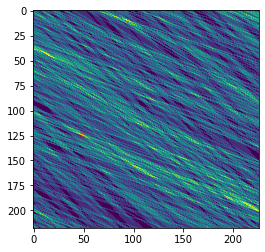

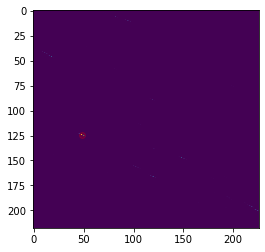

3 0


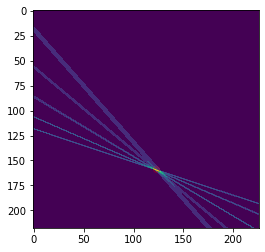

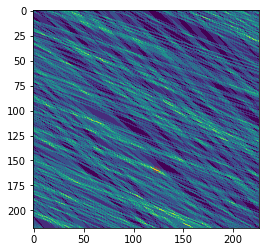

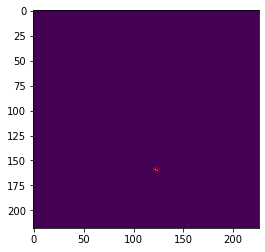

3 5


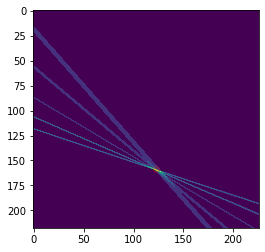

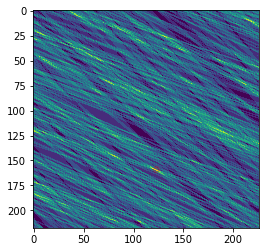

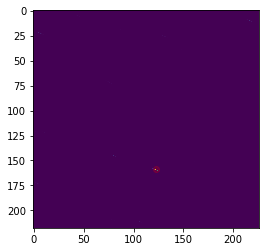

4 0


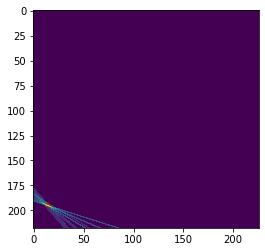

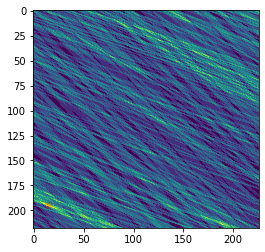

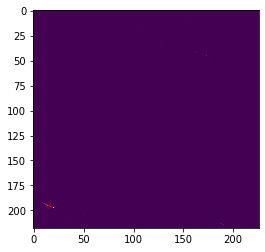

434 474
435 474
436 474
437 474
438 474
439 474
440 474
evaluating
0 0


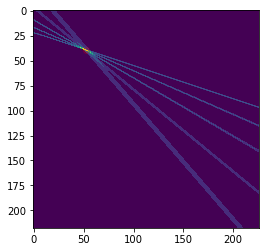

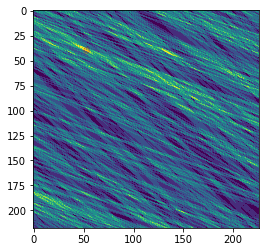

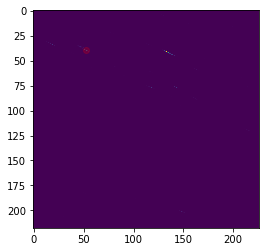

0 5


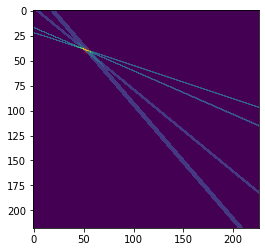

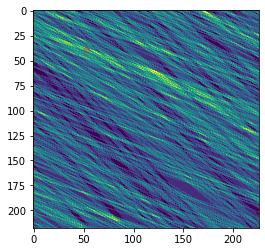

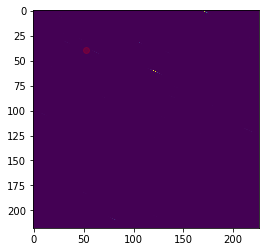

1 4


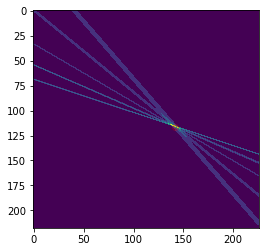

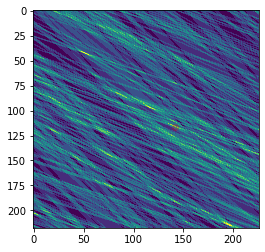

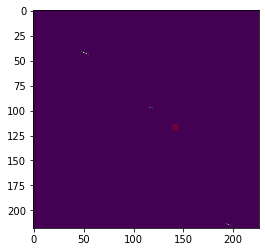

1 5


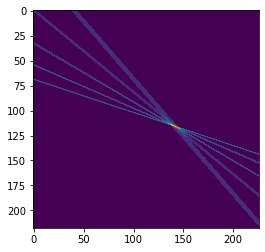

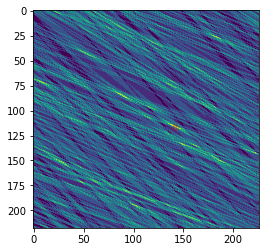

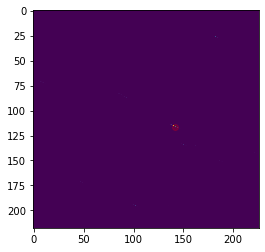

2 3


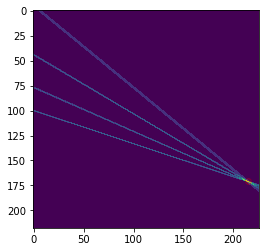

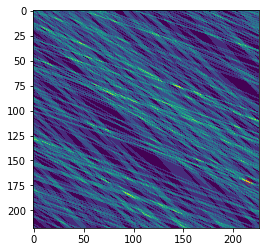

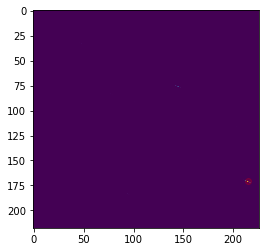

3 0


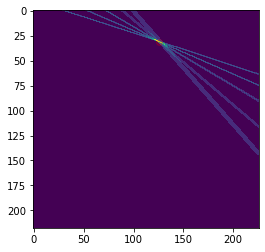

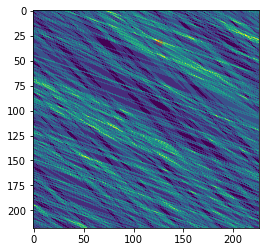

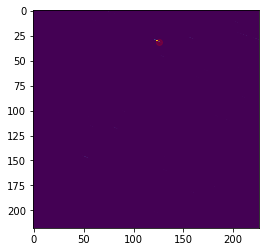

441 474
442 474
443 474
444 474
445 474
446 474
447 474
evaluating
0 4


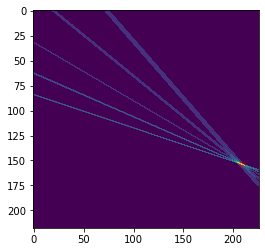

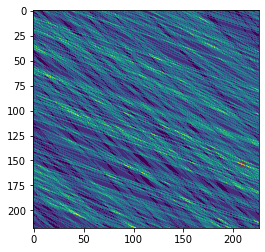

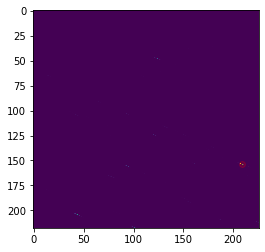

0 5


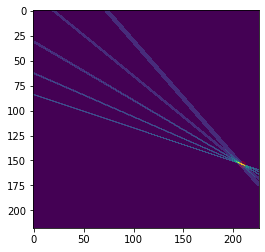

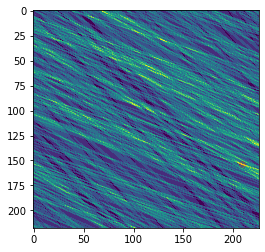

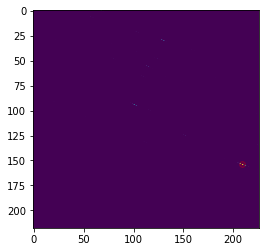

1 3


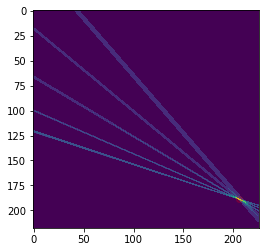

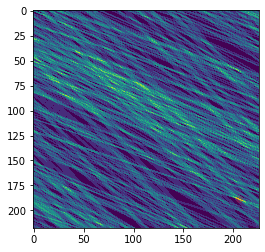

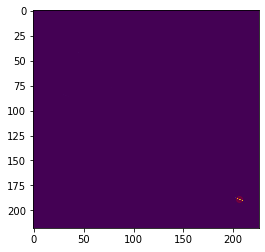

2 0


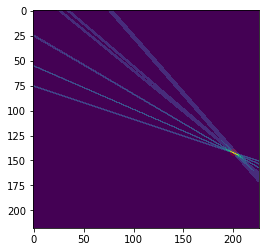

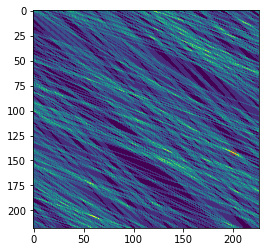

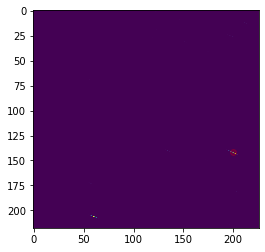

3 4


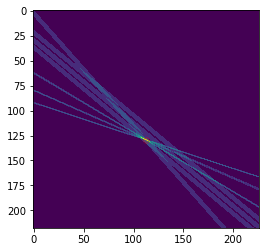

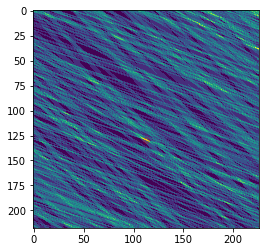

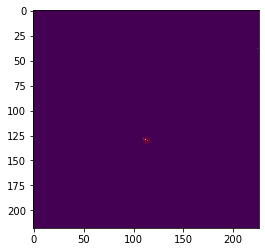

3 5


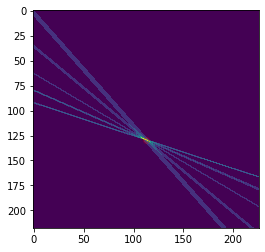

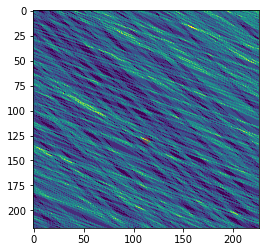

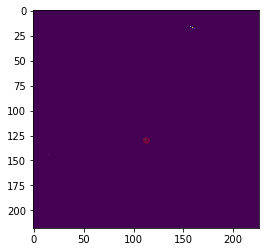

448 474
449 474
450 474
451 474
452 474
453 474
454 474
evaluating
0 0


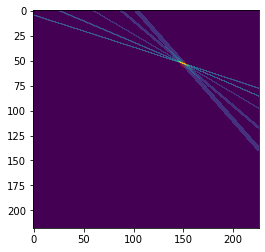

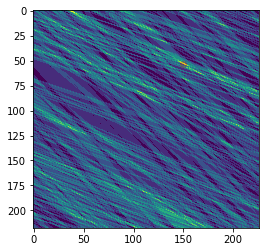

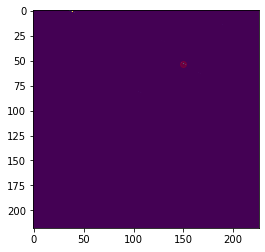

0 5


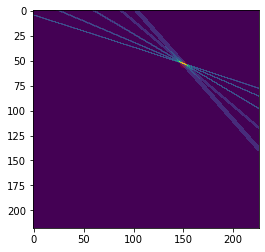

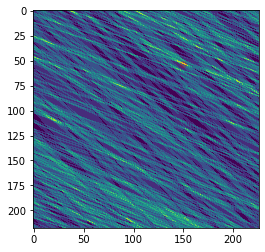

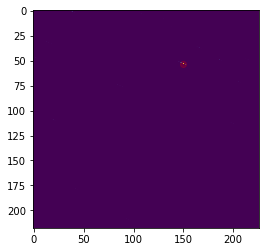

1 0


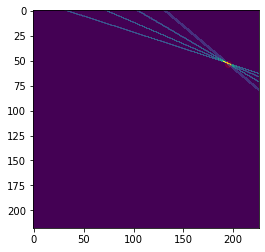

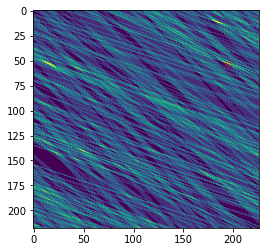

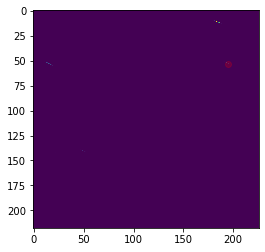

1 5


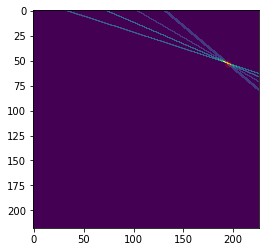

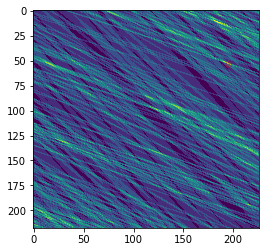

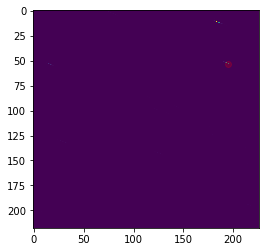

2 4


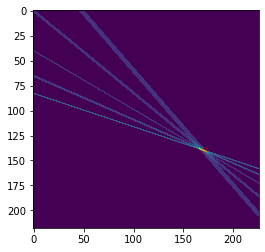

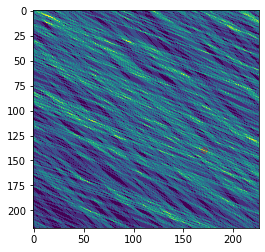

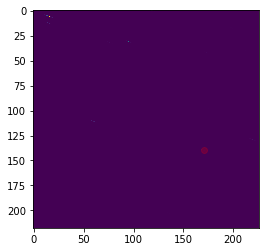

2 5


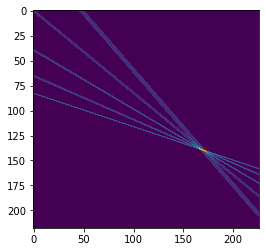

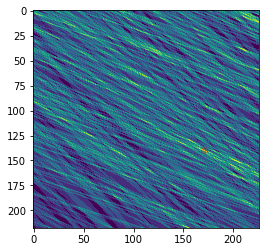

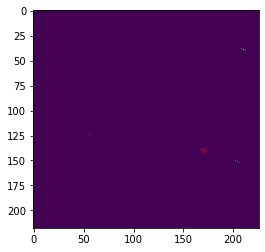

455 474
456 474
457 474
458 474
459 474
460 474
461 474
evaluating
0 3


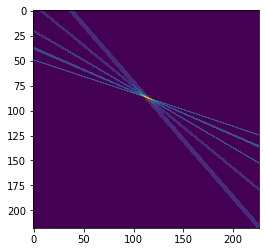

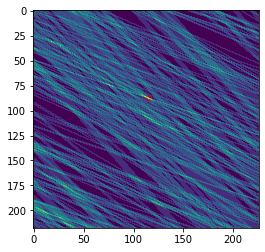

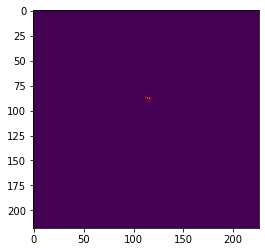

1 0


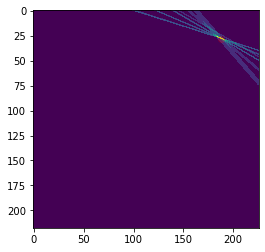

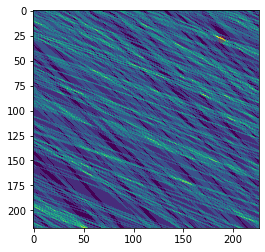

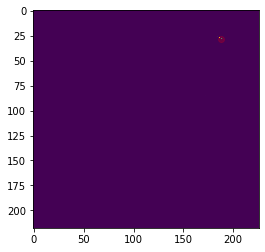

1 5


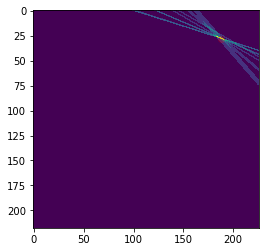

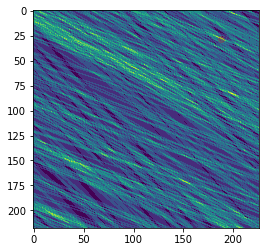

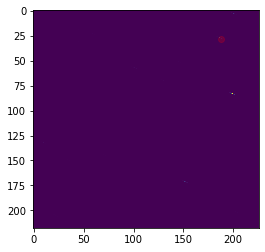

2 0


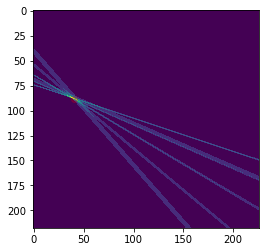

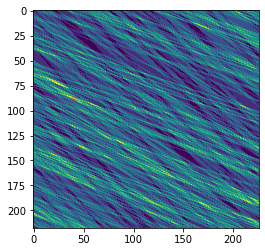

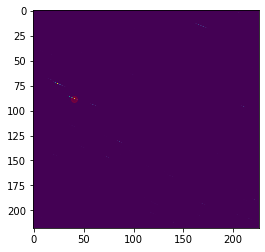

2 5


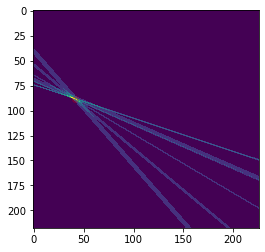

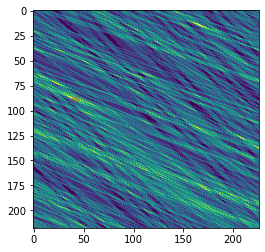

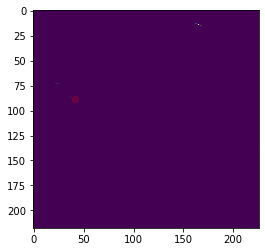

3 4


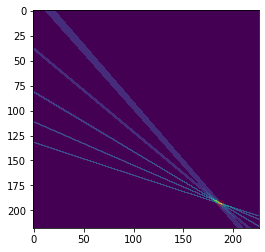

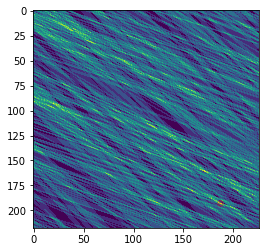

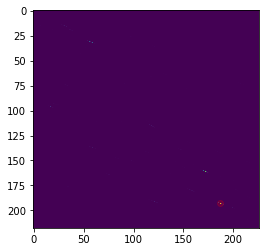

462 474
463 474
464 474
465 474
466 474
467 474
468 474
evaluating
0 0


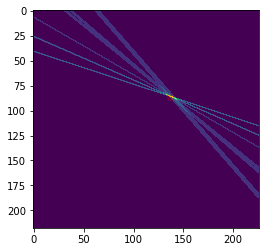

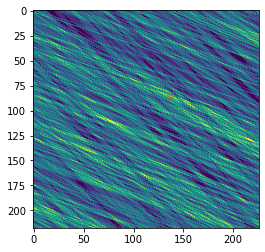

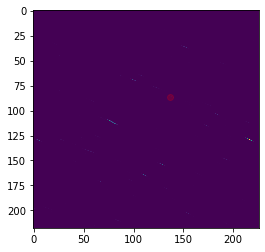

0 5


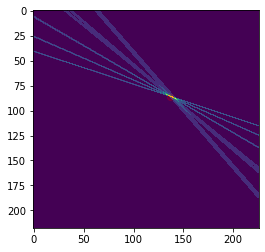

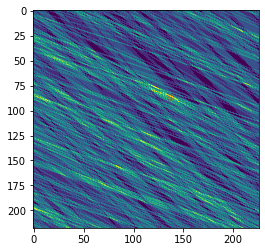

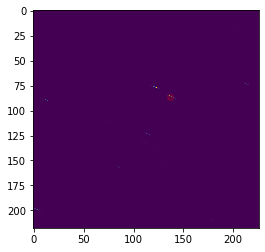

1 0


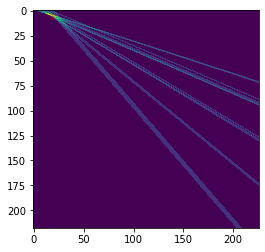

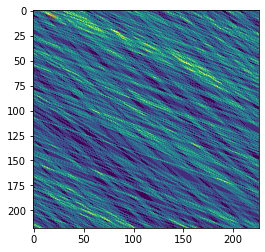

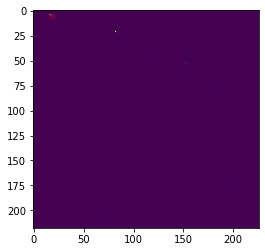

2 0


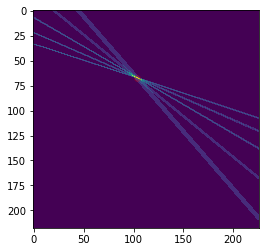

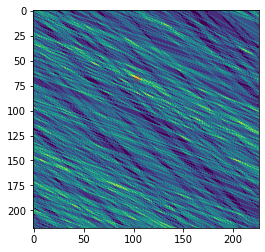

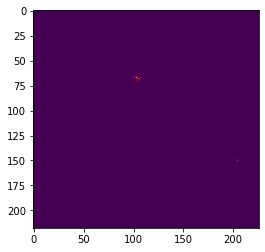

2 1


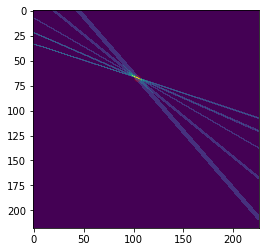

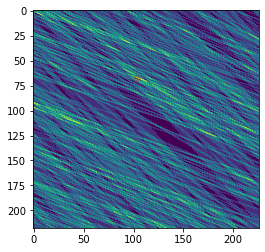

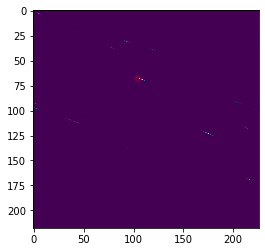

3 0


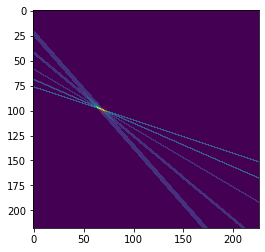

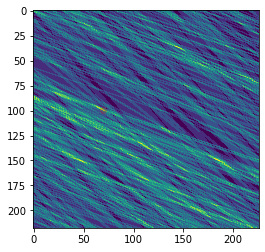

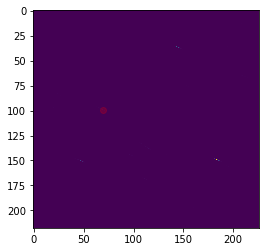

469 474
470 474
471 474
472 474
473 474
Total roads:  3206124180
Thresholt100p:  tensor(0.)
tensor([0.0000e+00, 0.0000e+00, 0.0000e+00, 3.1677e-05, 1.0215e-04, 1.8050e-04,
        1.8937e-04, 1.9497e-04, 1.9954e-04, 2.0474e-04, 2.1734e-04, 2.8015e-04,
        2.9214e-04, 3.0783e-04, 3.2229e-04, 3.6240e-04, 3.7808e-04, 3.8311e-04,
        3.9594e-04, 4.0590e-04, 4.7794e-04, 4.7824e-04, 5.6957e-04, 5.9909e-04,
        6.3107e-04, 6.3952e-04, 6.5607e-04, 6.9344e-04, 7.6581e-04, 7.9739e-04,
        8.4543e-04, 8.8088e-04, 9.0421e-04, 9.0670e-04, 9.0965e-04, 1.0397e-03,
        1.0781e-03, 1.0822e-03, 1.0898e-03, 1.0941e-03, 1.1074e-03, 1.2338e-03,
        1.2621e-03, 1.2698e-03, 1.3755e-03, 1.4446e-03, 1.5257e-03, 1.6410e-03,
        1.7140e-03, 1.7147e-03, 1.7377e-03, 1.7594e-03, 1.7651e-03, 1.7840e-03,
        1.7883e-03, 1.8018e-03, 1.8030e-03, 1.8435e-03, 1.8540e-03, 1.8712e-03,
        1.8816e-03, 1.9695e-03, 1.9856e-03, 2.1016e-03, 2.1030e-03, 2.1036e-03,
        2.1214e-03, 2.1361e-

In [54]:
#This is for making a list of the number of layers that the muon hits along
#With the score assigned to it to be able to make a plot
#See 3x3 maxfinding method
###### COPY MADE FOR COORDINATE DEPENDENCY OR NHIT LAYERS DEPENDENCY######
#finding thresholts FOR MAXFINDINGMETHOD

validptestlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
maxprobs = torch.tensor([[]])
probslist = []
neventscurrent = 0

net.eval()

for i in range(3*nvalidptestmax):
                         
    batches, validptestlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, validptestlists[0], validptestlists[1], i)
    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    MinBiasimage = MinBiasimage
    LoneMuonimage = LoneMuonimage
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage + LoneMuonimage).cuda()
    
    truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage))
    
    if len(truthpoint) > 0:
        truthpoint[:,0] += startingevent #adding to the eventnumber
        iphi0 = (truthpoint[:,3]+1/2).astype(int)
        iqOpT = (truthpoint[:,2]+1/2).astype(int)
        truthslices = truthpoint[:,:2] #Hit events and slices
        
    else:
        iphi0 = torch.tensor([])
        iqOpT = torch.tensor([])
        truthslices = np.empty((0,2))
    
    startingevent += image.shape[0]
    print(i,3*nvalidptestmax)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage
        fulltruthslices = truthslices
        fulliphi0 = iphi0
        fulliqOpT = iqOpT
    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
        if len(truthpoint) > 0:
            fulltruthslices = np.row_stack((fulltruthslices, truthslices))
            fulliphi0 = np.append(fulliphi0, iphi0)
            fulliqOpT = np.append(fulliqOpT, iqOpT)
        
    fulltruth = np.column_stack((fulltruthslices, fulliqOpT, fulliphi0))
    muonimage = fullmuonimage.view(-1, nSl, nbinsQOpT, nbinsphi0)
    
    fullsummed = fullimage.cpu().detach().gt(0)
    fullsummed = torch.sum(fullsummed,2)
    
    
    if (i + 1) % units == 0:
        print("evaluating")
#         firstevent = True
        startingevent = 0
        output, points = model(fullimage)
        output = output.detach()
        points = points.detach()
        
        probs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0)).cpu()
        probs = probs.to_dense()
    
        for index, (ievent, iSl, iq, ip) in enumerate(fulltruth):
            ievent = int(ievent)
            iSl = int(iSl)

            if index <= 5:
                print(ievent, iSl)

                plt.imshow(fullmuonimage[ievent,iSl][1:-1,1:-1], vmax = torch.max(fullmuonimage[ievent,iSl][1:-1,1:-1]))
                plt.scatter(fulliphi0[index]-1, fulliqOpT[index]-1, alpha=0.2, color = "r")
                plt.show()

                plt.imshow(fullsummed[ievent,iSl][1:-1,1:-1], vmax = torch.max(fullsummed[ievent,iSl][1:-1,1:-1]))
                plt.scatter(fulliphi0[index]-1, fulliqOpT[index]-1, alpha=0.2, color = "r")
                plt.show()

                plt.imshow(probs[ievent,iSl][1:-1,1:-1], vmax = torch.max(probs[ievent,iSl][1:-1,1:-1]))
                plt.scatter(fulliphi0[index]-1, fulliqOpT[index]-1, alpha=0.2, color = "r")
                plt.show()

                        
        curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0))
        curprobs = curprobs.to_dense()[:,:,1:-1,1:-1]
    
        
        muonimage = muonimage.reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        padcurprobs = torch.zeros((curprobs.shape[0], curprobs.shape[1] + 2, curprobs.shape[2] + 2, curprobs.shape[3] + 2)).cuda()
        padcurprobs[:,1:-1,1:-1,1:-1] = curprobs
        peakprobpoints = torch.ones_like(curprobs).bool().cuda()

        for iq in range(-1,2):
            for ip in range(-1,2):
                if (iq != 0 or ip != 0):
                    peakprobpoints *= curprobs.ge(padcurprobs[:, 1: nSl+1, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    
        
        peakprobs = torch.zeros_like(curprobs).cuda()
        peakprobs[peakprobpoints] = curprobs[peakprobpoints]
        
        
        for ievent, event in enumerate(fullimage):
            maxslice = torch.max(muonimage[ievent]).item() #Number of hit layers
    
            masks = muonimage[ievent].ge(6) #
            
#             if torch.sum(masks) > 0:
                if torch.max(muonimage[ievent]).ge(6):
                    maxprob = torch.max(torch.masked_select(peakprobs[ievent], masks))

                    #List including number of hitlayers inside a single slice by muon
                    probslist += [[neventscurrent + ievent, maxslice, maxprob.item()]]


                    if maxprobs.nelement() == 0:
                        maxprobs = torch.tensor([[maxprob]])

                    else:
                        maxprobs = torch.cat((maxprobs, torch.tensor([[maxprob]])), 1)

                else:
                    neventscurrent -= 1
    
#             else:
#                 neventscurrent -= 1
                

        neventscurrent += output.shape[0]

ntotal = output.shape[-1]*nSl*torch.numel(maxprobs)

thresholt100p = torch.min(maxprobs)

print("Total roads: ", ntotal)
print("Thresholt100p: ", thresholt100p)

ntruth = maxprobs.shape[-1]
n0p = 0
np15p = int(0.15*ntruth/100 + 0.5)
np3p = int(0.3*ntruth/100 + 0.5)
np4p = int(0.4*ntruth/100 + 0.5)
np5p = int(0.5*ntruth/100 + 0.5)
n1p = int(ntruth/100 + 0.5)
n1p3p = int(1.3*ntruth/100 + 0.5)
n1p5p = int(1.5*ntruth/100 + 0.5)
n2p = int(2*ntruth/100 + 0.5)
n5p = int(5*ntruth/100 + 0.5)
n10p = int(10*ntruth/100 + 0.5)

_10plowest = torch.topk(maxprobs.squeeze(), n10p+1, largest=False) #want to find the first that is not within the 2 %
print(_10plowest[0])
_100p = _10plowest[0][n0p]
_99p85p = _10plowest[0][np15p]
_99p7p = _10plowest[0][np3p]
_99p6p = _10plowest[0][np4p]
_99p5p = _10plowest[0][np5p]
_98p = _10plowest[0][n2p]
_98p5p = _10plowest[0][n1p5p]
_98p7p = _10plowest[0][n1p3p]
_99p = _10plowest[0][n1p] #-1 for 0 indexing +1 for 99 % side not 1% side.
_95p = _10plowest[0][n5p]
_90p = _10plowest[0][n10p]

print(_100p, _99p85p, _99p7p, _99p6p, _99p5p, _99p, _98p7p, _98p5p, _98p, _95p, _90p)

In [55]:
probsarray = np.array(probslist)
#Assigning 1's and 0's depending on whether it exceeds threshold 99%
probsfound = np.column_stack((probsarray, np.zeros((probsarray.shape[0],1))))
for i in range(len(probsfound)):
    if probsfound[i,2] >= _99p.item():
        probsfound[i,-1] = 1
        
#Total number of muons in each catgory
allhist = np.array([np.sum(probsfound[:,1] == 6), np.sum(probsfound[:,1] == 7),
                   np.sum(probsfound[:,1] == 8)])

#Found muons in each catagory
foundhist = np.array([np.sum(probsfound[probsfound[:,-1] == 1,1] == 6),
                      np.sum(probsfound[probsfound[:,-1] == 1,1] == 7),
                      np.sum(probsfound[probsfound[:,-1] == 1,1] == 8)])

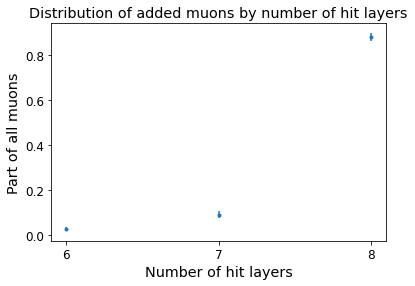

In [61]:
part = allhist/np.sum(allhist)
err = eff_bayes_binomial_std(allhist/3,np.sum(allhist)/3)

plt.figure(figsize = (6, 4))
plt.errorbar(np.linspace(6,8,3), allhist/np.sum(allhist), yerr = err, label = "Muons", fmt = ".")
plt.title("Distribution of added muons by number of hit layers",fontsize='x-large')
plt.xlabel("Number of hit layers",fontsize='x-large')
plt.ylabel("Part of all muons",fontsize='x-large')
plt.xticks(np.linspace(6,8,3), fontsize='large')
plt.yticks(fontsize='large')

plt.show()

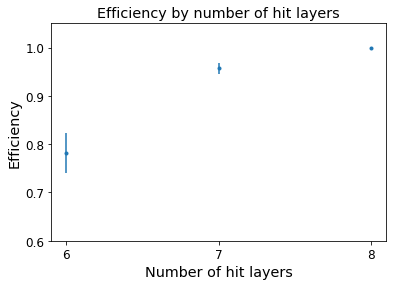

In [66]:
plt.figure(figsize = (6, 4))
err = eff_bayes_binomial_std(foundhist,allhist)
val = plt.errorbar(np.linspace(6,8,3), foundhist/allhist, yerr = err, label = "Found muons", fmt = ".")

# plt.ylim(0.8,1)
# plt.legend(fontsize='x-large')
plt.title("Efficiency by number of hit layers",fontsize='x-large')
plt.xlabel("Number of hit layers",fontsize='x-large')
plt.ylabel("Efficiency",fontsize='x-large')
# plt.xticks(imagexticks, imagexlabels)
plt.xticks(np.linspace(6,8,3), fontsize='large')
plt.ylim([0.6,1.05])
plt.yticks(fontsize='large')
plt.show()

In [67]:
#This is for making a list of the number of layers that the muon hits along
#With the score assigned to it to be able to make a plot
###### COPY MADE FOR COORDINATE DEPENDENCY for Q,P DEPENDENCY######
#finding thresholts FOR MAXFINDINGMETHOD
validptestlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
maxprobs = torch.tensor([[]])
probslist = []
neventscurrent = 0

net.eval()

for i in range(3*nvalidptestmax):
                         
    batches, validptestlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, validptestlists[0], validptestlists[1], i)
    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    MinBiasimage = MinBiasimage
    LoneMuonimage = LoneMuonimage
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage + LoneMuonimage).cuda()
    
    truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage))
    
    if len(truthpoint) > 0:
        truthpoint[:,0] += startingevent #adding to the eventnumber
        iphi0 = (truthpoint[:,3]+1/2).astype(int)
        iqOpT = (truthpoint[:,2]+1/2).astype(int)
        truthslices = truthpoint[:,:2] #Hit events and slices
        
    else:
        iphi0 = torch.tensor([])
        iqOpT = torch.tensor([])
        truthslices = np.empty((0,2))
    
    startingevent += image.shape[0]
    print(i,3*nvalidptestmax)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage
        fulltruthslices = truthslices
        fulliphi0 = iphi0
        fulliqOpT = iqOpT
    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
        if len(truthpoint) > 0:
            fulltruthslices = np.row_stack((fulltruthslices, truthslices))
            fulliphi0 = np.append(fulliphi0, iphi0)
            fulliqOpT = np.append(fulliqOpT, iqOpT)
        
    fulltruth = np.column_stack((fulltruthslices, fulliqOpT, fulliphi0))
    muonimage = fullmuonimage.view(-1, nSl, nbinsQOpT, nbinsphi0)
    
    fullsummed = fullimage.cpu().detach().gt(0)
    fullsummed = torch.sum(fullsummed,2)
    
    
    if (i + 1) % units == 0:
        print("evaluating")
        firstevent = True
        startingevent = 0
        output, points = model(fullimage)
        output = output.detach()
        points = points.detach()
        
        probs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0)).cpu()
        probs = probs.to_dense()
    
        curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0))
        curprobs = curprobs.to_dense()[:,:,1:-1,1:-1]
    
        iprevevent = -1
        
        muonimage = muonimage.reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        padcurprobs = torch.zeros((curprobs.shape[0], curprobs.shape[1] + 2, curprobs.shape[2] + 2, curprobs.shape[3] + 2)).cuda()
        padcurprobs[:,1:-1,1:-1,1:-1] = curprobs
        peakprobpoints = torch.ones_like(curprobs).bool().cuda()
        

        for iq in range(-1,2):
            for ip in range(-1,2):
                if (iq != 0 or ip != 0):
                    peakprobpoints *= curprobs.ge(padcurprobs[:, 1: nSl+1, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])

        
        peakprobs = torch.zeros_like(curprobs).cuda()
        peakprobs[peakprobpoints] = curprobs[peakprobpoints]
        
        
        for ievent, event in enumerate(fullimage):
            maxslice = torch.max(muonimage[ievent]).item() #Misleading name, maximal value of muonimage
    
            masks = muonimage[ievent].ge(6) #
            
            if torch.sum(masks) > 0:
                if torch.max(muonimage[ievent]).ge(6):
                    maxprob = torch.max(torch.masked_select(peakprobs[ievent], masks))
                    coordinates = torch.nonzero(masks)
                    maxindice = torch.argmax(torch.masked_select(peakprobs[ievent], masks))
                    maxcoordinate = coordinates[maxindice]
                    probslist += [[neventscurrent + ievent, maxslice, maxprob.item(), maxcoordinate[1].item(), maxcoordinate[2].item()]]


                    if maxprobs.nelement() == 0:
                        maxprobs = torch.tensor([[maxprob]])

                    else:
                        maxprobs = torch.cat((maxprobs, torch.tensor([[maxprob]])), 1)

                else:
                    neventscurrent -= 1
    
            else:
                neventscurrent -= 1
                

        neventscurrent += output.shape[0]

ntotal = output.shape[-1]*nSl*torch.numel(maxprobs)

thresholt100p = torch.min(maxprobs)

print("Total roads: ", ntotal)
print("Thresholt100p: ", thresholt100p)

ntruth = maxprobs.shape[-1]
n0p = 0
np15p = int(0.15*ntruth/100 + 0.5)
np3p = int(0.3*ntruth/100 + 0.5)
np4p = int(0.4*ntruth/100 + 0.5)
np5p = int(0.5*ntruth/100 + 0.5)
n1p = int(ntruth/100 + 0.5)
n1p3p = int(1.3*ntruth/100 + 0.5)
n1p5p = int(1.5*ntruth/100 + 0.5)
n2p = int(2*ntruth/100 + 0.5)
n5p = int(5*ntruth/100 + 0.5)
n10p = int(10*ntruth/100 + 0.5)

_10plowest = torch.topk(maxprobs.squeeze(), n10p+1, largest=False) #want to find the first that is not within the 2 %
print(_10plowest[0])
_100p = _10plowest[0][n0p]
_99p85p = _10plowest[0][np15p]
_99p7p = _10plowest[0][np3p]
_99p6p = _10plowest[0][np4p]
_99p5p = _10plowest[0][np5p]
_98p = _10plowest[0][n2p]
_98p5p = _10plowest[0][n1p5p]
_98p7p = _10plowest[0][n1p3p]
_99p = _10plowest[0][n1p] #-1 for 0 indexing +1 for 99 % side not 1% side.
_95p = _10plowest[0][n5p]
_90p = _10plowest[0][n10p]

print(_100p, _99p85p, _99p7p, _99p6p, _99p5p, _99p, _98p7p, _98p5p, _98p, _95p, _90p)

0 474
1 474
2 474
3 474
4 474
5 474
6 474
evaluating
7 474
8 474
9 474
10 474
11 474
12 474
13 474
evaluating
14 474
15 474
16 474
17 474
18 474
19 474
20 474
evaluating
21 474
22 474
23 474
24 474
25 474
26 474
27 474
evaluating
28 474
29 474
30 474
31 474
32 474
33 474
34 474
evaluating
35 474
36 474
37 474
38 474
39 474
40 474
41 474
evaluating
42 474
43 474
44 474
45 474
46 474
47 474
48 474
evaluating
49 474
50 474
51 474
52 474
53 474
54 474
55 474
evaluating
56 474
57 474
58 474
59 474
60 474
61 474
62 474
evaluating
63 474
64 474
65 474
66 474
67 474
68 474
69 474
evaluating
70 474
71 474
72 474
73 474
74 474
75 474
76 474
evaluating
77 474
78 474
79 474
80 474
81 474
82 474
83 474
evaluating
84 474
85 474
86 474
87 474
88 474
89 474
90 474
evaluating
91 474
92 474
93 474
94 474
95 474
96 474
97 474
evaluating
98 474
99 474
100 474
101 474
102 474
103 474
104 474
evaluating
105 474
106 474
107 474
108 474
109 474
110 474
111 474
evaluating
112 474
113 474
114 474
115 474
116 47

In [68]:
#/pT-version
probsarray = np.array(probslist)
probsfound = np.column_stack((probsarray, np.zeros((probsarray.shape[0],1))))
for i in range(len(probsfound)):
    if probsfound[i,2] >= _98p.item():
        probsfound[i,-1] = 1
        
allvals = abs(probsfound[:,3]-int((nbinsQOpT-2)/2))

foundvals = abs(probsfound[probsfound[:,-1] == 1,3]-int((nbinsQOpT-2)/2))

In [69]:
qbinmin = 0 + 1
qbinmax = nbinsQOpT-1 - 1
print(qbinmin,qbinmax)

QOpTminmidnew = QOpTminmid + QOpTminstep*1
QOpTmaxmidnew = QOpTminmid + QOpTminstep*qbinmax
print(QOpTminmidnew,QOpTmaxmidnew)

QOpTmidmin = 0 + QOpTminstep*0.5
print(QOpTmidmin, QOpTmaxmidnew)

qbinminminnew = 0
qbinmaxminnew = (nbinsQOpT - 2)/2 - 1
print(qbinminminnew, qbinmaxminnew)

allhistbins = np.arange(0,int((nbinsQOpT-2)/2),(int((nbinsQOpT-2)/2)+1)/6)
print(allhistbins)
allhistbins = np.arange(qbinminminnew,qbinmaxminnew+0.001,qbinmaxminnew/6)
print(allhistbins)

imagexticks = allhistbins
print(imagexticks)

imagexlabels = (allhistbins + 0.5)*QOpTminstep
imagexlabels = np.around(imagexlabels, decimals=2)
print(imagexlabels)

1 218
-1.0046296296296298 1.0046296296296295
0.004629629629629629 1.0046296296296295
0 108.0
[ 0.         18.33333333 36.66666667 55.         73.33333333 91.66666667]
[  0.  18.  36.  54.  72.  90. 108.]
[  0.  18.  36.  54.  72.  90. 108.]
[0.   0.17 0.34 0.5  0.67 0.84 1.  ]


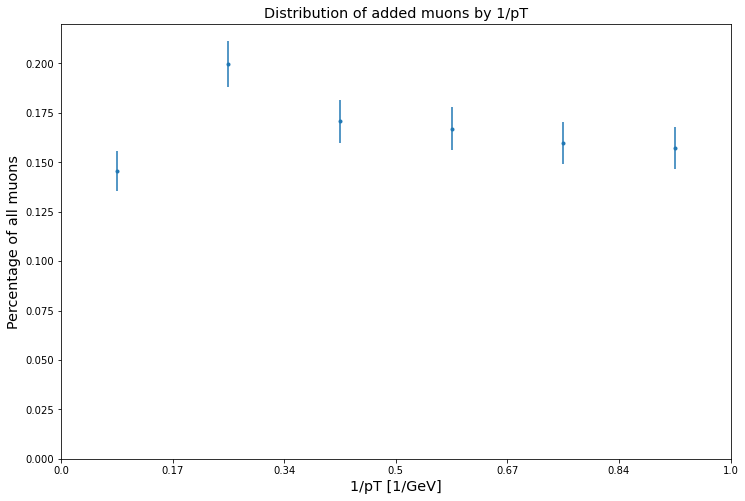

In [71]:
allhistbins = np.arange(qbinminminnew,qbinmaxminnew+0.001,qbinmaxminnew/6)

allhiststep = allhistbins[1] - allhistbins[0]

allhistvals, _ = np.histogram(allvals, bins = allhistbins)
allhistvals1 = allhistvals/3

allhistbinscent = allhistbins[:-1] + allhiststep/2

foundhistbins = allhistbins
foundhiststep = foundhistbins[1] - foundhistbins[0]

foundhistvals, _ = np.histogram(foundvals, bins=foundhistbins)
foundhistvals1 = foundhistvals/3

part = allhistvals/np.sum(allhistvals)
err = eff_bayes_binomial_std(allhistvals1,np.sum(allhistvals1))

plt.figure(figsize = (12, 8))
val = plt.errorbar(allhistbinscent, part, yerr = err, label = "Muons", fmt = ".")
plt.title("Distribution of added muons by 1/pT",fontsize='x-large')
plt.xlabel("1/pT [1/GeV]",fontsize='x-large')
plt.ylabel("Percentage of all muons",fontsize='x-large')

imagexticks = allhistbins
imagexlabels = (allhistbins + 0.5)*QOpTminstep
imagexlabels = np.around(imagexlabels, decimals=2)

plt.xticks(imagexticks, imagexlabels)

plt.ylim([0,0.22])

plt.show()

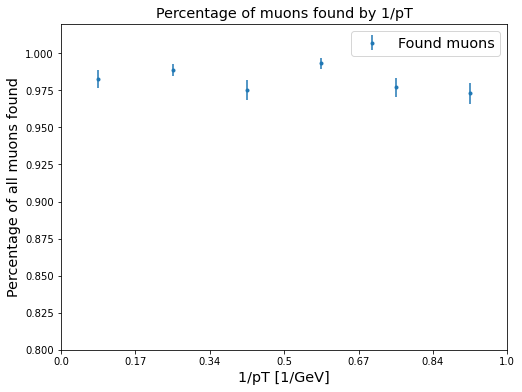

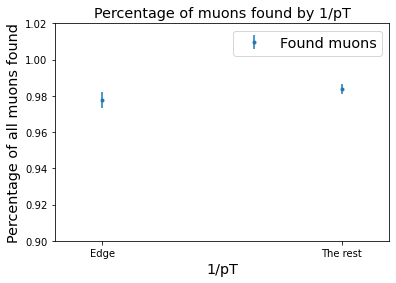

In [72]:
allhistvals, _ = np.histogram(allvals, bins = allhistbins)
foundhistvals, _ = np.histogram(foundvals, bins=foundhistbins)

errnew = eff_bayes_binomial_std(foundhistvals,allhistvals)
plt.figure(figsize = (8, 6))
val = plt.errorbar(allhistbinscent, foundhistvals/allhistvals, yerr = errnew, label = "Found muons", fmt = ".")
plt.legend(fontsize='x-large')
plt.title("Percentage of muons found by 1/pT",fontsize='x-large')
plt.xlabel("1/pT [1/GeV]",fontsize='x-large')
plt.ylabel("Percentage of all muons found",fontsize='x-large')
plt.ylim(0.8,1.02)
plt.xticks(imagexticks, imagexlabels)
plt.show()

#Edge vs middle
allnewhistvals = np.zeros((2,))
allnewhistvals[0] = allhistvals[0] + allhistvals[-1]
allnewhistvals[1] = np.sum(allhistvals[1:-1])
foundnewhistvals = np.zeros((2,))
foundnewhistvals[0] = foundhistvals[0] + foundhistvals[-1]
foundnewhistvals[1] = np.sum(foundhistvals[1:-1])
newbins = np.arange(0,1+0.001,1)
errnew = eff_bayes_binomial_std(foundnewhistvals,allnewhistvals)
plt.figure(figsize = (6, 4))
val = plt.errorbar(newbins, foundnewhistvals/allnewhistvals, yerr = errnew, label = "Found muons", fmt = ".")
plt.legend(fontsize='x-large')
plt.title("Percentage of muons found by 1/pT",fontsize='x-large')
plt.xlabel("1/pT",fontsize='x-large')
plt.ylabel("Percentage of all muons found",fontsize='x-large')
plt.ylim(0.9,1.02)
plt.xlim(-0.2,1.2)

plt.xticks(newbins, ["Edge", "The rest"]) 
plt.show()

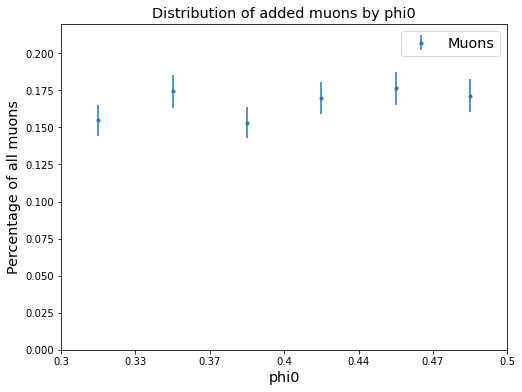

In [83]:
allhistbins = np.arange(pbinmin,pbinmax+0.001,(pbinmax-pbinmin)/6)

allhiststep = allhistbins[1] - allhistbins[0]

allhistvals, _ = np.histogram(allvals, bins = allhistbins)
allhistvals1 = allhistvals/3

allhistbinscent = allhistbins[:-1] + allhiststep/2

foundhistbins = allhistbins
foundhiststep = foundhistbins[1] - foundhistbins[0]

foundhistvals, _ = np.histogram(foundvals, bins=foundhistbins)
foundhistvals1 = foundhistvals/3

part = allhistvals/np.sum(allhistvals)
err = eff_bayes_binomial_std(allhistvals1,np.sum(allhistvals1))

plt.figure(figsize = (8, 6))
val = plt.errorbar(allhistbinscent, part, yerr = err, label = "Muons", fmt = ".")
plt.legend(fontsize='x-large')
plt.title("Distribution of added muons by phi0",fontsize='x-large')
plt.xlabel("phi0",fontsize='x-large')
plt.ylabel("Percentage of all muons",fontsize='x-large')

imagexticks = allhistbins
imagexlabels = phi0minminnew + (allhistbins)*phi0minstep
imagexlabels = np.around(imagexlabels, decimals=2)

plt.xticks(imagexticks, imagexlabels)

plt.ylim([0,0.22])

plt.show()

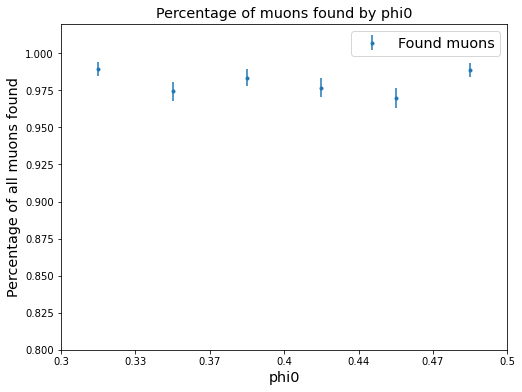

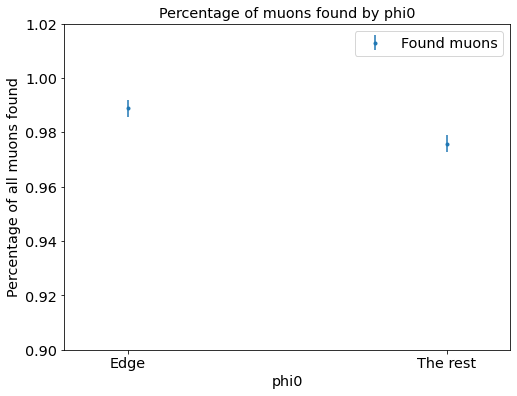

In [85]:
allhistvals, _ = np.histogram(allvals, bins = allhistbins)
foundhistvals, _ = np.histogram(foundvals, bins=foundhistbins)
errnew = eff_bayes_binomial_std(foundhistvals,allhistvals)
plt.figure(figsize = (8, 6))
val = plt.errorbar(allhistbinscent, foundhistvals/allhistvals, yerr = errnew, label = "Found muons", fmt = ".")
plt.legend(fontsize='x-large')
plt.title("Percentage of muons found by phi0",fontsize='x-large')
plt.xlabel("phi0",fontsize='x-large')
plt.ylabel("Percentage of all muons found",fontsize='x-large')
plt.ylim(0.8,1.02)

plt.xticks(imagexticks, imagexlabels) 
plt.show()

#Edge vs middle
allnewhistvals = np.zeros((2,))
allnewhistvals[0] = allhistvals[0] + allhistvals[-1]
allnewhistvals[1] = np.sum(allhistvals[1:-1])
foundnewhistvals = np.zeros((2,))
foundnewhistvals[0] = foundhistvals[0] + foundhistvals[-1]
foundnewhistvals[1] = np.sum(foundhistvals[1:-1])
newbins = np.arange(0,1+0.001,1)
errnew = eff_bayes_binomial_std(foundnewhistvals,allnewhistvals)
plt.figure(figsize = (8, 6))
val = plt.errorbar(newbins, foundnewhistvals/allnewhistvals, yerr = errnew, label = "Found muons", fmt = ".")
plt.legend(fontsize='x-large')
plt.title("Percentage of muons found by phi0", fontsize='x-large')
plt.xlabel("phi0",fontsize='x-large')
plt.ylabel("Percentage of all muons found", fontsize='x-large')
plt.ylim(0.9,1.02)
plt.xlim(-0.2,1.2)
plt.yticks(fontsize = 'x-large')
plt.xticks(newbins, ["Edge", "The rest"], fontsize='x-large') 
plt.show()

0 510
1 510
2 510
3 510
4 510
5 510
6 510
evaluating
0 0


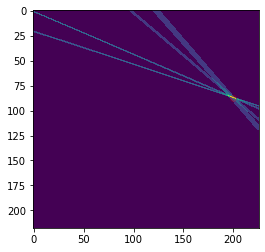

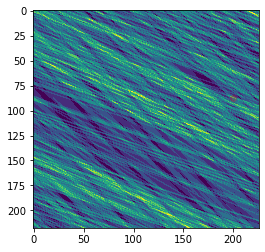

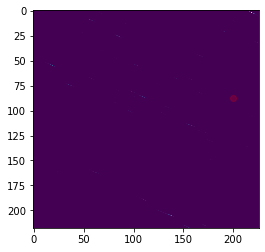

0 1


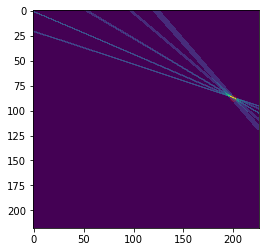

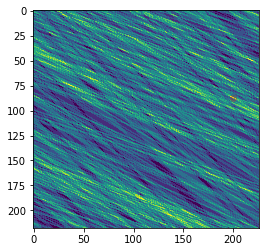

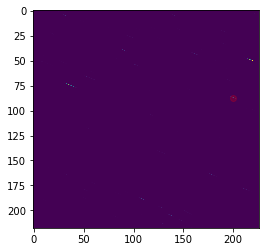

1 0


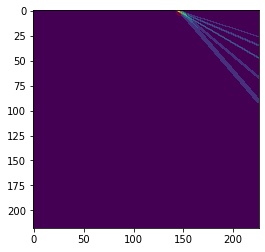

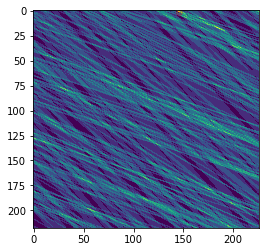

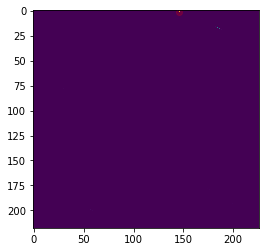

1 5


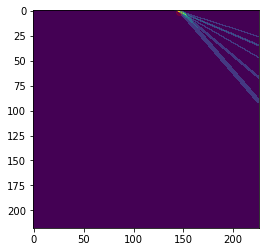

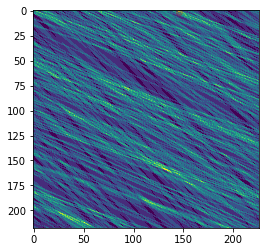

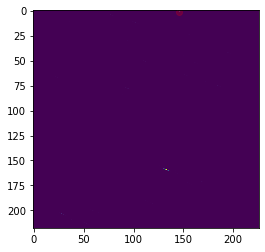

2 0


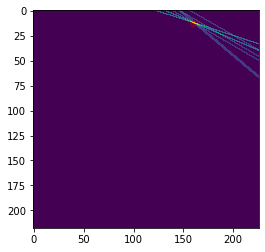

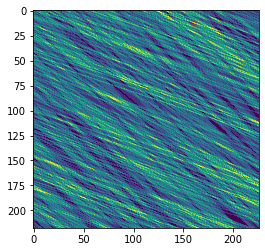

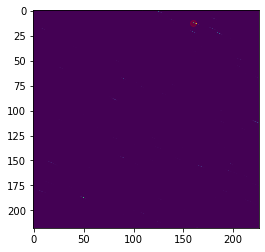

2 1


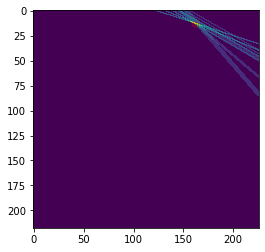

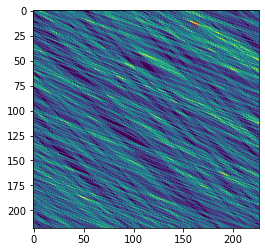

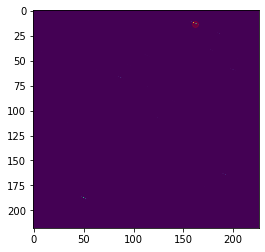

7 510
8 510
9 510
10 510
11 510
12 510
13 510
evaluating
0 0


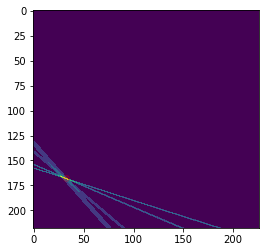

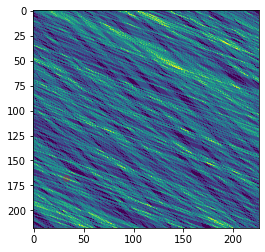

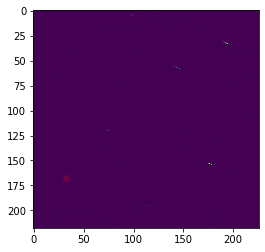

0 1


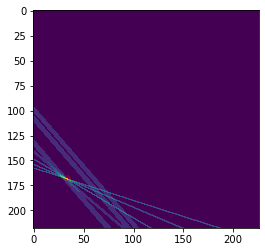

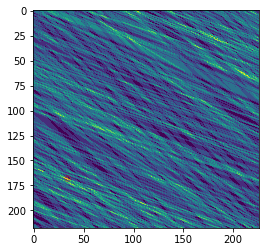

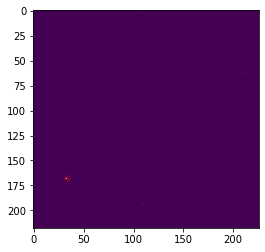

1 4


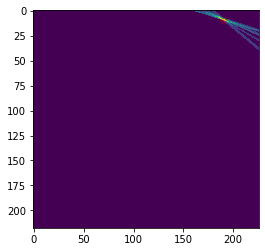

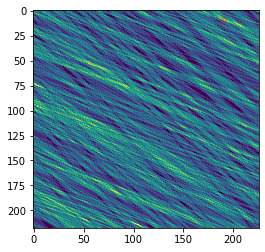

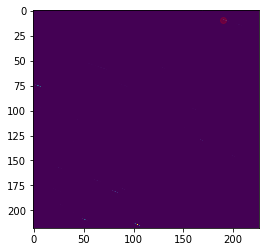

1 5


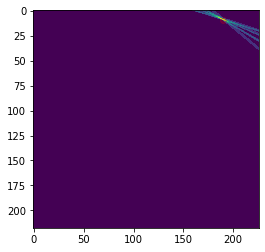

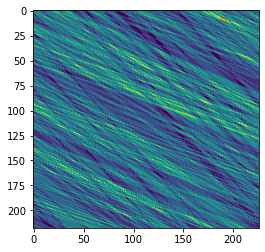

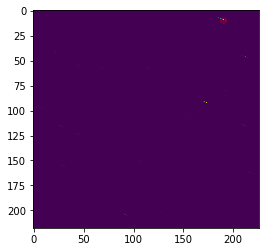

2 0


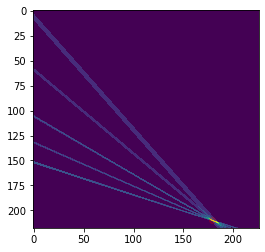

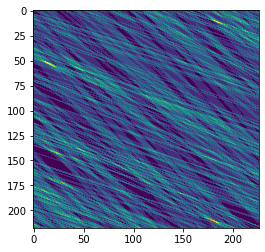

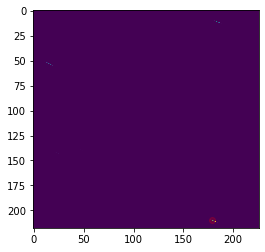

2 1


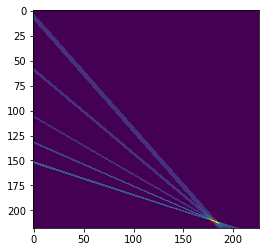

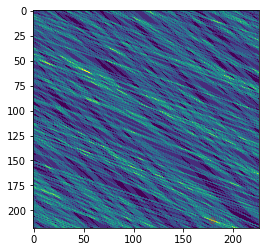

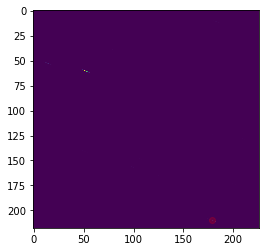

14 510
15 510
16 510
17 510
18 510
19 510
20 510
evaluating
0 0


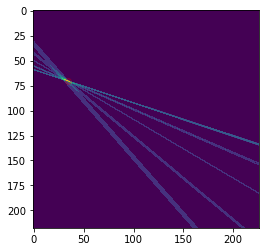

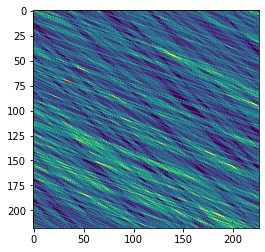

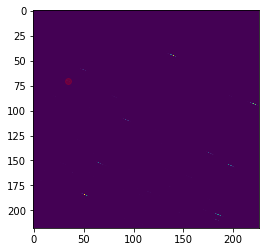

0 1


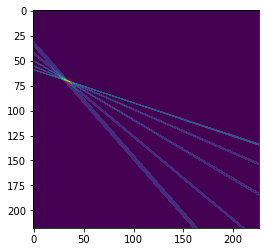

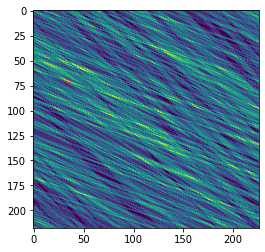

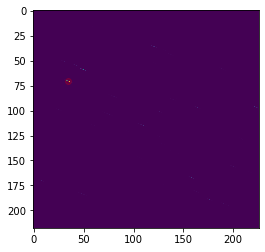

1 0


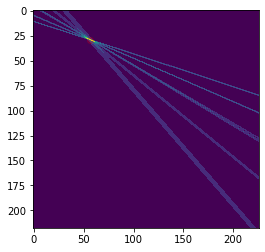

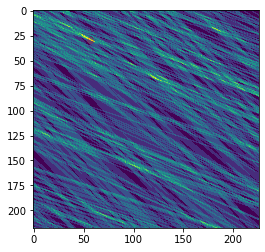

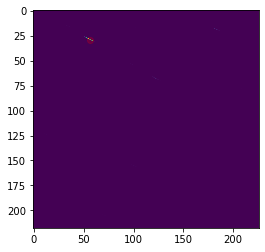

1 1


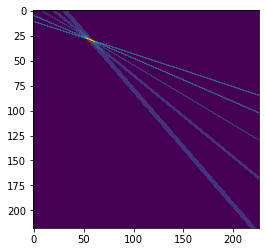

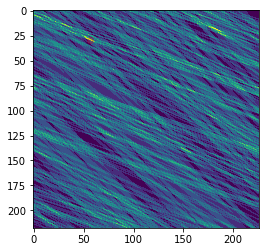

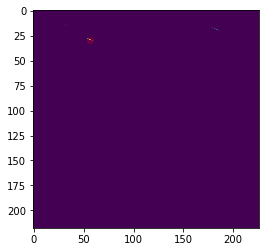

2 0


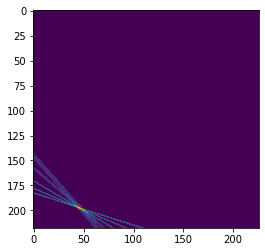

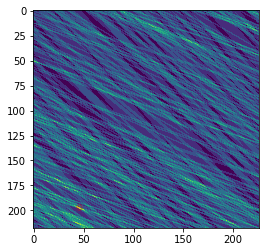

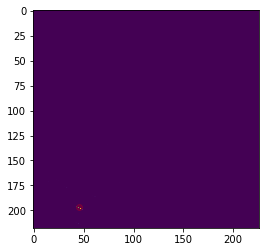

2 5


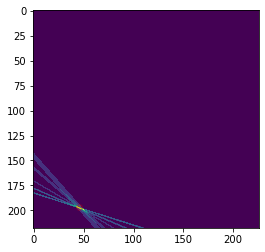

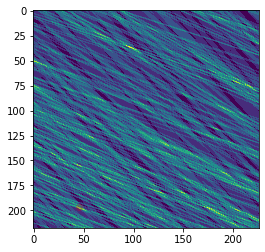

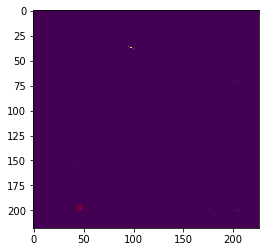

21 510
22 510
23 510
24 510
25 510
26 510
27 510
evaluating
0 0


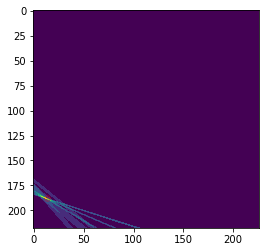

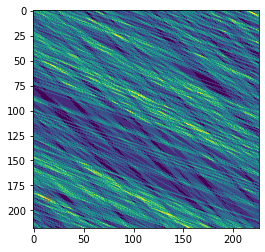

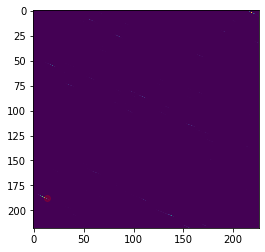

0 5


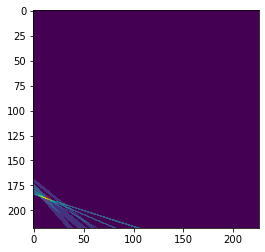

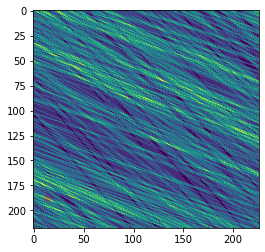

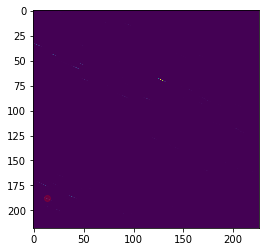

1 4


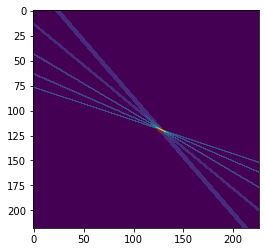

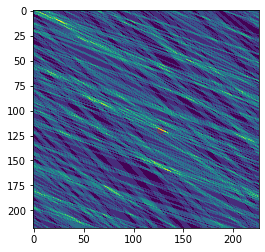

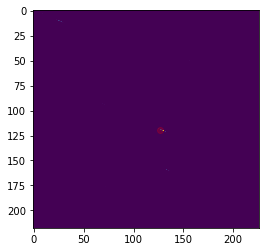

1 5


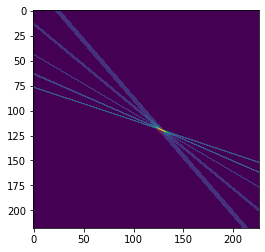

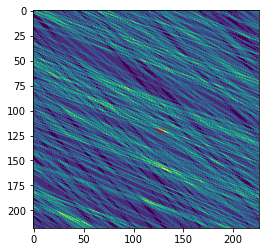

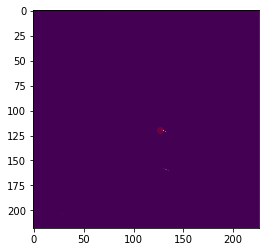

2 0


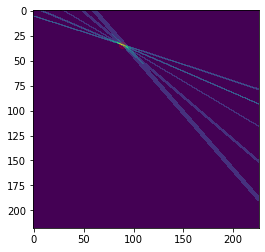

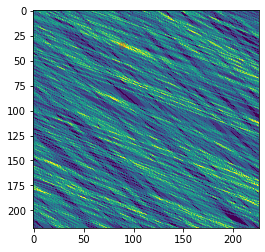

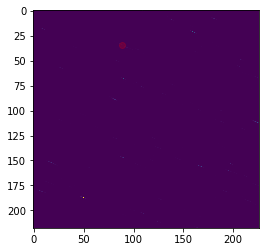

2 5


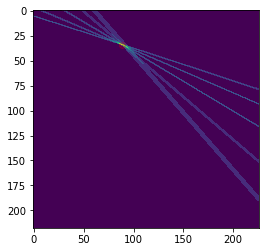

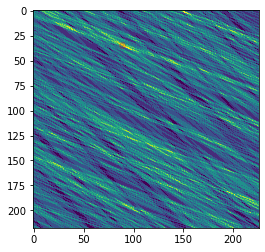

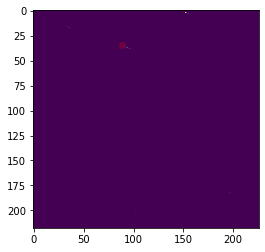

28 510
29 510
30 510
31 510
32 510
33 510
34 510
evaluating
0 1


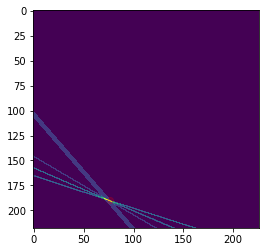

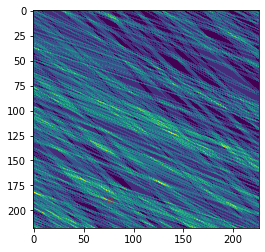

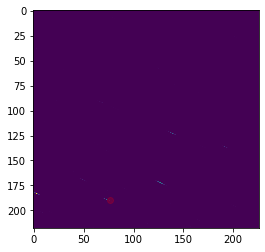

0 3


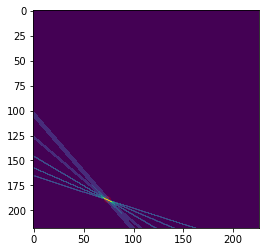

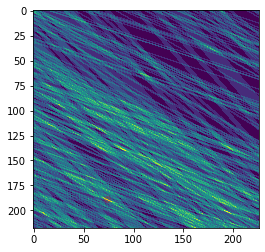

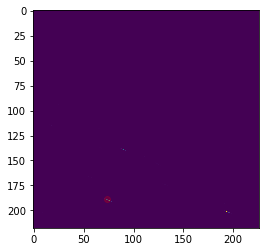

1 5


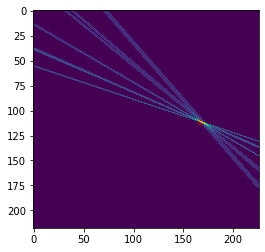

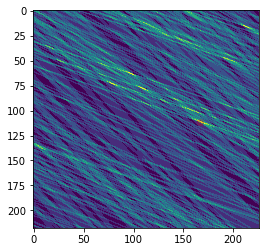

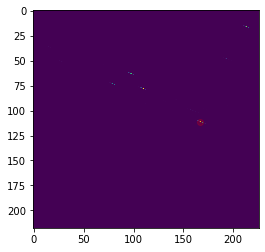

2 0


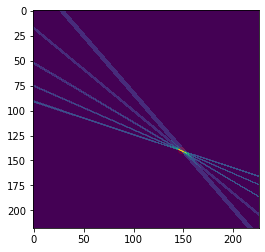

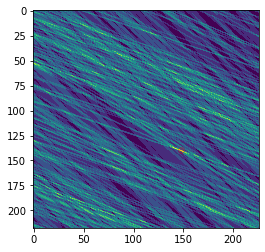

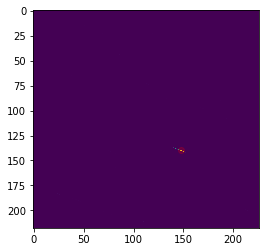

2 5


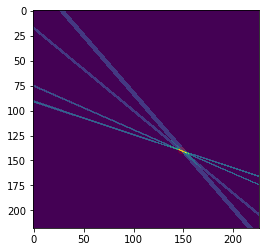

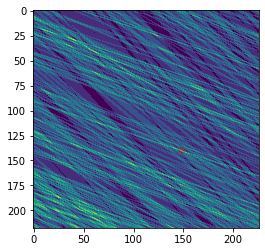

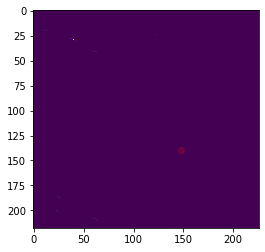

3 0


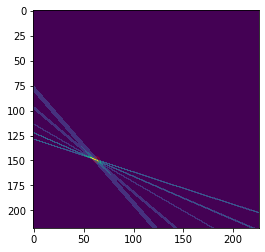

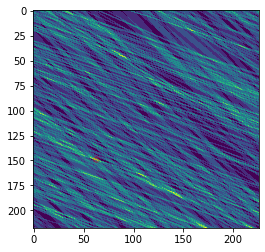

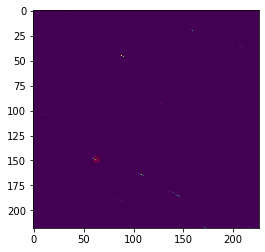

35 510
36 510
37 510
38 510
39 510
40 510
41 510
evaluating
0 5


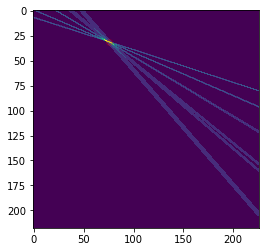

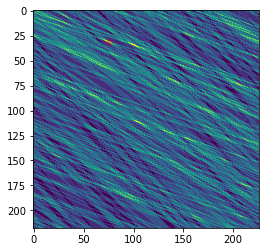

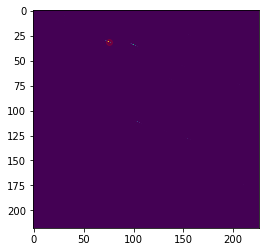

1 0


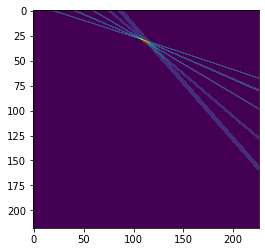

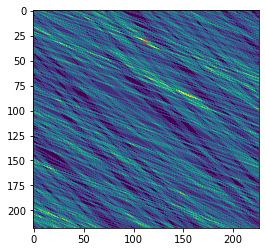

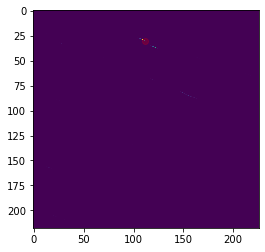

1 5


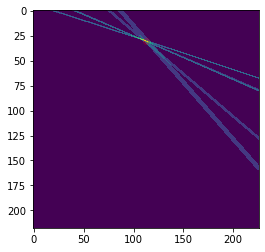

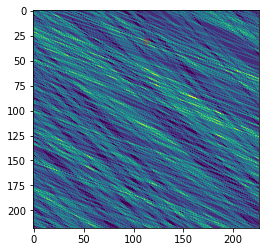

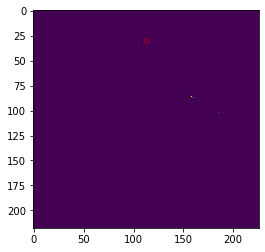

2 4


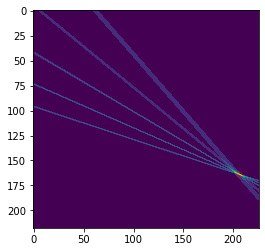

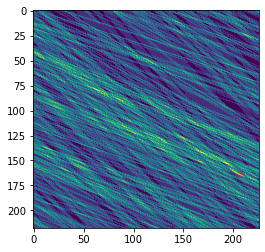

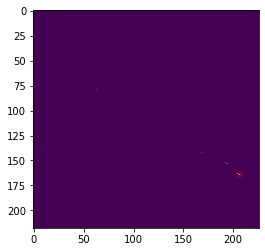

2 5


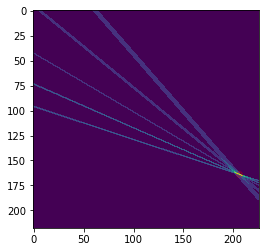

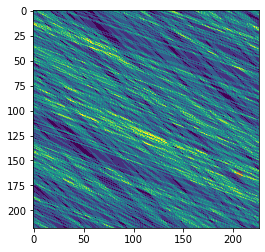

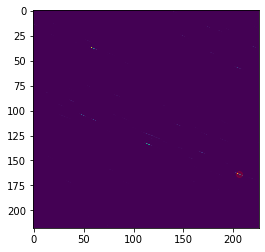

3 4


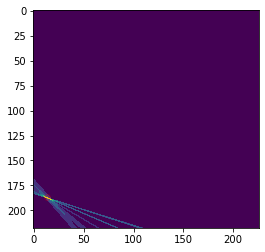

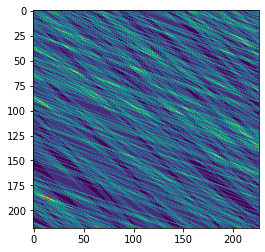

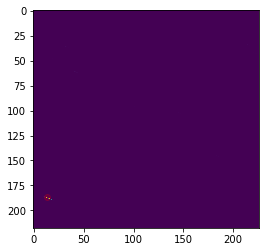

42 510
43 510
44 510
45 510
46 510
47 510
48 510
evaluating
0 0


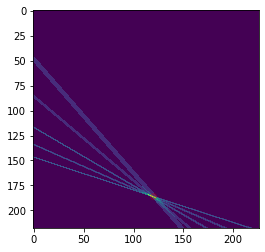

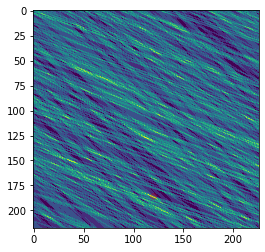

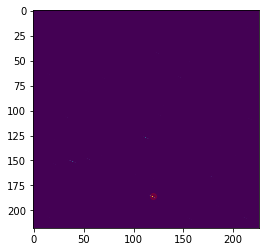

0 5


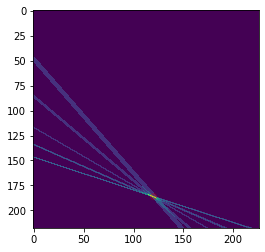

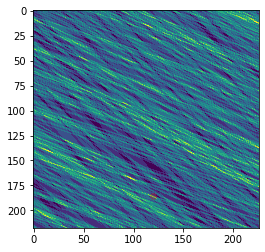

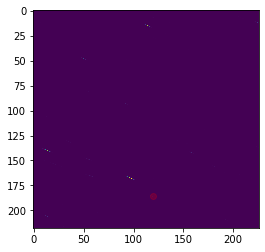

1 0


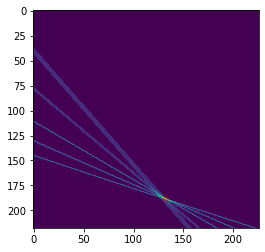

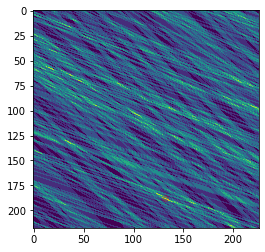

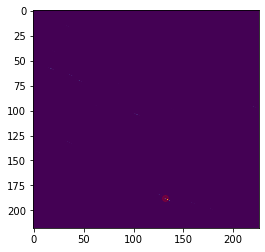

2 1


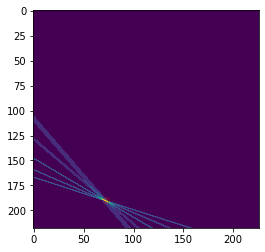

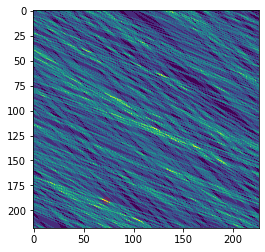

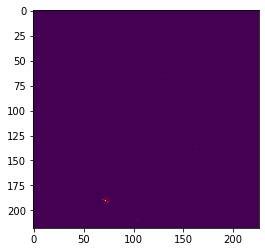

3 1


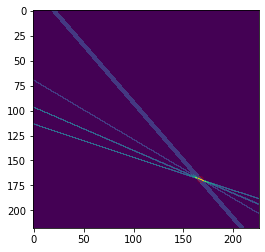

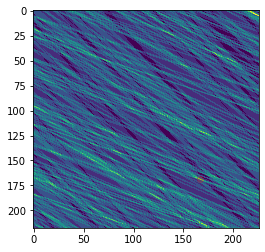

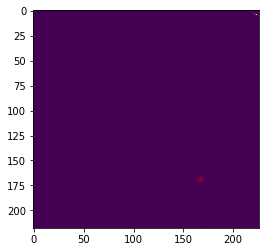

3 3


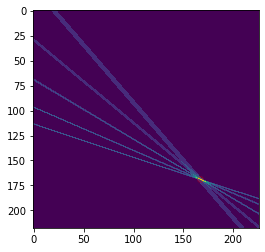

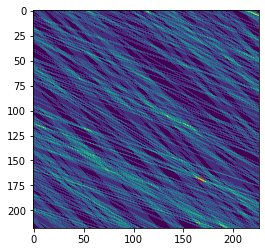

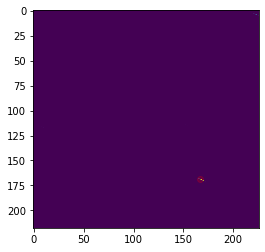

49 510
50 510
51 510
52 510
53 510
54 510
55 510
evaluating
0 0


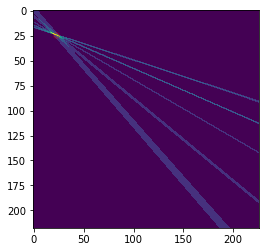

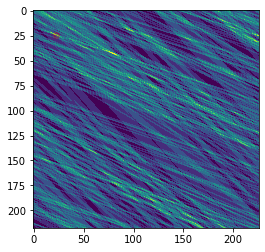

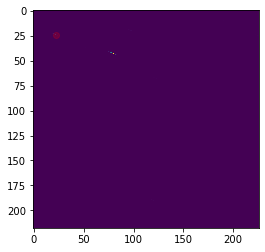

0 5


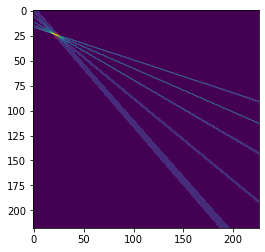

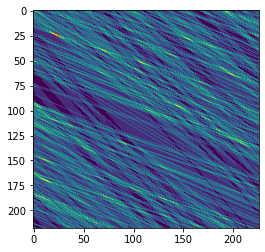

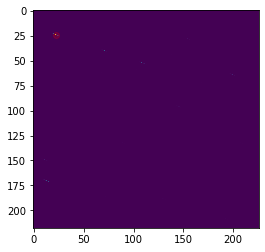

1 3


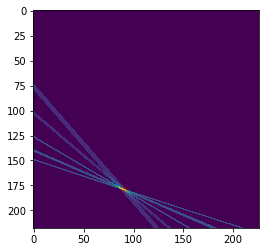

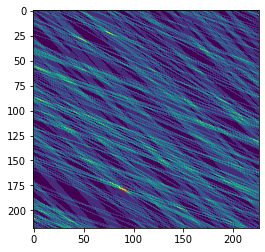

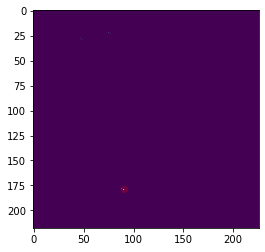

2 4


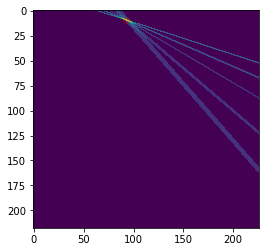

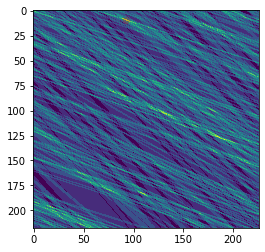

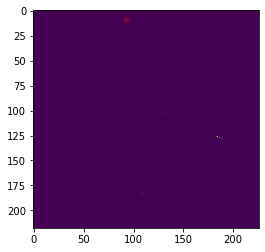

2 5


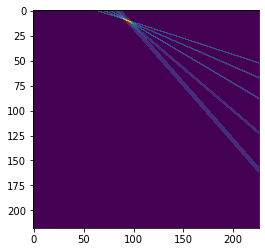

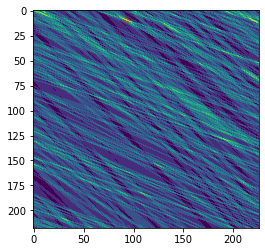

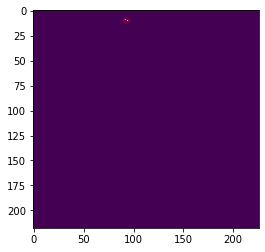

3 0


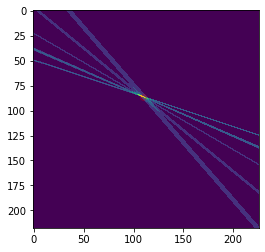

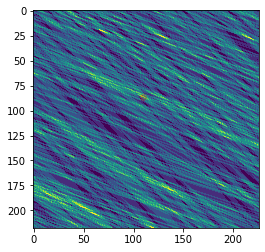

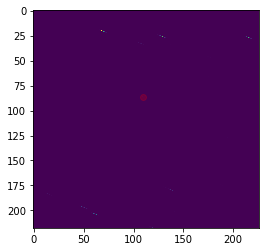

56 510
57 510
58 510
59 510
60 510
61 510
62 510
evaluating
0 0


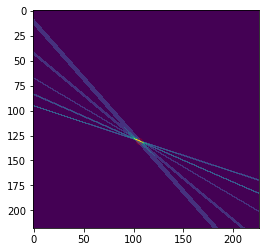

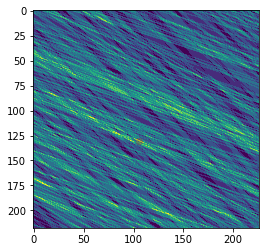

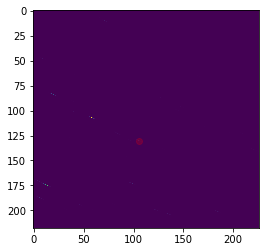

0 5


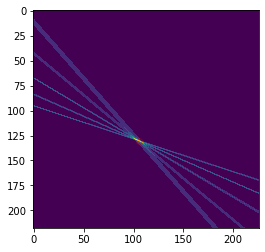

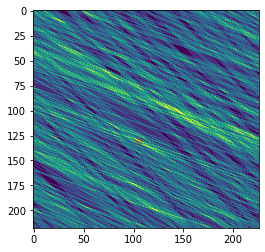

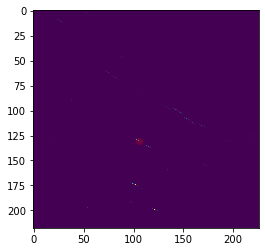

1 0


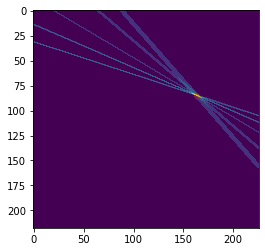

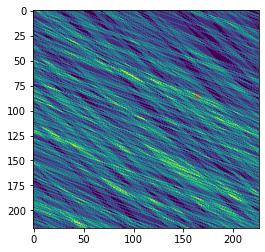

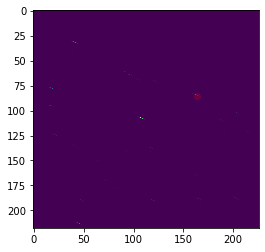

1 5


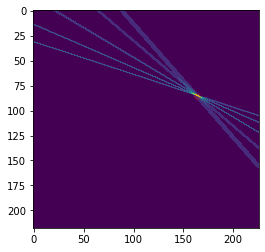

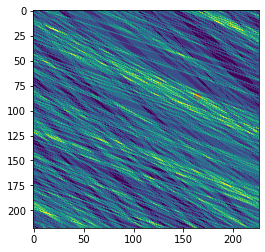

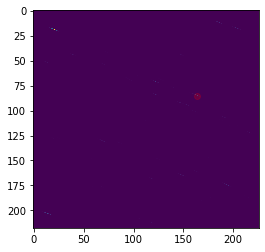

2 0


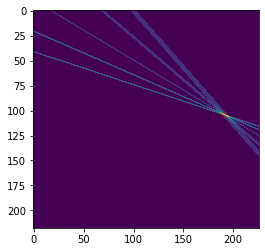

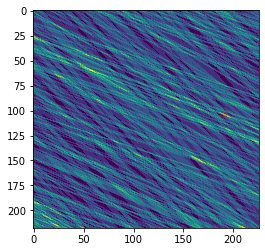

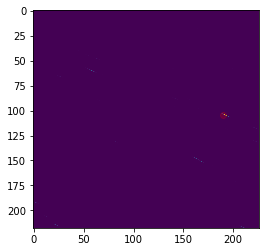

2 5


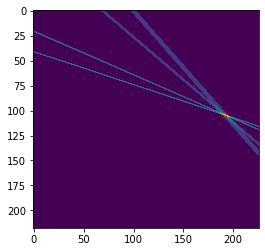

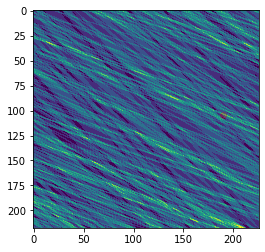

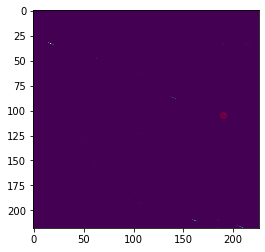

63 510
64 510
65 510
66 510
67 510
68 510
69 510
evaluating
0 0


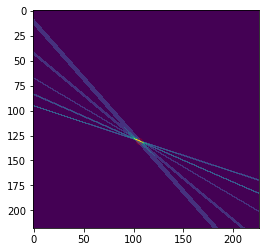

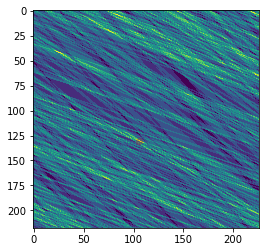

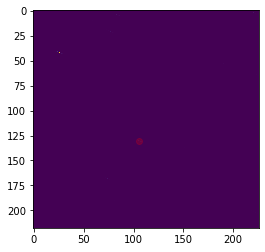

0 5


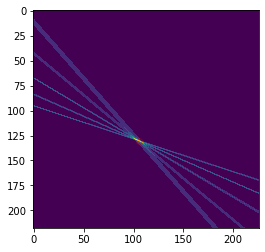

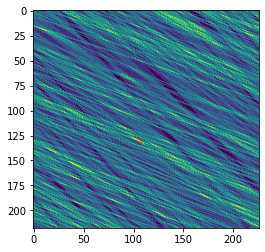

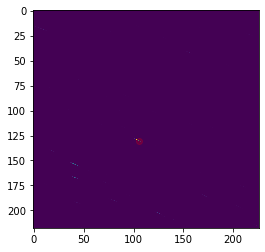

1 0


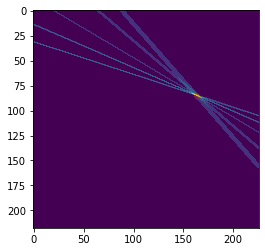

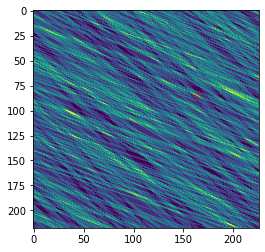

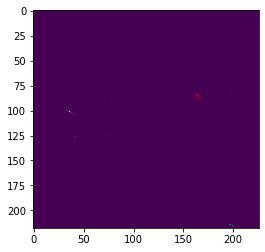

1 5


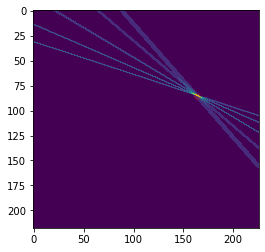

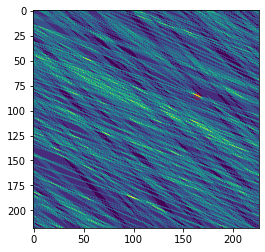

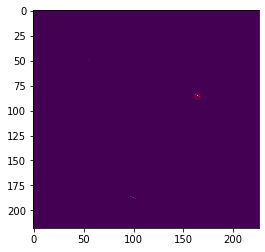

2 0


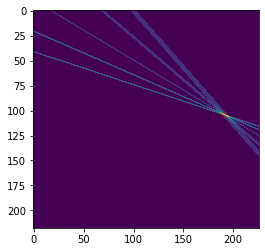

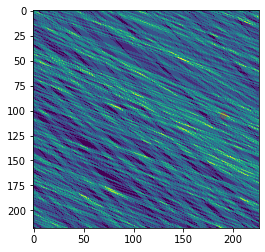

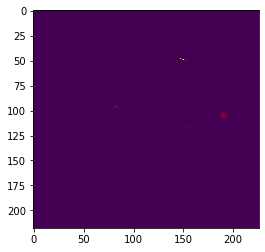

2 5


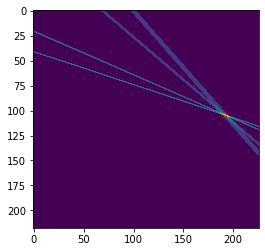

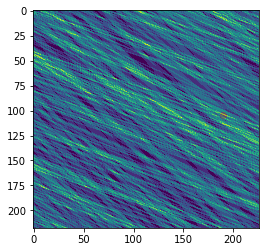

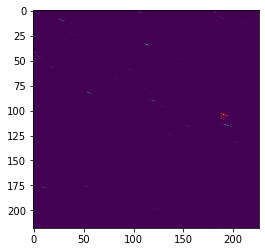

70 510
71 510
72 510
73 510
74 510
75 510
76 510
evaluating
1 0


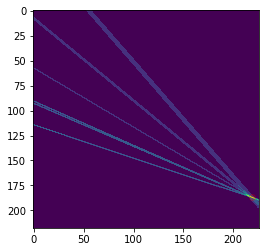

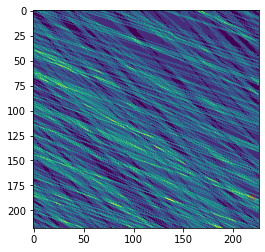

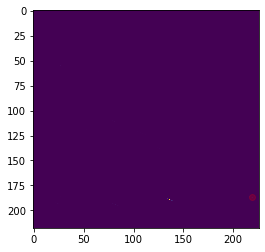

1 1


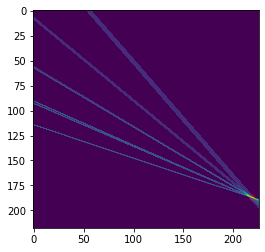

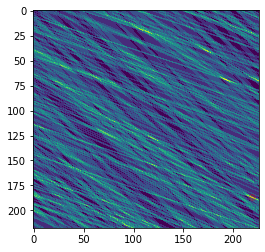

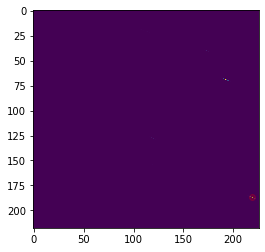

2 0


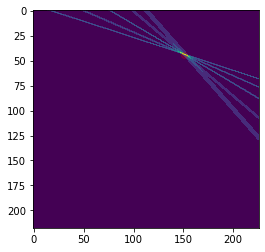

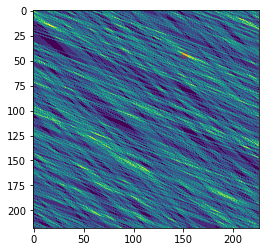

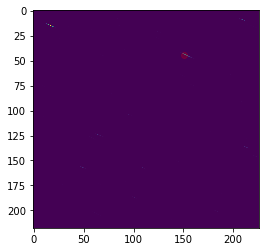

2 1


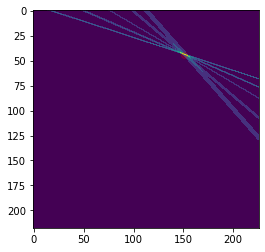

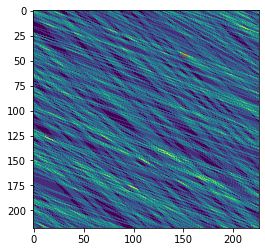

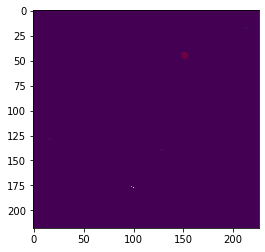

3 0


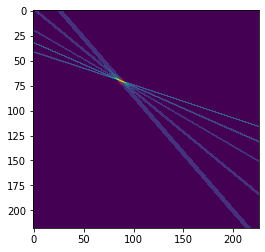

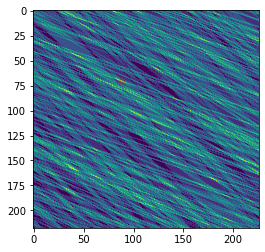

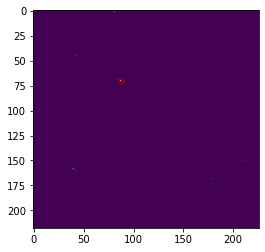

3 5


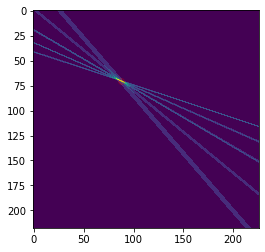

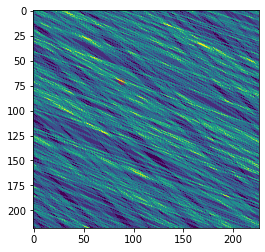

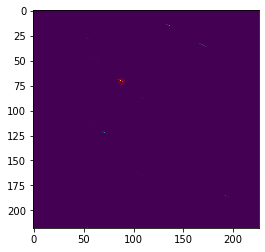

77 510
78 510
79 510
80 510
81 510
82 510
83 510
evaluating
0 2


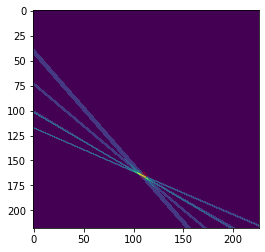

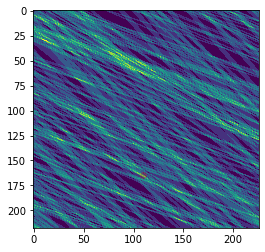

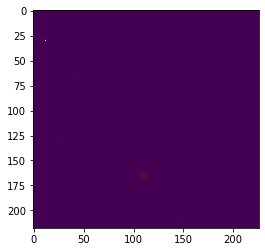

0 4


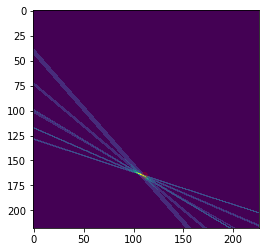

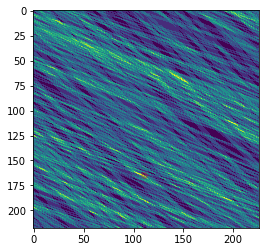

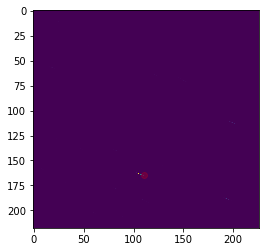

1 2


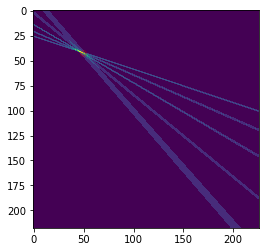

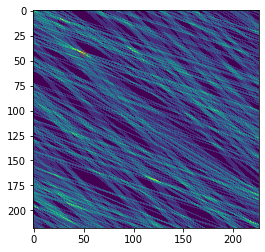

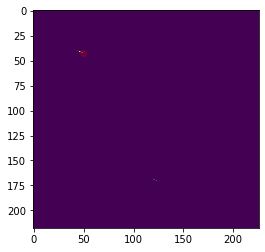

2 4


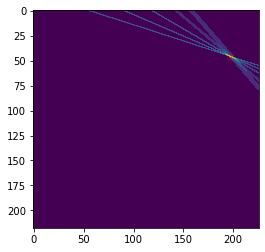

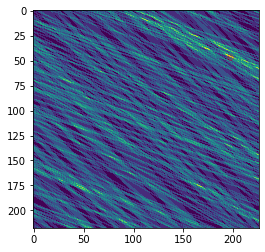

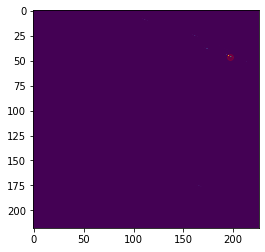

2 5


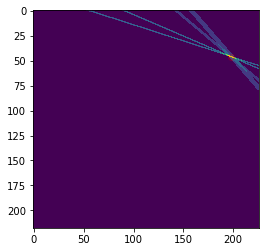

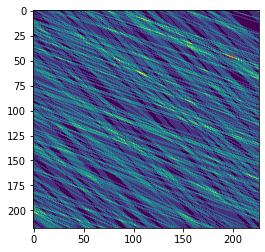

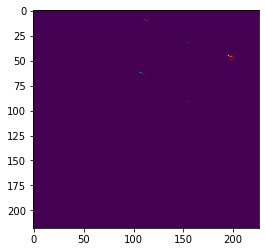

3 0


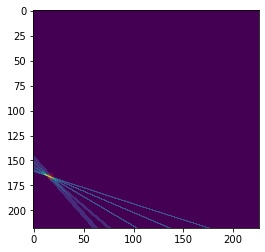

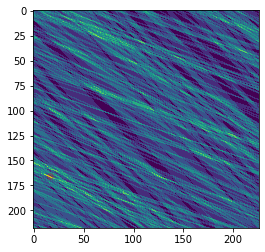

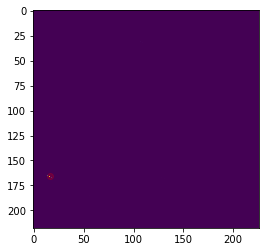

84 510
85 510
86 510
87 510
88 510
89 510
90 510
evaluating
1 0


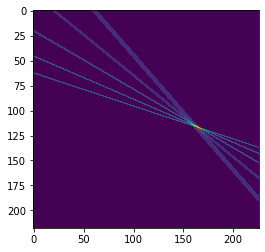

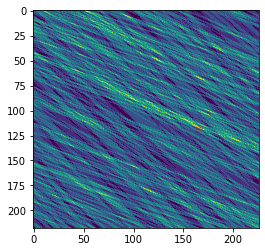

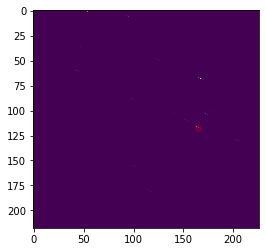

1 1


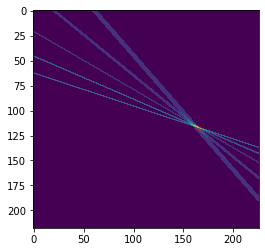

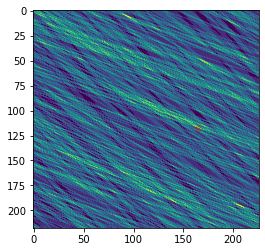

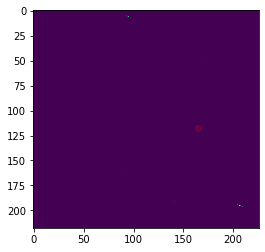

2 4


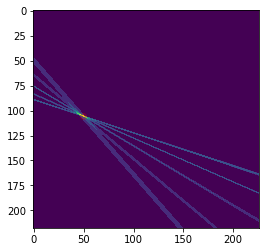

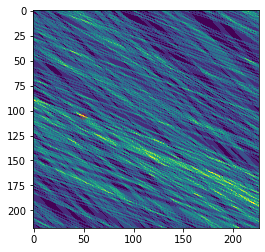

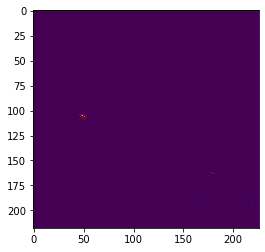

3 3


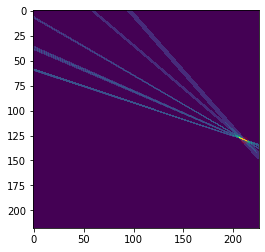

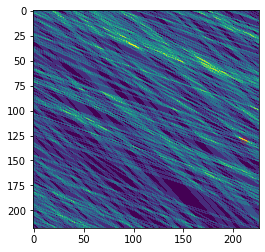

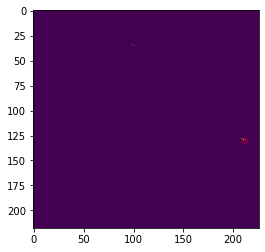

4 5


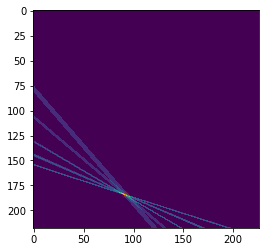

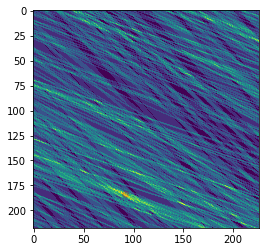

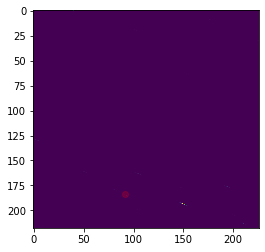

5 0


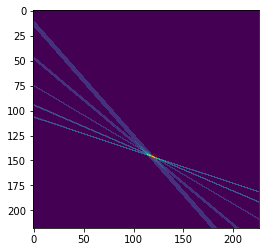

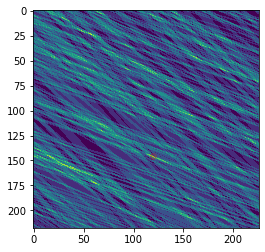

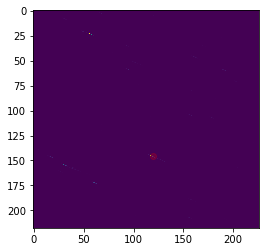

91 510
92 510
93 510
94 510
95 510
96 510
97 510
evaluating
0 4


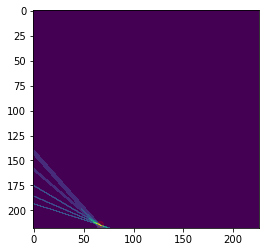

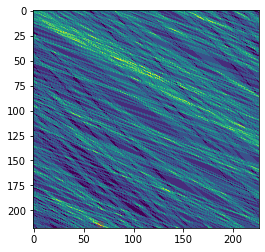

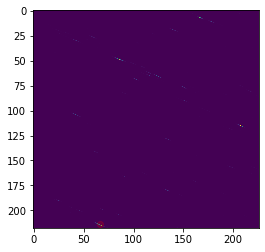

0 5


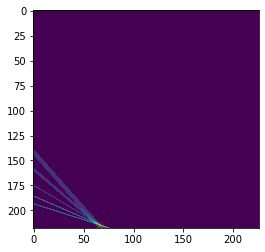

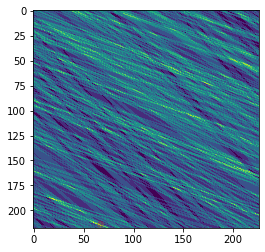

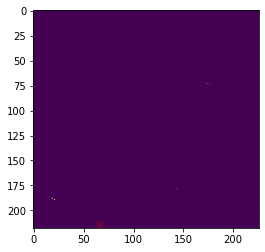

1 4


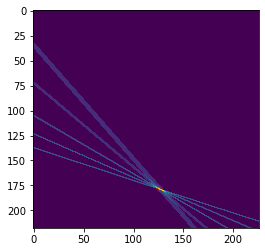

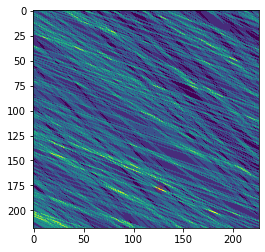

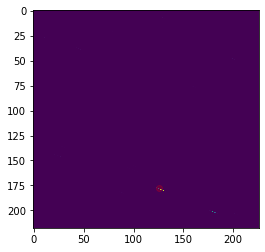

1 5


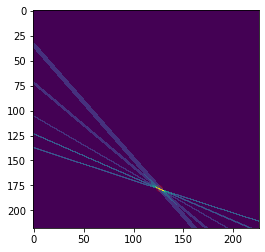

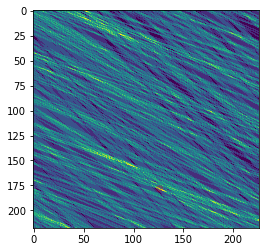

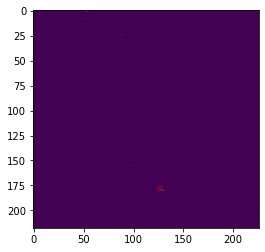

2 1


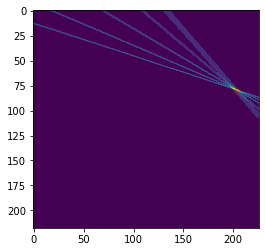

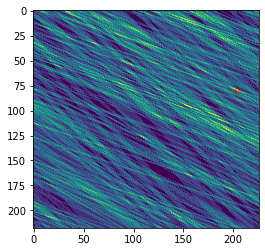

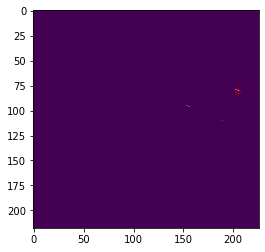

3 4


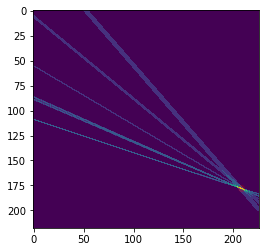

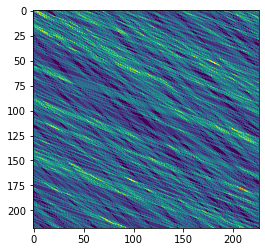

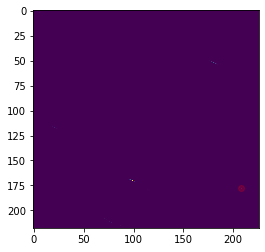

98 510
99 510
100 510
101 510
102 510
103 510
104 510
evaluating
0 0


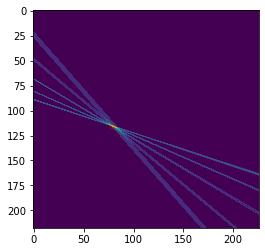

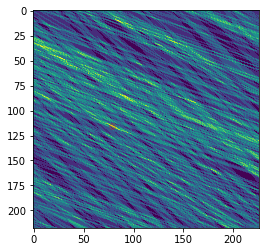

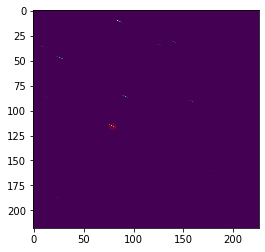

0 1


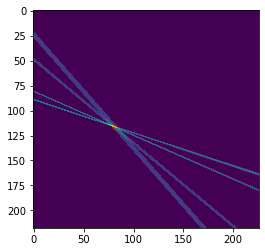

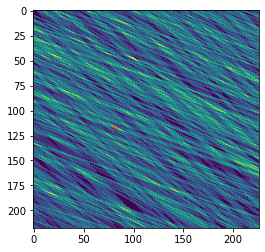

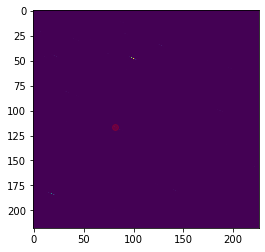

1 0


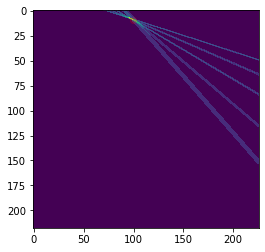

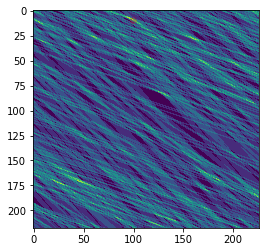

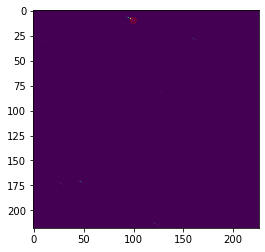

1 5


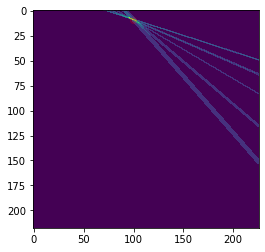

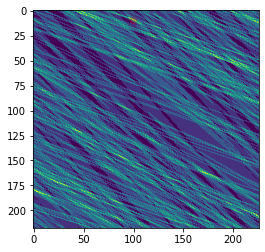

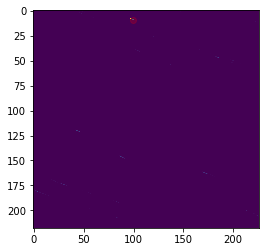

2 1


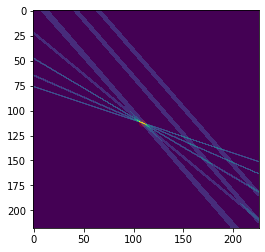

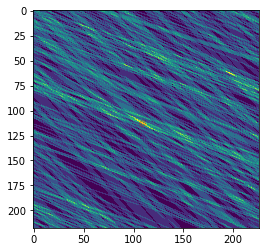

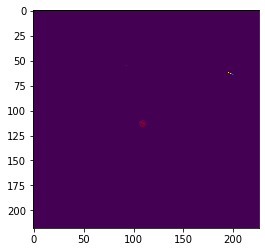

3 1


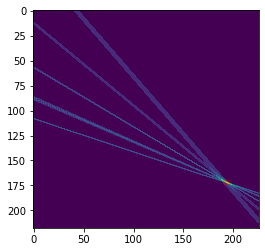

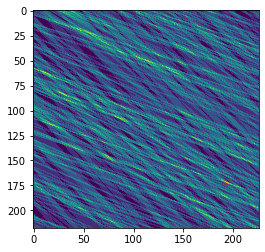

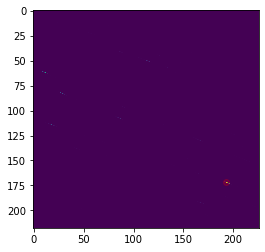

105 510
106 510
107 510
108 510
109 510
110 510
111 510
evaluating
0 5


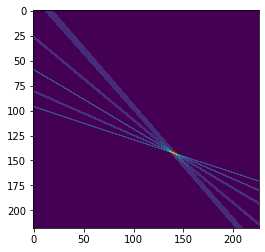

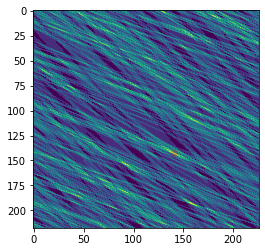

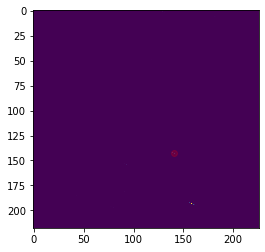

1 1


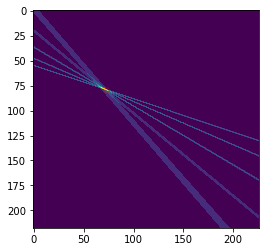

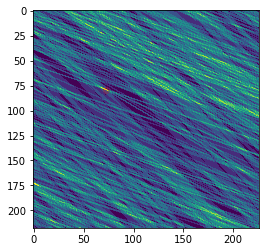

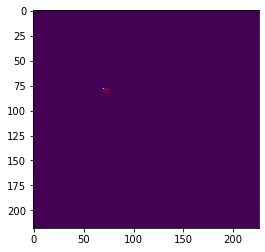

1 3


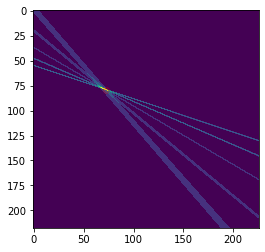

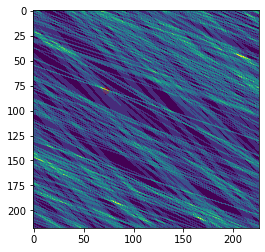

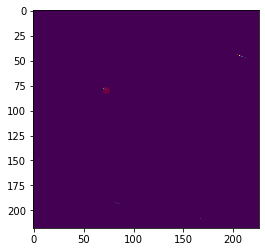

2 0


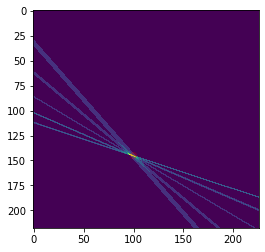

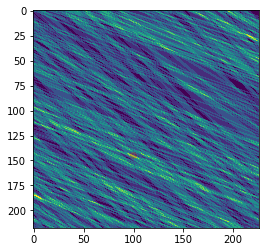

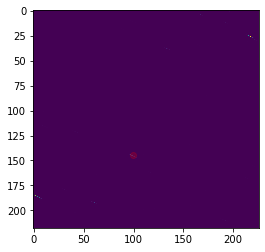

2 1


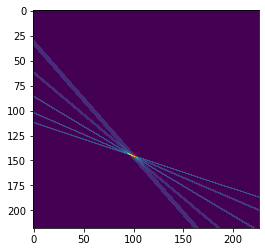

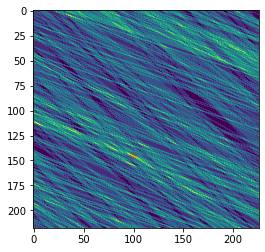

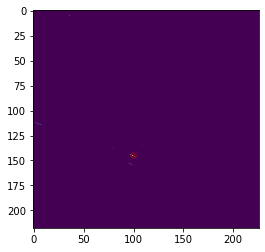

3 2


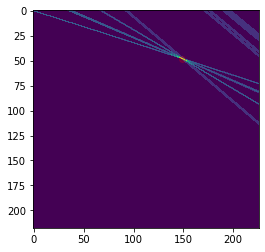

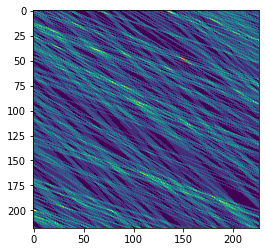

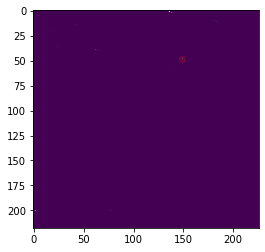

112 510
113 510
114 510
115 510
116 510
117 510
118 510
evaluating
0 3


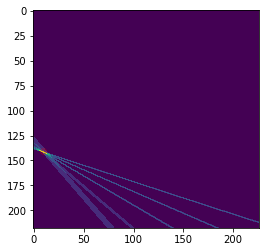

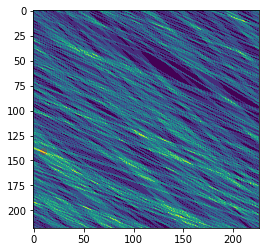

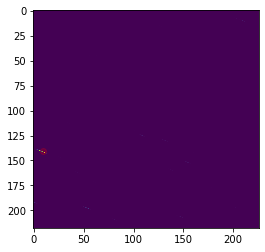

1 0


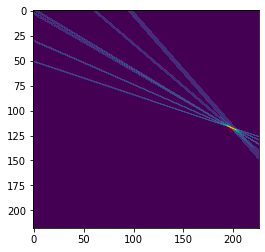

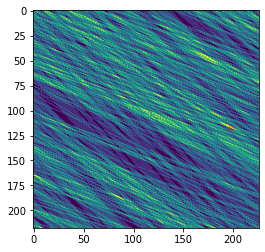

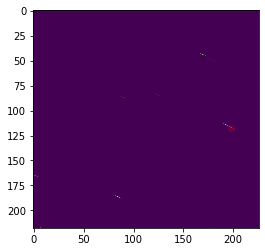

1 5


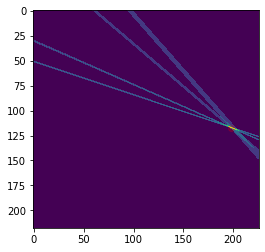

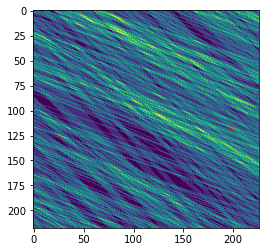

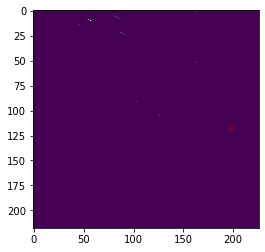

2 0


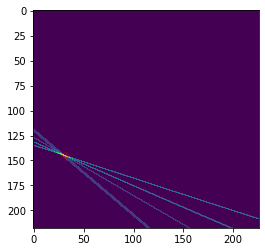

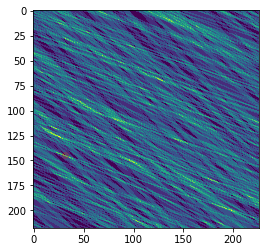

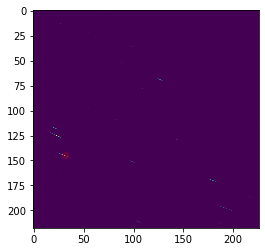

2 1


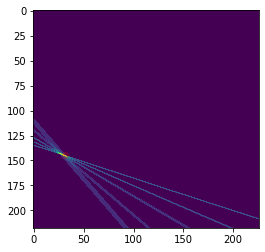

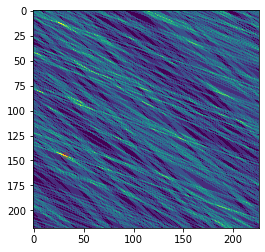

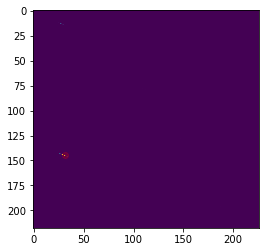

3 4


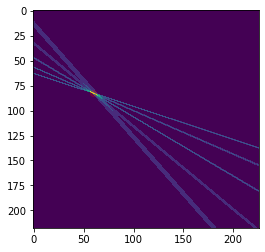

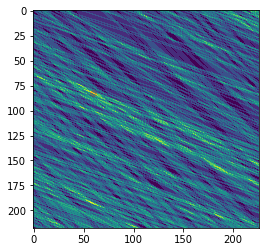

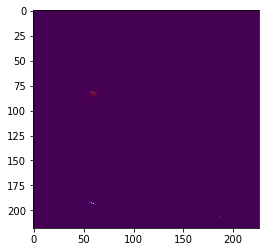

119 510
120 510
121 510
122 510
123 510
124 510
125 510
evaluating
0 0


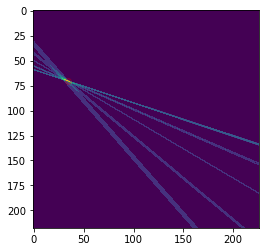

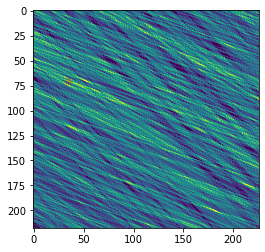

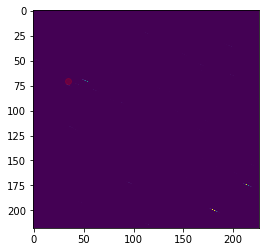

0 1


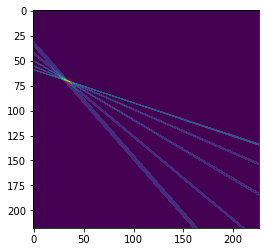

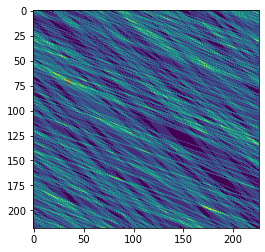

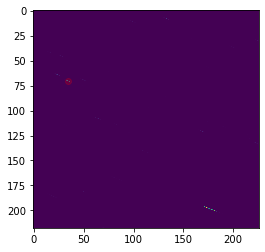

1 0


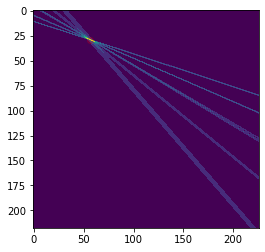

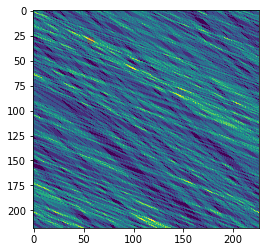

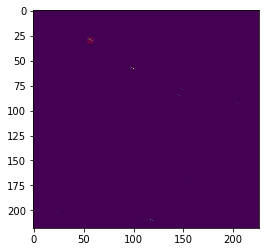

1 1


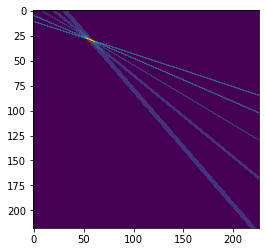

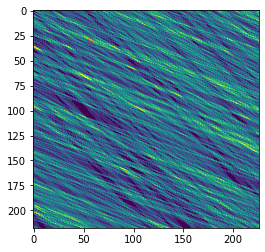

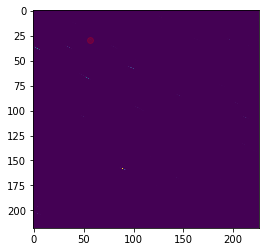

2 0


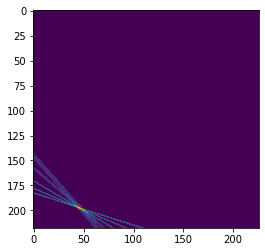

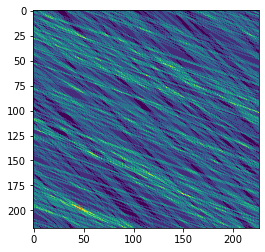

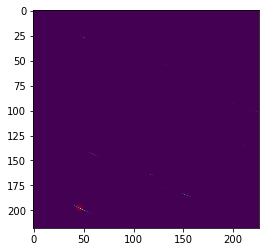

2 5


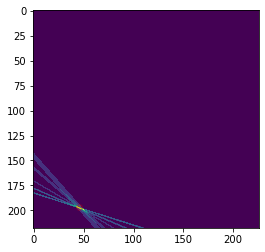

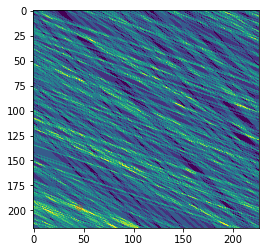

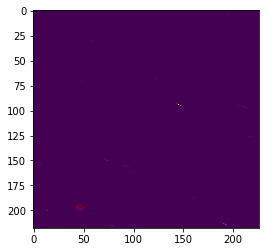

126 510
127 510
128 510
129 510
130 510
131 510
132 510
evaluating
0 0


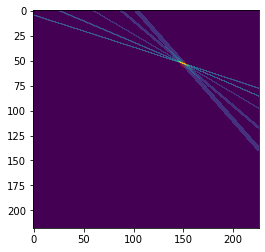

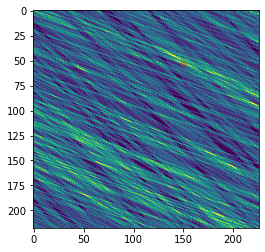

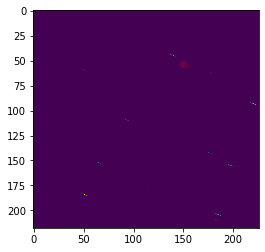

0 5


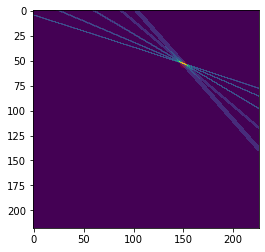

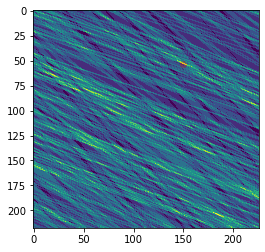

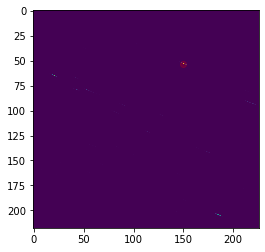

1 0


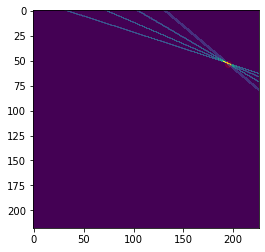

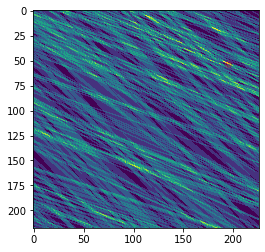

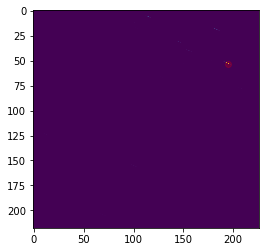

1 5


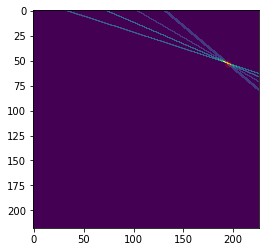

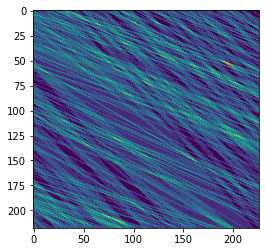

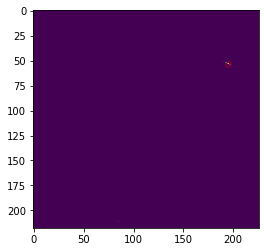

2 4


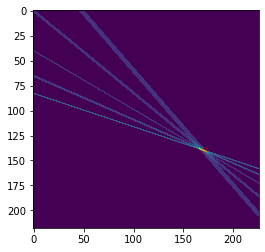

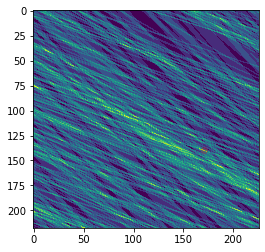

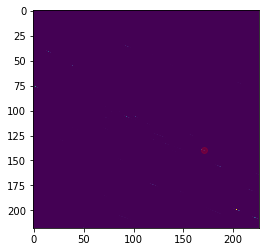

2 5


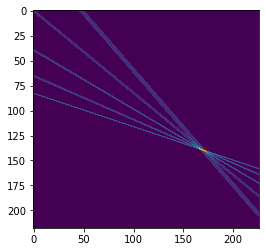

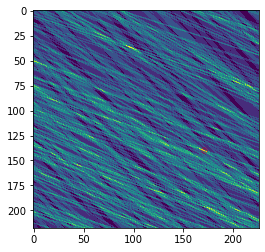

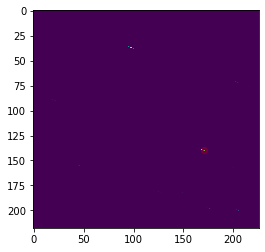

133 510
134 510
135 510
136 510
137 510
138 510
139 510
evaluating
1 2


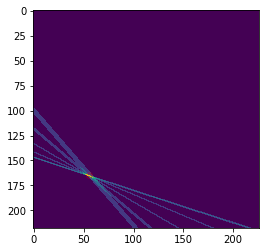

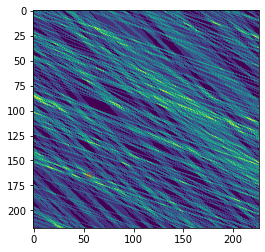

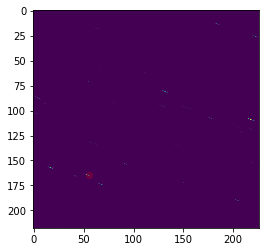

1 4


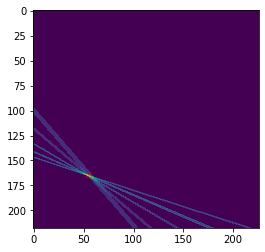

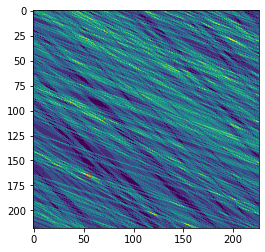

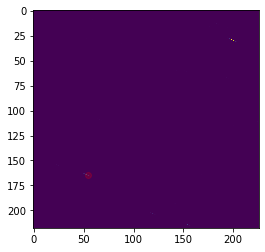

2 4


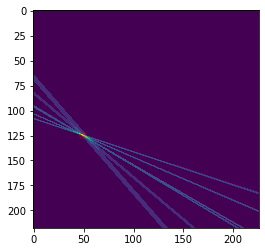

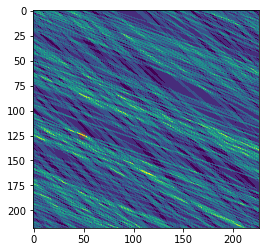

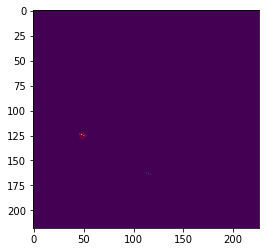

3 0


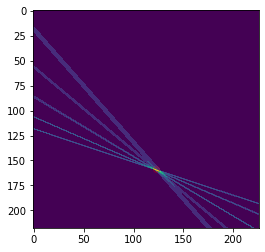

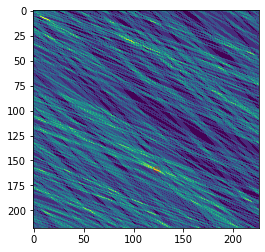

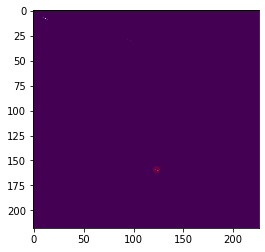

3 5


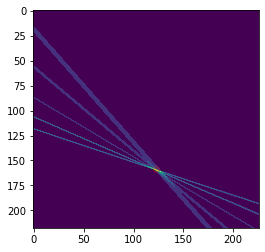

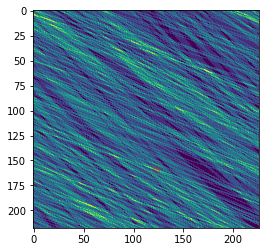

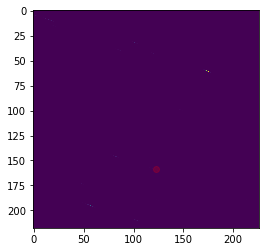

4 0


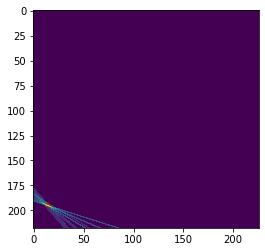

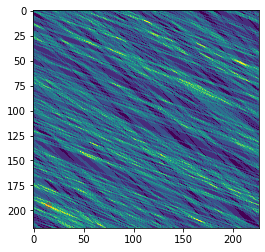

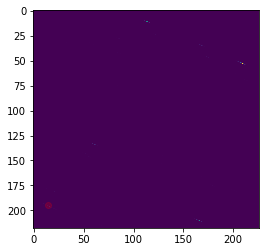

140 510
141 510
142 510
143 510
144 510
145 510
146 510
evaluating
0 4


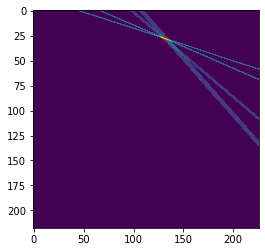

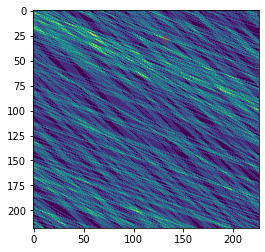

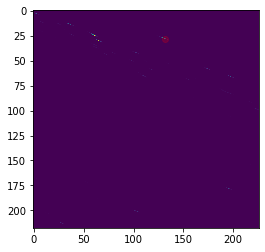

0 5


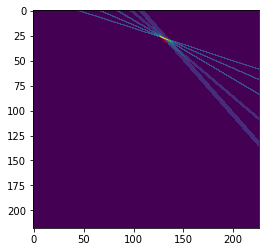

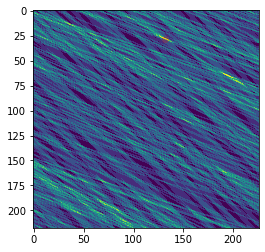

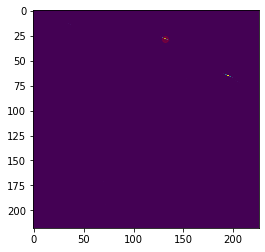

1 0


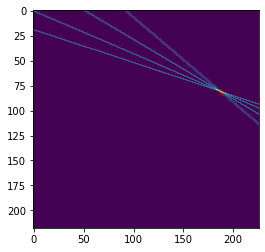

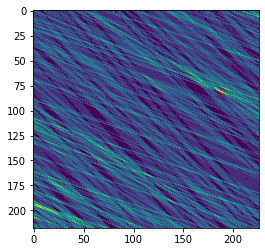

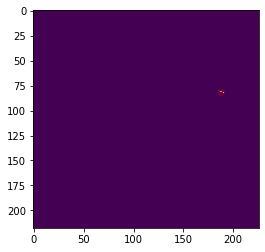

2 0


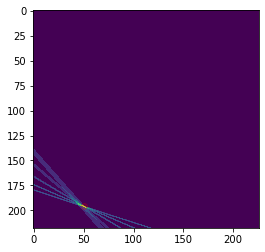

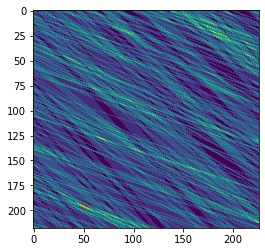

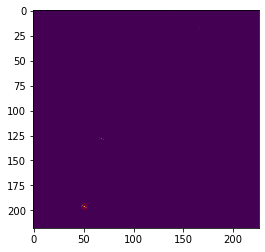

2 1


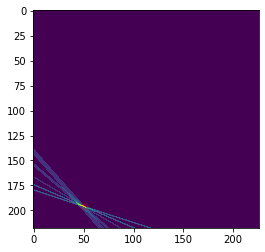

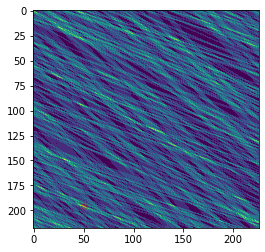

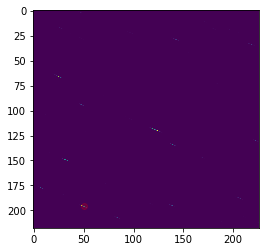

3 0


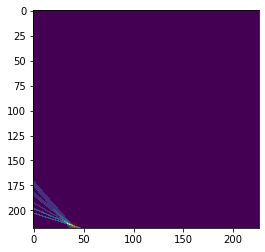

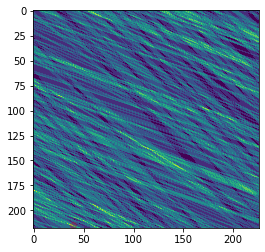

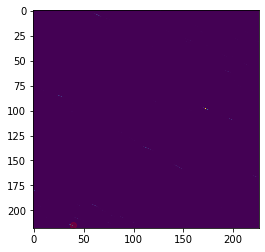

147 510
148 510
149 510
150 510
151 510
152 510
153 510
evaluating
0 0


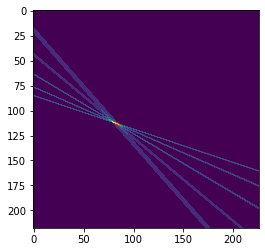

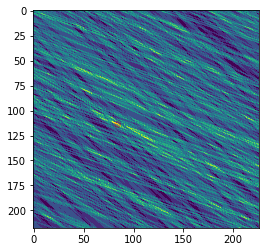

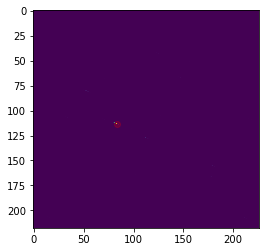

0 1


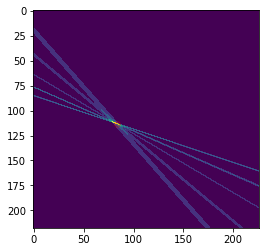

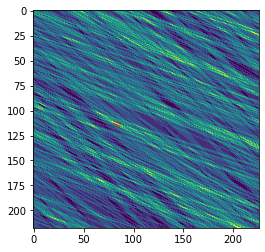

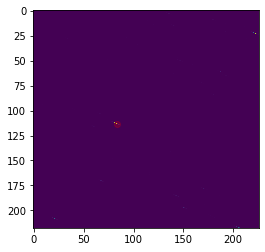

1 2


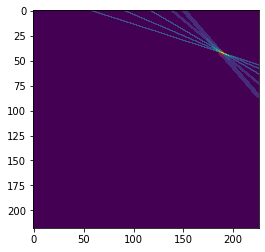

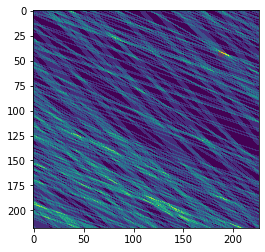

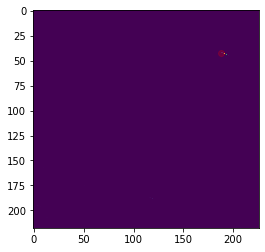

2 2


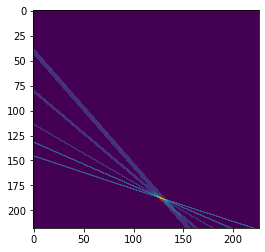

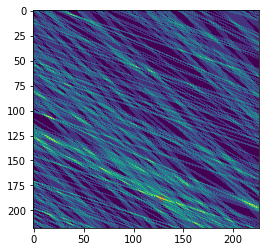

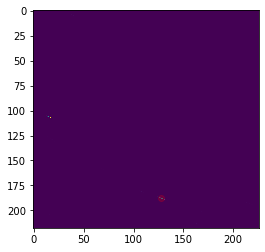

2 4


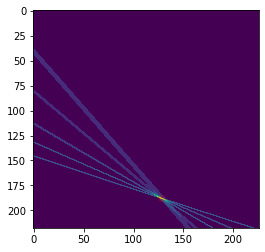

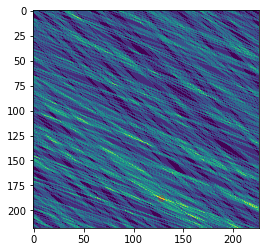

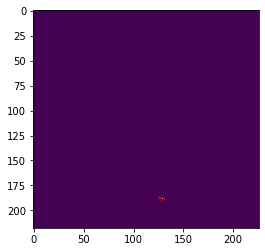

3 3


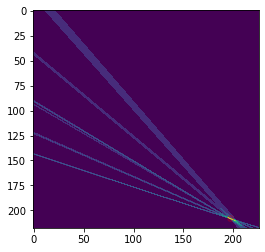

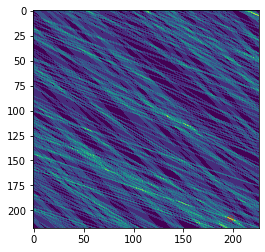

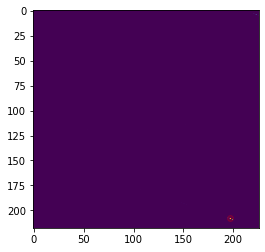

154 510
155 510
156 510
157 510
158 510
159 510
160 510
evaluating
0 0


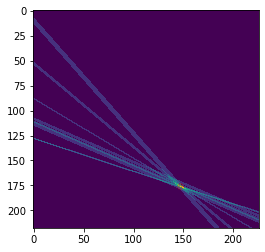

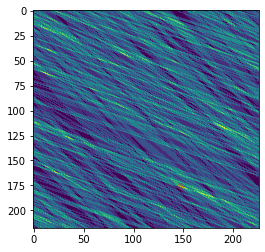

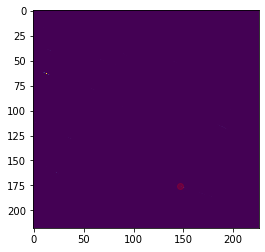

0 1


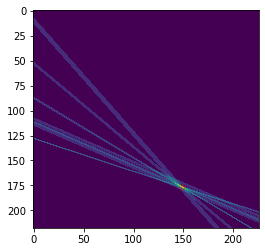

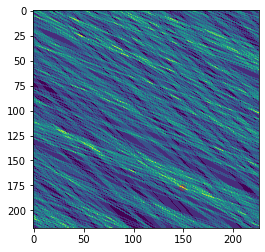

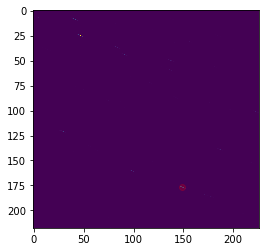

1 1


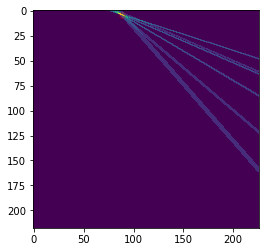

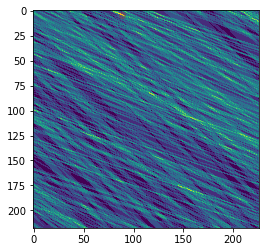

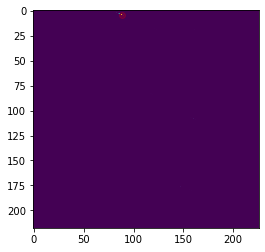

1 3


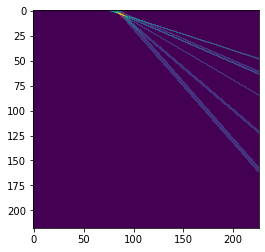

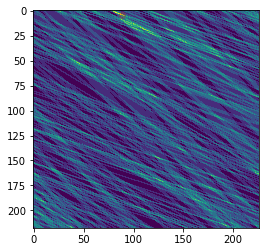

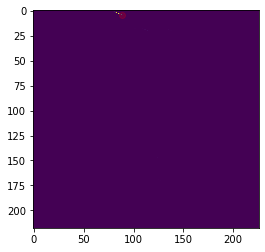

2 3


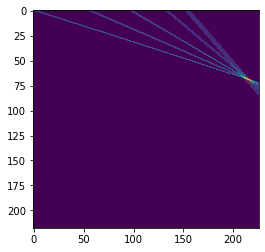

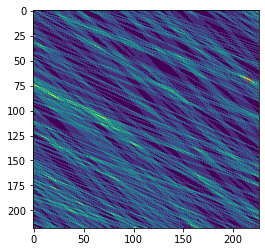

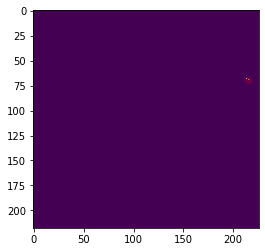

3 0


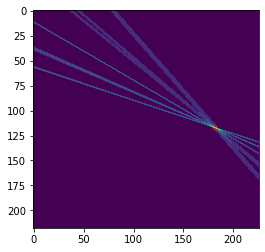

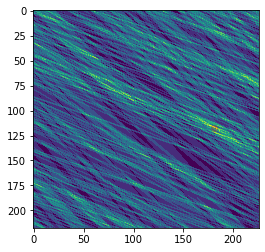

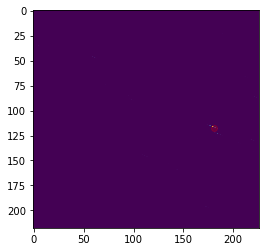

161 510
162 510
163 510
164 510
165 510
166 510
167 510
evaluating
0 0


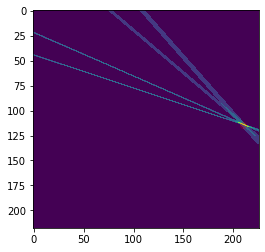

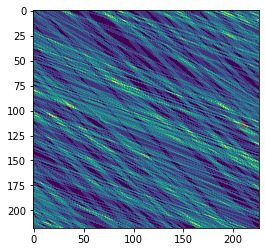

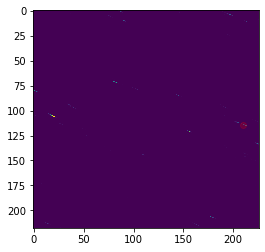

0 1


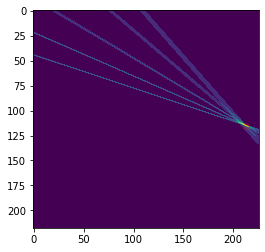

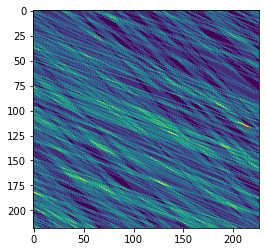

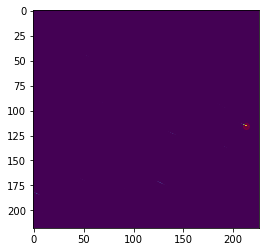

1 2


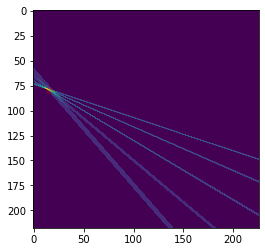

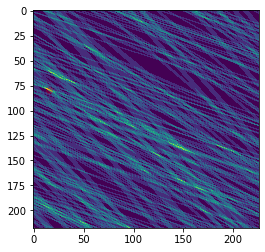

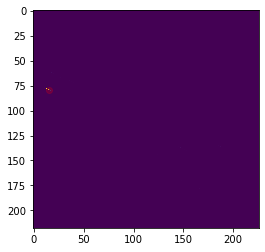

2 0


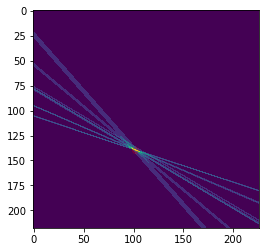

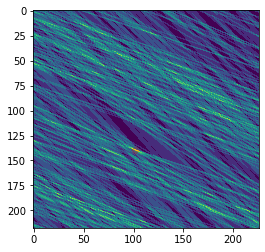

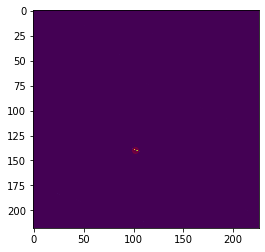

2 1


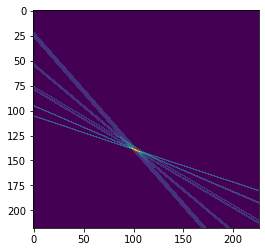

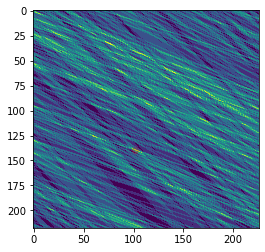

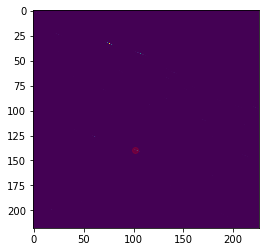

3 3


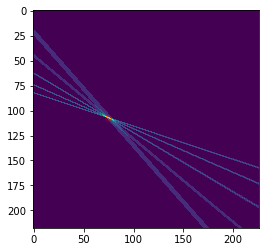

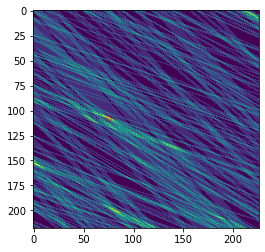

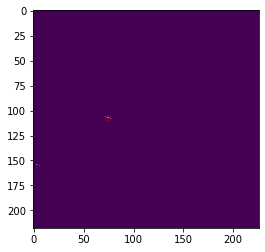

168 510
169 510
170 510
171 510
172 510
173 510
174 510
evaluating
0 0


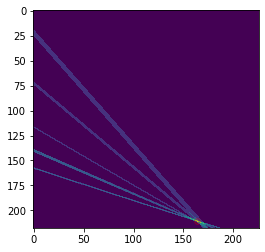

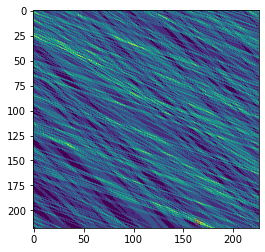

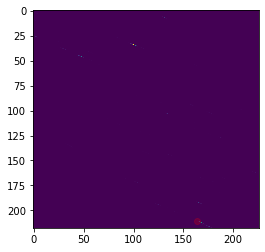

0 1


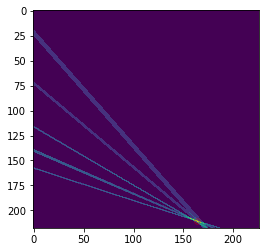

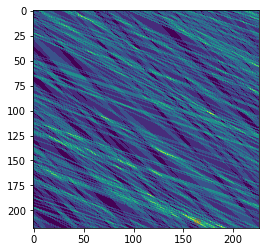

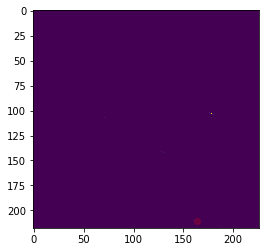

1 0


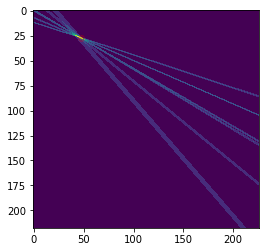

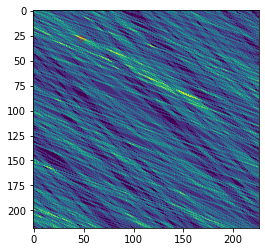

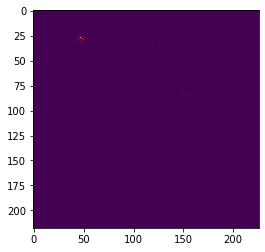

2 1


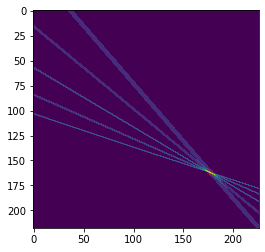

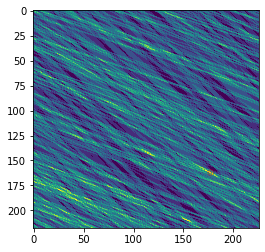

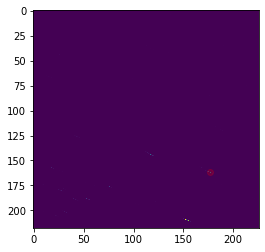

3 0


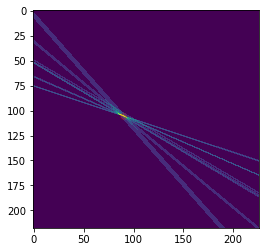

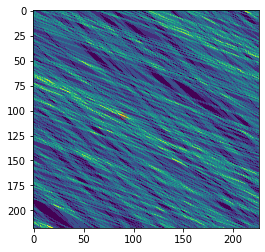

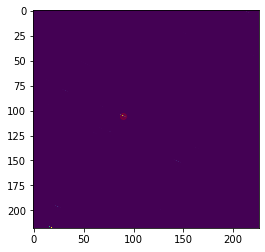

4 5


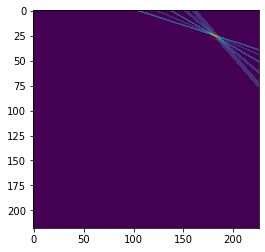

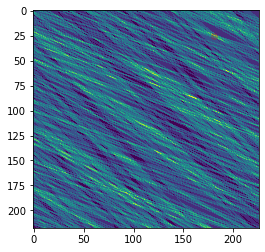

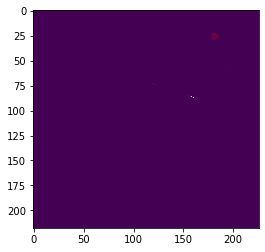

175 510
176 510
177 510
178 510
179 510
180 510
181 510
evaluating
0 4


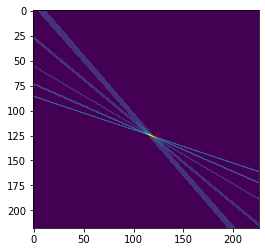

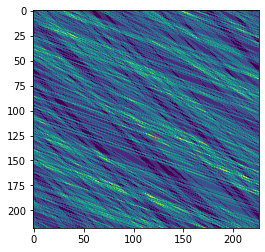

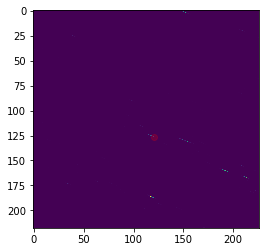

0 5


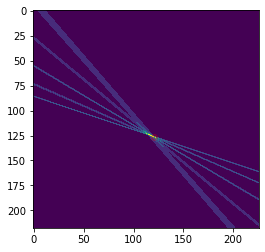

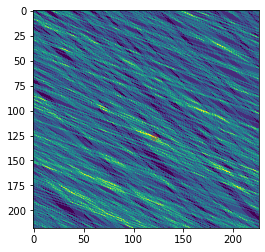

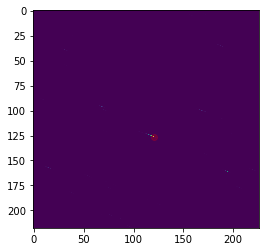

1 1


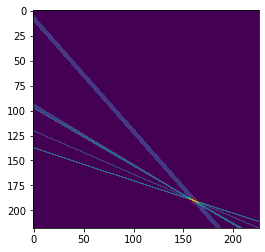

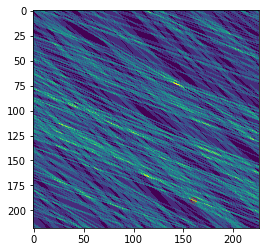

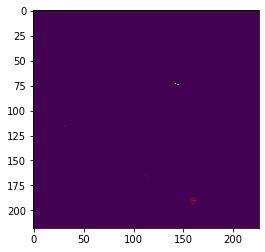

2 4


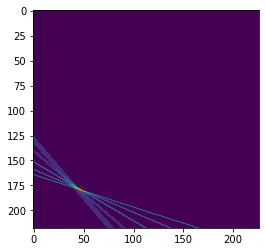

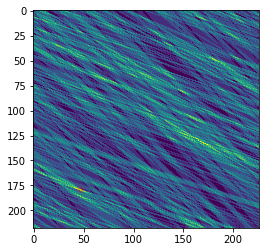

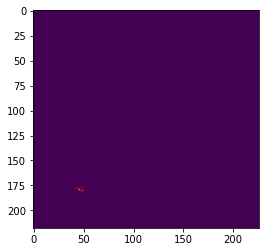

2 5


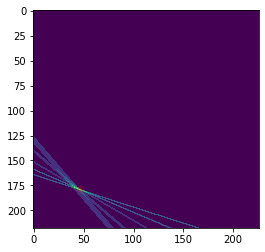

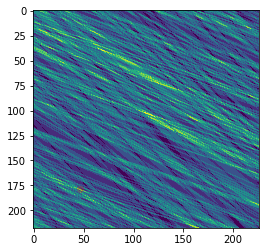

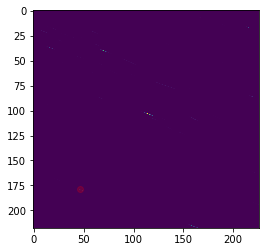

3 0


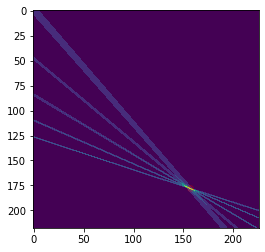

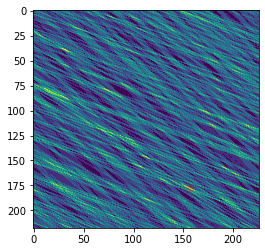

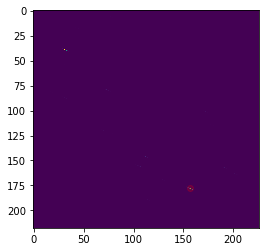

182 510
183 510
184 510
185 510
186 510
187 510
188 510
evaluating
0 4


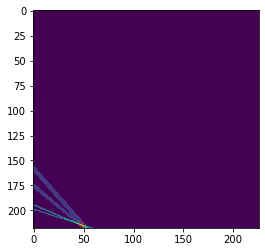

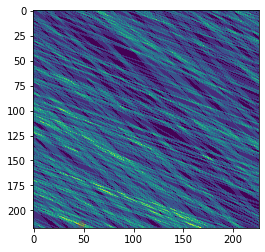

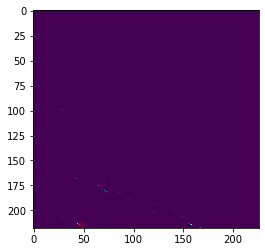

0 5


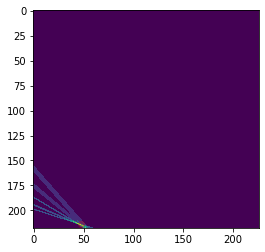

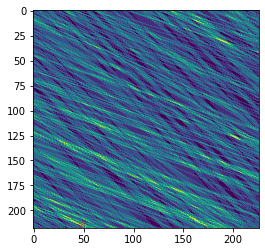

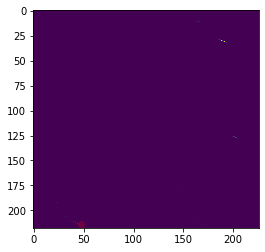

1 4


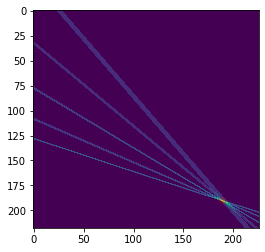

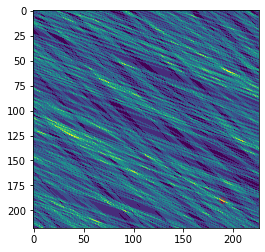

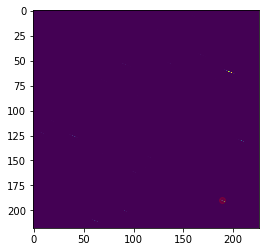

2 0


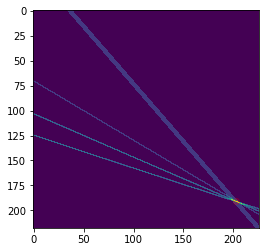

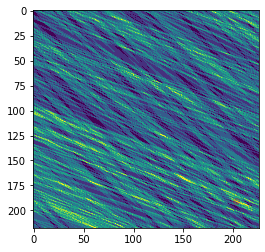

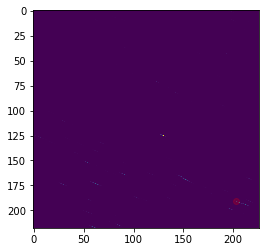

2 5


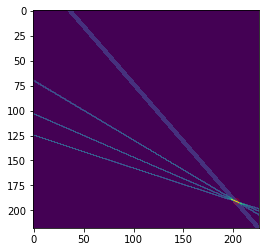

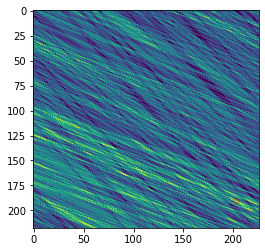

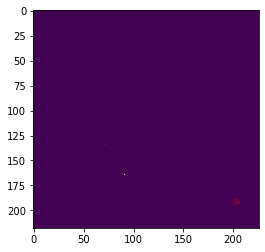

3 4


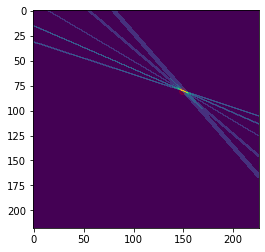

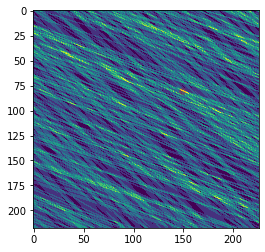

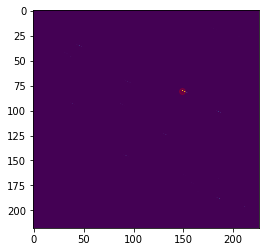

189 510
190 510
191 510
192 510
193 510
194 510
195 510
evaluating
0 0


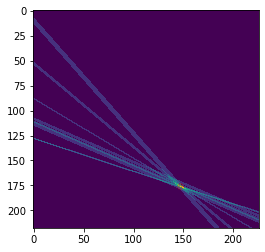

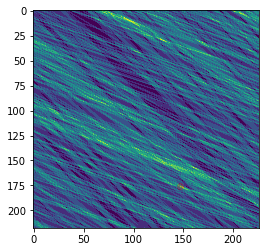

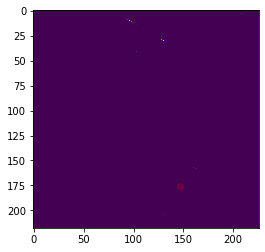

0 1


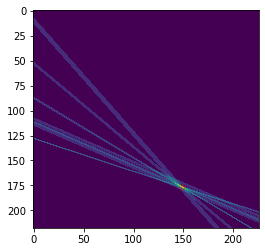

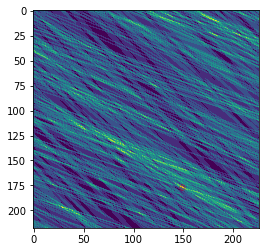

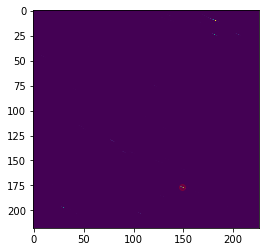

1 1


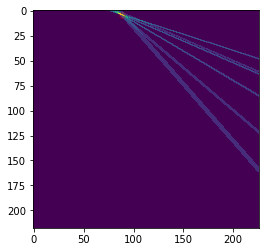

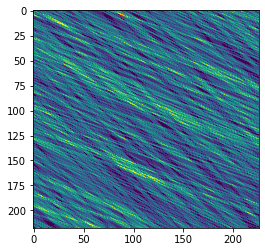

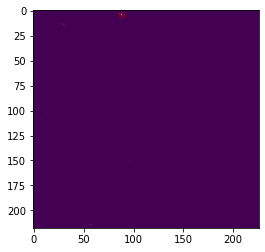

1 3


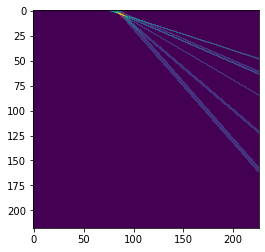

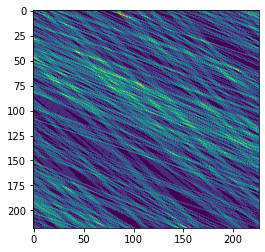

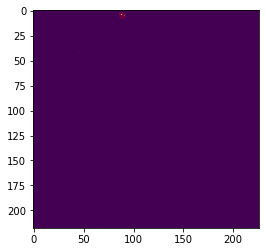

2 3


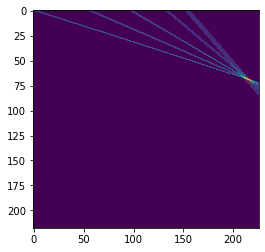

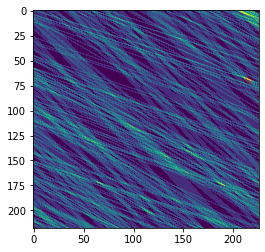

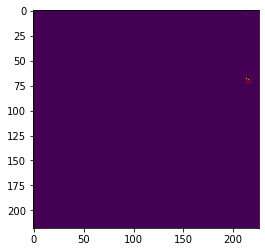

3 0


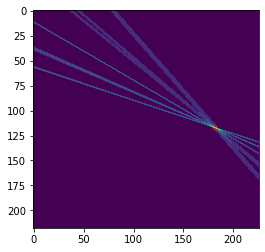

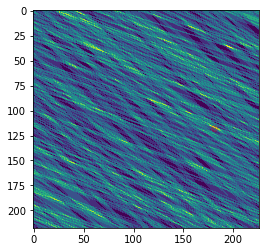

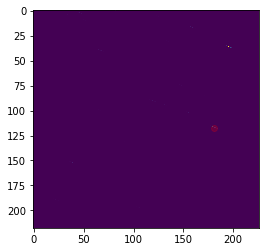

196 510
197 510
198 510
199 510
200 510
201 510
202 510
evaluating
0 4


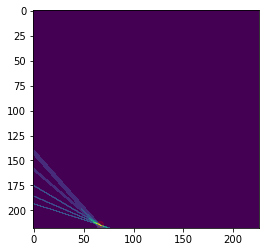

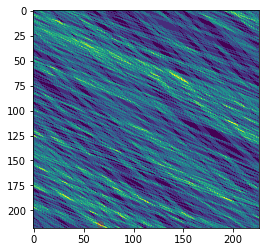

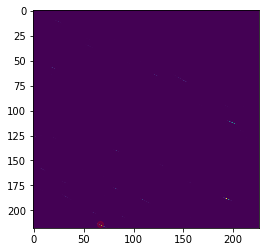

0 5


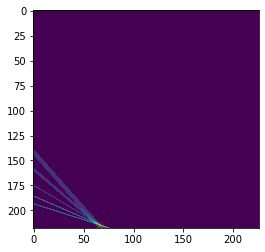

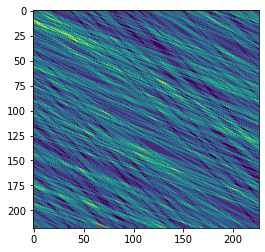

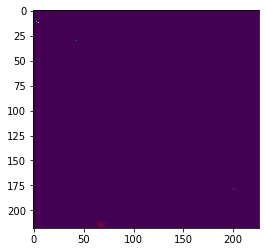

1 4


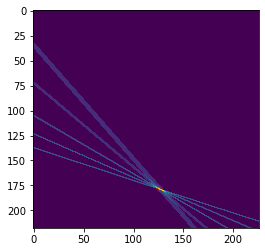

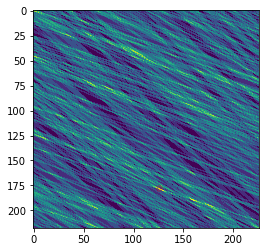

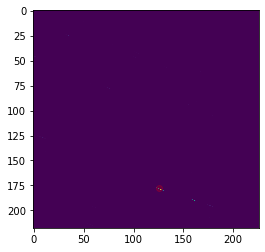

1 5


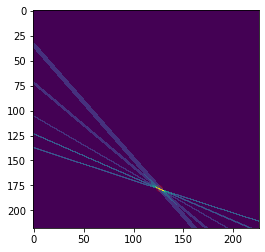

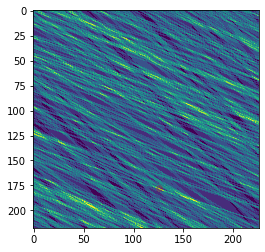

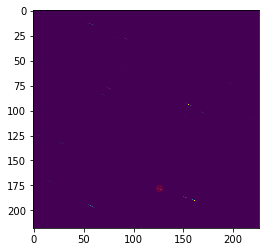

2 1


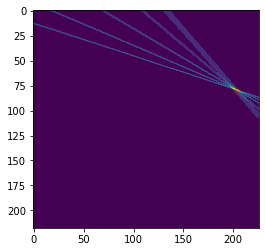

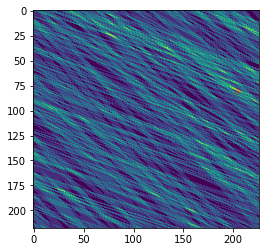

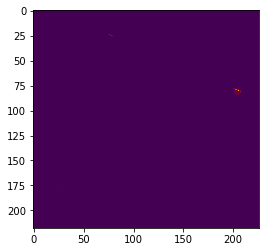

3 4


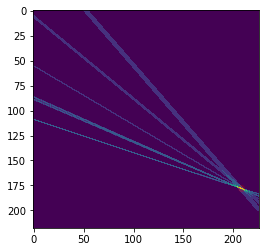

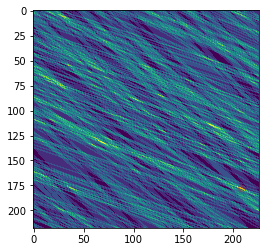

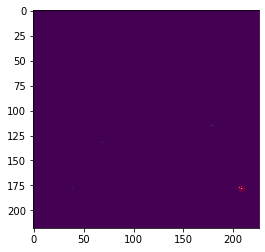

203 510
204 510
205 510
206 510
207 510
208 510
209 510
evaluating
0 4


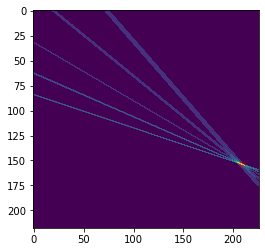

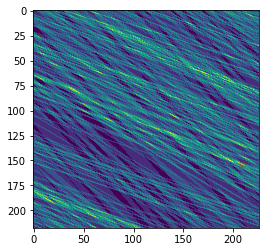

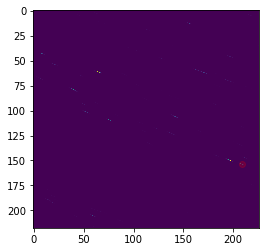

0 5


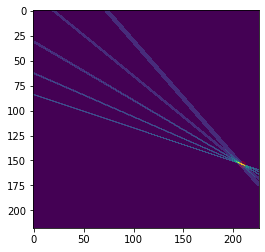

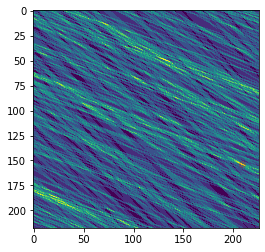

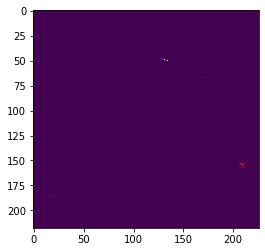

1 3


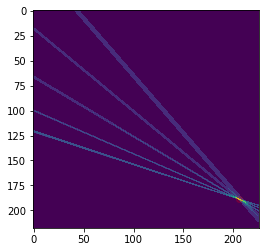

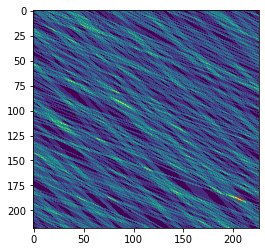

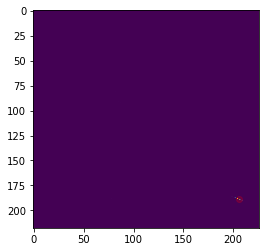

2 0


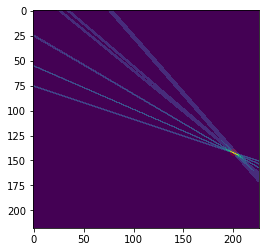

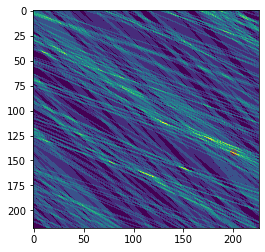

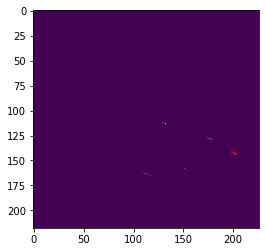

3 4


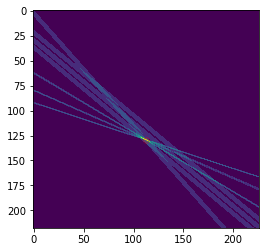

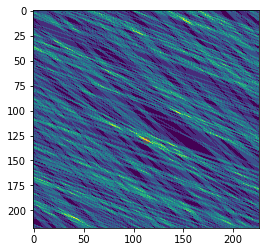

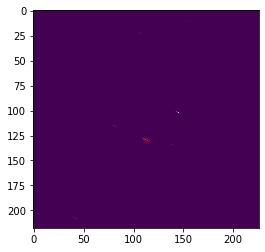

3 5


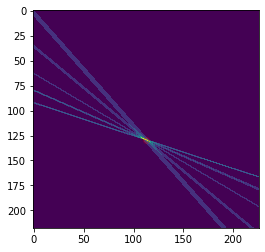

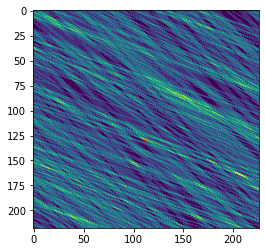

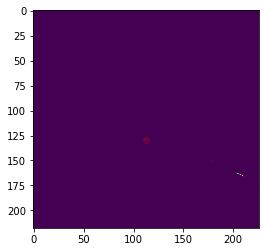

210 510
211 510
212 510
213 510
214 510
215 510
216 510
evaluating
0 1


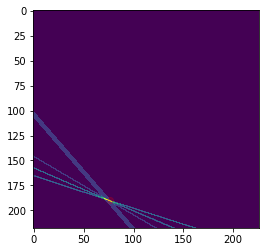

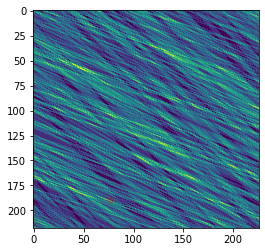

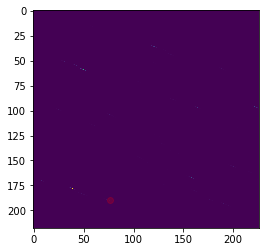

0 3


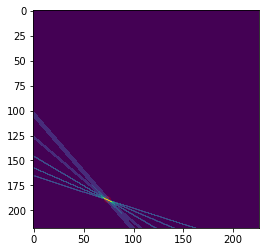

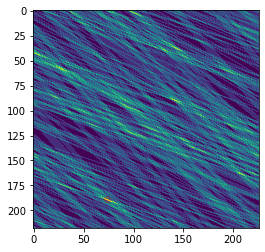

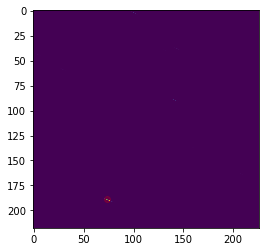

1 5


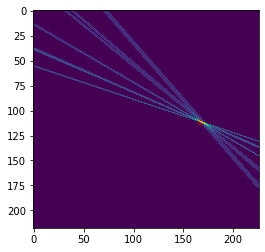

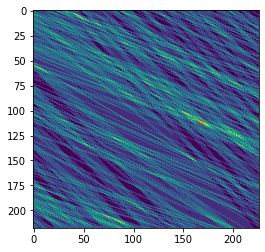

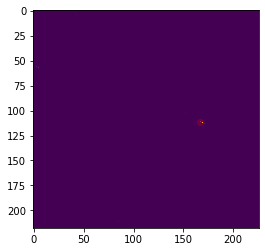

2 0


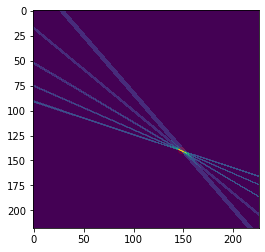

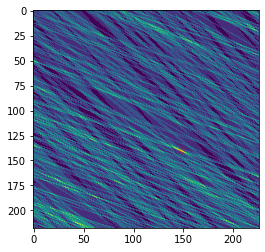

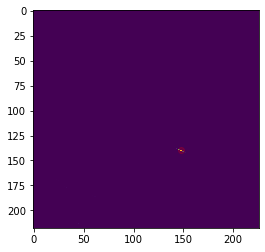

2 5


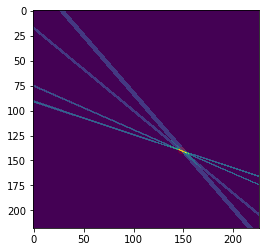

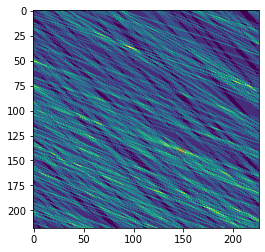

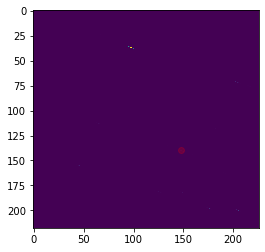

3 0


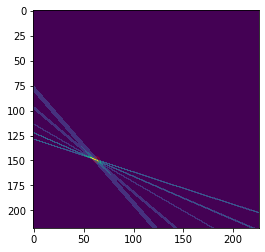

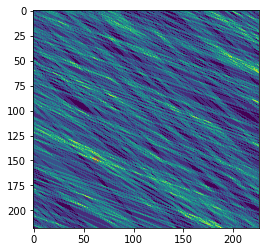

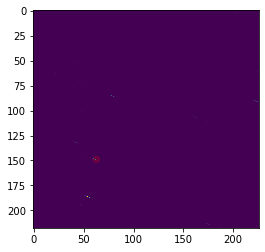

217 510
218 510
219 510
220 510
221 510
222 510
223 510
evaluating
0 0


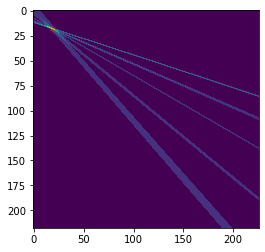

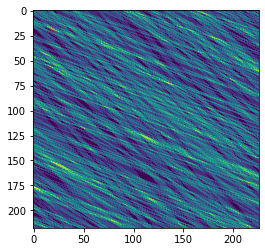

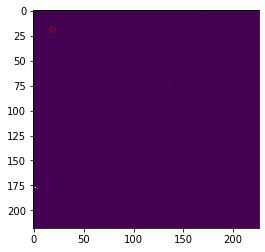

0 1


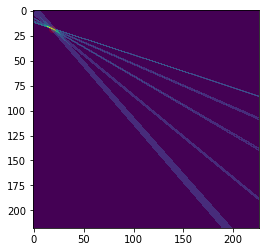

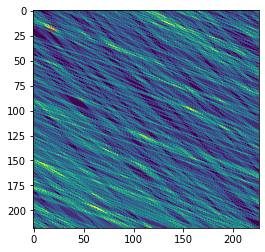

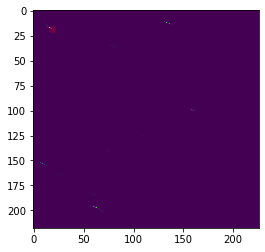

1 0


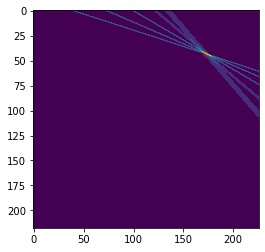

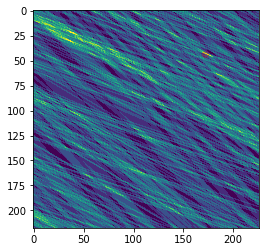

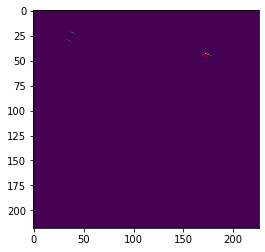

2 0


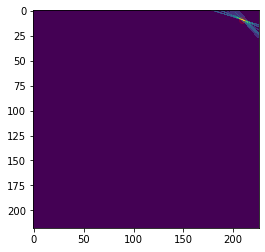

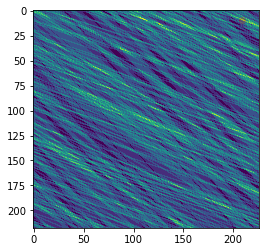

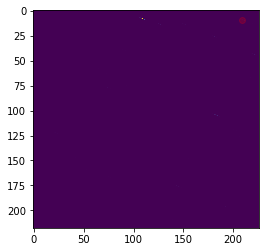

2 1


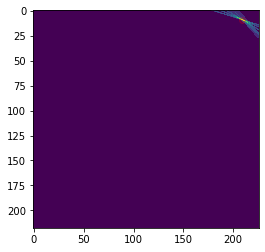

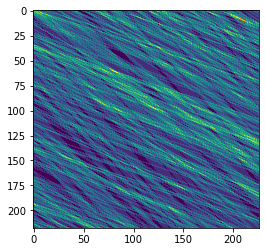

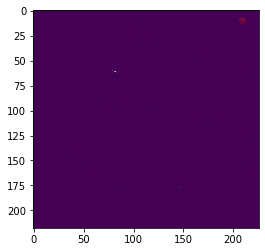

4 1


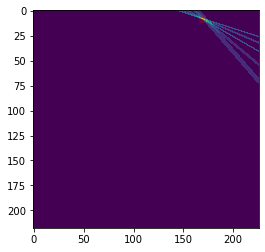

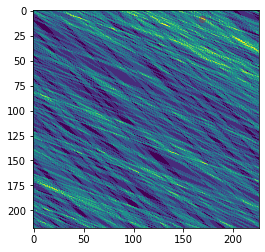

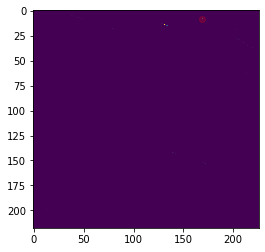

224 510
225 510
226 510
227 510
228 510
229 510
230 510
evaluating
0 0


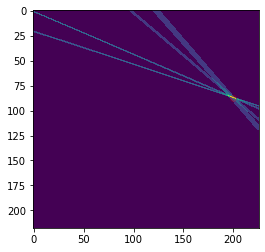

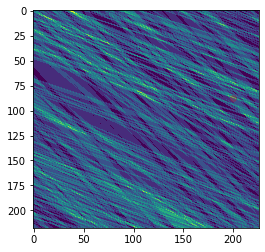

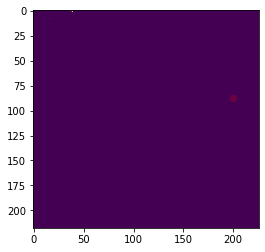

0 1


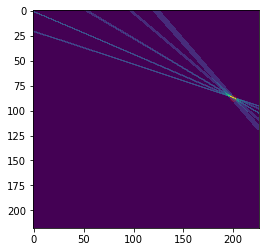

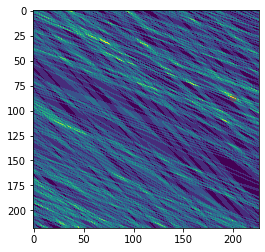

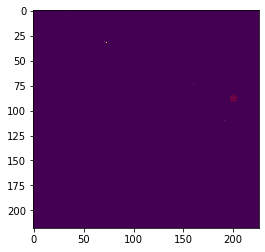

1 0


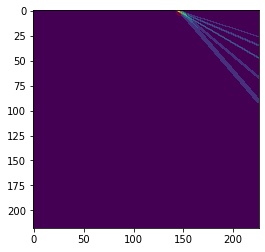

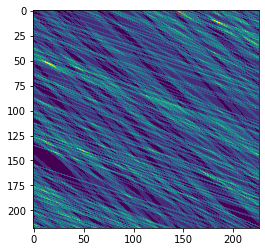

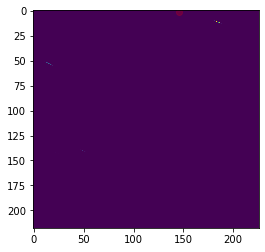

1 5


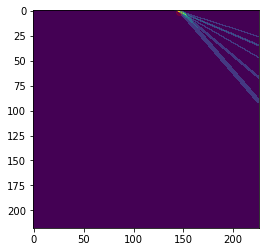

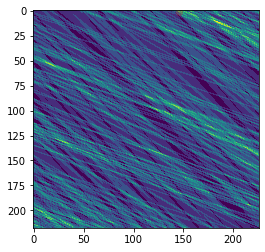

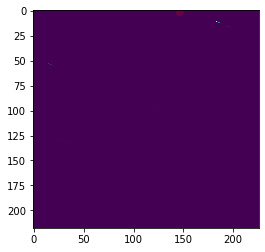

2 0


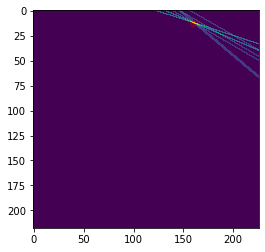

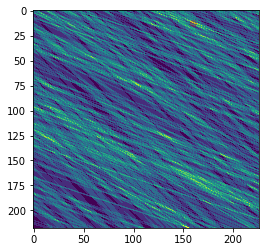

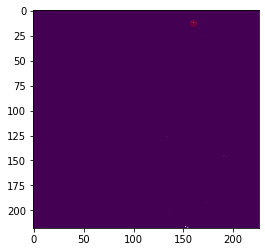

2 1


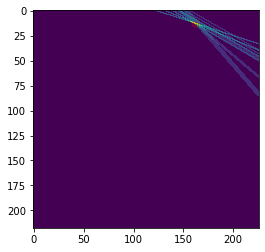

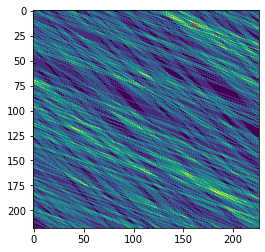

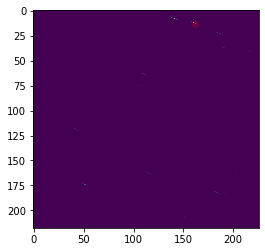

231 510
232 510
233 510
234 510
235 510
236 510
237 510
evaluating
0 3


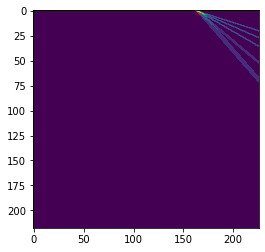

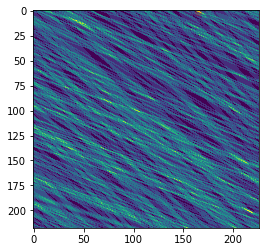

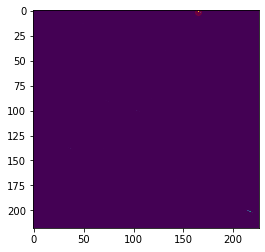

1 0


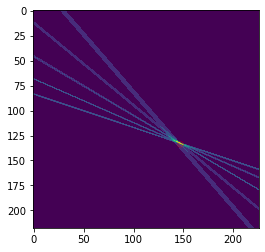

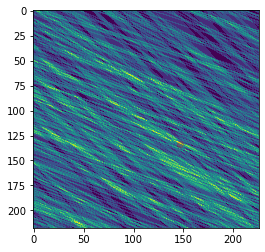

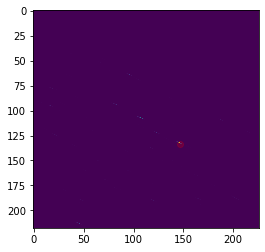

1 5


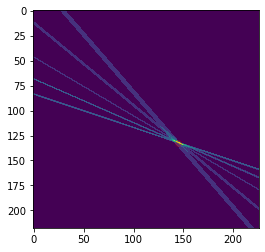

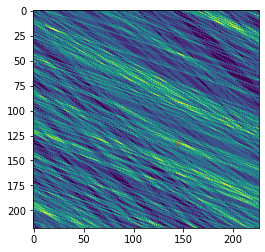

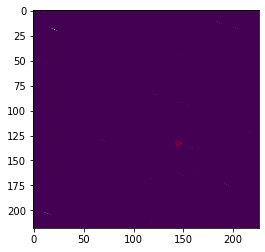

2 5


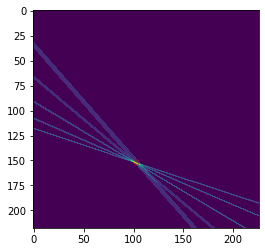

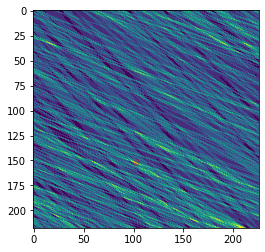

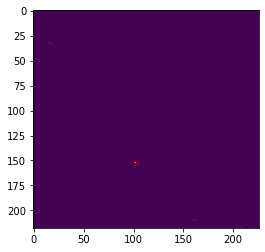

3 4


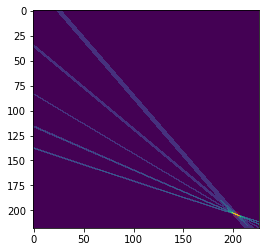

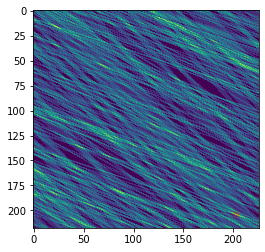

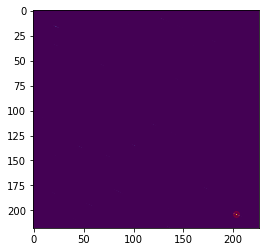

3 5


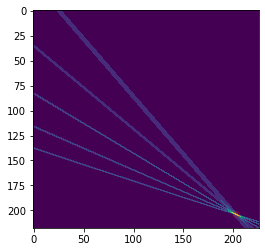

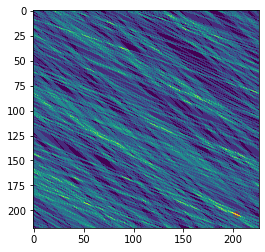

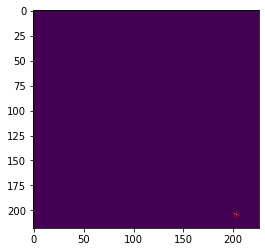

238 510
239 510
240 510
241 510
242 510
243 510
244 510
evaluating
0 1


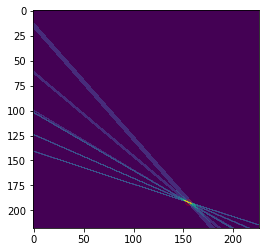

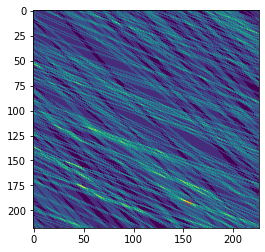

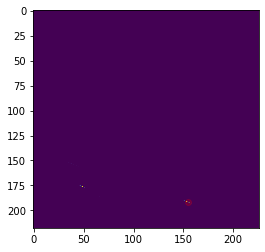

0 3


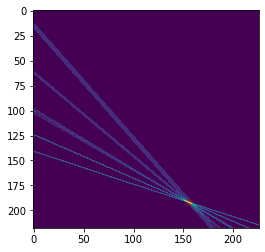

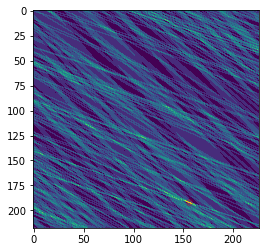

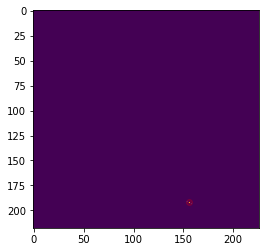

1 1


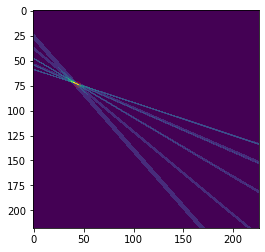

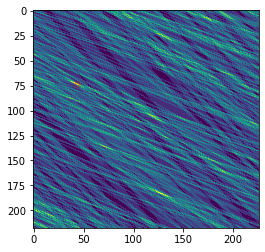

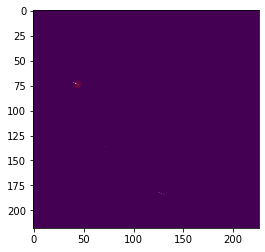

2 0


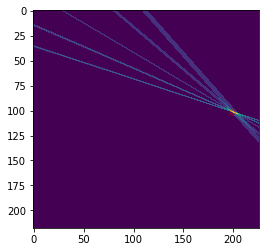

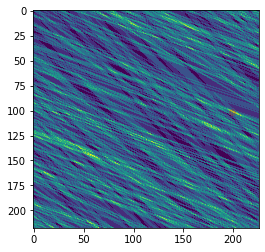

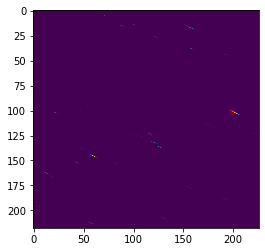

2 5


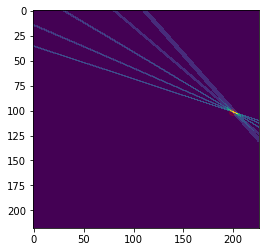

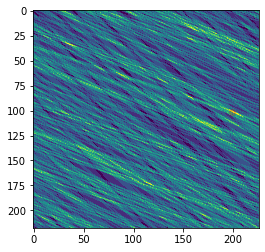

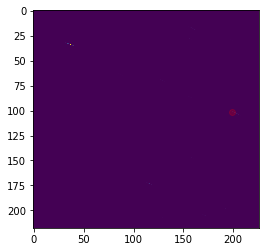

3 0


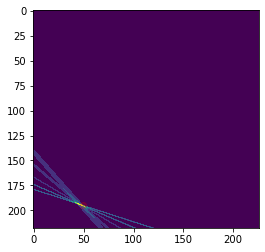

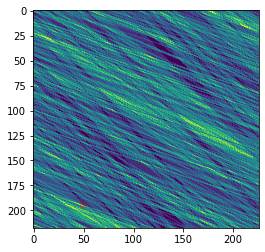

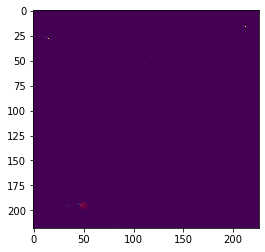

245 510
246 510
247 510
248 510
249 510
250 510
251 510
evaluating
0 0


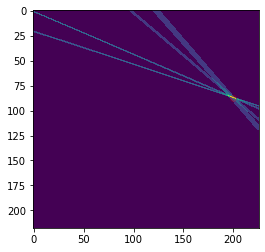

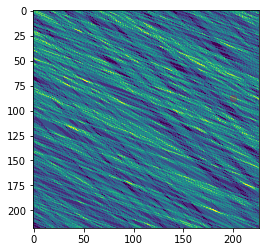

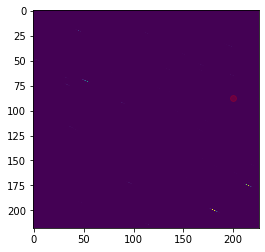

0 1


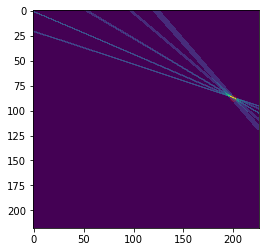

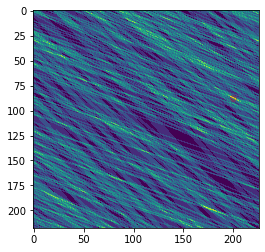

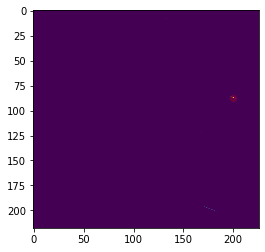

1 0


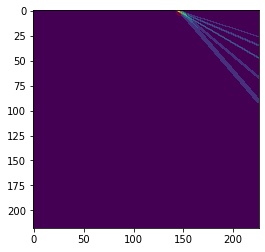

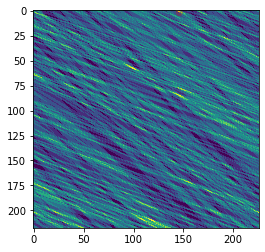

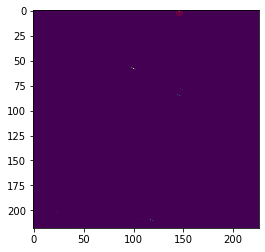

1 5


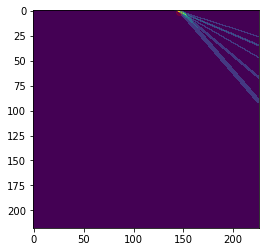

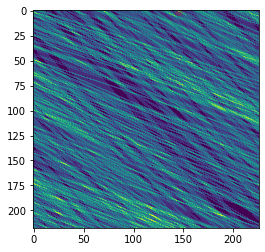

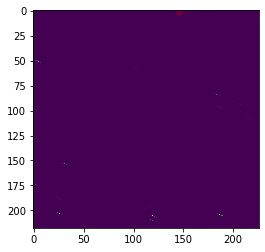

2 0


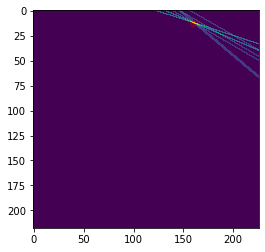

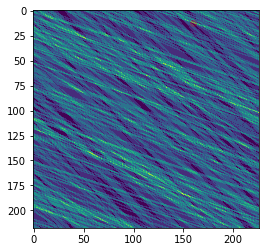

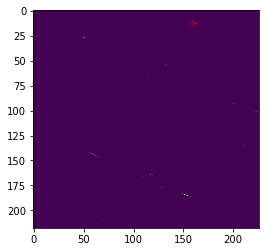

2 1


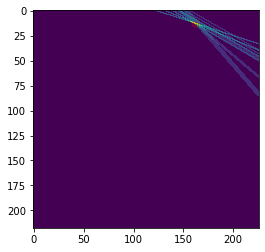

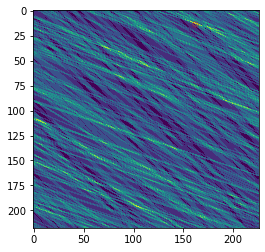

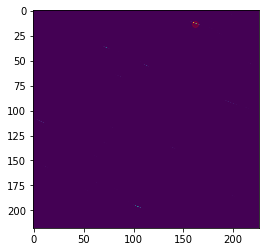

252 510
253 510
254 510
255 510
256 510
257 510
258 510
evaluating
0 4


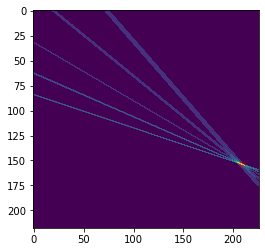

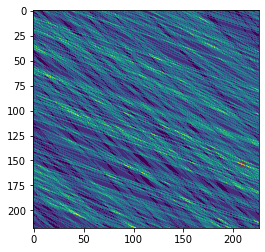

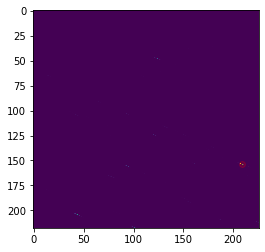

0 5


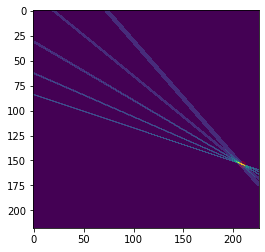

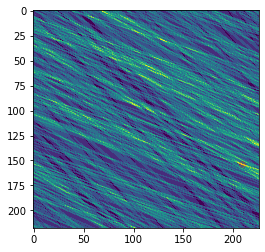

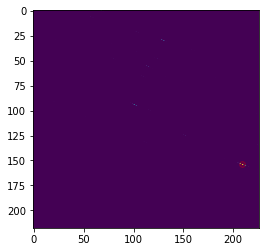

1 3


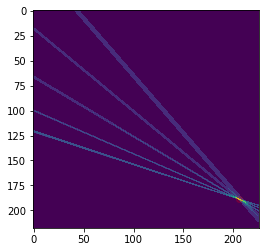

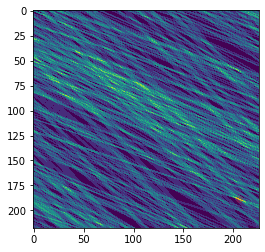

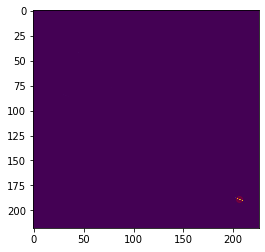

2 0


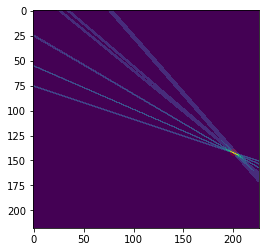

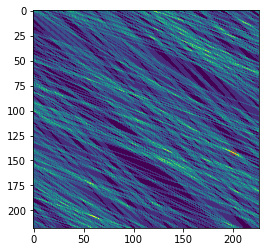

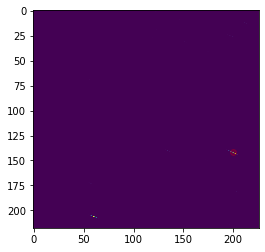

3 4


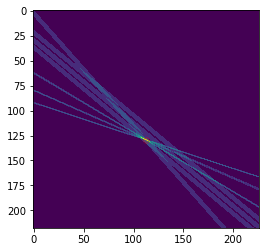

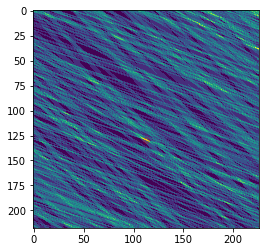

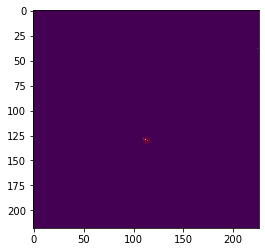

3 5


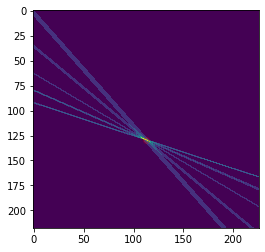

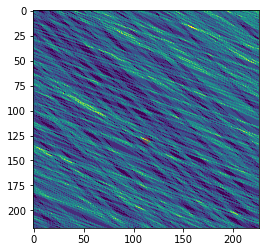

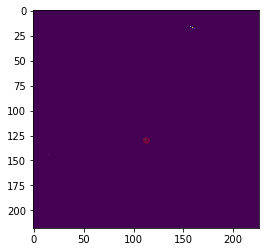

259 510
260 510
261 510
262 510
263 510
264 510
265 510
evaluating
0 1


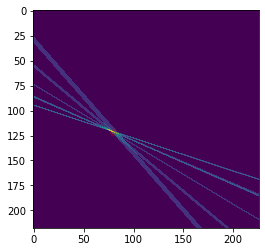

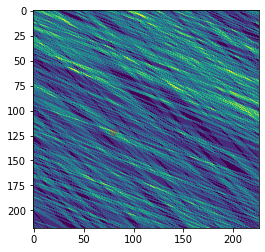

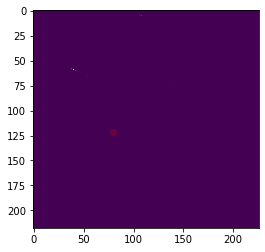

1 0


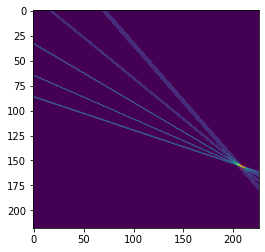

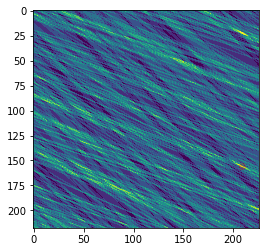

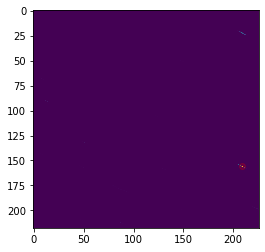

1 5


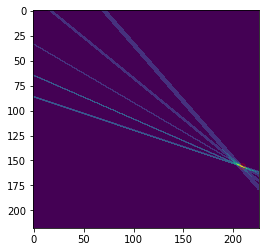

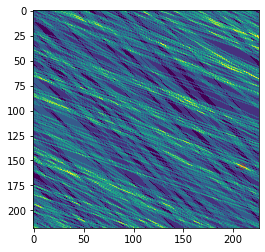

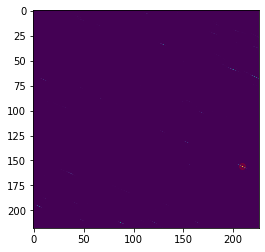

2 0


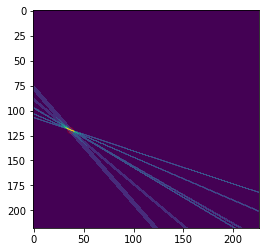

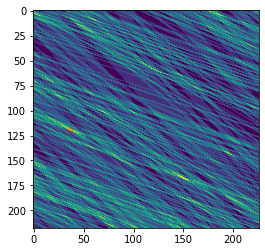

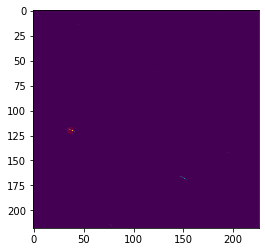

2 1


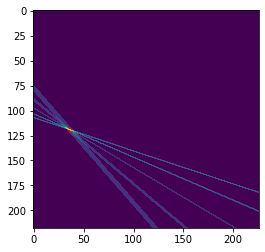

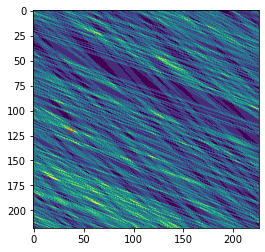

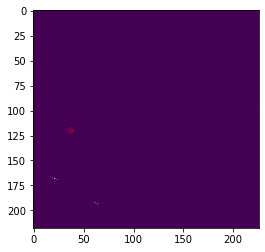

3 0


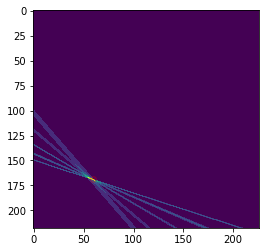

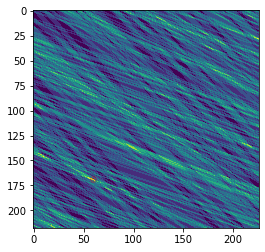

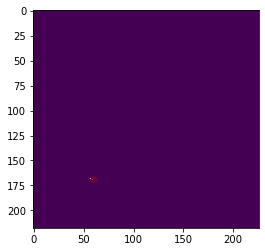

266 510
267 510
268 510
269 510
270 510
271 510
272 510
evaluating
0 4


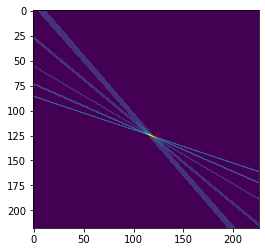

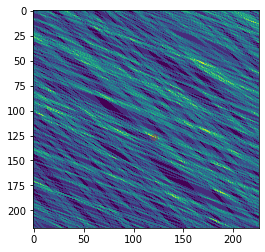

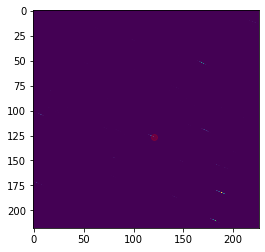

0 5


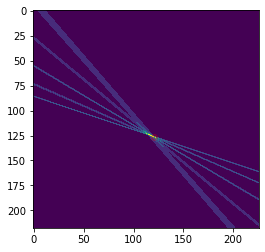

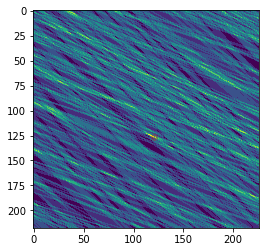

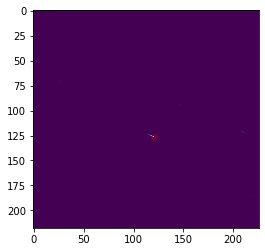

1 1


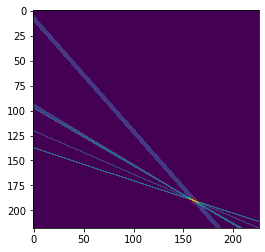

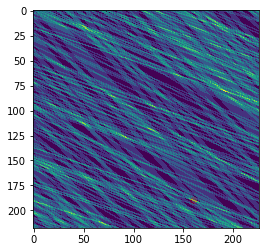

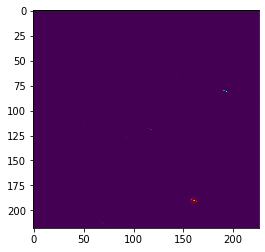

2 4


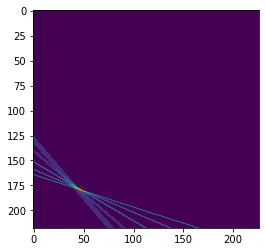

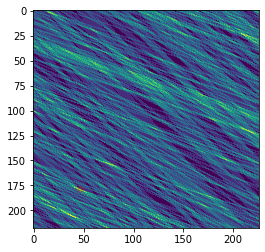

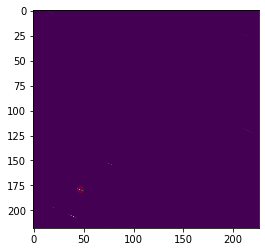

2 5


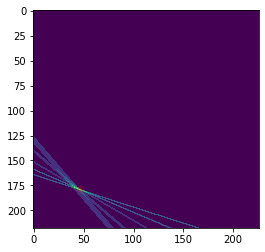

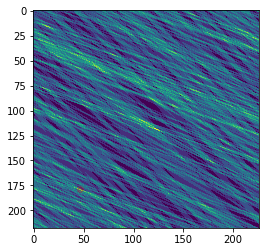

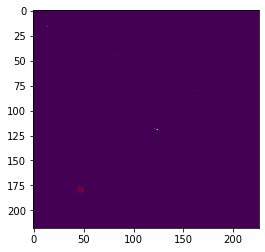

3 0


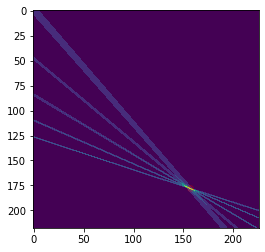

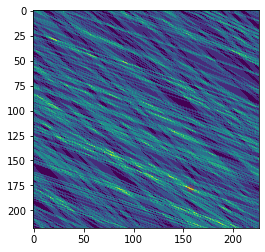

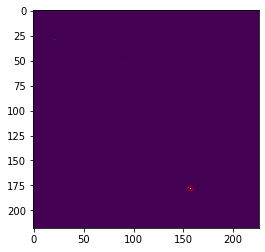

273 510
274 510
275 510
276 510
277 510
278 510
279 510
evaluating
0 0


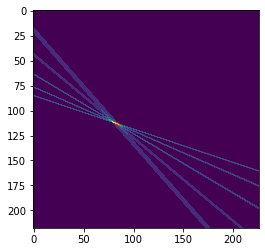

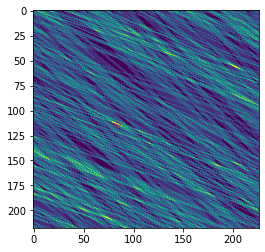

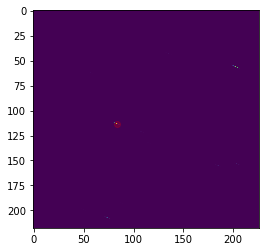

0 1


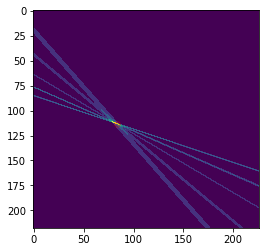

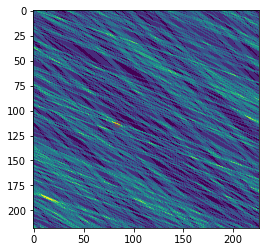

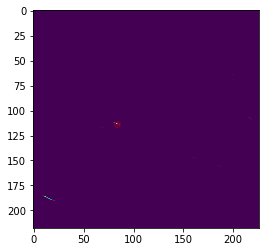

1 2


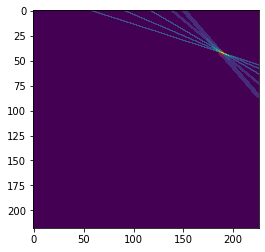

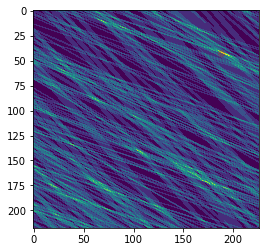

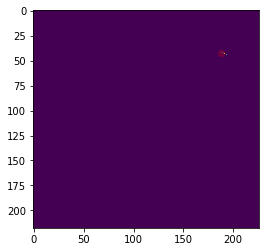

2 2


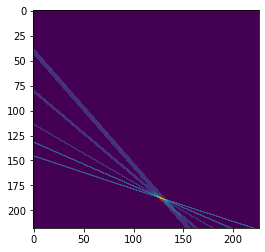

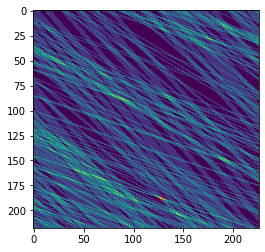

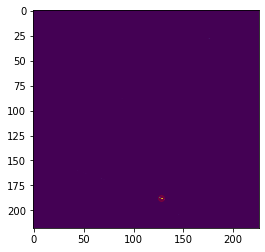

2 4


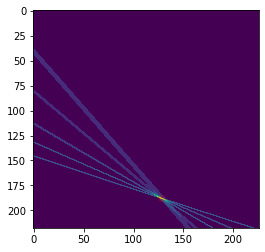

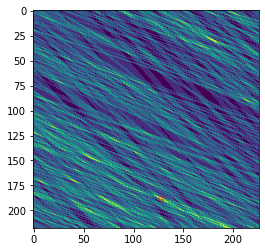

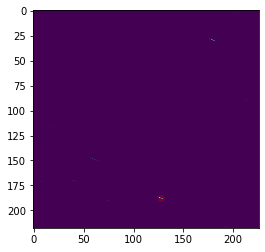

3 3


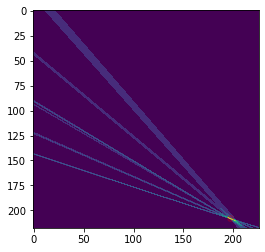

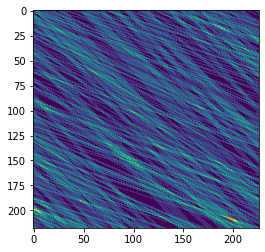

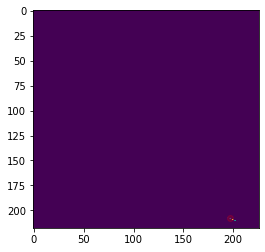

280 510
281 510
282 510
283 510
284 510
285 510
286 510
evaluating
0 1


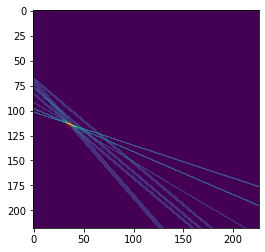

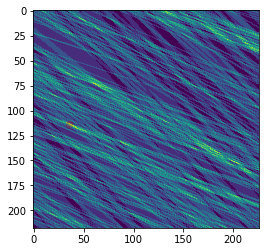

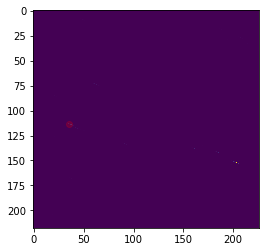

0 3


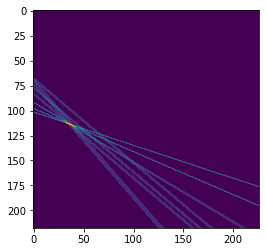

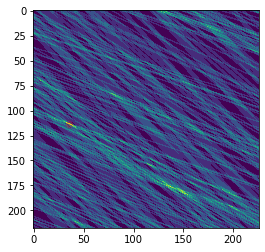

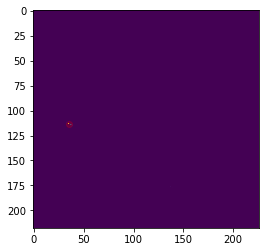

1 0


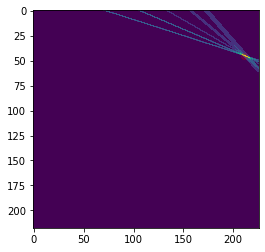

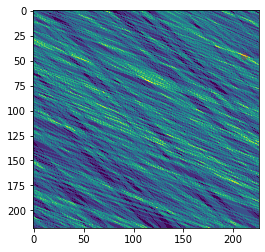

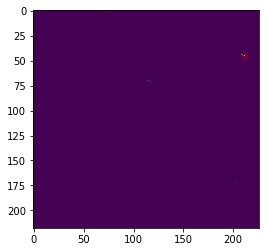

1 5


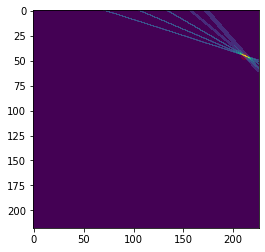

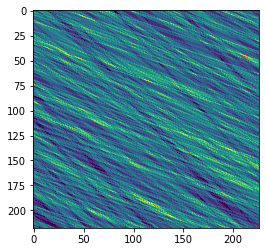

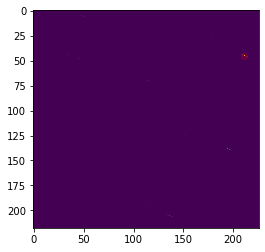

2 4


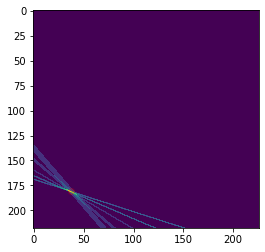

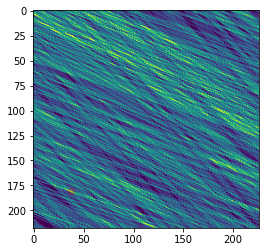

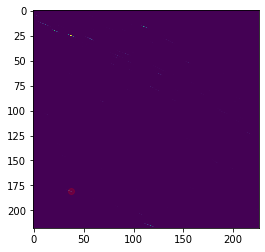

2 5


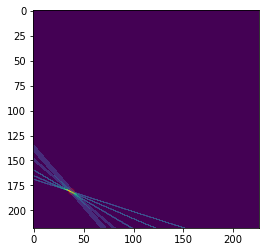

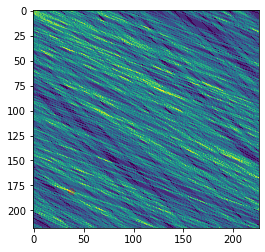

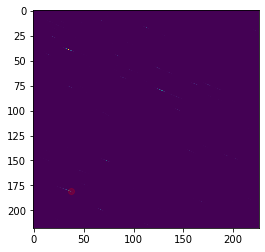

287 510
288 510
289 510
290 510
291 510
292 510
293 510
evaluating
1 2


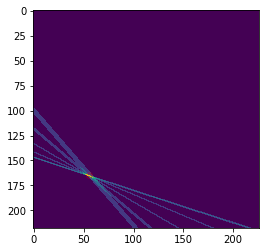

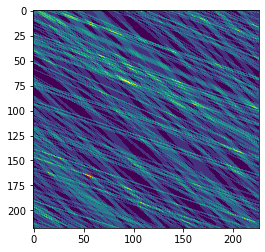

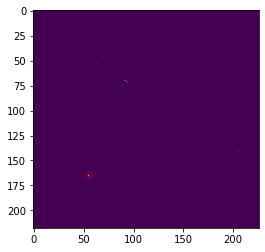

1 4


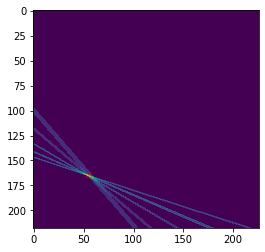

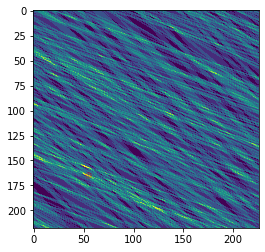

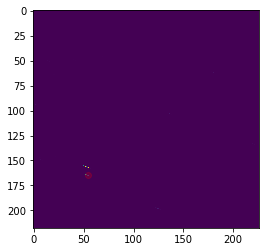

2 4


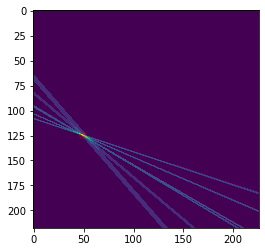

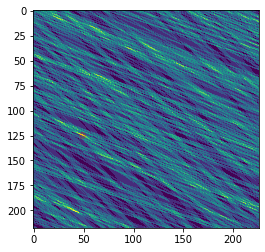

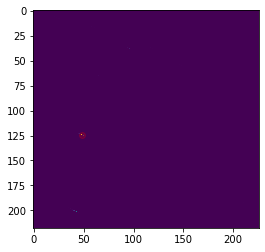

3 0


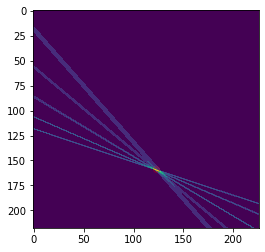

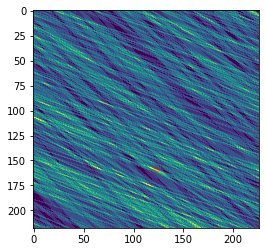

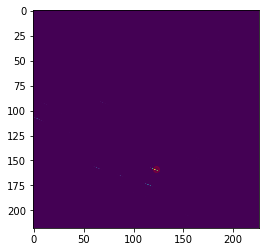

3 5


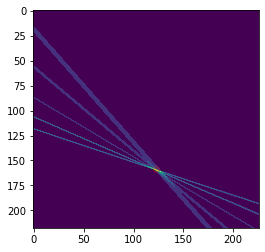

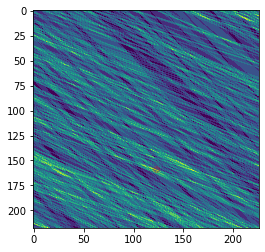

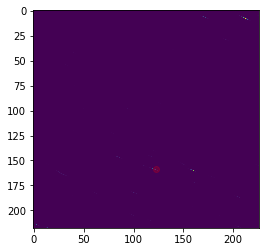

4 0


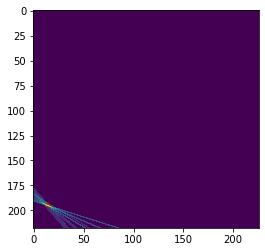

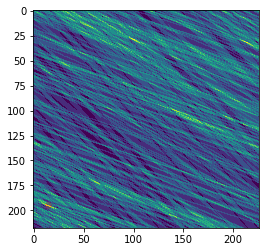

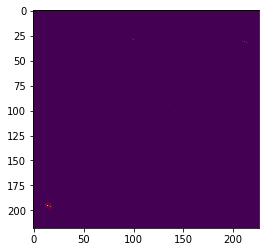

294 510
295 510
296 510
297 510
298 510
299 510
300 510
evaluating
0 0


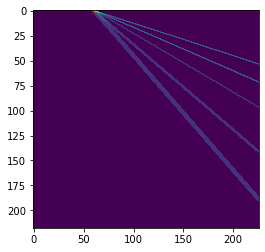

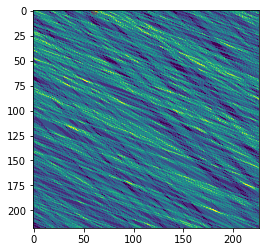

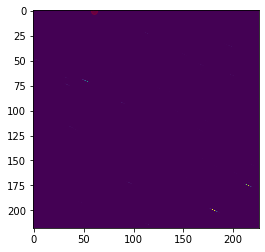

0 5


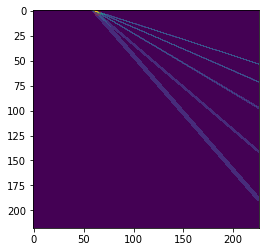

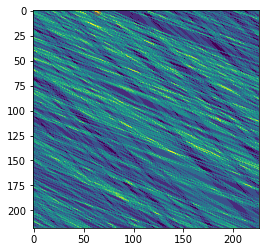

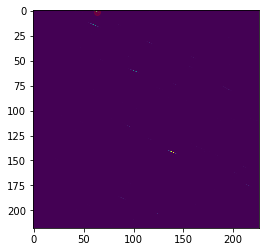

1 4


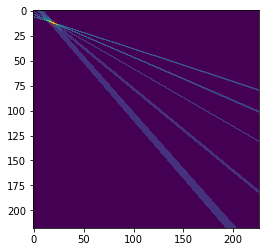

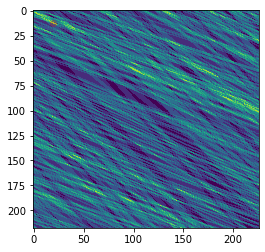

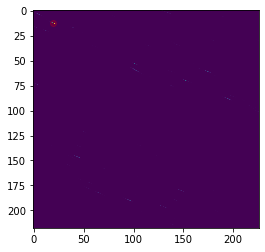

1 5


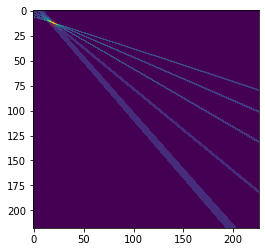

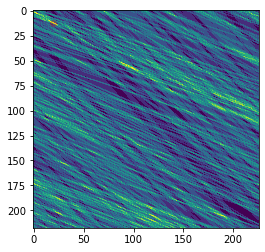

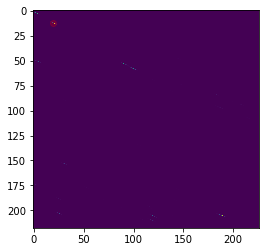

2 3


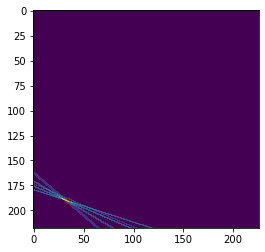

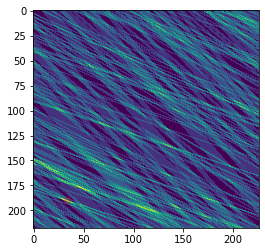

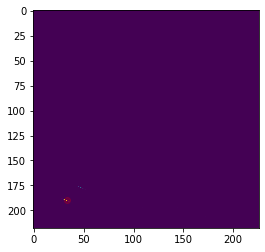

3 3


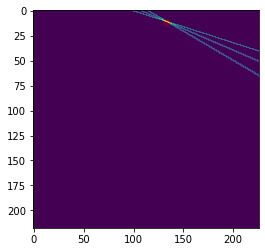

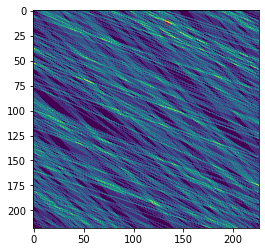

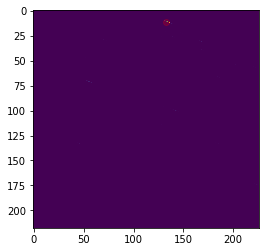

301 510
302 510
303 510
304 510
305 510
306 510
307 510
evaluating
0 2


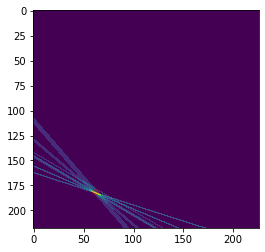

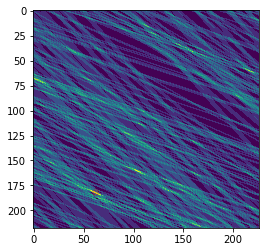

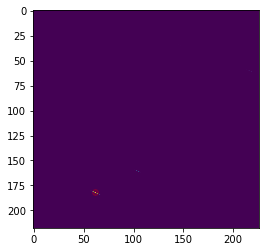

0 4


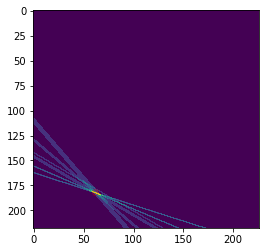

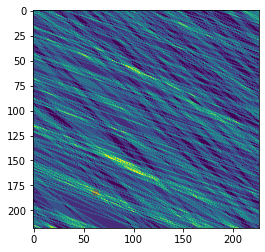

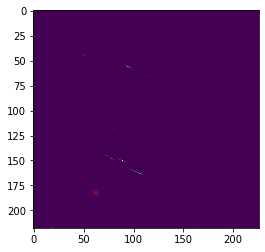

2 0


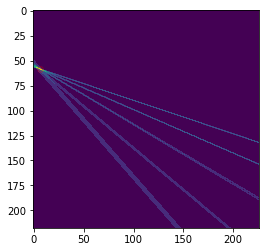

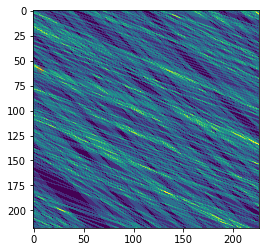

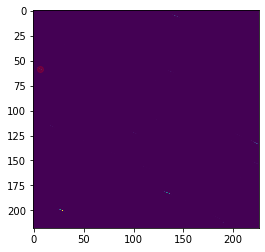

2 5


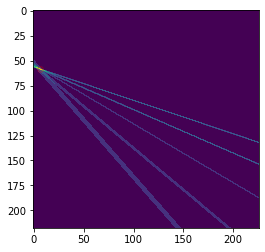

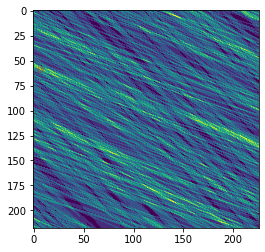

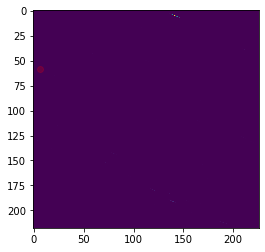

3 0


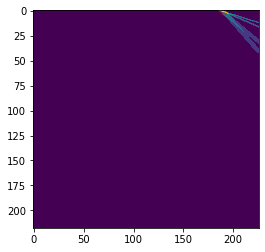

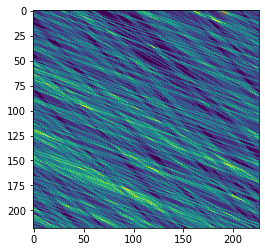

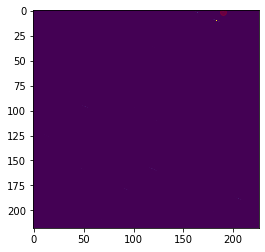

3 1


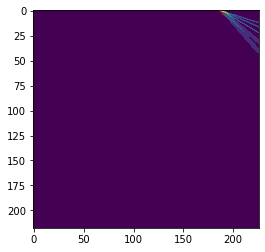

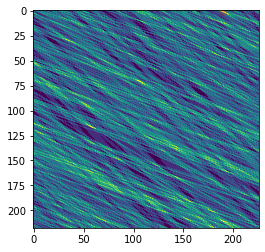

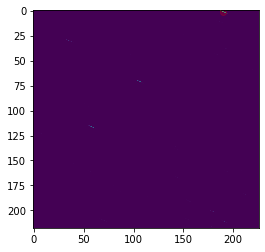

308 510
309 510
310 510
311 510
312 510
313 510
314 510
evaluating
0 0


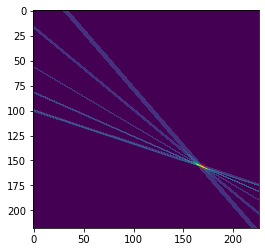

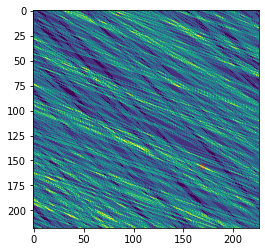

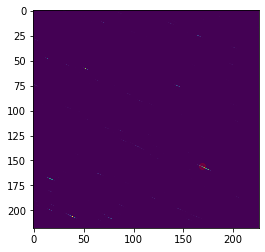

0 5


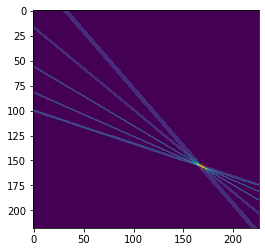

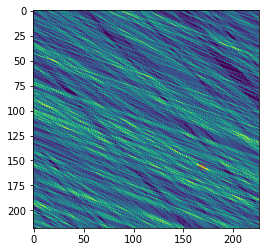

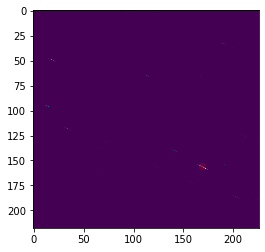

1 0


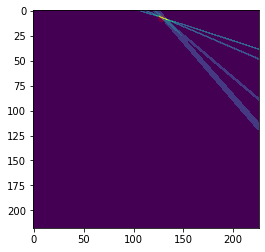

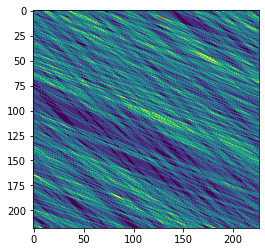

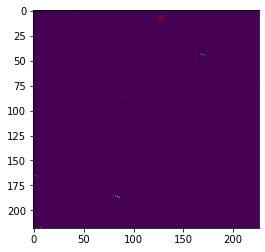

1 1


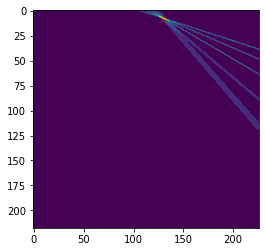

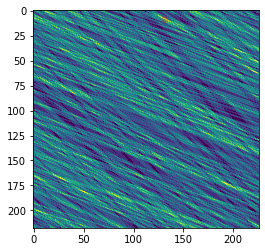

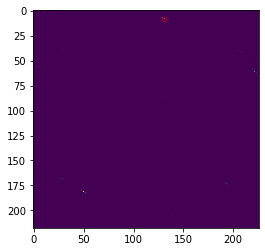

2 0


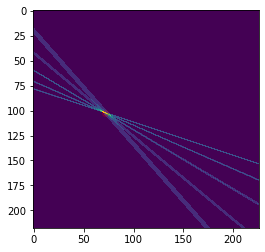

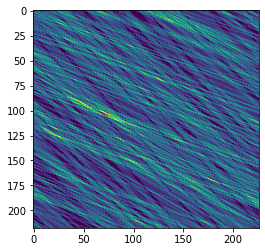

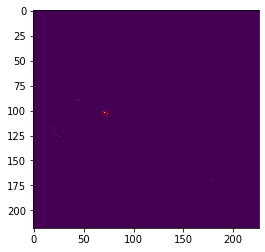

2 1


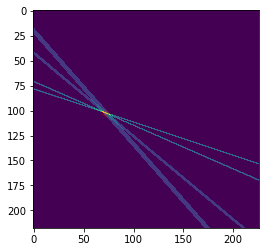

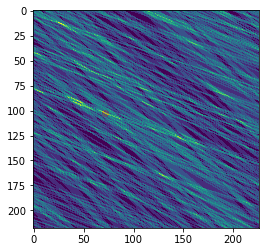

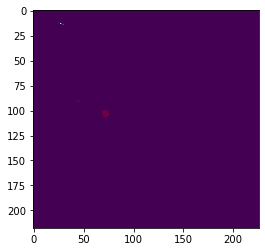

315 510
316 510
317 510
318 510
319 510
320 510
321 510
evaluating
0 0


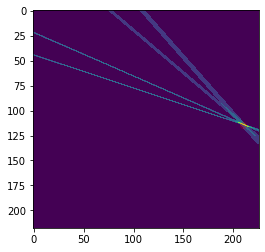

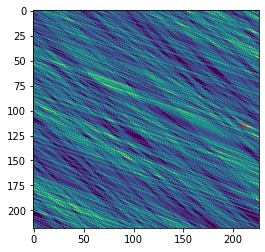

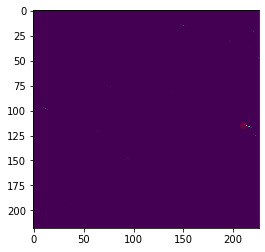

0 1


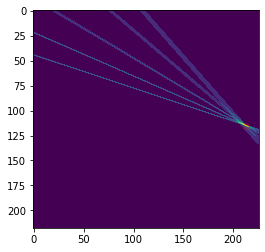

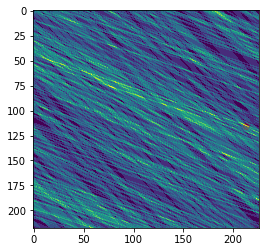

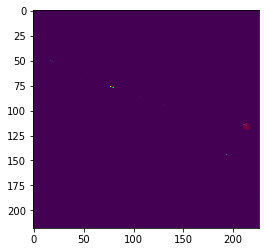

1 2


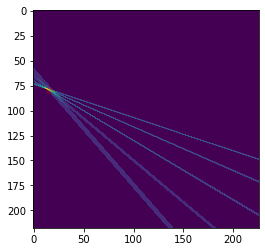

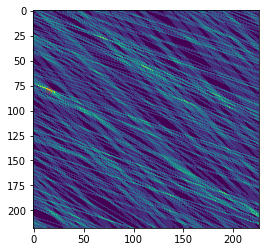

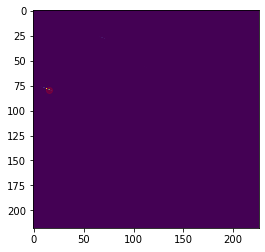

2 0


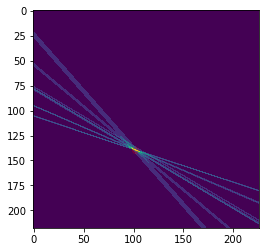

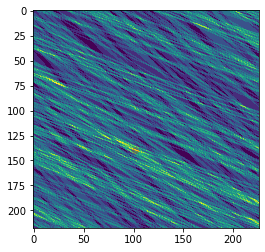

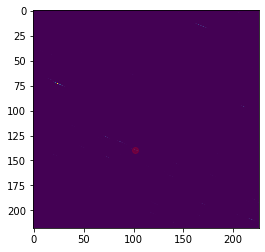

2 1


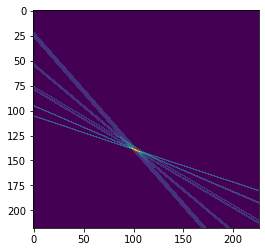

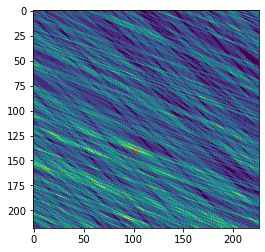

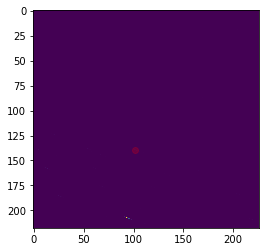

3 3


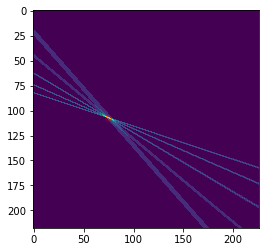

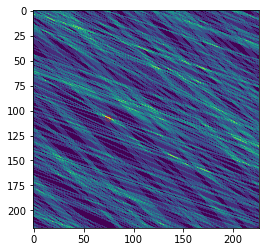

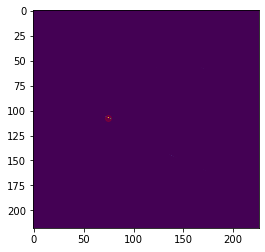

322 510
323 510
324 510
325 510
326 510
327 510
328 510
evaluating
0 5


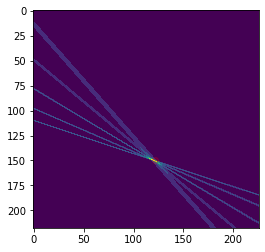

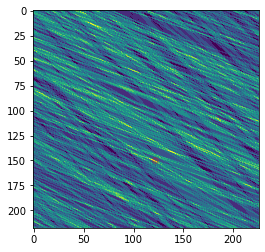

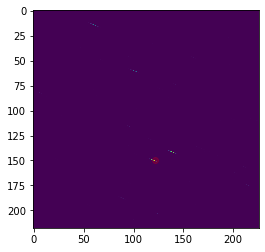

2 0


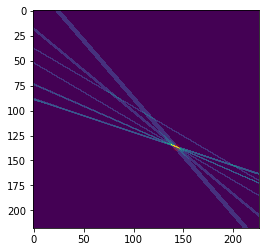

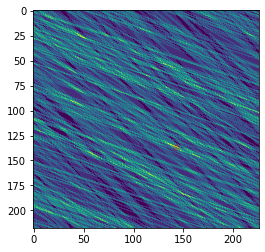

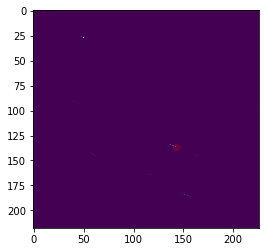

2 1


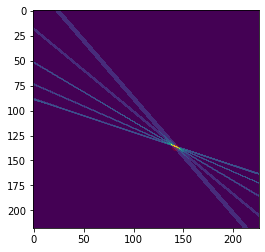

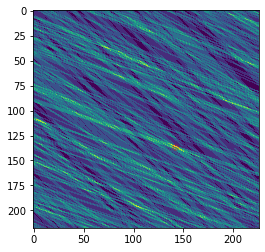

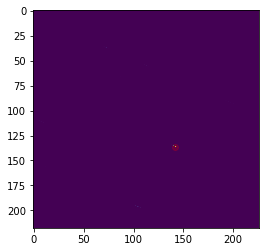

3 1


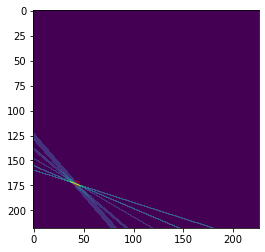

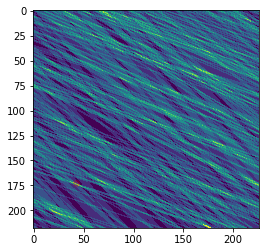

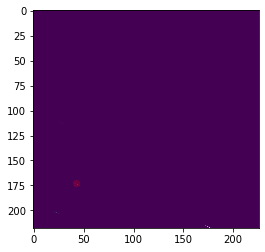

3 3


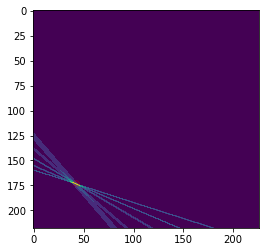

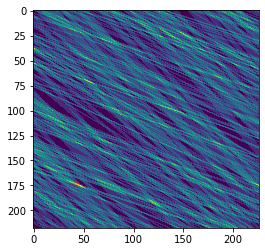

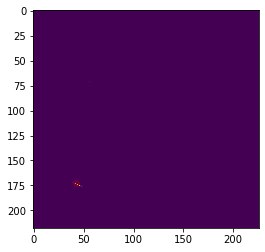

4 4


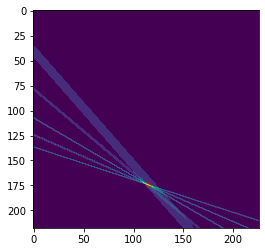

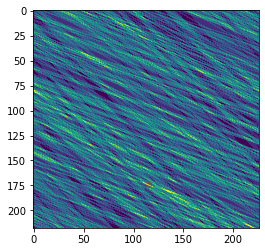

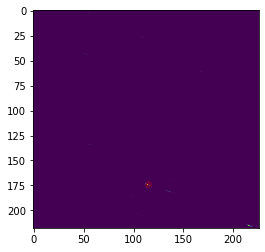

329 510
330 510
331 510
332 510
333 510
334 510
335 510
evaluating
0 4


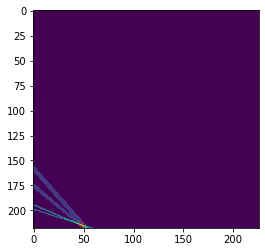

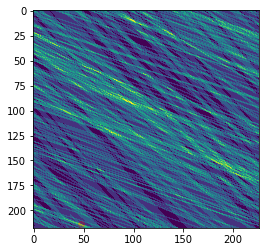

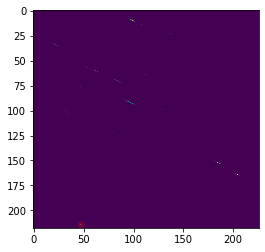

0 5


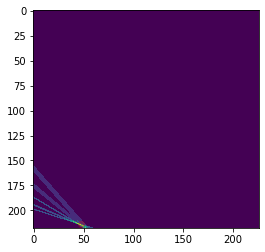

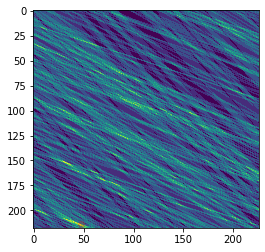

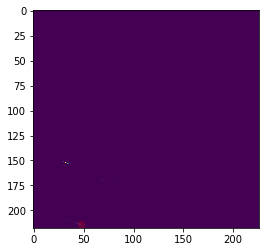

1 4


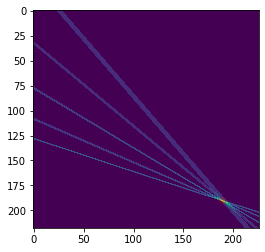

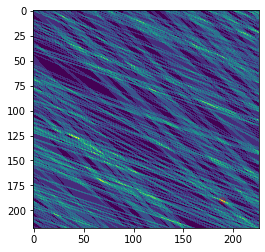

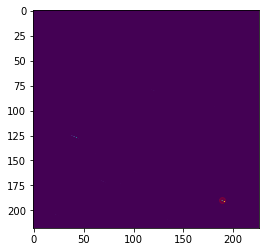

2 0


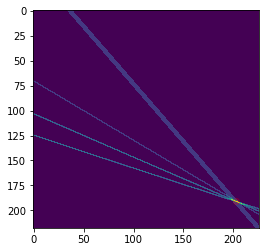

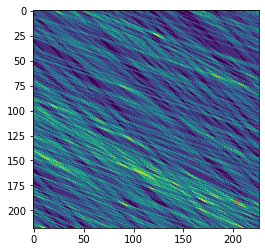

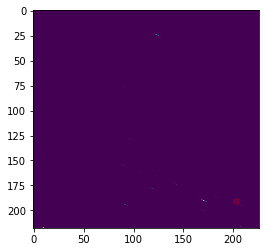

2 5


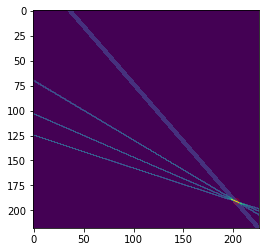

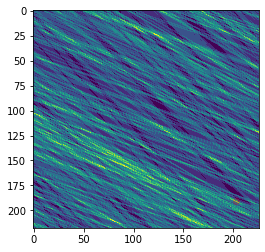

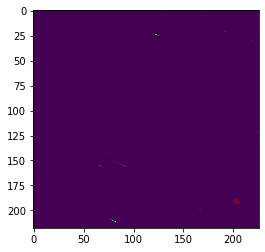

3 4


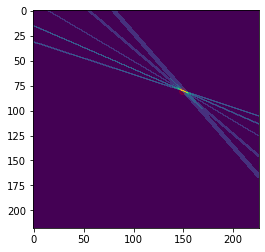

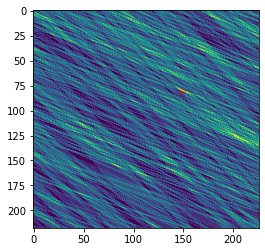

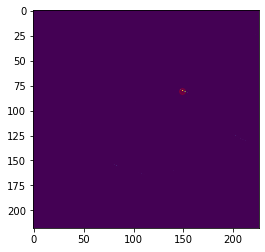

336 510
337 510
338 510
339 510
340 510
341 510
342 510
evaluating
0 3


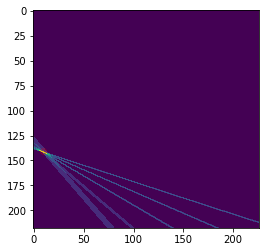

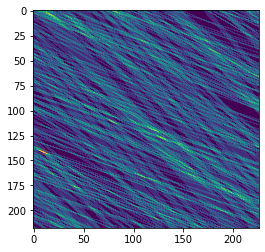

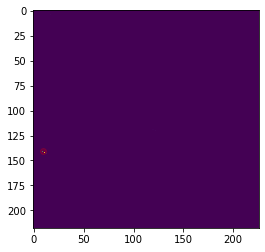

1 0


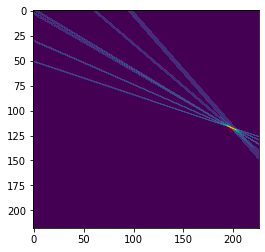

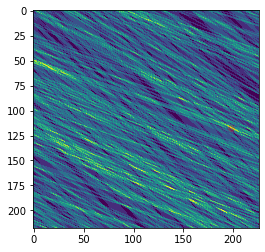

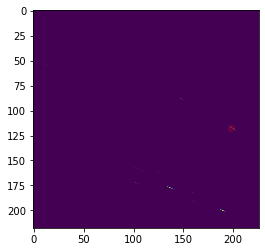

1 5


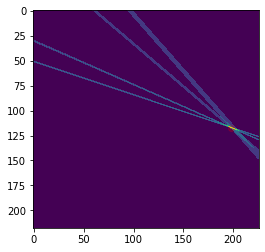

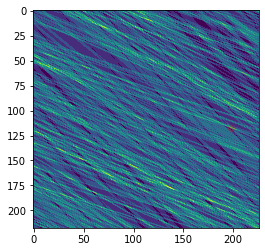

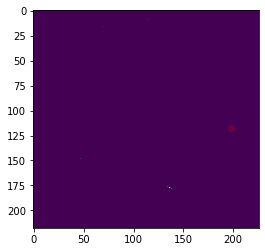

2 0


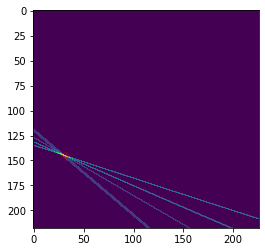

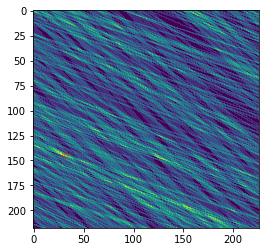

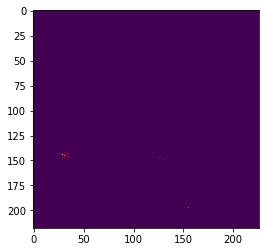

2 1


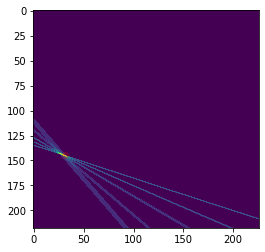

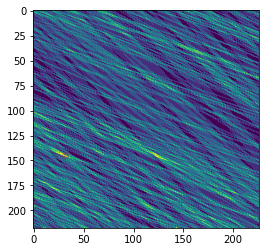

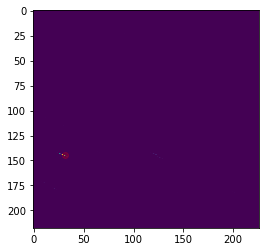

3 4


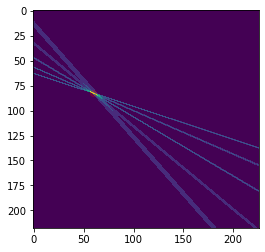

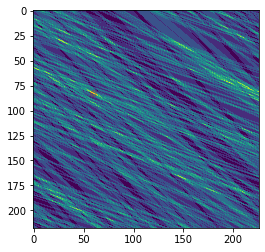

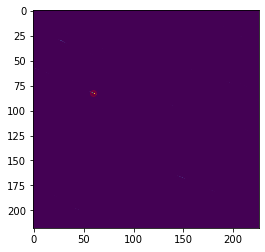

343 510
344 510
345 510
346 510
347 510
348 510
349 510
evaluating
0 5


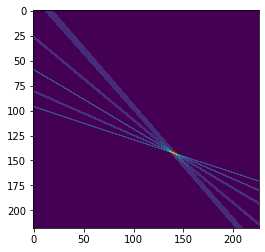

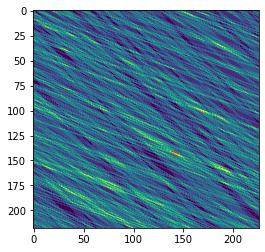

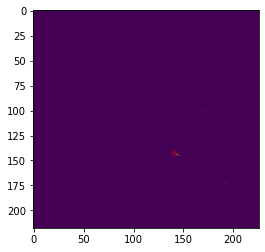

1 1


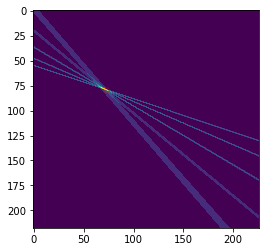

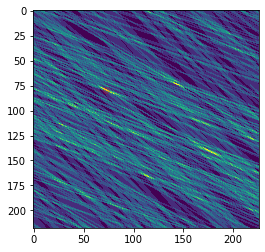

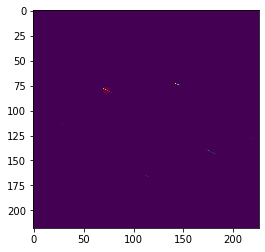

1 3


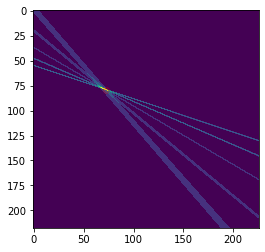

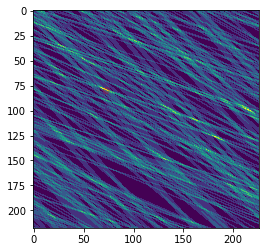

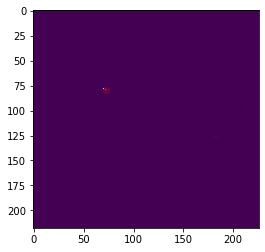

2 0


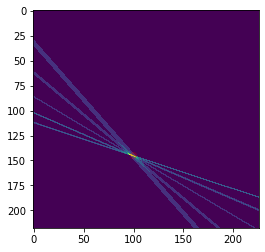

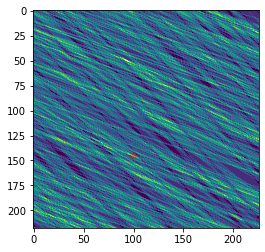

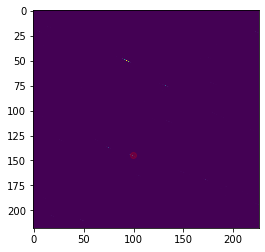

2 1


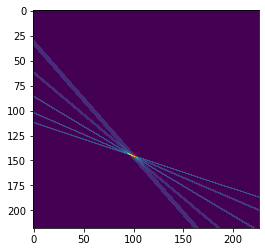

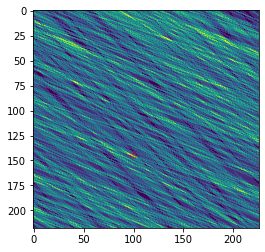

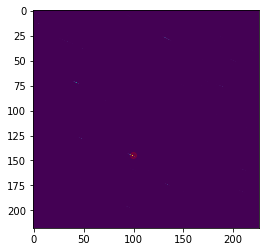

3 2


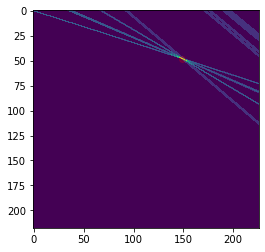

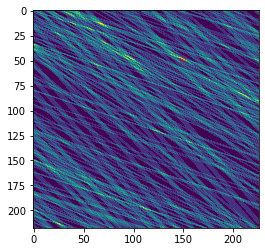

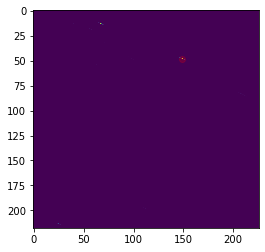

350 510
351 510
352 510
353 510
354 510
355 510
356 510
evaluating
0 0


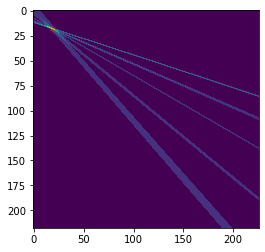

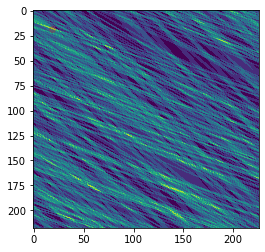

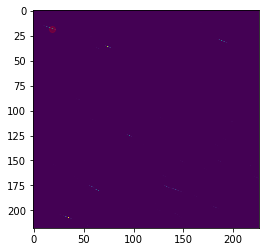

0 1


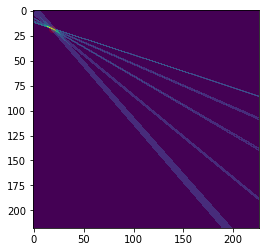

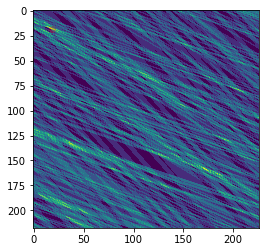

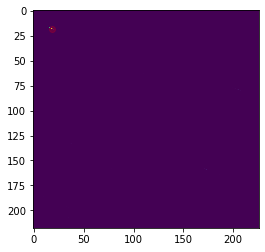

1 0


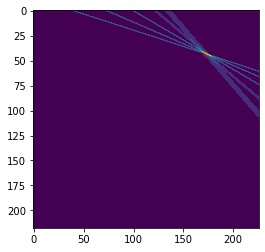

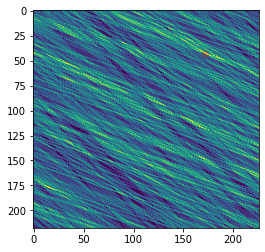

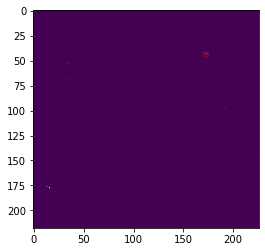

2 0


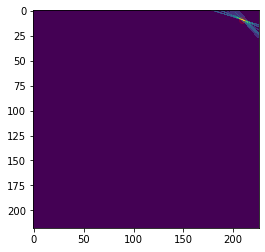

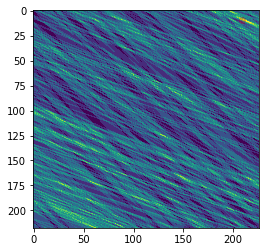

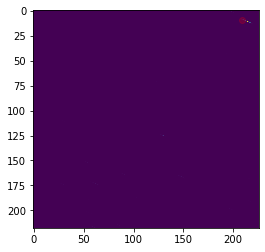

2 1


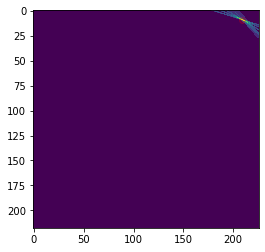

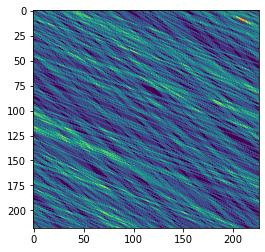

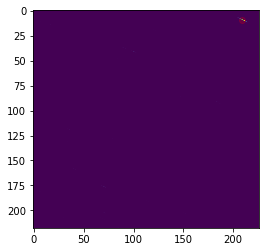

4 1


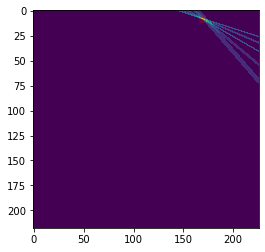

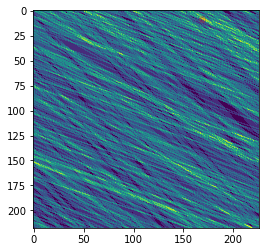

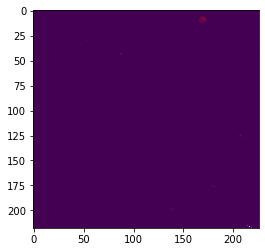

357 510
358 510
359 510
360 510
361 510
362 510
363 510
evaluating
0 4


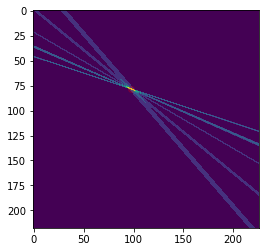

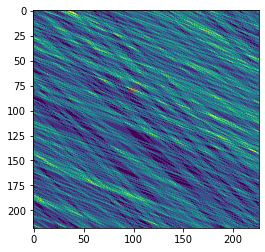

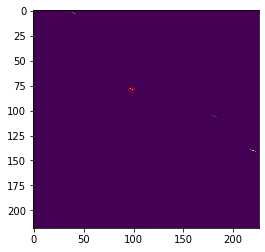

0 5


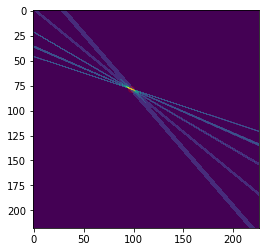

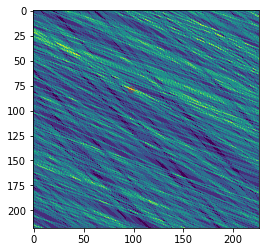

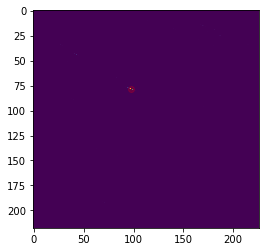

1 4


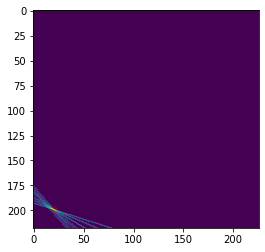

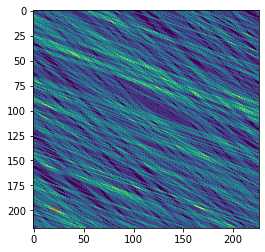

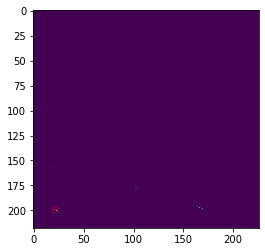

1 5


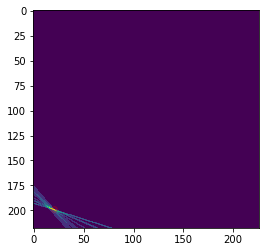

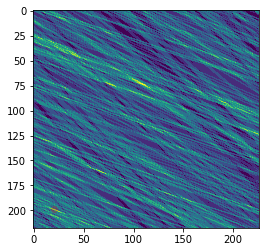

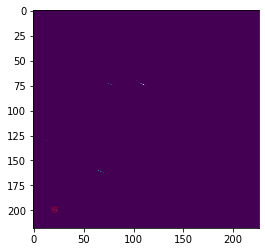

2 1


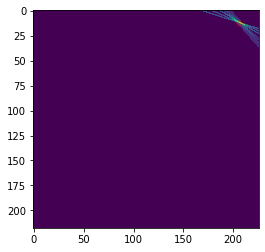

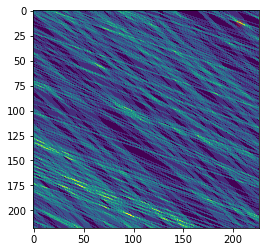

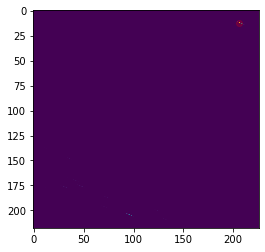

3 2


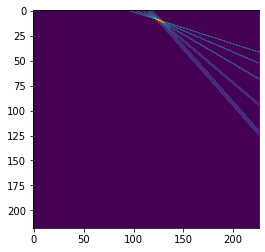

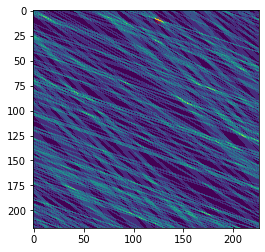

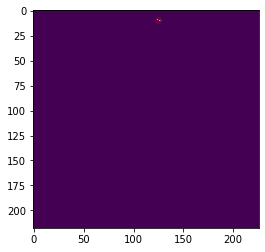

364 510
365 510
366 510
367 510
368 510
369 510
370 510
evaluating
0 1


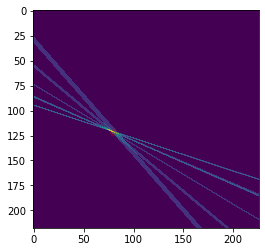

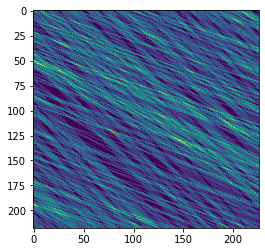

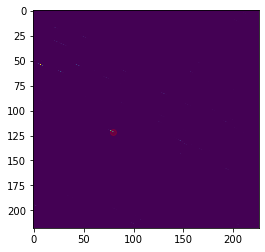

1 0


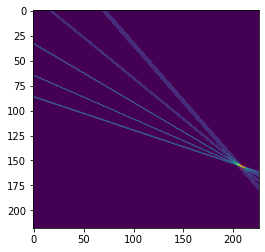

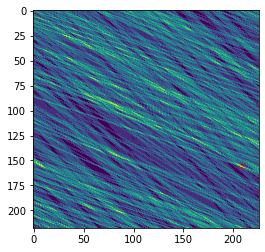

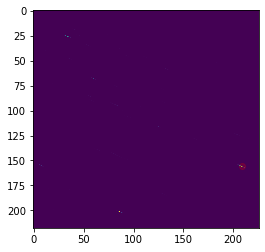

1 5


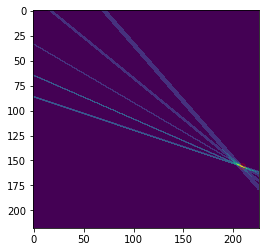

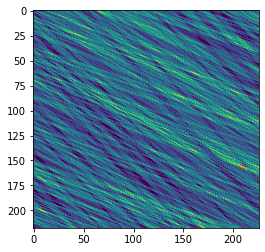

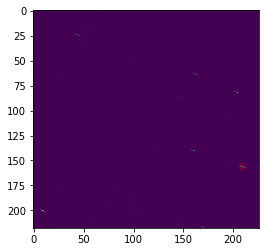

2 0


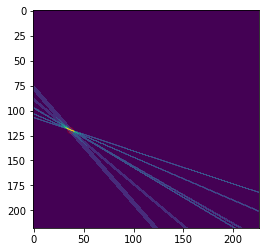

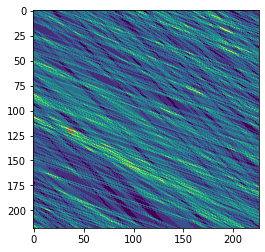

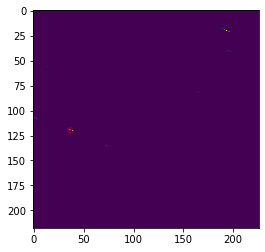

2 1


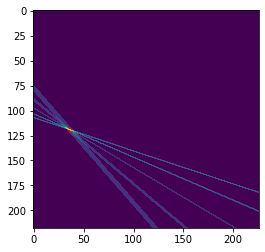

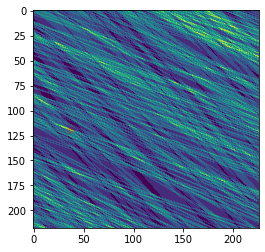

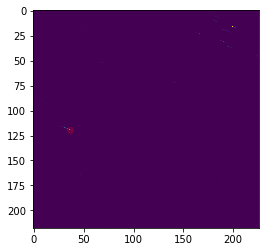

3 0


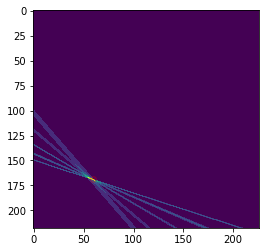

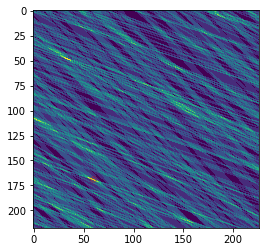

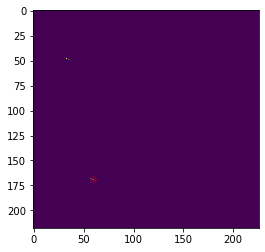

371 510
372 510
373 510
374 510
375 510
376 510
377 510
evaluating
0 0


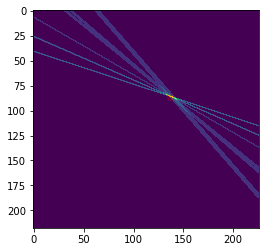

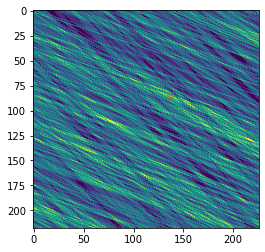

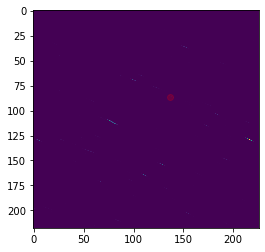

0 5


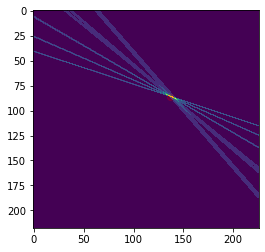

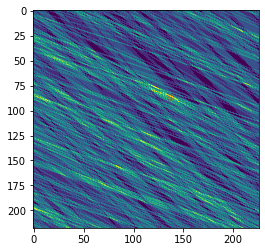

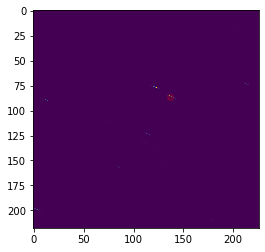

1 0


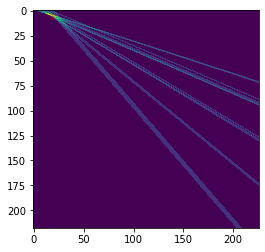

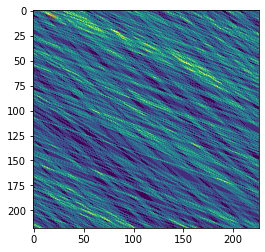

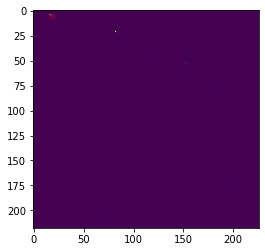

2 0


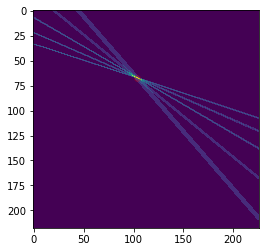

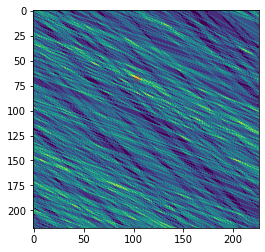

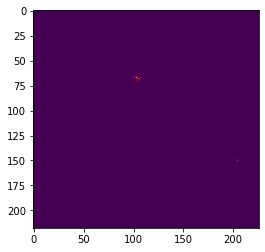

2 1


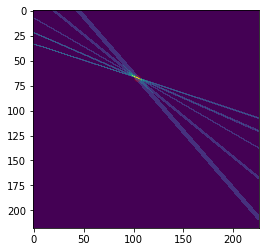

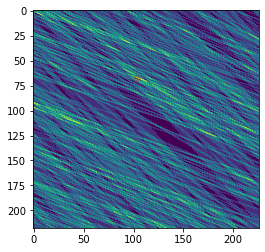

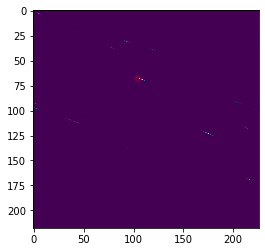

3 0


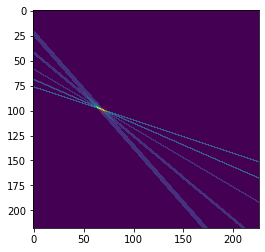

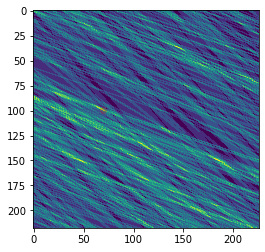

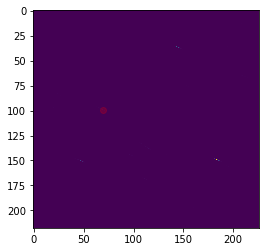

378 510
379 510
380 510
381 510
382 510
383 510
384 510
evaluating
0 0


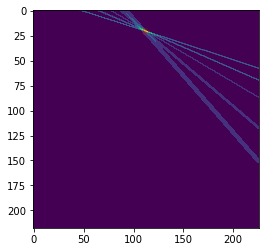

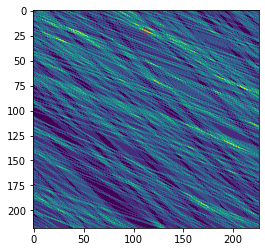

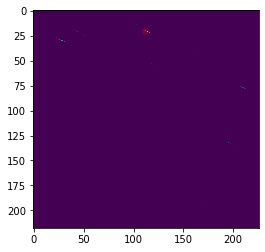

0 5


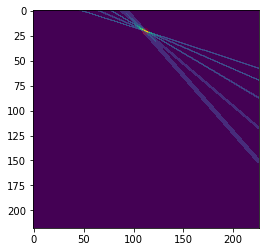

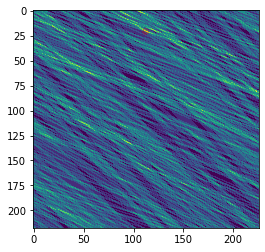

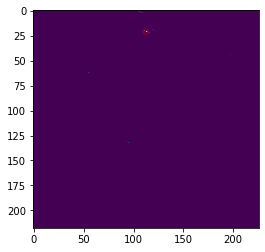

1 4


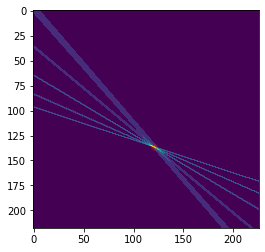

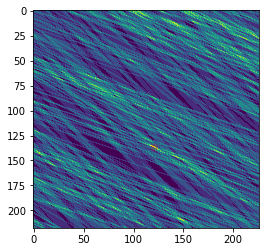

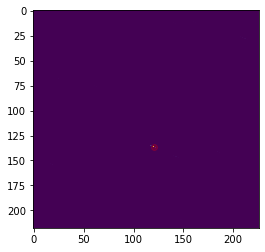

2 2


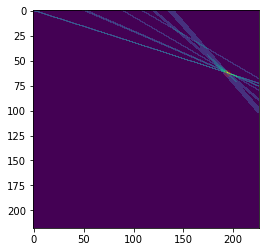

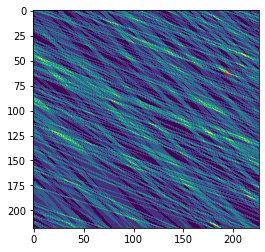

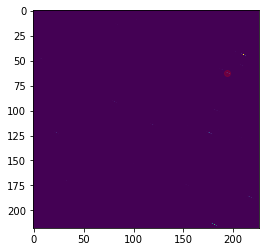

3 4


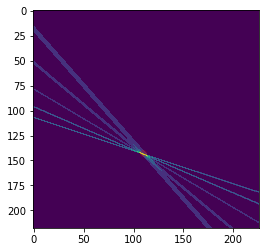

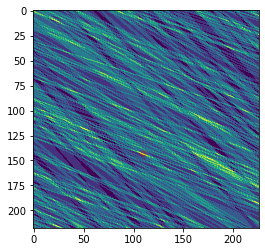

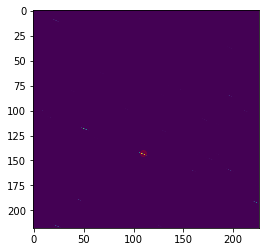

3 5


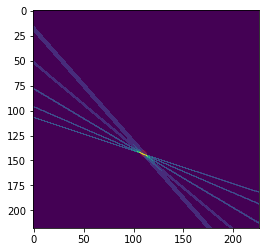

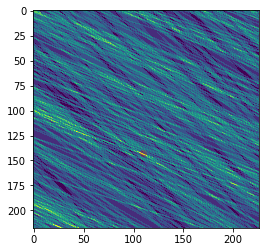

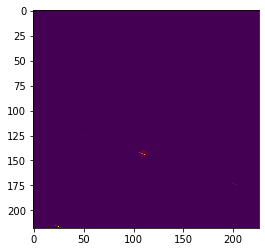

385 510
386 510
387 510
388 510
389 510
390 510
391 510
evaluating
0 4


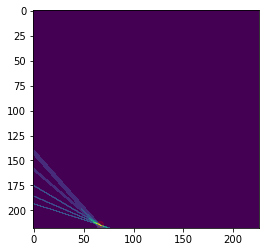

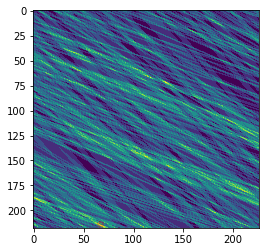

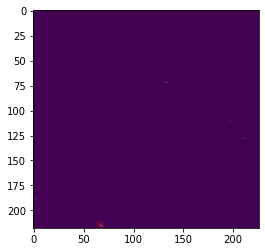

0 5


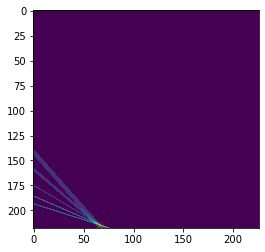

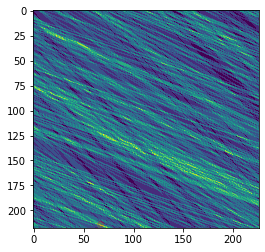

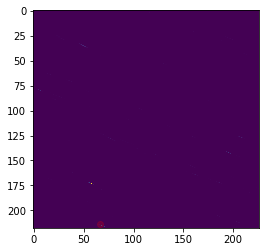

1 4


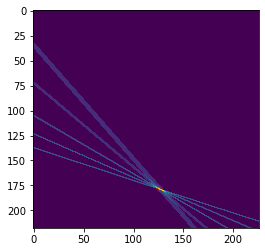

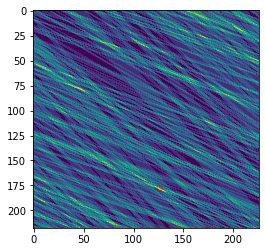

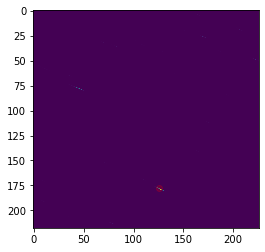

1 5


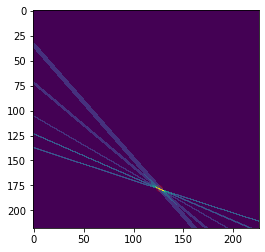

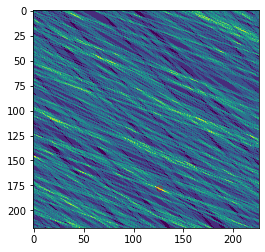

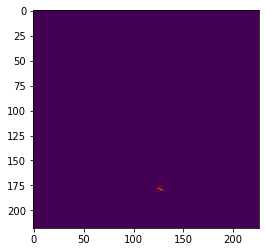

2 1


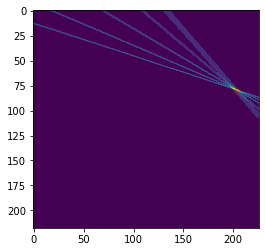

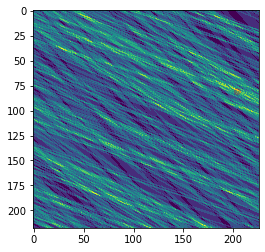

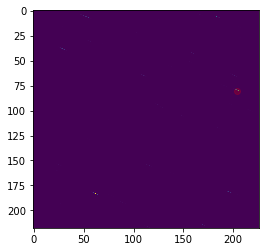

3 4


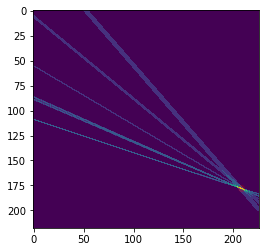

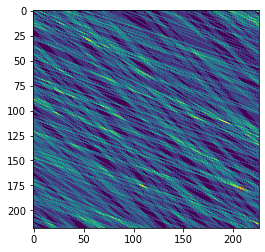

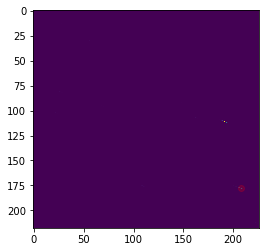

392 510
393 510
394 510
395 510
396 510
397 510
398 510
evaluating
0 1


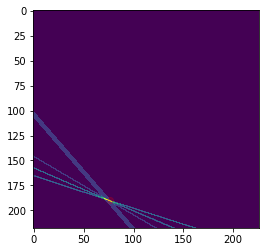

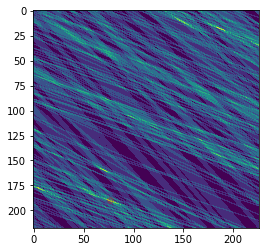

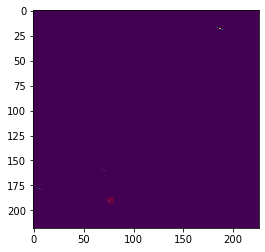

0 3


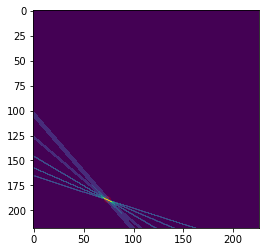

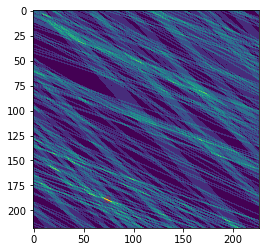

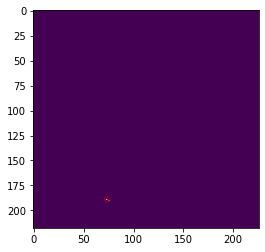

1 5


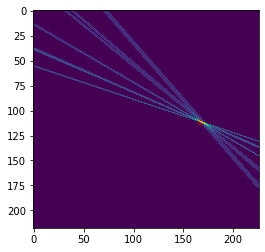

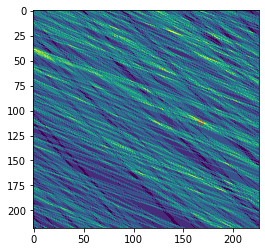

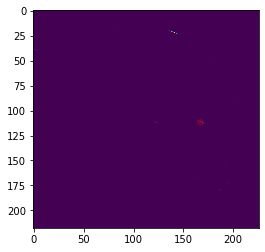

2 0


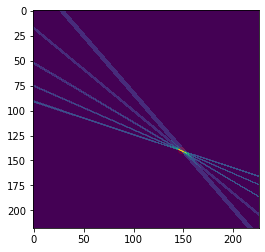

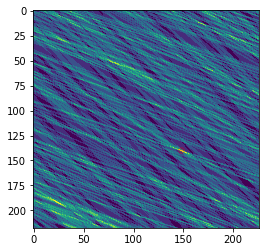

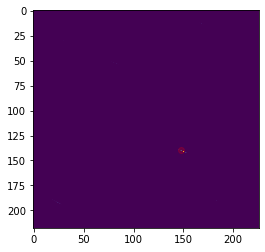

2 5


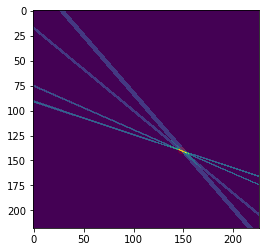

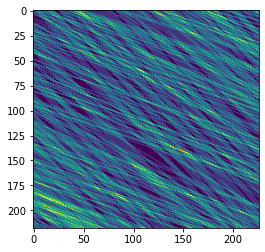

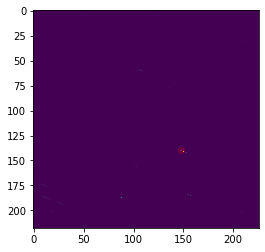

3 0


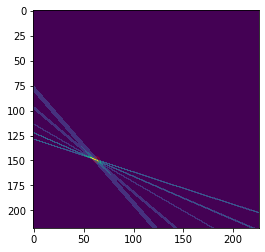

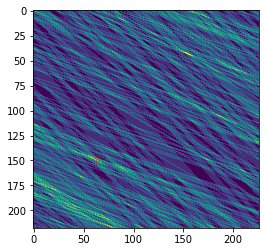

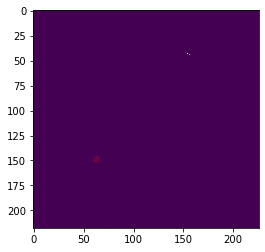

399 510
400 510
401 510
402 510
403 510
404 510
405 510
evaluating
0 3


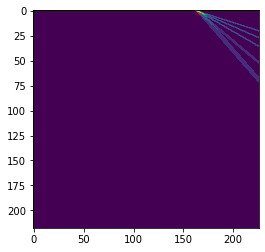

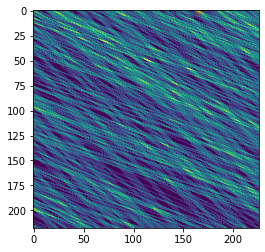

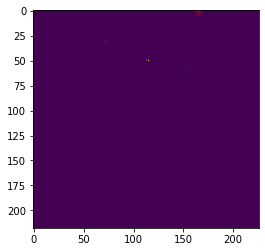

1 0


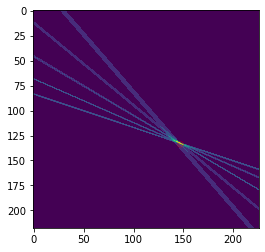

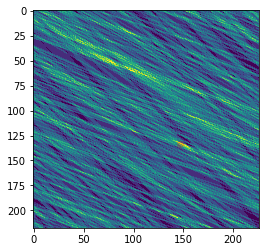

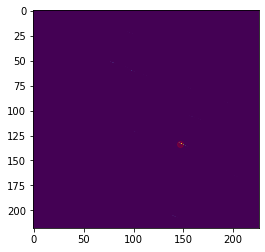

1 5


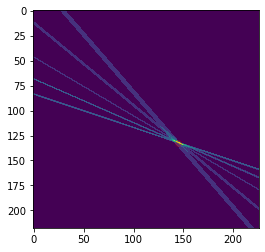

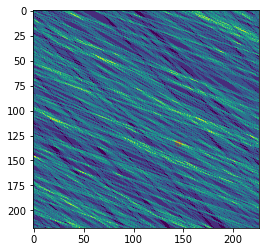

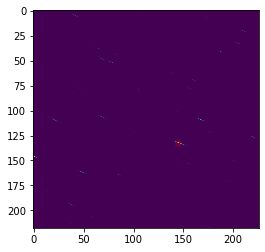

2 5


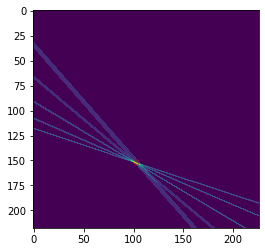

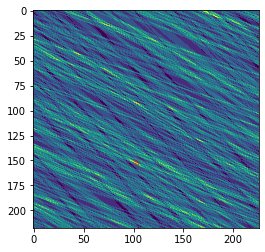

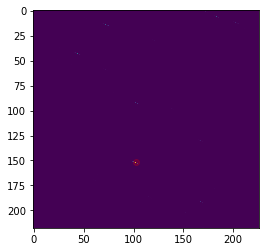

3 4


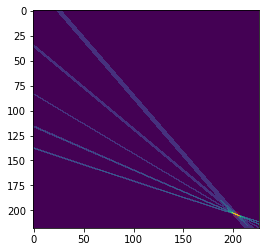

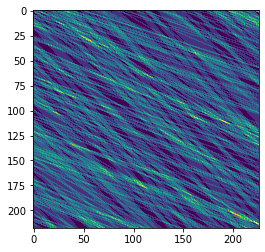

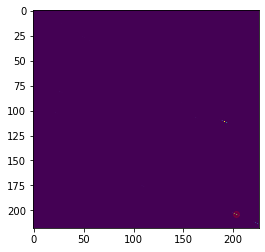

3 5


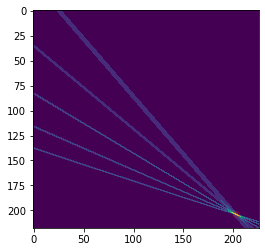

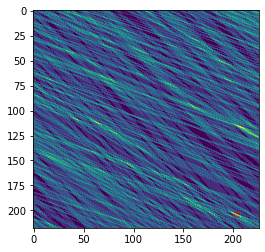

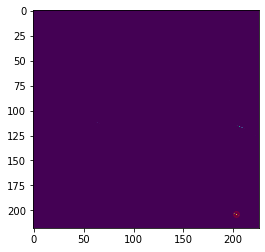

406 510
407 510
408 510
409 510
410 510
411 510
412 510
evaluating
0 5


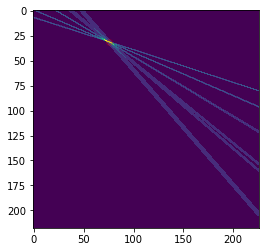

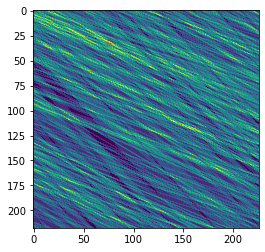

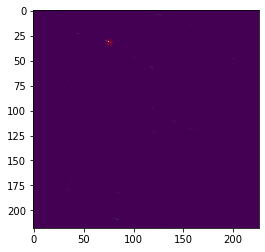

1 0


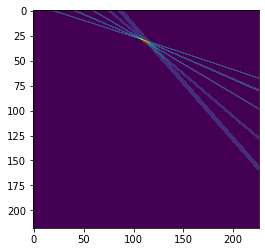

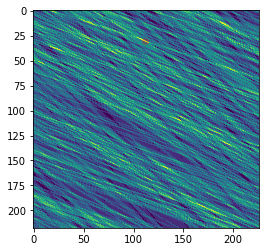

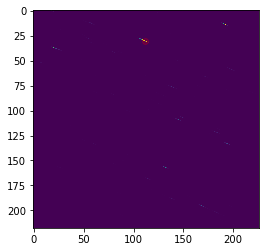

1 5


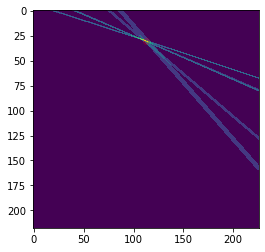

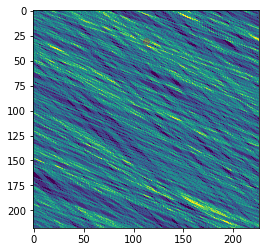

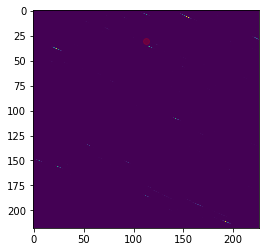

2 4


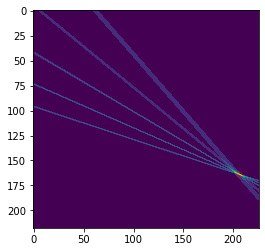

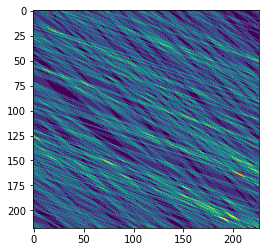

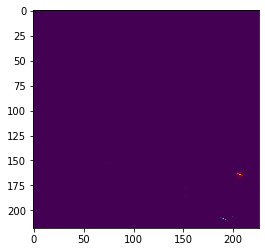

2 5


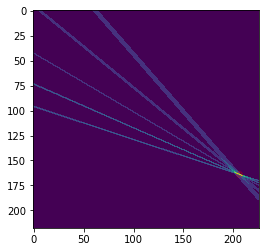

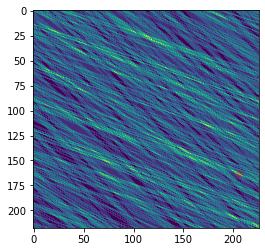

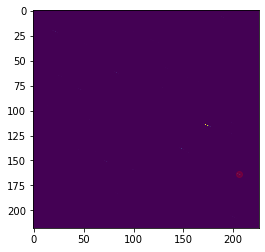

3 4


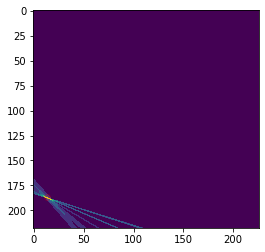

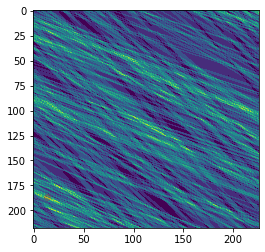

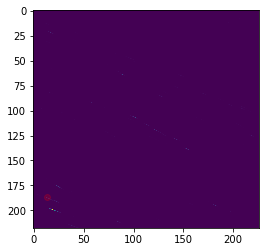

413 510
414 510
415 510
416 510
417 510
418 510
419 510
evaluating
0 1


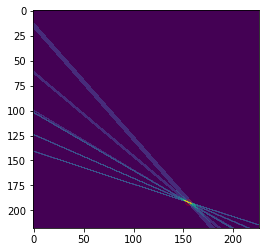

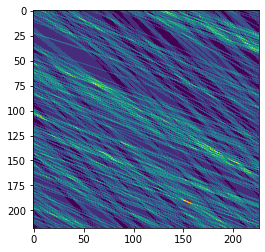

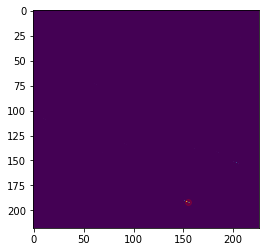

0 3


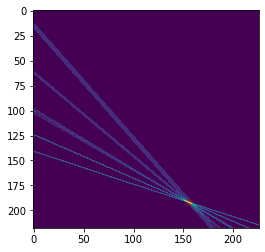

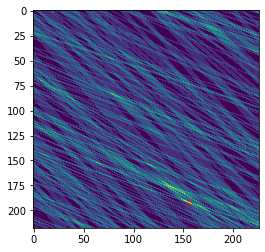

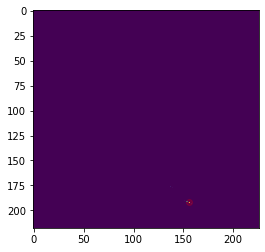

1 1


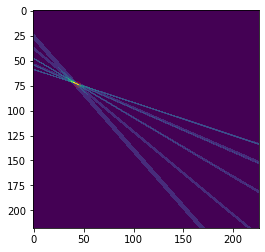

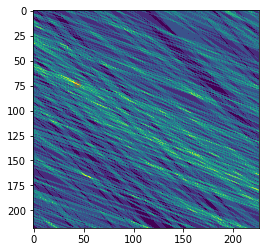

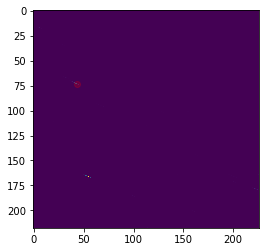

2 0


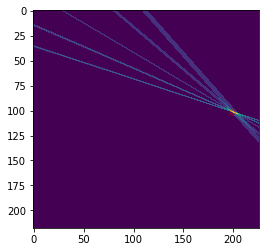

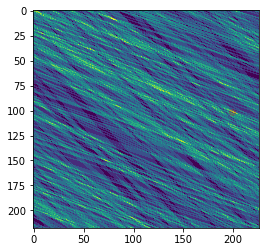

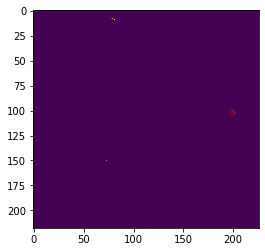

2 5


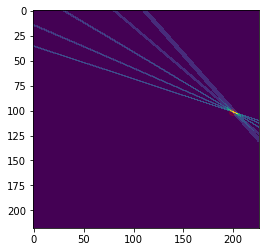

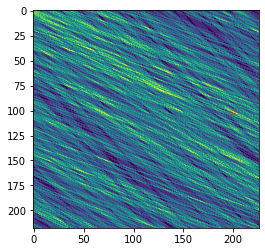

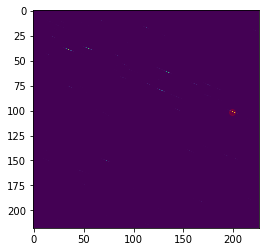

3 0


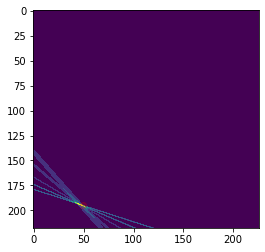

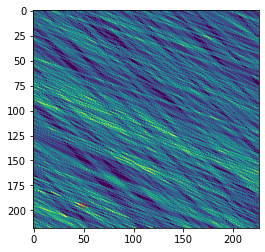

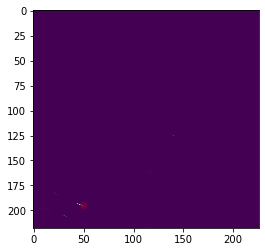

420 510
421 510
422 510
423 510
424 510
425 510
426 510
evaluating
0 2


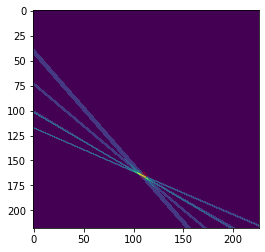

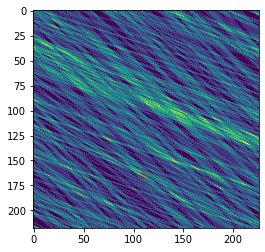

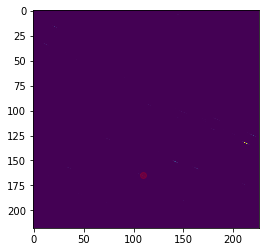

0 4


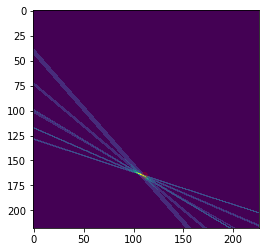

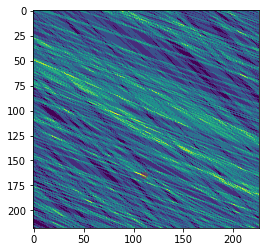

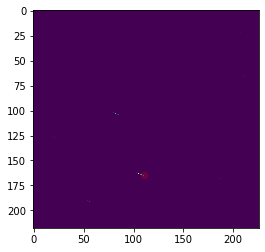

1 2


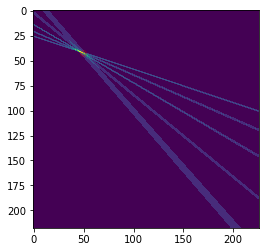

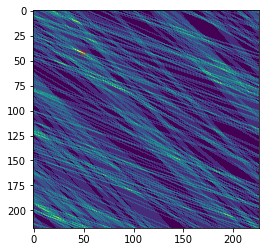

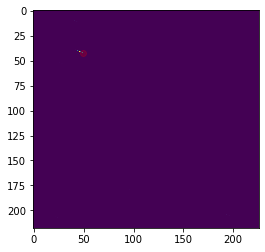

2 4


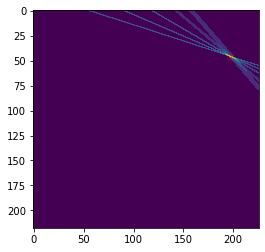

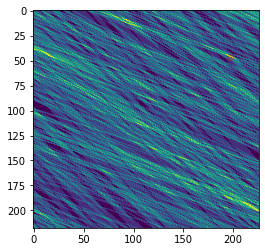

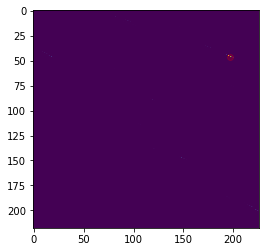

2 5


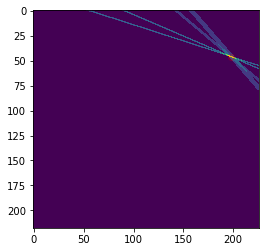

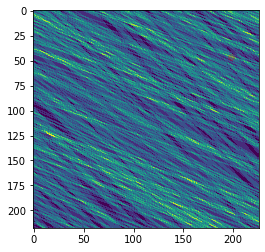

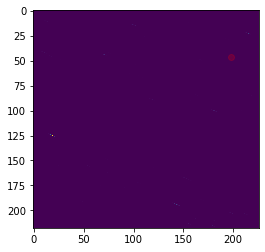

3 0


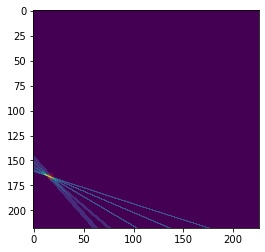

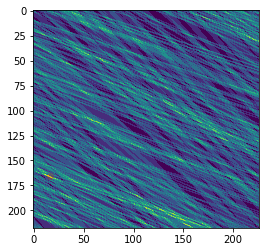

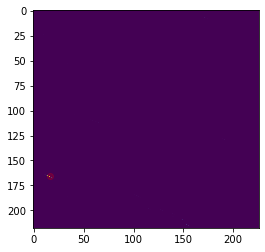

427 510
428 510
429 510
430 510
431 510
432 510
433 510
evaluating
0 4


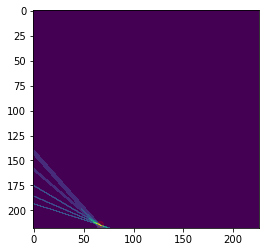

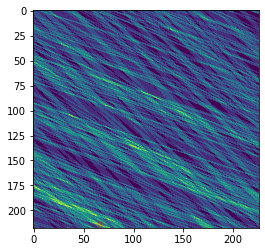

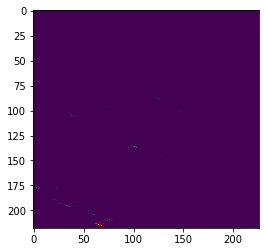

0 5


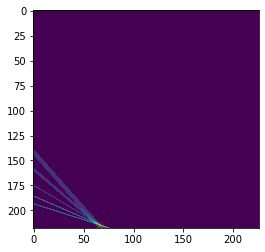

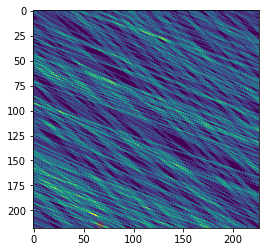

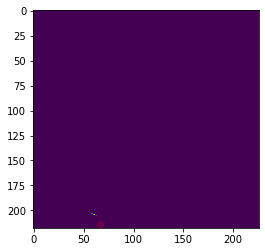

1 4


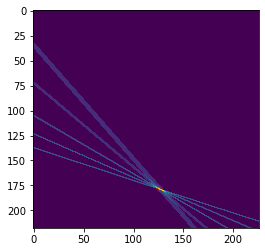

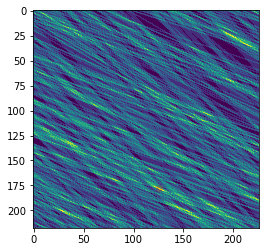

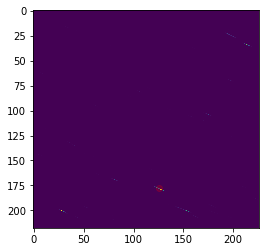

1 5


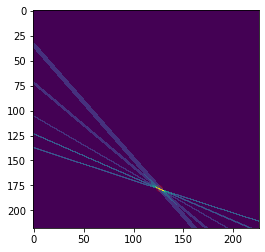

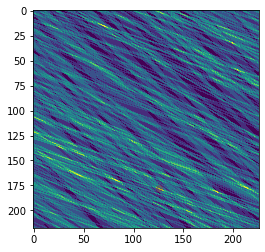

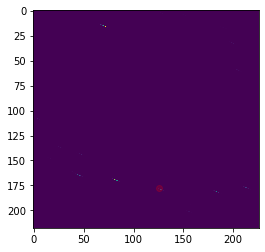

2 1


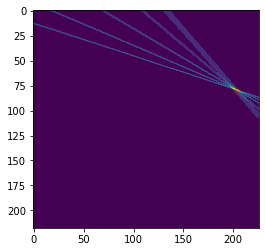

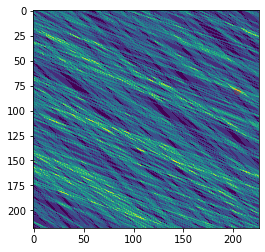

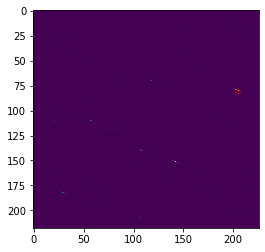

3 4


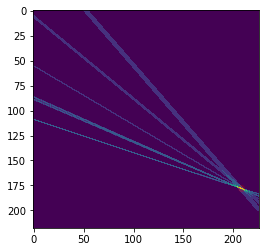

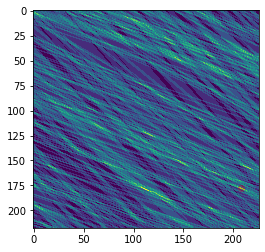

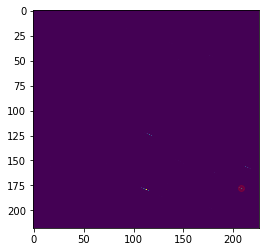

434 510
435 510
436 510
437 510
438 510
439 510
440 510
evaluating
0 4


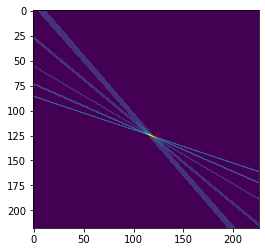

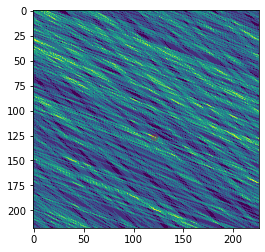

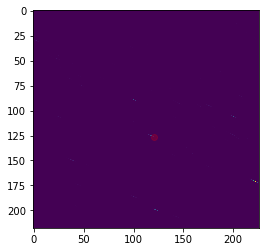

0 5


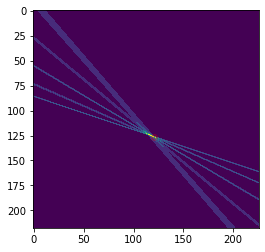

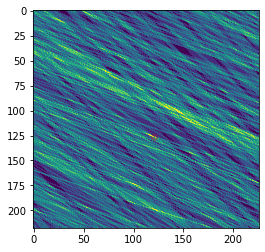

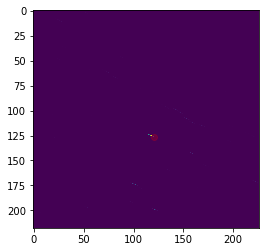

1 1


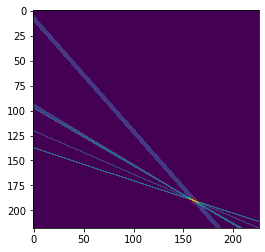

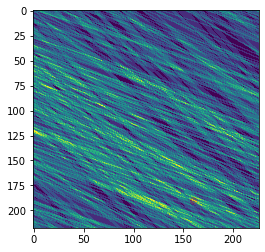

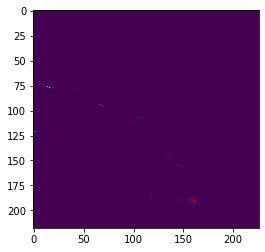

2 4


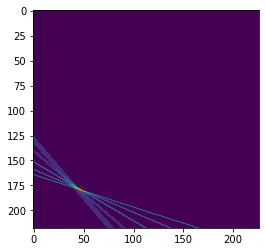

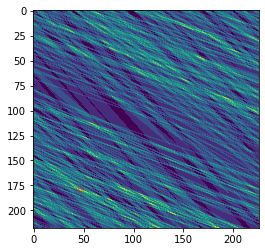

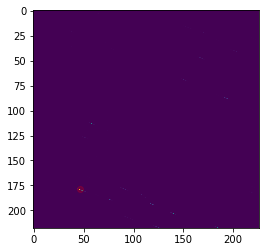

2 5


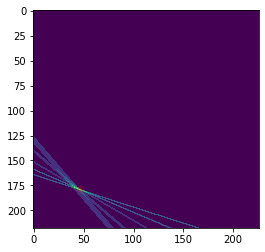

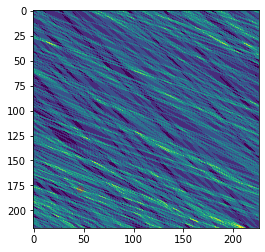

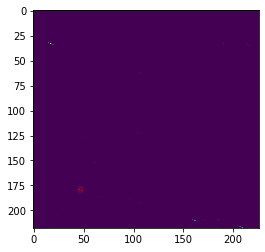

3 0


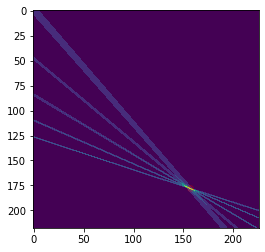

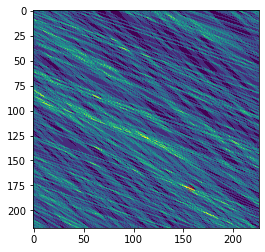

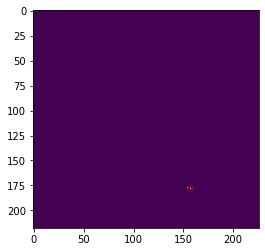

441 510
442 510
443 510
444 510
445 510
446 510
447 510
evaluating
0 5


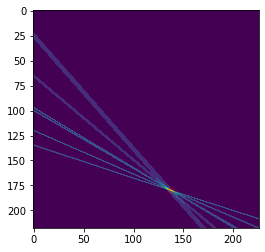

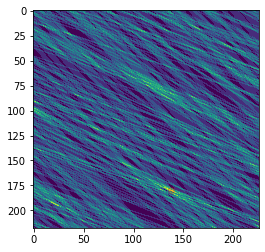

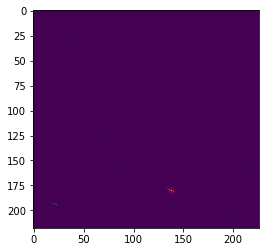

1 4


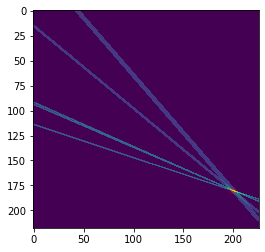

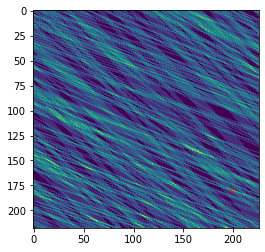

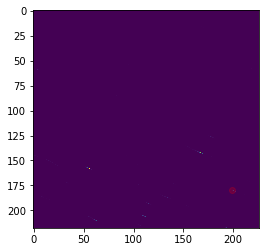

1 5


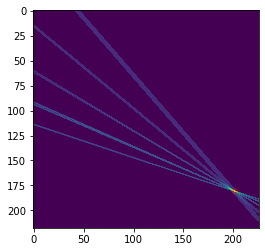

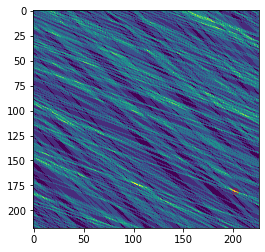

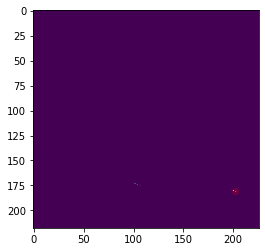

2 0


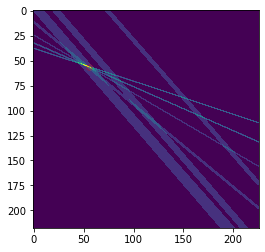

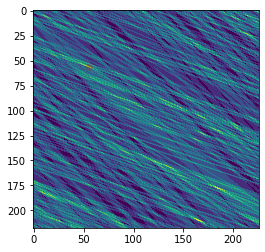

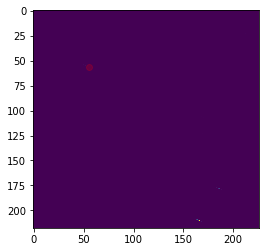

2 1


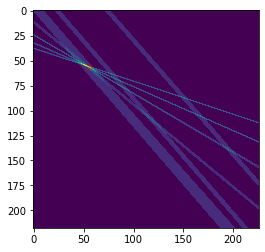

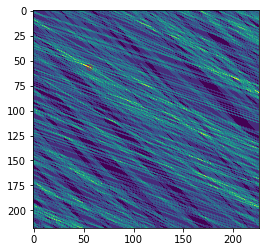

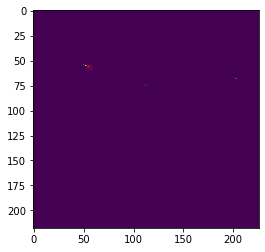

3 5


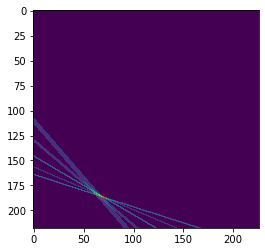

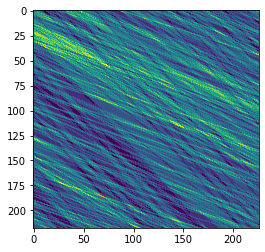

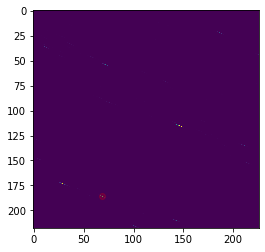

448 510
449 510
450 510
451 510
452 510
453 510
454 510
evaluating
0 0


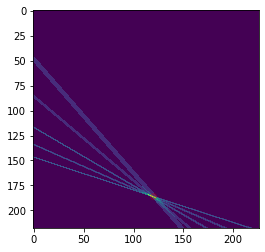

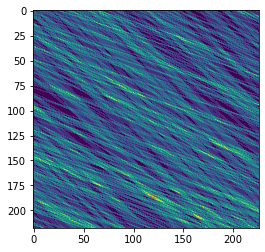

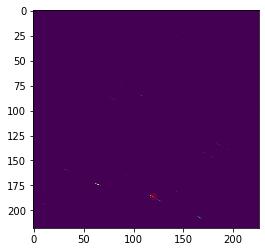

0 5


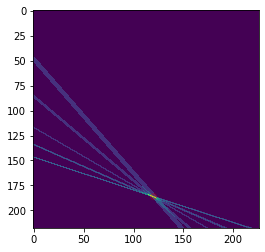

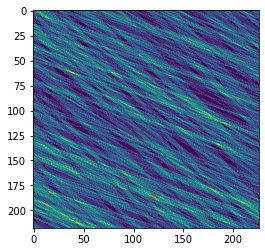

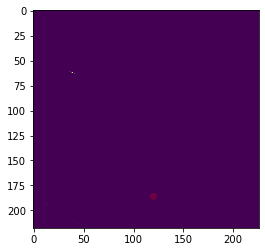

1 0


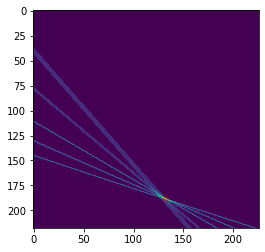

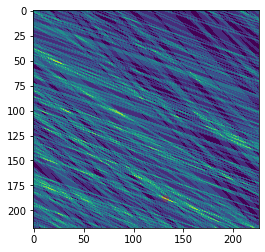

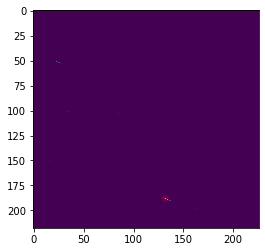

2 1


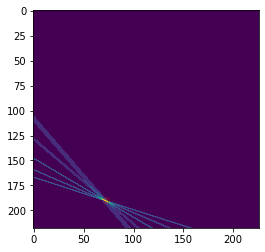

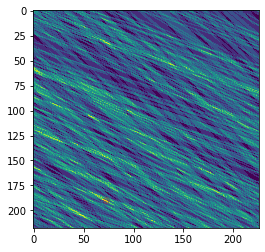

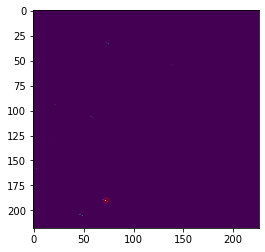

3 1


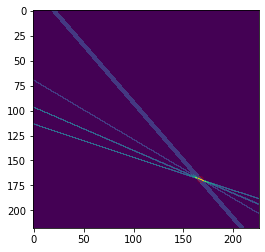

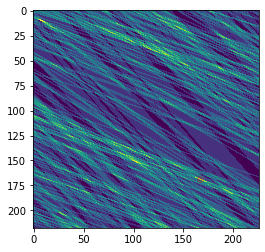

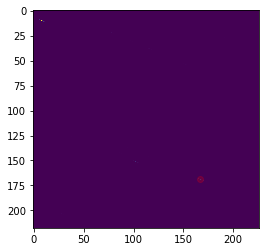

3 3


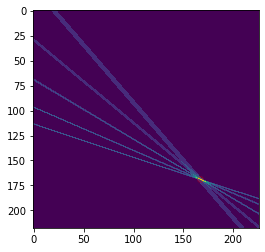

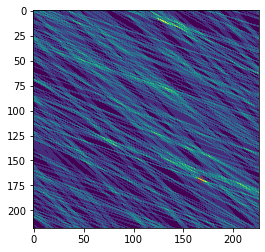

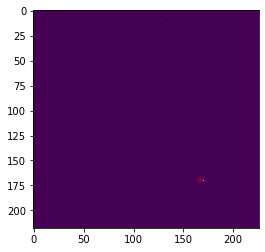

455 510
456 510
457 510
458 510
459 510
460 510
461 510
evaluating
0 0


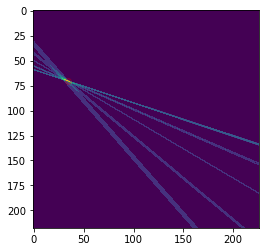

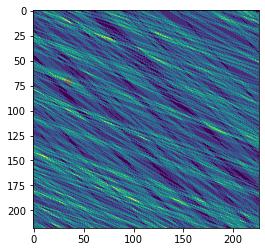

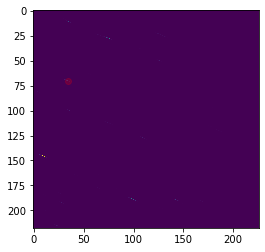

0 1


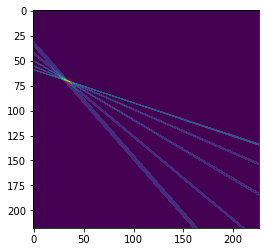

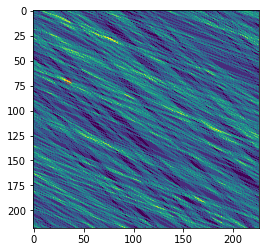

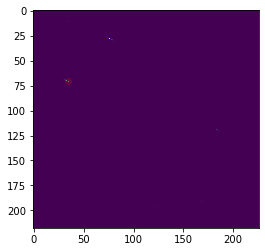

1 0


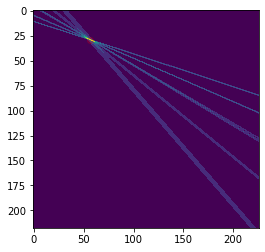

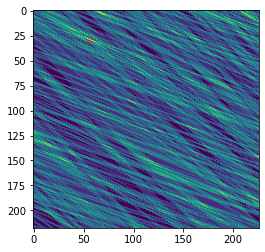

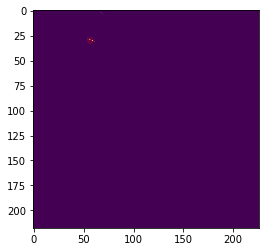

1 1


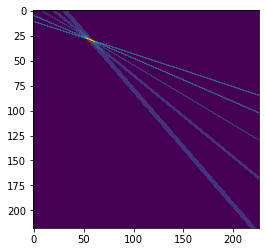

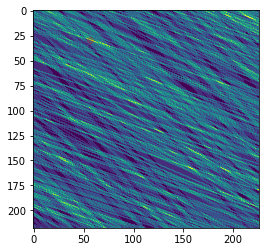

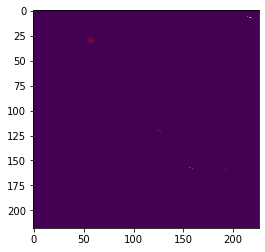

2 0


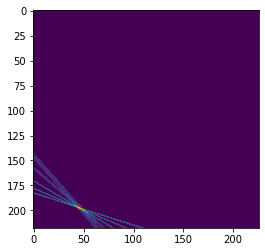

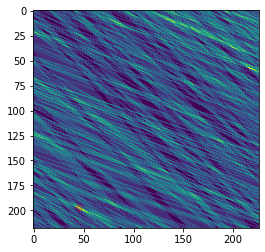

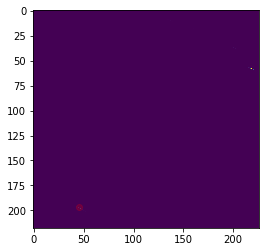

2 5


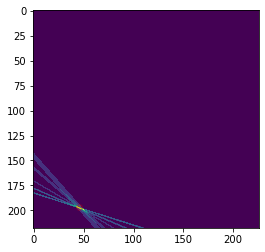

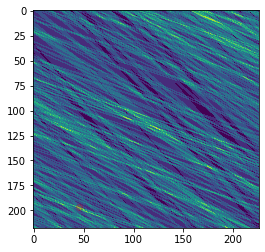

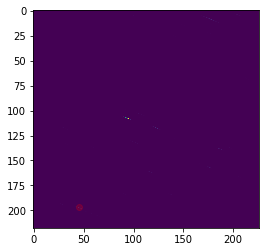

462 510
463 510
464 510
465 510
466 510
467 510
468 510
evaluating
0 0


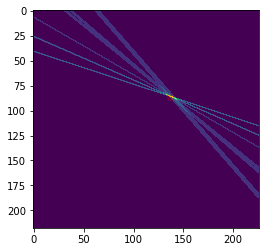

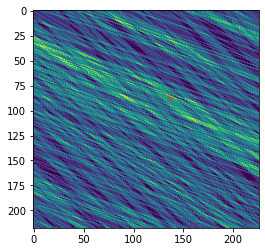

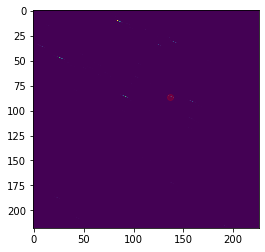

0 5


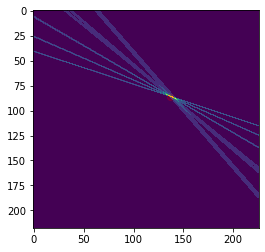

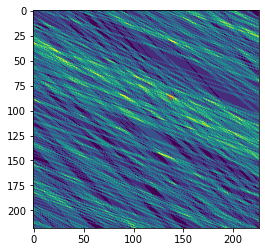

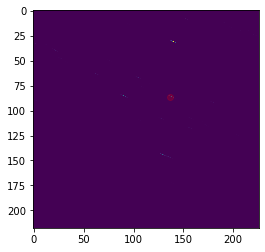

1 0


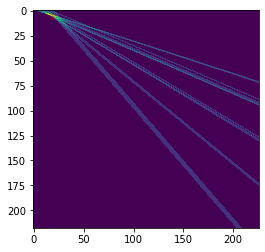

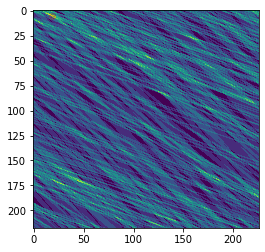

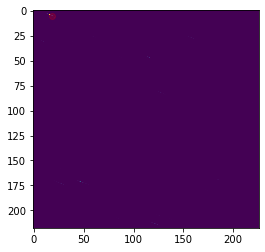

2 0


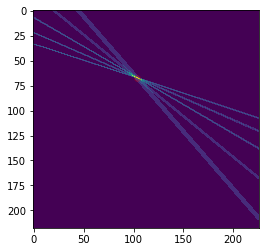

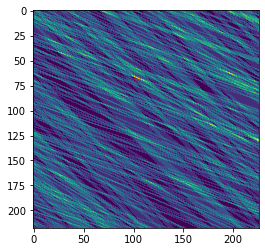

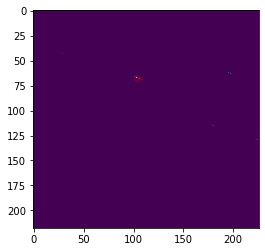

2 1


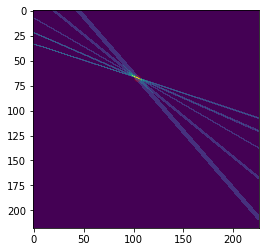

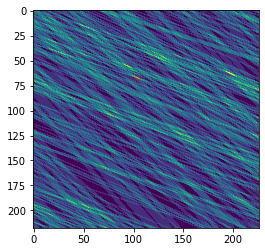

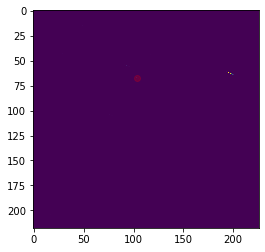

3 0


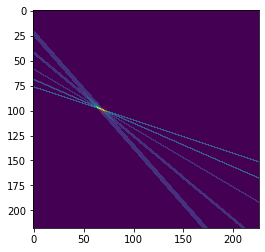

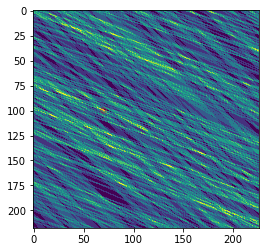

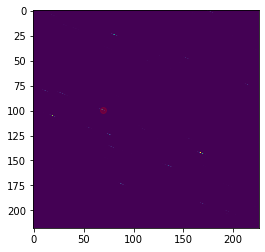

469 510
470 510
471 510
472 510
473 510
474 510
475 510
evaluating
0 1


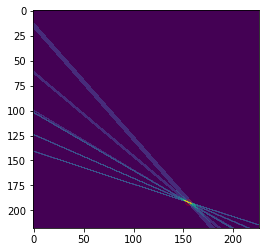

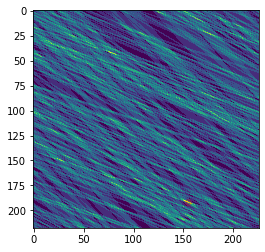

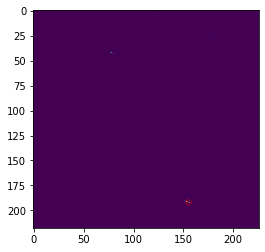

0 3


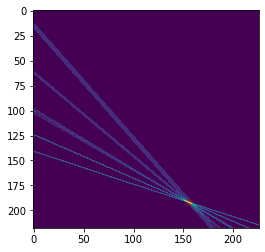

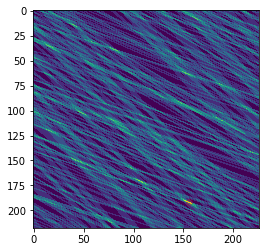

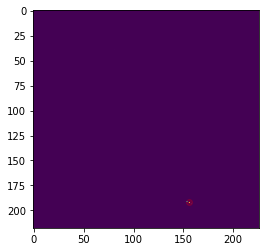

1 1


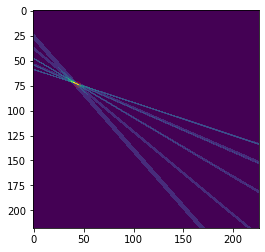

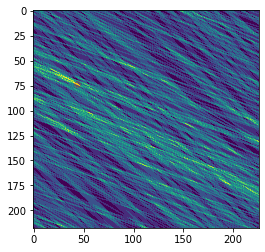

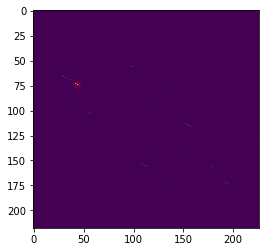

2 0


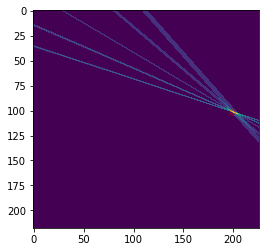

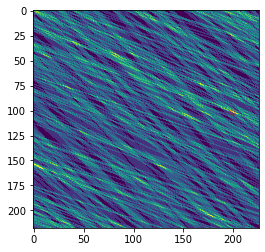

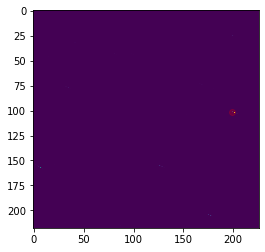

2 5


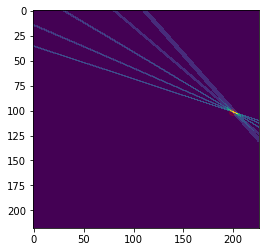

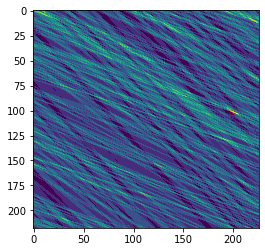

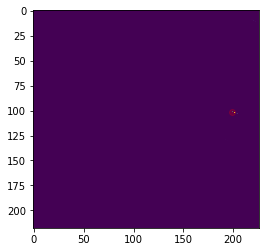

3 0


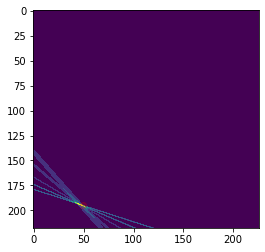

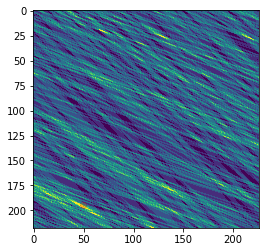

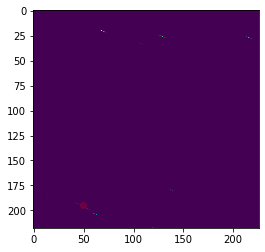

476 510
477 510
478 510
479 510
480 510
481 510
482 510
evaluating
0 0


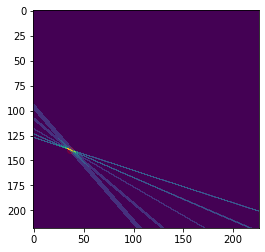

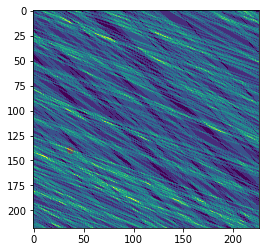

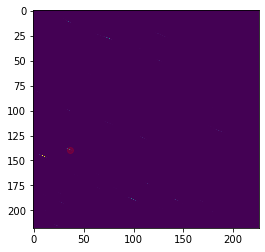

0 5


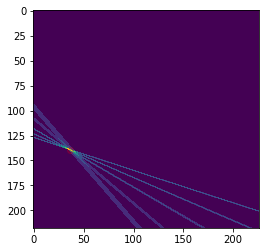

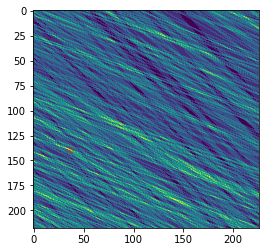

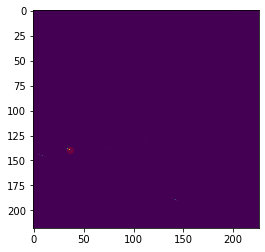

1 4


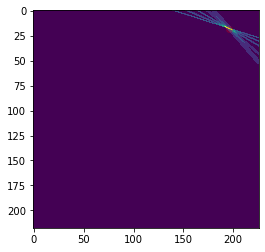

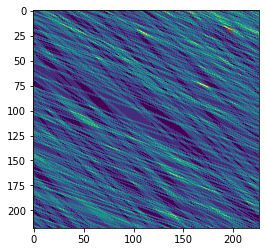

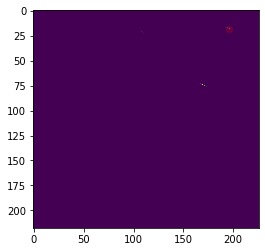

1 5


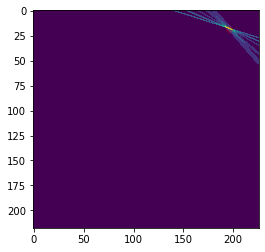

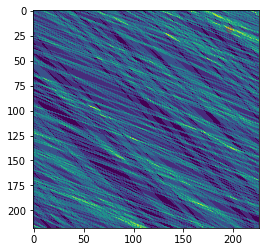

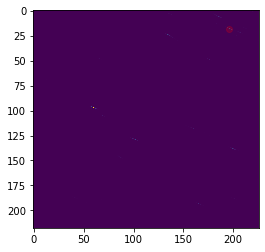

2 0


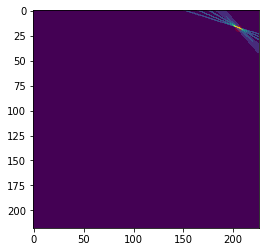

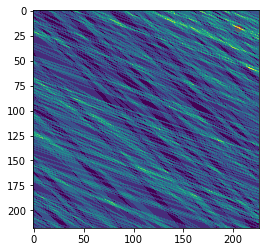

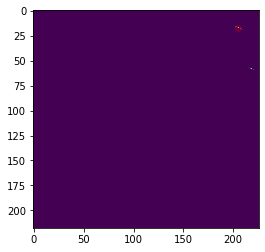

2 5


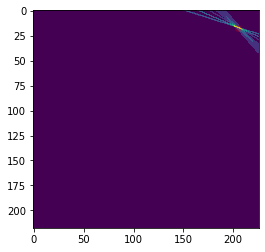

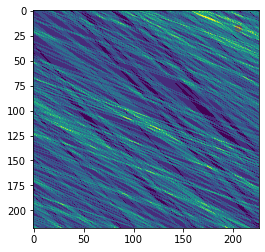

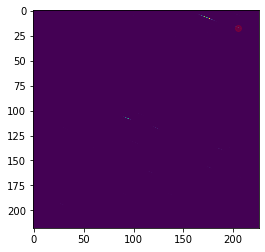

483 510
484 510
485 510
486 510
487 510
488 510
489 510
evaluating
1 0


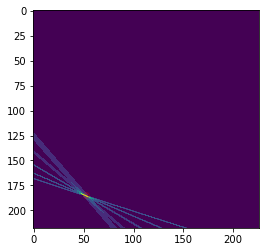

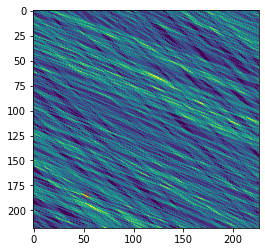

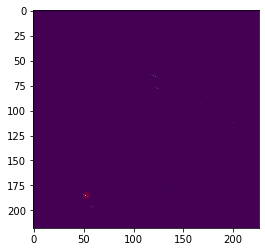

1 5


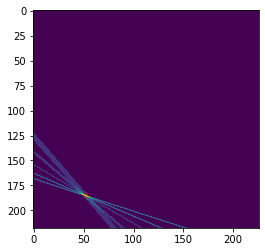

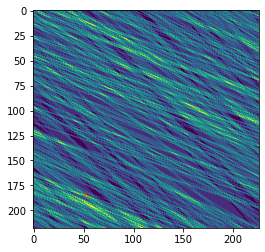

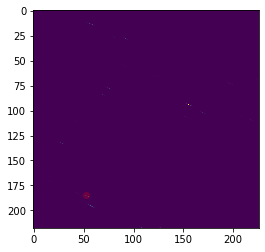

2 2


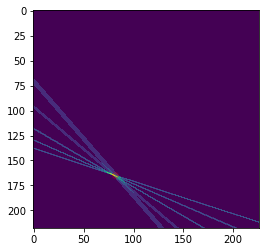

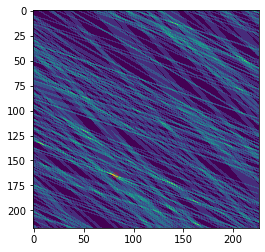

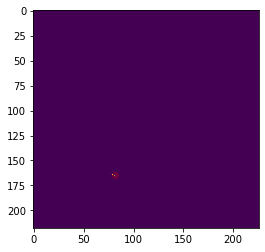

3 1


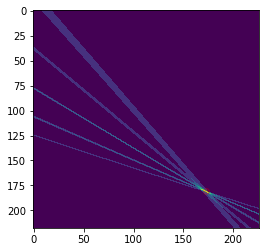

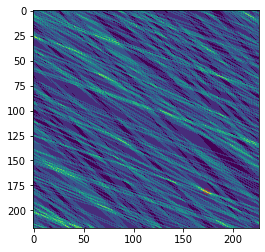

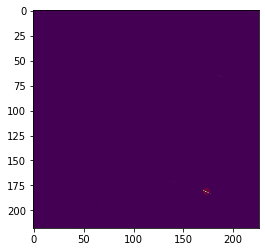

4 5


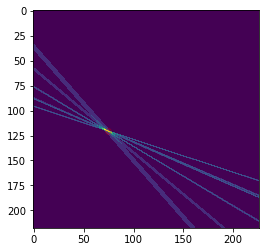

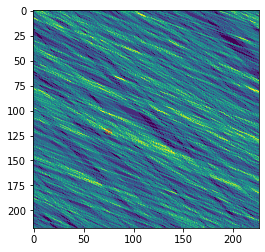

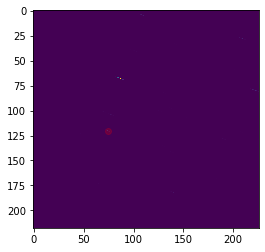

5 2


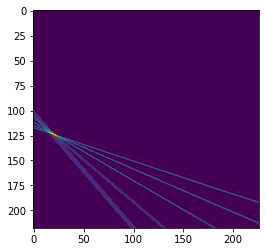

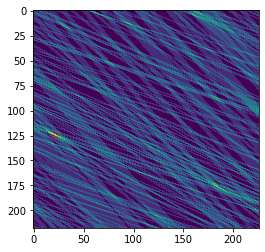

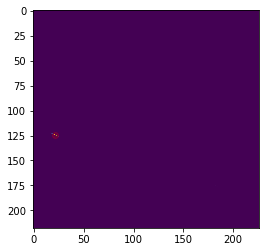

490 510
491 510
492 510
493 510
494 510
495 510
496 510
evaluating
0 0


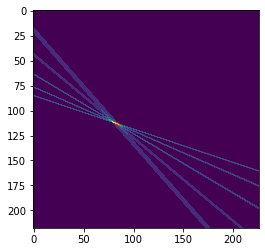

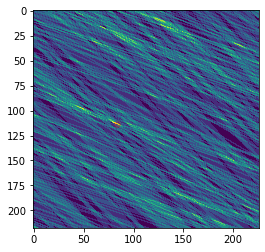

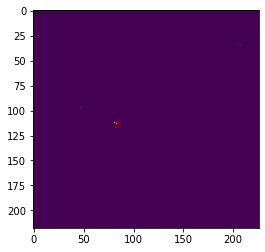

0 1


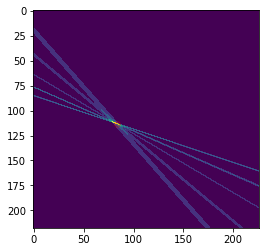

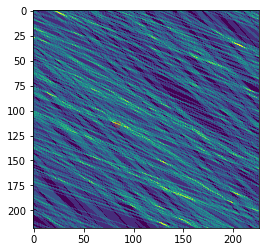

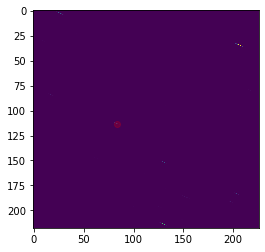

1 2


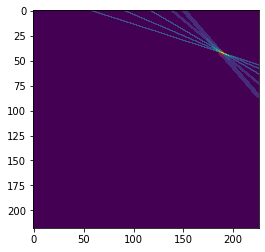

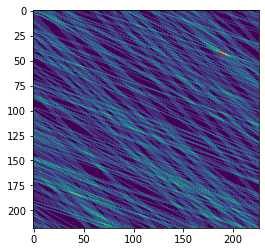

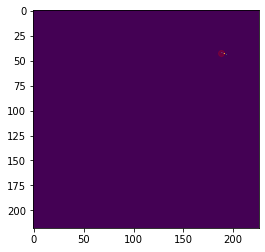

2 2


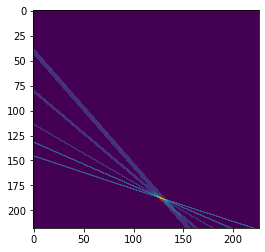

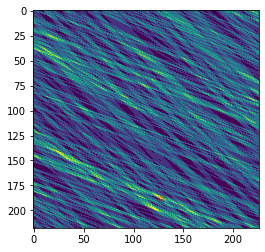

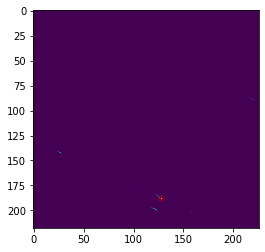

2 4


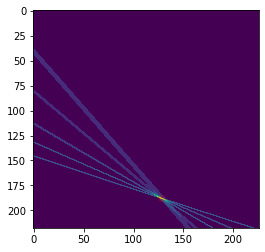

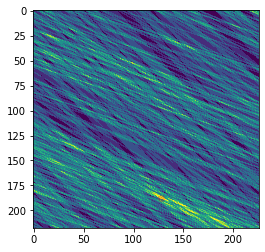

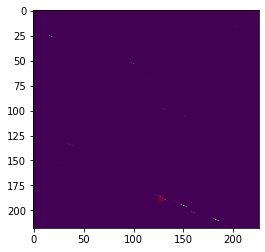

3 3


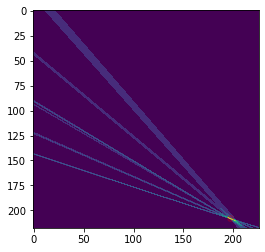

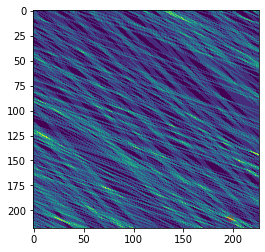

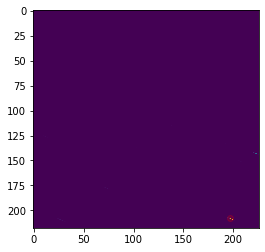

497 510
498 510
499 510
500 510
501 510
502 510
503 510
evaluating
0 0


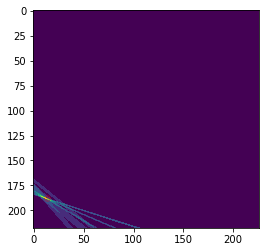

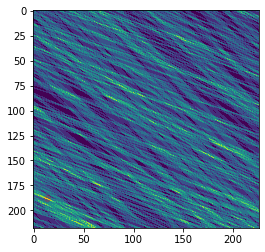

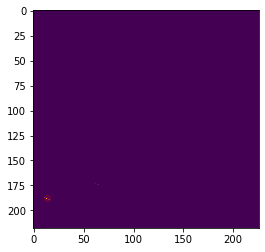

0 5


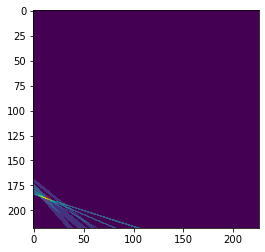

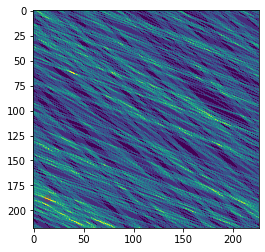

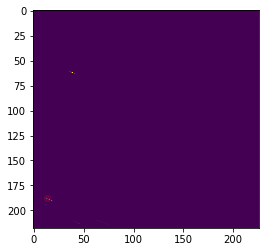

1 4


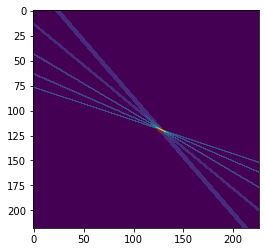

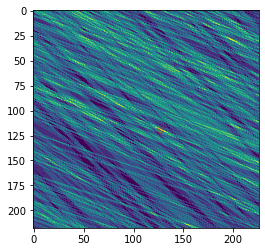

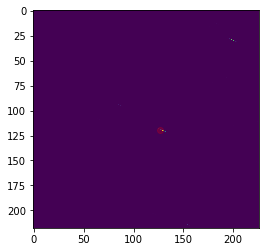

1 5


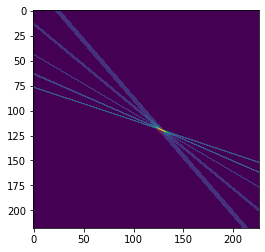

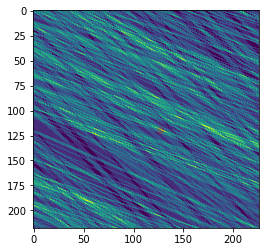

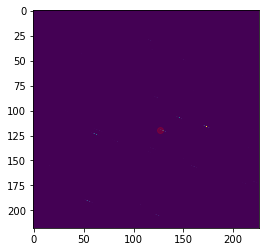

2 0


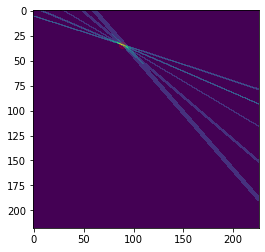

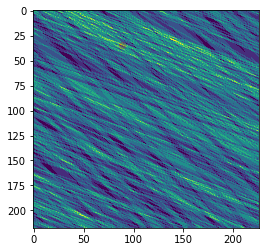

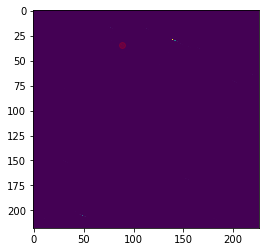

2 5


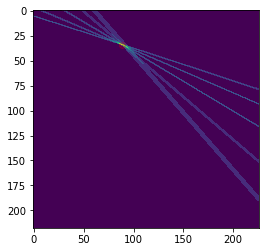

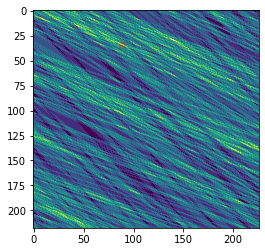

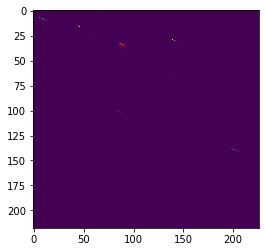

504 510
505 510
506 510
507 510
508 510
509 510
Total roads:  3573826620
Thresholt100p:  tensor(1.7893e-05)
tensor([1.7893e-05, 3.6314e-05, 4.8145e-05, 6.8510e-05, 1.0790e-04, 1.1226e-04,
        1.1942e-04, 1.3924e-04, 1.3924e-04, 1.4215e-04, 1.4215e-04, 1.4930e-04,
        1.6451e-04, 1.6746e-04, 2.1600e-04, 2.4634e-04, 2.6911e-04, 2.8015e-04,
        2.9015e-04, 3.0246e-04, 3.2783e-04, 3.8224e-04, 3.8716e-04, 4.0590e-04,
        4.4947e-04, 4.5865e-04, 4.7794e-04, 4.7794e-04, 4.7794e-04, 4.9035e-04,
        5.4922e-04, 5.8064e-04, 5.9909e-04, 6.3952e-04, 7.1071e-04, 7.2591e-04,
        7.4086e-04, 7.5400e-04, 8.3792e-04, 8.5118e-04, 8.7907e-04, 9.3566e-04,
        9.4615e-04, 9.6910e-04, 9.8620e-04, 1.0334e-03, 1.0338e-03, 1.0728e-03,
        1.0804e-03, 1.1797e-03, 1.1843e-03, 1.2117e-03, 1.2253e-03, 1.2253e-03,
        1.2500e-03, 1.2540e-03, 1.2546e-03, 1.2740e-03, 1.2851e-03, 1.3325e-03,
        1.3580e-03, 1.3761e-03, 1.3836e-03, 1.4808e-03, 1.5032e-03, 1.5247e-03,
        1.56

In [234]:
#finding thresholts
validptestlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
maxprobs = torch.tensor([[]])
probslist = []
neventscurrent = 0

for i in range(3*nvalidptestmax):
    batches, validptestlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, validptestlists[0], validptestlists[1], i)
    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage + LoneMuonimage).cuda()
    
    truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage))
    
    if len(truthpoint) > 0:
        truthpoint[:,0] += startingevent #adding to the eventnumber
        iphi0 = (truthpoint[:,3]+1/2).astype(int)
        iqOpT = (truthpoint[:,2]+1/2).astype(int)
        truthslices = truthpoint[:,:2] #Hit events and slices
        
    else:
        iphi0 = torch.tensor([])
        iqOpT = torch.tensor([])
        truthslices = np.empty((0,2))
    
    startingevent += image.shape[0]
    print(i,3*nvalidptestmax)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage
        fulltruthslices = truthslices
        fulliphi0 = iphi0
        fulliqOpT = iqOpT
    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
        if len(truthpoint) > 0:
            fulltruthslices = np.row_stack((fulltruthslices, truthslices))
            fulliphi0 = np.append(fulliphi0, iphi0)
            fulliqOpT = np.append(fulliqOpT, iqOpT)
        
    fulltruth = np.column_stack((fulltruthslices, fulliqOpT, fulliphi0))
    muonimage = fullmuonimage.view(-1, nSl, nbinsQOpT, nbinsphi0)
    
    fullsummed = fullimage.cpu().detach().gt(0)
    fullsummed = torch.sum(fullsummed,2)
    
    
    if (i + 1) % units == 0:
        print("evaluating")
        firstevent = True
        startingevent = 0
        output, points = model(fullimage)
        output = output.detach()
        points = points.detach()
        
        probs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0)).cpu()
        probs = probs.to_dense()
    
        for index, (ievent, iSl, iq, ip) in enumerate(fulltruth):
            ievent = int(ievent)
            iSl = int(iSl)

            if index <= 5:
                print(ievent, iSl)

                plt.imshow(fullmuonimage[ievent,iSl][1:-1,1:-1], vmax = torch.max(fullmuonimage[ievent,iSl][1:-1,1:-1]))
                plt.scatter(fulliphi0[index]-1, fulliqOpT[index]-1, alpha=0.2, color = "r")
                plt.show()

                plt.imshow(fullsummed[ievent,iSl][1:-1,1:-1], vmax = torch.max(fullsummed[ievent,iSl][1:-1,1:-1]))
                plt.scatter(fulliphi0[index]-1, fulliqOpT[index]-1, alpha=0.2, color = "r")
                plt.show()

                plt.imshow(probs[ievent,iSl][1:-1,1:-1], vmax = torch.max(probs[ievent,iSl][1:-1,1:-1]))
                plt.scatter(fulliphi0[index]-1, fulliqOpT[index]-1, alpha=0.2, color = "r")
                plt.show()
                        

#         curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0))
#         curprobs = curprobs.to_dense()[:,:,1:-1,1:-1]
        
        ##INSERTED
        probs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0)).cpu()
        probs = probs.to_dense()
    
        curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nSl,nbinsQOpT,nbinsphi0))
        curprobs = curprobs.to_dense()[:,:,1:-1,1:-1]
        
#         muonimage = muonimage.reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        padcurprobs = torch.zeros((curprobs.shape[0], curprobs.shape[1] + 2, curprobs.shape[2] + 2, curprobs.shape[3] + 2)).cuda()
        padcurprobs[:,1:-1,1:-1,1:-1] = curprobs
        peakprobpoints = torch.ones_like(curprobs).bool().cuda()

        for iq in range(-1,2):
            for ip in range(-1,2):
                if (iq != 0 or ip != 0):
                    peakprobpoints *= curprobs.ge(padcurprobs[:, 1: nSl+1, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
        
        peakprobs = torch.zeros_like(curprobs).cuda()
        peakprobs[peakprobpoints] = curprobs[peakprobpoints]
        
        curprobs = peakprobs
        ##INSERTED
            
        muonimage = muonimage.reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        
        for ievent, event in enumerate(fullimage):
            maxslice = torch.max(muonimage[ievent]).item() 
    
            masks = muonimage[ievent].ge(6) #
            
#             if torch.sum(masks) > 0:
                if torch.max(muonimage[ievent]).ge(6):
                    maxprob = torch.max(torch.masked_select(curprobs[ievent], masks))

                    for islice in range(nSl):
                        if torch.max(muonimage[ievent,islice]).item() == maxslice:
                            probslist += [[neventscurrent + ievent, islice, maxslice, maxprob.item()]]

                    if maxprobs.nelement() == 0:
                        maxprobs = torch.tensor([[maxprob]])

                    else:
                        maxprobs = torch.cat((maxprobs, torch.tensor([[maxprob]])), 1)

                else:
                    neventscurrent -= 1
    
#             else:
#                 neventscurrent -= 1
                

        neventscurrent += output.shape[0]

ntotal = output.shape[-1]*nSl*torch.numel(maxprobs)

thresholt100p = torch.min(maxprobs)

print("Total roads: ", ntotal)
print("Thresholt100p: ", thresholt100p)

ntruth = maxprobs.shape[-1]
n0p = 0
np15p = int(0.15*ntruth/100 + 0.5)
np3p = int(0.3*ntruth/100 + 0.5)
np4p = int(0.4*ntruth/100 + 0.5)
np5p = int(0.5*ntruth/100 + 0.5)
n1p = int(ntruth/100 + 0.5)
n1p3p = int(1.3*ntruth/100 + 0.5)
n1p5p = int(1.5*ntruth/100 + 0.5)
n2p = int(2*ntruth/100 + 0.5)
n5p = int(5*ntruth/100 + 0.5)
n10p = int(10*ntruth/100 + 0.5)

_10plowest = torch.topk(maxprobs.squeeze(), n10p+1, largest=False) #want to find the first that is not within the 2 %
print(_10plowest[0])
_100p = _10plowest[0][n0p]
_99p85p = _10plowest[0][np15p]
_99p7p = _10plowest[0][np3p]
_99p6p = _10plowest[0][np4p]
_99p5p = _10plowest[0][np5p]
_98p = _10plowest[0][n2p]
_98p5p = _10plowest[0][n1p5p]
_98p7p = _10plowest[0][n1p3p]
_99p = _10plowest[0][n1p] #-1 for 0 indexing +1 for 99 % side not 1% side.
_95p = _10plowest[0][n5p]
_90p = _10plowest[0][n10p]

print(_100p, _99p85p, _99p7p, _99p6p, _99p5p, _99p, _98p7p, _98p5p, _98p, _95p, _90p)

In [88]:
probsarray = np.array(probslist)
probsarray2 = probsarray.copy()
sliceindices = [3,4,0,5,1,2] #Correcting the slice ordering
for i in range(nSl):
    probsarray2[probsarray[:,1] == i, 1] = sliceindices[i]

[[0.00000000e+00 0.00000000e+00 8.00000000e+00 2.69799113e-01]
 [1.00000000e+00 3.00000000e+00 8.00000000e+00 1.31214961e-01]
 [2.00000000e+00 1.00000000e+00 8.00000000e+00 8.60245600e-02]
 ...
 [1.00631520e+07 5.00000000e+00 8.00000000e+00 7.36943260e-02]
 [1.00631530e+07 1.00000000e+00 7.00000000e+00 1.57565221e-01]
 [1.00631540e+07 3.00000000e+00 8.00000000e+00 7.01112226e-02]]


In [89]:
probsfound = np.column_stack((probsarray2, np.zeros((probsarray2.shape[0],1))))
for i in range(len(probsfound)):
    if probsfound[i,3] >= _98p.item():
        probsfound[i,-1] = 1
        
allhist = np.array([np.sum(probsfound[:,1] == 0), np.sum(probsfound[:,1] == 1),
                   np.sum(probsfound[:,1] == 2), np.sum(probsfound[:,1] == 3),
                   np.sum(probsfound[:,1] == 4), np.sum(probsfound[:,1] == 5),])

foundhist = np.array([np.sum(probsfound[probsfound[:,-1] == 1,1] == 0),
                      np.sum(probsfound[probsfound[:,-1] == 1,1] == 1),
                      np.sum(probsfound[probsfound[:,-1] == 1,1] == 2),
                      np.sum(probsfound[probsfound[:,-1] == 1,1] == 3),
                      np.sum(probsfound[probsfound[:,-1] == 1,1] == 4),
                      np.sum(probsfound[probsfound[:,-1] == 1,1] == 5),])

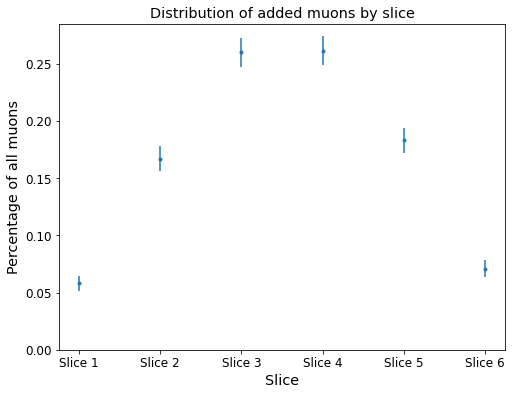

In [98]:
part = allhist/np.sum(allhist)
err = eff_bayes_binomial_std(allhist/3,np.sum(allhist)/3)#/np.sum(allhist)
plt.figure(figsize = (8, 6))
val = plt.errorbar(np.linspace(1,6,6), allhist/np.sum(allhist), yerr = err, label = "Muons", fmt = ".")
plt.title("Distribution of added muons by slice",fontsize='x-large')
plt.xlabel("Slice",fontsize='x-large')
plt.ylabel("Percentage of all muons",fontsize='x-large')
plt.xticks(np.linspace(1,6,6),["Slice 1", "Slice 2", "Slice 3", "Slice 4", "Slice 5", "Slice 6"], fontsize='large')
plt.yticks(fontsize = 'large')
plt.ylim(0)

plt.show()

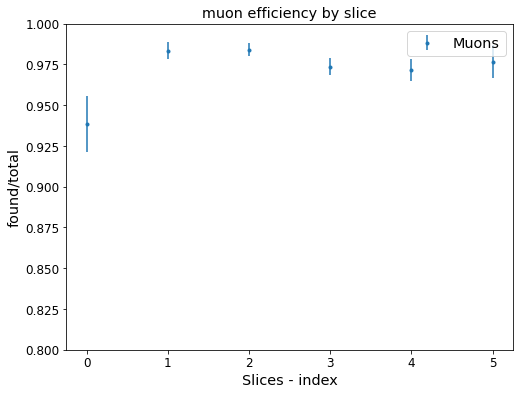

In [96]:
errnew = eff_bayes_binomial_std(foundhist,allhist)
plt.figure(figsize = (8, 6))
val = plt.errorbar(np.linspace(0,5,6), foundhist/allhist, yerr = errnew, label = "Muons", fmt = ".")
plt.legend(fontsize='x-large')
plt.title("muon efficiency by slice",fontsize='x-large')
plt.xlabel("Slices - index",fontsize='x-large')
plt.ylabel("found/total",fontsize='x-large')
plt.xticks(fontsize = 'large')
plt.yticks(fontsize = 'large')
plt.ylim(0.8,1)
plt.show()

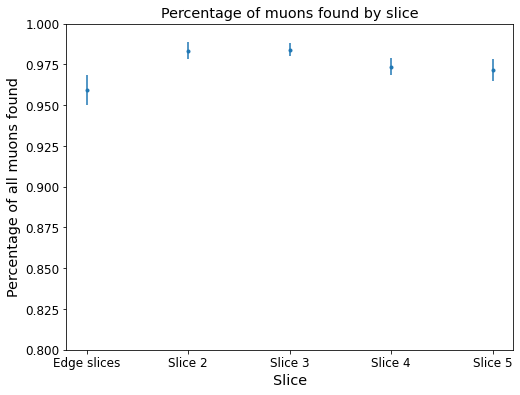

In [97]:
errnew = eff_bayes_binomial_std(foundhist2,allhist2)
plt.figure(figsize = (8, 6))
val = plt.errorbar(np.linspace(1,5,5), foundhist2/allhist2, yerr = errnew, label = "Found muons", fmt = ".")
plt.ylim(0.8,1)
plt.title("Percentage of muons found by slice",fontsize='x-large')
plt.xlabel("Slice",fontsize='x-large')
plt.ylabel("Percentage of all muons found",fontsize='x-large')
plt.yticks(fontsize = 'large')
plt.xticks(np.linspace(1,5,5),["Edge slices", "Slice 2", "Slice 3", "Slice 4", "Slice 5"],fontsize='large')
plt.show()

# Score distributions <a name='Score' /> 
<a href=#Links>Home</a>

In [ ]:
#finding thresholts FOR 3x3 MAXFINDINGMETHOD
validptestlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
maxprobs = torch.tensor([[]])
probslist = []
neventscurrent = 0
bin_edges = torch.arange(0, 0.6+0.0000001, 0.6/1000) #making histogram
bin_mids = bin_edges[:-1] + (bin_edges[1] - bin_edges[0])/2
good_hist = np.zeros_like(bin_mids) #Best signal bin
bad_hist = np.zeros_like(bin_mids) #Background
valid_bad_hist = np.zeros_like(bin_mids) #Background with at least 6 hit layers
units = 4


for i in range(10*nvalidptestmax):
                         
    batches, validptestlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, validptestlists[0], validptestlists[1], i)
    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    LoneMuonimage = LoneMuonimage
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage + LoneMuonimage).cuda()
    
    truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage))
    
    if len(truthpoint) > 0:
        truthpoint[:,0] += startingevent #adding to the eventnumber
        iphi0 = (truthpoint[:,3]+1/2).astype(int)
        iqOpT = (truthpoint[:,2]+1/2).astype(int)
        truthslices = truthpoint[:,:2] #Hit events and slices
        
    else:
        iphi0 = torch.tensor([])
        iqOpT = torch.tensor([])
        truthslices = np.empty((0,2))
    
    startingevent += image.shape[0]
    print(i,10*nvalidptestmax)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage
        fullMBimage = MinBiasimage
        fulltruthslices = truthslices
        fulliphi0 = iphi0
        fulliqOpT = iqOpT
    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
        fullMBimage = torch.cat((fullMBimage, MinBiasimage), 0)
        if len(truthpoint) > 0:
            fulltruthslices = np.row_stack((fulltruthslices, truthslices))
            fulliphi0 = np.append(fulliphi0, iphi0)
            fulliqOpT = np.append(fulliqOpT, iqOpT)
        
    fulltruth = np.column_stack((fulltruthslices, fulliqOpT, fulliphi0))
    muonimage = fullmuonimage.view(-1, nusedSl, nbinsQOpT, nbinsphi0)
    
    fullsummed = fullimage.cpu().detach().gt(0)
    fullsummed = torch.sum(fullsummed,2)
    
    
    if (i + 1) % units == 0:
        print("evaluating")
        startingevent = 0
        output, points = model(fullimage)
        output = output.detach()
        points = points.detach()
        
        MBoutput, MBpoints = model(fullMBimage.cuda())
        MBoutput = MBoutput.detach()
        MBpoints = MBpoints.detach()
        summedMBimage = torch.sum(fullMBimage.gt(0), 2)

                        
        curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(fullimage),nusedSl,nbinsQOpT,nbinsphi0))
        curprobs = curprobs.to_dense()[:,:,1:-1,1:-1]
        
        curMBprobs = torch.sparse_coo_tensor(MBpoints.permute(1,0), MBoutput, (len(fullimage),nusedSl,nbinsQOpT,nbinsphi0))
        curMBprobs = curMBprobs.to_dense()[:,:,1:-1,1:-1]

        
        muonimage = muonimage.reshape(-1,nusedSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        padcurprobs = torch.zeros((curprobs.shape[0], curprobs.shape[1] + 2, curprobs.shape[2] + 2, curprobs.shape[3] + 2)).cuda()
        padcurprobs[:,1:-1,1:-1,1:-1] = curprobs
        peakprobpoints = torch.ones_like(curprobs).bool().cuda()
        
        padcurMBprobs = torch.zeros((curMBprobs.shape[0], curMBprobs.shape[1] + 2, curMBprobs.shape[2] + 2, curMBprobs.shape[3] + 2)).cuda()
        padcurMBprobs[:,1:-1,1:-1,1:-1] = curMBprobs
        peakMBprobpoints = torch.ones_like(curMBprobs).bool().cuda()
        
        for iq in range(-1,2):
            for ip in range(-1,2):
                if (iq != 0 or ip != 0):
                    peakprobpoints *= curprobs.ge(padcurprobs[:, 1: nusedSl+1, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    peakMBprobpoints *= curMBprobs.ge(padcurMBprobs[:, 1: nusedSl+1, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
        
        peakprobs = torch.zeros_like(curprobs).cuda()
        peakprobs[peakprobpoints] = curprobs[peakprobpoints]
        
        peakMBprobs = torch.zeros_like(curMBprobs).cuda()
        peakMBprobs[peakMBprobpoints] = curMBprobs[peakMBprobpoints]
        
        validMB = torch.masked_select(peakMBprobs, summedMBimage[:,:,1:-1,1:-1].ge(6))
        
        bad_hist += np.histogram(peakMBprobs.detach().cpu().numpy(), bins = bin_edges)[0]
        valid_bad_hist += np.histogram(validMB.detach().cpu().numpy(), bins = bin_edges)[0]
        
        
        for ievent, event in enumerate(peakprobs):
    
            masks = muonimage[ievent].ge(6)
            
            if torch.sum(masks) > 0:
                if torch.max(muonimage[ievent]).ge(6):
                    maxprob = torch.max(torch.masked_select(peakprobs[ievent], masks))
                    good_hist += np.histogram(maxprob.item(), bins = bin_edges)[0]

                    if maxprobs.nelement() == 0:
                        maxprobs = torch.tensor([[maxprob]])

                    else:
                        maxprobs = torch.cat((maxprobs, torch.tensor([[maxprob]])), 1)

In [ ]:
good_hist_err = eff_bayes_binomial_std(good_hist,np.sum(good_hist)) #Target bin values
good_hist_err[good_hist == 0] = 0

valid_bad_hist_err = eff_bayes_binomial_std(valid_bad_hist,np.sum(valid_bad_hist))
valid_bad_hist_err[bad_hist == 0] = 0

In [ ]:
good_hist2 = np.zeros(100)
valid_bad_hist2 = np.zeros(100)
bin_mids2 = np.zeros(100)
for i in range(5):
    bin_mids2 += bin_mids[i::5].numpy()/5
    good_hist2 += good_hist[i::5]
    valid_bad_hist2 += valid_bad_hist[i::5]
    
good_hist_err2 = eff_bayes_binomial_std(good_hist2,np.sum(good_hist2))
good_hist_err2[good_hist2 == 0] = 0
valid_bad_hist_err2 = eff_bayes_binomial_std(valid_bad_hist2,np.sum(valid_bad_hist2))

In [ ]:
plt.figure(figsize = (16,12))

good_hist_norm2 = good_hist2/(np.sum(good_hist2))
valid_bad_hist_norm2 = valid_bad_hist2/(np.sum(valid_bad_hist2))
plt.bar(bin_mids2, valid_bad_hist_norm2, yerr = valid_bad_hist_err2, ecolor = 'green', alpha = 0.5, color = "green", width = 0.0055, label = "background")

plt.bar(bin_mids2, good_hist_norm2, yerr = good_hist_err2, ecolor = 'r', alpha = 0.3, color = "red", width = 0.0055, label = "signal")
plt.title("Score distributions using 2 layer model", fontsize = 28)
plt.xlabel("Score", fontsize = 24)
plt.ylabel("Counts (normalized)", fontsize = 24)
plt.yscale('log')
plt.xticks(fontsize = 16)
plt.yticks(fontsize = 16)
plt.legend(fontsize = 24)
plt.show()

In [ ]:
maxprobs
good_hist_norm = good_hist/(np.sum(good_hist))
valid_bad_hist_norm = valid_bad_hist/(np.sum(valid_bad_hist))

plt.figure(figsize = (12,8))
plt.bar(bin_mids[:30], valid_bad_hist_norm[:30], yerr = valid_bad_hist_err[:30], ecolor = 'g', width = 0.0011, alpha = 0.5, color = "green", label = "background")

plt.bar(bin_mids[:30], good_hist_norm[:30], yerr = good_hist_err[:30], ecolor = 'r', width = 0.0011, alpha = 0.3, color = "red", label = "signal")
plt.yscale('log')
plt.vlines(threshold_99p, 0, 1, colors = 'r', linestyles = 'dotted', label='99% efficiency')
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlim(0,0.0165)
plt.legend(fontsize = "xx-large")
plt.title("Score distributions using 2 layer model", fontsize = 20)
plt.xlabel("Score", fontsize = 16)
plt.ylabel("Counts (normalized)", fontsize = 16)
plt.show()

In [ ]:
summedTPar = np.zeros_like(good_hist_norm)
summedFPar = np.zeros_like(valid_bad_hist_norm)
summedTPar[0] = good_hist_norm[0]
summedFPar[0] = valid_bad_hist_norm[0]
for i in range(1,len(good_hist_norm)):
    summedTPar[i] = summedTPar[i-1] + good_hist_norm[i]
    summedFPar[i] = summedFPar[i-1] + valid_bad_hist_norm[i]
    
summedTPar = 1 - summedTPar
summedFPar = 1 - summedFPar

In [ ]:
x_list = []
y_list = []
for i in range(len(summedTPar) - 1):
    if (summedTPar[i] != summedTPar[i + 1]):
        if i<100:
            print(i)
        x_list += [summedTPar[i]]
        y_list += [summedFPar[i]]

In [ ]:
plt.figure(figsize = (12,8))
plt.vlines(0.99, 0, 1, colors = 'r', linestyles = 'dotted', label='99% efficiency')
plt.hlines(0.0493, -0.2, 1, colors = 'r', linestyles = 'dotted') #Insert corresponding number
plt.plot(x_list,y_list, label = 'False positive rate')
plt.yscale('log')

plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
plt.title("roccurve", fontsize = 24)
plt.xlabel("True positive rate", fontsize = 16)
plt.ylabel("False positive rate", fontsize = 16)
plt.legend(fontsize = "xx-large")
plt.xlim(0,1)
plt.ylim(2*10**(-6),1)
# plt.xscale('log')

# Model analaysis <a name='Model' /> 
<a href=#Links>Home</a>

Output given a threshold- insert own threshold.

In [ ]:
#plotting the model result on images for different thresholds
i = 5 #Choose an image  you like
threshold_99p, threshold_98p5p = (0.0011073995847254992, 0.0018269539577886462) #!!!!!Insert correct threshold here
threshold_3x3_99p, threshold_3x3_98p5p = (0.0010781277669593692, 0.0017882907995954156) #!!!!!Insert correct threshold here


MBbatch = get_batch(MinBiastrainstorage, Minbiastrainlist, i)
MBimage = get_images_allslices(MBbatch)
summedMBimage = torch.sum(MBimage.gt(0),2)
summedMBimagenp = summedMBimage.cpu().numpy()

LMbatch = get_batch(LoneMuontrainstorage, LoneMuontrainlist, i)
LMimage = get_images_allslices(LMbatch)
summedLMimage = torch.sum(LMimage.gt(0),2)
summedLMimagenp = summedLMimage.cpu().numpy()

totimage = (MBimage + LMimage).cuda()
summedtotimage = torch.sum(totimage.gt(0),2)
summedtotimagenp = summedtotimage.cpu().numpy()





output, points = model(totimage)

probs = torch.sparse_coo_tensor(points.permute(1,0), output-torch.min(output), (len(totimage),nSl,nbinsQOpT,nbinsphi0))
probs = probs.to_dense()
probsnp = probs.ge(threshold_99p).detach().cpu().numpy()

curprobs = probs[:,:,1:-1,1:-1]
padprobs = torch.zeros((curprobs.shape[0], curprobs.shape[1] + 2, curprobs.shape[2] + 2, curprobs.shape[3] + 2)).cuda()
padprobs[:,1:-1,1:-1,1:-1] = curprobs
peakprobpoints = torch.ones_like(curprobs).bool().cuda()

#         print(torch.sum(peakprobpoints))
for iq in range(-1,2):
    for ip in range(-1,2):
        if (iq != 0 or ip != 0):
            peakprobpoints *= curprobs.ge(padprobs[:, 1: nSl+1, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])

#         peakprobpoints *= curprobs.ge(padcurprobs[:,: nSl, 1: nbinsQOpT-1, 1: nbinsphi0-1]) * curprobs.ge(padcurprobs[:, 2:, 1: nbinsQOpT-1, 1: nbinsphi0-1])

#         print(torch.sum(peakprobpoints))

peakprobs = torch.zeros_like(curprobs).cuda()
peakprobs[peakprobpoints] = curprobs[peakprobpoints]
peakprobs = peakprobs.ge(threshold_3x3_99p)
peakprobsnp = peakprobs.detach().cpu().numpy()



Rileyimg = summedtotimage.ge(7)
Rileyimgnp = Rileyimg.cpu().numpy()

curhits = torch.sum(totimage,2).reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
curRileyprobs = summedtotimage[:,:,1:-1,1:-1]

padcurRileyprobs = torch.zeros((curRileyprobs.shape[0], curRileyprobs.shape[1], curRileyprobs.shape[2] + 2, curRileyprobs.shape[3] + 2)).cuda()
padcurRileyprobs[:,:,1:-1,1:-1] = curRileyprobs

padcurhits = torch.zeros((curhits.shape[0], curhits.shape[1], curhits.shape[2] + 2, curhits.shape[3] + 2)).cuda()
padcurhits[:,:,1:-1,1:-1] = curhits

topleft = torch.ones_like(curRileyprobs).bool().cuda()
peakRileyprobpoints0 = torch.ones_like(curRileyprobs).bool().cuda()
peakRileyprobpoints1 = torch.ones_like(curRileyprobs).bool().cuda()
peakRileyprobpoints2 = torch.ones_like(curRileyprobs).bool().cuda()
for iq in range(-1,2):
    for ip in range(-1,2):
        if (iq == -1 and ip == -1):
            rmv_top_right_tie = curRileyprobs.eq(padcurRileyprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip]) * curhits.eq(padcurhits[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])

        if (iq != 0 or ip != 0):
            #All that are high enough
            peakRileyprobpoints0 *= curRileyprobs.gt(padcurRileyprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
            #All that are not too low and have enough hits
            peakRileyprobpoints1 *= curRileyprobs.ge(padcurRileyprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip]) * curhits.gt(padcurhits[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
            #All that are not too low and don't have too few hits and don't have an equal in q-1,phi-1
            peakRileyprobpoints2 *= curRileyprobs.ge(padcurRileyprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip]) * curhits.ge(padcurhits[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])

peakRileyprobpoints2 *= (torch.ones_like(curRileyprobs).cuda() - rmv_top_right_tie.int()).bool()
peakRileyprobpoints = peakRileyprobpoints0 + peakRileyprobpoints1 + peakRileyprobpoints2

peakRileyprobs = torch.zeros_like(curRileyprobs).cuda()
peakRileyprobs[peakRileyprobpoints] = curRileyprobs[peakRileyprobpoints]
peakRileyprobs = peakRileyprobs.ge(7)
peakRileyprobsnp = peakRileyprobs.detach().cpu().numpy()


for iEv in range(2):
    for iSl in range(6):
        sufficient = summedLMimage[iEv,iSl][1:-1,1:-1].ge(6)
        sufficient = torch.nonzero(sufficient)
        
        print(iEv,iSl)
        plt.figure(figsize = (14,14))
        plt.title("Lone muon, event " + iEv + ", slice ", iSl,fontsize='xx-large')
        plt.xlabel("phi0", fontsize='x-large')
        plt.ylabel("q/pT [1/GeV]", fontsize='x-large')
        cmap = plt.cm.get_cmap('viridis', 9)
        plt.imshow(summedLMimage[iEv,iSl][1:-1,1:-1], vmax = torch.max(summedLMimage[iEv,iSl][1:-1,1:-1]), cmap = cmap)
        
        
        imagexticks = np.arange(0,nbinsphi0-1-2,(nbinsphi0-1-2)*0.9999/10)
        phimin = phi0minmid + phi0minstep*(1)
        phimax = phi0minmid + phi0minstep*(nbinsphi0-1-1)
        imagexlabels = np.arange(phimin,phimax,(phimax-phimin)*0.9999/10)
        imagexlabels = np.around(imagexlabels, decimals=3)

        imageyticks = np.arange(0,nbinsQOpT-1-2,(nbinsQOpT-1-2)*0.9999/10)
        qmin = QOpTminmid + QOpTminstep*(1)
        qmax = QOpTminmid + QOpTminstep*(nbinsQOpT-1-1)

        imageylabels = np.arange(qmin,qmax,(qmax-qmin)*0.9999/10)
        imageylabels = np.around(imageylabels, decimals=3)

        plt.xticks(imagexticks, imagexlabels, fontsize = 'x-large')
        plt.yticks(imageyticks, imageylabels, fontsize = 'x-large')

        plt.colorbar()
        plt.scatter(sufficient[:,1],sufficient[:,0],alpha=0.3,color='r')
        plt.show()
        
        
        
        plt.figure(figsize = (14,14))
        plt.title("Muon in minimum bias",fontsize='xx-large')
        plt.xlabel("phi0", fontsize='x-large')
        plt.ylabel("q/pT [1/GeV]", fontsize='x-large')
        plt.imshow(summedtotimagenp[iEv,iSl][1:-1,1:-1], vmax = torch.max(summedtotimage[iEv,iSl][1:-1,1:-1]), cmap = cmap)
        
        plt.xticks(imagexticks, imagexlabels, fontsize = 'x-large')
        plt.yticks(imageyticks, imageylabels, fontsize = 'x-large')
        plt.colorbar()
        plt.scatter(sufficient[:,1],sufficient[:,0],alpha=0.3,color='r')
        
        plt.show()
        
        
        
        plt.figure(figsize = (14,14))
        plt.title("2 layer model result",fontsize='xx-large')
#         plt.title("single layer model result",fontsize='xx-large')
        plt.xlabel("phi0", fontsize='x-large')
        plt.ylabel("q/pT [1/GeV]", fontsize='x-large')
        plt.imshow(probsnp[iEv,iSl][1:-1,1:-1], vmax = torch.max(probs[iEv,iSl][1:-1,1:-1]))
        
        plt.xticks(imagexticks, imagexlabels, fontsize = 'x-large')
        plt.yticks(imageyticks, imageylabels, fontsize = 'x-large')
        
#         plt.imshow(sufficient, cmap = plt.cm.get_cmap('seismic'), alpha = 0.4)
        plt.scatter(sufficient[:,1],sufficient[:,0],alpha=0.3,color='r')
        
        plt.show()
        
        
        
        plt.figure(figsize = (14,14))
        plt.title("2 layer model with 3x3 reduction result", fontsize='xx-large')
#         plt.title("single layer model with 3x3 reduction result", fontsize='xx-large')
        plt.xlabel("phi0", fontsize='x-large')
        plt.ylabel("q/pT [1/GeV]", fontsize='x-large')
        plt.imshow(peakprobsnp[iEv,iSl], vmax = torch.max(peakprobs[iEv,iSl]))
        
        plt.xticks(imagexticks, imagexlabels, fontsize = 'x-large')
        plt.yticks(imageyticks, imageylabels, fontsize = 'x-large')
        plt.scatter(sufficient[:,1],sufficient[:,0],alpha=0.3,color='r')
        
        plt.show()
        
        
        
        plt.figure(figsize = (14,14))
        plt.title("Current model", fontsize='xx-large')
        plt.xlabel("phi0", fontsize='x-large')
        plt.ylabel("q/pT [1/GeV]", fontsize='x-large')
        plt.imshow(Rileyimgnp[iEv,iSl][1:-1,1:-1], vmax = torch.max(Rileyimg[iEv,iSl][1:-1,1:-1]))
        
        plt.xticks(imagexticks, imagexlabels, fontsize = 'x-large')
        plt.yticks(imageyticks, imageylabels, fontsize = 'x-large')
        plt.scatter(sufficient[:,1],sufficient[:,0],alpha=0.3,color='r')
        
        plt.show()
        
        
        
        plt.figure(figsize = (14,14))
        plt.title("Current model with 3x3 reduction",fontsize='xx-large')
        plt.xlabel("phi0", fontsize='x-large')
        plt.ylabel("q/pT [1/GeV]", fontsize='x-large')
        plt.imshow(peakRileyprobsnp[iEv,iSl], vmax = torch.max(peakRileyprobs[iEv,iSl]))
        
        plt.xticks(imagexticks, imagexlabels, fontsize = 'x-large')
        plt.yticks(imageyticks, imageylabels, fontsize = 'x-large')
        plt.scatter(sufficient[:,1],sufficient[:,0],alpha=0.3,color='r')
        
        plt.show()



In [226]:

height, width, nLayers, nSlices = nbinsQOpT, nbinsphi0, nL, nSl
reduch = 1
reducw = 1

## Layers 1
chnls_in_layers = 1
conv_out_chnls_layers1 = 4 


krnl_sz_w_layers1 = 5       
strd_w_layers1 = 1       # <-- Stride
pad_w_layers1 = int((krnl_sz_w_layers1 - 1)/2)      # <-- Padding


conv_out_shp_w_layers1 = conv_dim(width, krnl_sz_w_layers1, pad_w_layers1, strd_w_layers1)


krnl_sz_h_layers1 = 3       
strd_h_layers1 = 1       # <-- Stride
pad_h_layers1 = int((krnl_sz_h_layers1 - 1)/2)      # <-- Padding

conv_out_shp_h_layers1 = conv_dim(height, krnl_sz_h_layers1, pad_h_layers1, strd_h_layers1)



# Layers 2
chnls_in_layers2 = conv_out_chnls_layers1 + 1
conv_out_chnls_layers2 = 2 


krnl_sz_w_layers2 = 5      
strd_w_layers2 = 1       # <-- Stride
pad_w_layers2 = int((krnl_sz_w_layers2 - 1)/2)      # <-- Padding


conv_out_shp_w_layers2 = conv_dim(conv_out_shp_w_layers1, krnl_sz_w_layers2, pad_w_layers2, strd_w_layers2)


krnl_sz_h_layers2 = 3      
strd_h_layers2 = 1       # <-- Stride
pad_h_layers2 = int((krnl_sz_h_layers2 - 1)/2)      # <-- Padding

conv_out_shp_h_layers2 = conv_dim(conv_out_shp_h_layers1, krnl_sz_h_layers2, pad_h_layers2, strd_h_layers2)




#I dislike BN. It will distort the lines.
class PlotNet(nn.Module):
    def __init__(self):
        super(PlotNet, self).__init__()
        
        self.dropCNN = nn.Dropout(p = 0)
        
        self.relu = nn.ReLU()
        
        self.conv_layers_1 = Conv2d(in_channels = chnls_in_layers,
                             out_channels = conv_out_chnls_layers1,
                             kernel_size = (krnl_sz_h_layers1, krnl_sz_w_layers1),
                             stride = (strd_h_layers1, strd_w_layers1),
                             padding = (pad_h_layers1,pad_w_layers1),
                             bias = True)
        
        self.conv_1_to_1 = Conv2d(in_channels = chnls_in_layers,
                             out_channels = 1,
                             kernel_size = (1, 1),
                             stride = (1, 1),
                             padding = (0, 0),
                             bias = True)

    
        self.conv_layers_2 = Conv2d(in_channels = chnls_in_layers2,
                             out_channels = conv_out_chnls_layers2,
                             kernel_size = (krnl_sz_h_layers2, krnl_sz_w_layers2),
                             stride = (strd_h_layers2, strd_w_layers2),
                             padding = (pad_h_layers2,pad_w_layers2))
    
        
        
    def forward(self, slicesUnSummed): #(slice0,...,slicen), slice = (batch,layer,w,h)

        btch_sz_cur = slicesUnSummed.size()[0] #(nsl,batch,layer,w,h)

        slices = torch.sum(slicesUnSummed.gt(0),2)
        slices = torch.true_divide(slices,8)
        
        pos_muons = slices.ge(3/4)
        pos_muons.requires_grad = False
        
        pointvals = slices[pos_muons]
        pointvals.requires_grad = False
                
        slices = slices.unsqueeze(2)
                

        imval = self.conv_1_to_1(slices.view(btch_sz_cur * nSl, 1, slices.shape[-2], slices.shape[-1]))
        
        slices = self.conv_layers_1(slices.view(btch_sz_cur * nSl, chnls_in_layers, slices.shape[-2], slices.shape[-1]))


        
        
        slices = slices.view((btch_sz_cur, nSl, conv_out_chnls_layers1, slices.size()[-2], slices.size()[-1]))
        imval = imval.view((btch_sz_cur, nSl, 1, slices.size()[-2], slices.size()[-1]))
        
        
        for i in range(conv_out_chnls_layers1):
            slices[:,:,i][pos_muons] = torch.div(slices[:,:,i][pos_muons], pointvals)
        
        slices = self.relu(torch.cat((slices,imval),2)).view(btch_sz_cur * nSl, chnls_in_layers2, slices.shape[-2], slices.shape[-1])
       
        output_list = []
        nweights = self.conv_layers_2.weight.shape[1]
#         print()
        end_conv = nn.Conv2d(1,2, (3, 5), padding = (1, 2), bias=False).cuda()
        for i in range(nweights):
            end_conv.weight = torch.nn.Parameter(self.conv_layers_2.weight[:,i].unsqueeze(1))
            cur = end_conv(slices[:,i].unsqueeze(1)).view(btch_sz_cur, nSl, conv_out_chnls_layers2, slices.shape[-2], slices.shape[-1])
            output_list += [cur]
            
        return output_list


In [ ]:
plotnet = PlotNet()
plotnet.load_state_dict(torch.load("model0507-AllSlices-FewTargets-Givenp-3x5NormedCat1x1To5Relu-3x5"))
plotnet.cuda()
plotnet.eval()

In [ ]:
# Should show the contributions from different channels

from matplotlib import cm
# out_MB, out2_MB, out3_MB, classic_MB = plotnet(MinBiasimage)
# out_tot, out2_tot, out3_tot, classic_tot = plotnet(image_tot)
# out_LM, out2_LM, out3_LM, classic_LM = plotnet(LoneMuonimage)

out_MB = plotnet(MinBiasimage)
out_tot = plotnet(image_tot)
out_LM = plotnet(LoneMuonimage)

output, points = model(image_tot)
output = output.detach()
points = points.detach()

curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(image_tot),nSl,nbinsQOpT,nbinsphi0))
curprobs = curprobs.to_dense()
# titles = ["focusing filter","Remove below filter","Remove above filter", "nothing filter", "Muon finding filter"]
titles = [" (focusing filter)", "", "", "", " (muon finding filter)"]

for i, truth in enumerate(truthpoint):
    if (i > 3) and (i < 6):
        event = int(truth[0])
        slice = int(truth[1])
        q = int(truth[2])
        p = int(truth[3])
#         print("real muon")
#         plt.xlabel("phi0")
#         plt.ylabel("q/pT [1/GeV]")
#         plt.title("Muon focal point")
#         plt.imshow(summedLM[event,slice,q-10:q+11,p-10:p+11].detach().cpu(), vmin = 0, vmax = 8)
#         plt.show()

        print("Min bias")
        plt.imshow(summedMB[event,slice,q-10:q+11,p-10:p+11].detach().cpu(), vmin = 0, vmax = 8)
        plt.show()

#         print("Total")
#         plt.imshow(summedtot[event,slice,q-10:q+11,p-10:p+11].detach().cpu(), vmin = 0, vmax = 8)
#         plt.show()
        
        cmap = cm.get_cmap('viridis', 9)
        plt.xlabel("phi0")
        plt.ylabel("q/pT [1/GeV]")
        plt.title("Muon focal point")
        plt.imshow(summedLM[event,slice,q-10:q+11,p-10:p+11].detach().cpu(), vmin = 0, vmax = 8, cmap = cmap)
        plt.colorbar()

        imagexticks = np.arange(0,21,4)
        phimin = phi0minmid + phi0minstep*(p-10)
        phimax = phi0minmid + phi0minstep*(p+11)
        phistep = (phimax - phimin)/21*4
        imagexlabels = np.arange(phimin,phimax,phistep)
        imagexlabels = np.around(imagexlabels, decimals=2)

        imageyticks = np.arange(0,21,4)
        qmin = QOpTminmid + QOpTminstep*(p-10)
        qmax = QOpTminmid + QOpTminstep*(p+11)
        qstep = (qmax - qmin)/21*4
        imageylabels = np.arange(qmin,qmax,qstep)
        imageylabels = np.around(imageylabels, decimals=2)

        plt.xticks(imagexticks, imagexlabels)
        plt.yticks(imageyticks, imageylabels)

        plt.show()

        cmap = cm.get_cmap('viridis', 9)
        plt.xlabel("phi0")
        plt.ylabel("q/pT [1/GeV]")
        plt.title("Muon focal point in minimum bias")
        plt.imshow(summedtot[event,slice,q-10:q+11,p-10:p+11].detach().cpu(), vmin = 0, vmax = 8, cmap = cmap)
        plt.colorbar()

        imagexticks = np.arange(0,21,4)
        phimin = phi0minmid + phi0minstep*(p-10)
        phimax = phi0minmid + phi0minstep*(p+11)
        phistep = (phimax - phimin)/21*4
        imagexlabels = np.arange(phimin,phimax,phistep)
        imagexlabels = np.around(imagexlabels, decimals=2)

        imageyticks = np.arange(0,21,4)
        qmin = QOpTminmid + QOpTminstep*(p-10)
        qmax = QOpTminmid + QOpTminstep*(p+11)
        qstep = (qmax - qmin)/21*4
        imageylabels = np.arange(qmin,qmax,qstep)
        imageylabels = np.around(imageylabels, decimals=2)

        plt.xticks(imagexticks, imagexlabels)
        plt.yticks(imageyticks, imageylabels)
        plt.show()

        vmin = 0
        vmax = 0
        for j in range(5):
            vmin1 = torch.min(out_tot[j][event,slice,0,q-10:q+11,p-10:p+11])
            vmax1 = torch.max(out_tot[j][event,slice,0,q-10:q+11,p-10:p+11])
            vmin = min(vmin1,vmin)
            vmax = max(vmax1,vmax)

        curimage = torch.zeros_like(out_tot[0]).detach().cpu()
        
#         curimage2 = torch.zeros_like(out2_tot[0]).detach().cpu()
#         curimage3 = torch.zeros_like(out3_tot[0]).detach().cpu()

        for j in range(5):
#             if (j != 3):
                print("Filter ", j)
#                 print("On real muon")

#                 # xRiley = np.linspace(98.6,99.0,2)
#                 # yRiley = np.array([353,353])
#                 plt.xlabel("phi0")
#                 plt.ylabel("q/pT [1/GeV]")
#                 plt.title("Output of " + titles[j])
# #                 plt.title("Intensity of \"Charged particle detection filter\"")
#                 # plt.plot(xRiley,yRiley, 'r', label = "Simple threshold 7")
# #                 plt.legend(fontsize='x-large')
# #                 plt.show()
                
# #                 plt.imshow(out_LM[j][event,slice,0,q-10:q+11,p-10:p+11].detach().cpu(), vmin = vmin, vmax = vmax)
# #                 plt.show()
#                 plt.imshow(out_LM[j][event,slice,0,q-10:q+11,p-10:p+11].detach().cpu())
    
#                 imagexticks = np.arange(0,21,4)
#                 phimin = phi0minmid + phi0minstep*(p-10)
#                 phimax = phi0minmid + phi0minstep*(p+11)
#                 phistep = (phimax - phimin)/21*4
#                 imagexlabels = np.arange(phimin,phimax,phistep)
#                 imagexlabels = np.around(imagexlabels, decimals=2)

#                 imageyticks = np.arange(0,21,4)
#                 qmin = QOpTminmid + QOpTminstep*(p-10)
#                 qmax = QOpTminmid + QOpTminstep*(p+11)
#                 qstep = (qmax - qmin)/21*4
#                 imageylabels = np.arange(qmin,qmax,qstep)
#                 imageylabels = np.around(imageylabels, decimals=2)

#                 plt.xticks(imagexticks, imagexlabels)
#                 plt.yticks(imageyticks, imageylabels)
#                 plt.show()

#                 print("On min bias")
#                 plt.xlabel("phi0")
#                 plt.ylabel("q/pT [1/GeV]")
#                 plt.title("Intensity of "  + titles[j])
#                 plt.imshow(out_MB[j][event,slice,0,q-10:q+11,p-10:p+11].detach().cpu(), vmin = vmin, vmax = vmax)
                
#                 imagexticks = np.arange(0,21,4)
#                 phimin = phi0minmid + phi0minstep*(p-10)
#                 phimax = phi0minmid + phi0minstep*(p+11)
#                 phistep = (phimax - phimin)/21*4
#                 imagexlabels = np.arange(phimin,phimax,phistep)
#                 imagexlabels = np.around(imagexlabels, decimals=2)

#                 imageyticks = np.arange(0,21,4)
#                 qmin = QOpTminmid + QOpTminstep*(p-10)
#                 qmax = QOpTminmid + QOpTminstep*(p+11)
#                 qstep = (qmax - qmin)/21*4
#                 imageylabels = np.arange(qmin,qmax,qstep)
#                 imageylabels = np.around(imageylabels, decimals=2)

#                 plt.xticks(imagexticks, imagexlabels)
#                 plt.yticks(imageyticks, imageylabels)
#                 plt.show()

#                 print("On total image")
#                 plt.imshow(out_tot[j][event,slice,0,q-10:q+11,p-10:p+11].detach().cpu(), vmin = vmin, vmax = vmax)
#                 plt.show()
                print("On total image")
                plt.xlabel("phi0")
                plt.ylabel("q/pT [1/GeV]")
                plt.title("Intensity of filter " + str(j) + titles[j] + " on total image")
                plt.imshow(out_tot[j][event,slice,0,q-10:q+11,p-10:p+11].detach().cpu())
                
                imagexticks = np.arange(0,21,4)
                phimin = phi0minmid + phi0minstep*(p-10)
                phimax = phi0minmid + phi0minstep*(p+11)
                phistep = (phimax - phimin)/21*4
                imagexlabels = np.arange(phimin,phimax,phistep)
                imagexlabels = np.around(imagexlabels, decimals=2)

                imageyticks = np.arange(0,21,4)
                qmin = QOpTminmid + QOpTminstep*(p-10)
                qmax = QOpTminmid + QOpTminstep*(p+11)
                qstep = (qmax - qmin)/21*4
                imageylabels = np.arange(qmin,qmax,qstep)
                imageylabels = np.around(imageylabels, decimals=2)

                plt.xticks(imagexticks, imagexlabels)
                plt.yticks(imageyticks, imageylabels)
                plt.show()

                curimage += out_tot[j].detach().cpu()
            
#             curimage2 += out2_tot[j].detach().cpu()
#             curimage3 += out3_tot[j].detach().cpu()

#         for j in range(5):
#             if (j != 3):
#                 print("Filter ", j)
#                 print("On real muon")
#                 plt.imshow(out_LM[j][event,slice,1,q-10:q+11,p-10:p+11].detach().cpu(), vmin = vmin, vmax = vmax)
#                 plt.show()

#                 print("On min bias")
#                 plt.imshow(out_MB[j][event,slice,1,q-10:q+11,p-10:p+11].detach().cpu(), vmin = vmin, vmax = vmax)
#                 plt.show()

#                 print("On total image")
#                 plt.imshow(out_tot[j][event,slice,1,q-10:q+11,p-10:p+11].detach().cpu(), vmin = vmin, vmax = vmax)
#                 plt.show()

#                 curimage += out_tot[j].detach().cpu()
        print("On total image")
        plt.xlabel("phi0")
        plt.ylabel("q/pT [1/GeV]")
        plt.title("Intensity of \"Focusing + muon finding\" on total image")
        plt.imshow(out_tot[0][event,slice,0,q-10:q+11,p-10:p+11].detach().cpu() + out_tot[1][event,slice,0,q-10:q+11,p-10:p+11].detach().cpu())

        imagexticks = np.arange(0,21,4)
        phimin = phi0minmid + phi0minstep*(p-10)
        phimax = phi0minmid + phi0minstep*(p+11)
        phistep = (phimax - phimin)/21*4
        imagexlabels = np.arange(phimin,phimax,phistep)
        imagexlabels = np.around(imagexlabels, decimals=2)

        imageyticks = np.arange(0,21,4)
        qmin = QOpTminmid + QOpTminstep*(p-10)
        qmax = QOpTminmid + QOpTminstep*(p+11)
        qstep = (qmax - qmin)/21*4
        imageylabels = np.arange(qmin,qmax,qstep)
        imageylabels = np.around(imageylabels, decimals=2)

        plt.xticks(imagexticks, imagexlabels)
        plt.yticks(imageyticks, imageylabels)
        plt.show()

        print("All summed:")
        plt.imshow(curimage[event,slice,0,q-10:q+11,p-10:p+11])
        plt.show()

        print("All summed:")
        plt.imshow(curimage[event,slice,1,q-10:q+11,p-10:p+11])
        plt.show()
        
        curimagesoftmax = torch.softmax(curimage,2)
        print("All summed, softmax:")
        plt.imshow(curimagesoftmax[event,slice,0,q-10:q+11,p-10:p+11])
        plt.show()
        
#         print("Curimage2:")
#         plt.imshow(curimage2[event,slice,q-10:q+11,p-10:p+11])
#         plt.show()
        
#         print("Curimage3:")
#         plt.imshow(curimage3[event,slice,q-10:q+11,p-10:p+11])
#         plt.show()
        
        print("True total")
        plt.imshow(summedtot[event,slice,q-10:q+11,p-10:p+11].detach().cpu(), vmin = 0, vmax = 8)
        plt.show()
        
#         print("Real model result")
#         plt.imshow(classic_tot[event,slice,q-10:q+11,p-10:p+11].detach().cpu())
#         plt.show()
        
        print("Real model result")
        plt.xlabel("phi0")
        plt.ylabel("q/pT [1/GeV]")
        plt.title("Model probability on total image")
        plt.imshow(curprobs[event,slice,q-10:q+11,p-10:p+11].detach().cpu())
        
        imagexticks = np.arange(0,21,4)
        phimin = phi0minmid + phi0minstep*(p-10)
        phimax = phi0minmid + phi0minstep*(p+11)
        phistep = (phimax - phimin)/21*4
        imagexlabels = np.arange(phimin,phimax,phistep)
        imagexlabels = np.around(imagexlabels, decimals=2)

        imageyticks = np.arange(0,21,4)
        qmin = QOpTminmid + QOpTminstep*(p-10)
        qmax = QOpTminmid + QOpTminstep*(p+11)
        qstep = (qmax - qmin)/21*4
        imageylabels = np.arange(qmin,qmax,qstep)
        imageylabels = np.around(imageylabels, decimals=2)

        plt.xticks(imagexticks, imagexlabels)
        plt.yticks(imageyticks, imageylabels)
        
        plt.colorbar()
        plt.show()

In [216]:
#I tihnk this is the same, just adding the contributions
height, width, nLayers, nSlices = nbinsQOpT, nbinsphi0, nL, nSl
reduch = 1
reducw = 1

## Layers 1
chnls_in_layers = 1
conv_out_chnls_layers1 = 4 


krnl_sz_w_layers1 = 5      
strd_w_layers1 = 1       # <-- Stride
pad_w_layers1 = int((krnl_sz_w_layers1 - 1)/2)      # <-- Padding


conv_out_shp_w_layers1 = conv_dim(width, krnl_sz_w_layers1, pad_w_layers1, strd_w_layers1)


krnl_sz_h_layers1 = 3     
strd_h_layers1 = 1       # <-- Stride
pad_h_layers1 = int((krnl_sz_h_layers1 - 1)/2)      # <-- Padding

conv_out_shp_h_layers1 = conv_dim(height, krnl_sz_h_layers1, pad_h_layers1, strd_h_layers1)



# Layers 2
chnls_in_layers2 = conv_out_chnls_layers1 + 1
conv_out_chnls_layers2 = 2 


krnl_sz_w_layers2 = 5       
strd_w_layers2 = 1       # <-- Stride
pad_w_layers2 = int((krnl_sz_w_layers2 - 1)/2)      # <-- Padding


conv_out_shp_w_layers2 = conv_dim(conv_out_shp_w_layers1, krnl_sz_w_layers2, pad_w_layers2, strd_w_layers2)


krnl_sz_h_layers2 = 3    
strd_h_layers2 = 1       # <-- Stride
pad_h_layers2 = int((krnl_sz_h_layers2 - 1)/2)      # <-- Padding

conv_out_shp_h_layers2 = conv_dim(conv_out_shp_h_layers1, krnl_sz_h_layers2, pad_h_layers2, strd_h_layers2)




#I dislike BN. It will distort the lines.
class PlotNet(nn.Module):
    def __init__(self):
        super(PlotNet, self).__init__()
        
        self.dropCNN = nn.Dropout(p = 0)
        
        self.relu = nn.ReLU()
        
        self.conv_layers_1 = Conv2d(in_channels = chnls_in_layers,
                             out_channels = conv_out_chnls_layers1,
                             kernel_size = (krnl_sz_h_layers1, krnl_sz_w_layers1),
                             stride = (strd_h_layers1, strd_w_layers1),
                             padding = (pad_h_layers1,pad_w_layers1),
                             bias = True)
        
        self.conv_1_to_1 = Conv2d(in_channels = chnls_in_layers,
                             out_channels = 1,
                             kernel_size = (1, 1),
                             stride = (1, 1),
                             padding = (0, 0),
                             bias = True)

    
        self.conv_layers_2 = Conv2d(in_channels = chnls_in_layers2,
                             out_channels = conv_out_chnls_layers2,
                             kernel_size = (krnl_sz_h_layers2, krnl_sz_w_layers2),
                             stride = (strd_h_layers2, strd_w_layers2),
                             padding = (pad_h_layers2,pad_w_layers2))
    
        
        
    def forward(self, slicesUnSummed): #(slice0,...,slicen), slice = (batch,layer,w,h)

        btch_sz_cur = slicesUnSummed.size()[0] #(nsl,batch,layer,w,h)

        slices = torch.sum(slicesUnSummed.gt(0),2)
        slices = torch.true_divide(slices,8)
        
        pos_muons = slices.ge(3/4)
        pos_muons.requires_grad = False
        
        pointvals = slices[pos_muons]
        pointvals.requires_grad = False
                
        slices = slices.unsqueeze(2)
                

        imval = self.conv_1_to_1(slices.view(btch_sz_cur * nSl, 1, slices.shape[-2], slices.shape[-1]))
        
        slices = self.conv_layers_1(slices.view(btch_sz_cur * nSl, chnls_in_layers, slices.shape[-2], slices.shape[-1]))


        
        
        slices = slices.view((btch_sz_cur, nSl, conv_out_chnls_layers1, slices.size()[-2], slices.size()[-1]))
        imval = imval.view((btch_sz_cur, nSl, 1, slices.size()[-2], slices.size()[-1]))
        
        
        for i in range(conv_out_chnls_layers1):
            slices[:,:,i][pos_muons] = torch.div(slices[:,:,i][pos_muons], pointvals)
        
        slices = self.relu(torch.cat((slices,imval),2)).view(btch_sz_cur * nSl, chnls_in_layers2, slices.shape[-2], slices.shape[-1])
       
        output_list = []
        output_list2 = []
        output_list3 = []
        nweights = self.conv_layers_2.weight.shape[1]
#         print()
        end_conv = nn.Conv2d(1,2, (3, 5), padding = (1, 2), bias=False).cuda()
        for i in range(nweights):
            end_conv.weight = torch.nn.Parameter(self.conv_layers_2.weight[:,i].unsqueeze(1))
            cur = end_conv(slices[:,i].unsqueeze(1)).view(btch_sz_cur, nSl, conv_out_chnls_layers2, slices.shape[-2], slices.shape[-1])
#             output_list += [cur]
            
            cur2 = cur[:,:,0][pos_muons]
            indices = torch.nonzero(pos_muons).cpu()
            cur2 = torch.sparse_coo_tensor(indices.permute(1,0), cur2, (btch_sz_cur,nSl,nbinsQOpT,nbinsphi0))
            cur2 = cur2.to_dense()

            output_list2 += [cur2]
            
            cur3 = cur[:,:,1][pos_muons]
            indices = torch.nonzero(pos_muons).cpu()
            cur3 = torch.sparse_coo_tensor(indices.permute(1,0), cur3, (btch_sz_cur,nSl,nbinsQOpT,nbinsphi0))
            cur3 = cur3.to_dense()
            
            output_list3 += [cur3]
            
        
        altprob = torch.zeros((btch_sz_cur, nSl, conv_out_chnls_layers2, slices.shape[-2], slices.shape[-1])).cuda()
        altprob[:,:,0] += self.conv_layers_2.bias[0]
        altprob[:,:,1] += self.conv_layers_2.bias[1]
        for i in range(len(output_list2)):
            altprob[:, :, 0] += output_list2[i]
            altprob[:, :, 1] += output_list3[i]
            
        altprob = torch.softmax(altprob,2)
        altprob = altprob[:,:,0][pos_muons] #Only keeping probs
        indices = torch.nonzero(pos_muons).cpu()
        altprob = torch.sparse_coo_tensor(indices.permute(1,0), altprob, (btch_sz_cur,nSl,nbinsQOpT,nbinsphi0))
        altprob = altprob.to_dense()
#         classic = self.conv_layers_2(slices).view(btch_sz_cur, nSl, conv_out_chnls_layers2, slices.shape[-2], slices.shape[-1])
#         classic = classic[:,:,0][pos_muons]
#         indices = torch.nonzero(pos_muons).cpu()
#         classic = torch.sparse_coo_tensor(indices.permute(1,0), classic, (len(slices),nSl,nbinsQOpT,nbinsphi0))
#         classic = classic.to_dense()
                                                
                                                  
    
#         prob = prob[:,:,0][pos_muons] #Only keeping probs
#         indices = torch.nonzero(pos_muons).cpu()
        prob = self.conv_layers_2(slices.view(btch_sz_cur * nSl, chnls_in_layers2, slices.shape[-2], slices.shape[-1]))
#         #Instead of simply doing this conv we want all the convolution results seperately. This way
#         #We can see what each convolution puts emphasis on.
        
        prob = prob.view((btch_sz_cur, nSl, 2, slices.size()[-2], slices.size()[-1]))
        prob = torch.softmax(prob, 2) #Making it a 2 channeled image where each is evaluated independently
        
        prob = prob[:,:,0][pos_muons] #Only keeping probs
        indices = torch.nonzero(pos_muons).cpu()
        prob = torch.sparse_coo_tensor(indices.permute(1,0), prob, (btch_sz_cur,nSl,nbinsQOpT,nbinsphi0))
        prob = prob.to_dense()
        
        
        return prob, altprob


In [227]:
plotnet = PlotNet()
plotnet.load_state_dict(torch.load("model0507-AllSlices-FewTargets-Givenp-3x5NormedCat1x1To5Relu-3x5"))
plotnet.cuda()
plotnet.eval()

PlotNet(
  (dropCNN): Dropout(p=0, inplace=False)
  (relu): ReLU()
  (conv_layers_1): Conv2d(1, 4, kernel_size=(3, 5), stride=(1, 1), padding=(1, 2))
  (conv_1_to_1): Conv2d(1, 1, kernel_size=(1, 1), stride=(1, 1))
  (conv_layers_2): Conv2d(5, 2, kernel_size=(3, 5), stride=(1, 1), padding=(1, 2))
)

In [ ]:
model = Net()
model.load_state_dict(torch.load("model0807-AllSlices-sec"))
model.cuda()
model.eval()

In [ ]:
testlists = (Minbiastestlist, LoneMuontestlist)
batches, testlists = get_batch_shuffle_tv(MinBiasteststorage, LoneMuonteststorage, testlists[0], testlists[1], 1)
pdMinBiasimage = batches[0]
pdLoneMuonimage = batches[1]
LoneMuonimage = get_images_allslices(pdLoneMuonimage).cuda()
MinBiasimage = get_images_allslices(pdMinBiasimage).cuda()
image_tot = LoneMuonimage + MinBiasimage

summedLM = torch.sum(LoneMuonimage.gt(0),2)
summedMB = torch.sum(MinBiasimage.gt(0),2)
summedtot = torch.sum(image_tot.gt(0),2)

truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage))

prob2, prob3 = plotnet(image_tot)

output, points = model(image_tot)
output = output.detach()
points = points.detach()

curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(image_tot),nSl,nbinsQOpT,nbinsphi0))
curprobs = curprobs.to_dense()

for i, truth in enumerate(truthpoint):
    if i < 1:
        event = int(truth[0])
        slice = int(truth[1])
        q = int(truth[2])
        p = int(truth[3])
        print("Real model result")
        plt.imshow(curprobs[event,slice,q-10:q+11,p-10:p+11].detach().cpu())
        plt.show()
        
        print("remade")
        plt.imshow(prob2[event,slice,q-10:q+11,p-10:p+11].detach().cpu())
        plt.show() 
        
        print("remade by summing contributions")
        plt.imshow(prob3[event,slice,q-10:q+11,p-10:p+11].detach().cpu())
        plt.show() 

In [251]:
testlists = (Minbiastestlist, LoneMuontestlist)
batches, testlists = get_batch_Deterministic_shuffle(MinBiasteststorage, LoneMuonteststorage, testlists[0], testlists[1], 0)
pdMinBiasimage = batches[0]
pdLoneMuonimage = batches[1]
LoneMuonimage = get_images_allslices(pdLoneMuonimage).cuda()
MinBiasimage = get_images_allslices(pdMinBiasimage).cuda()
image_tot = LoneMuonimage + MinBiasimage

summedLM = torch.sum(LoneMuonimage.gt(0),2)
summedMB = torch.sum(MinBiasimage.gt(0),2)
summedtot = torch.sum(image_tot.gt(0),2)

truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage))

In [ ]:
phi0minstep = (phi0max0-phi0min0)/216
phi0minmin = phi0min0 - 6*phi0minstep
phi0minmid = phi0minmin + 0.5*phi0minstep

In [ ]:
testtensor = torch.zeros((5,9))
nevents = 0

for j in range(20):
    print(j)
    testlists = (Minbiastestlist, LoneMuontestlist)
    batches, testlists = get_batch_shuffle_tv(MinBiasteststorage, LoneMuonteststorage, testlists[0], testlists[1], j)
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage).cuda()
    MinBiasimage = get_images_allslices(pdMinBiasimage).cuda()
    image_tot = LoneMuonimage + MinBiasimage

    summedLM = torch.sum(LoneMuonimage.gt(0),2)
    summedMB = torch.sum(MinBiasimage.gt(0),2)
    summedtot = torch.sum(image_tot.gt(0),2)

    truthpoint = np.array(truth_func_lonemuon(pdLoneMuonimage))

    output, points = model(image_tot.clone())
    output = output.detach()
    points = points.detach()

    curprobs = torch.sparse_coo_tensor(points.permute(1,0), output, (len(image_tot),nSl,nbinsQOpT,nbinsphi0))
    curprobs = curprobs.to_dense().detach().cpu()


    for i, truth in enumerate(truthpoint):
    #     if i < 1:
            nevents += 1
            event = int(truth[0])
            slice = int(truth[1])
            q = int(truth[2])
            p = int(truth[3])

            print(curprobs[event,slice,q-2:q+3,p-2:p+3])

            for dq in range(-2,3):
                for dp in range(-4,5):

                    image_tot1 = image_tot.clone()
                    image_tot1[event,slice,:,q+dq,p+dp] = 0

                    output1, points1 = model(image_tot1)
                    output1 = output1.detach()
                    points1 = points1.detach()

                    curprobs1 = torch.sparse_coo_tensor(points1.permute(1,0), output1, (len(image_tot),nSl,nbinsQOpT,nbinsphi0))
                    curprobs1 = curprobs1.to_dense().detach().cpu()

                    testtensor[dq + 2, dp + 4] += curprobs[event,slice,q,p] - curprobs1[event,slice,q,p]

        

In [ ]:
print("Real model result")
plt.xlabel("phi0")
plt.ylabel("q/pT [1/GeV]")
plt.title("Effect of removing bin")

p1 = nbinsphi0/2 - 0.5
q1 = nbinsQOpT/2 - 0.5

imagexticks = np.arange(0,9,2)
phimin = phi0minmid + phi0minstep*(p1-4)
phimax = phi0minmid + phi0minstep*(p1+5)
phistep = (phimax - phimin)/9*2
imagexlabels = np.arange(phimin,phimax,phistep)
imagexlabels = np.around(imagexlabels, decimals=3)

imageyticks = np.arange(0,5,2)
qmin = QOpTminmid + QOpTminstep*(q1-2)
qmax = QOpTminmid + QOpTminstep*(q1+3)
qstep = (qmax - qmin)/5*2
imageylabels = np.arange(qmin,qmax,qstep)
imageylabels = np.around(imageylabels, decimals=3)

plt.xticks(imagexticks, imagexlabels)
plt.yticks(imageyticks, imageylabels)
plt.imshow(testtensor/nevents)
plt.colorbar()

# Rileys method <a name='Rileys' /> 
<a href=#Links>Home</a>

Rileys method for comparison

In [108]:
#With 3x3 maxing
#Evaluating with muon - Rileys 3x3 Maxfinding Method
thresholt_7 = 7
thresholt_8 = 8
testlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
nroads_7 = 0
nroads_8 = 0
ntot = 0
nevents = 0
nfound7 = 0
nfound8 = 0
nabovebound = 0

for i in range(3*nvalidptestmax):
    batches, testlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, testlists[0], testlists[1], i)
    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage + LoneMuonimage).cuda()

    startingevent += image.shape[0]
    print(i,3*nvalidptestmax)
    
    if i % units == 0:
#         fulltruthimage = truthimage
        fullimage = image
        fullmuonimage = summedimage

    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
    
    if (i + 1) % units == 0:
        print("evaluating")
        startingevent = 0
        curhits = torch.sum(fullimage,2).reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        curprobs = torch.sum(fullimage.gt(0),2).reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        masks = fullmuonimage.ge(6)[:,:,1:-1,1:-1]
        
        padcurprobs = torch.zeros((curprobs.shape[0], curprobs.shape[1], curprobs.shape[2] + 2, curprobs.shape[3] + 2)).cuda()
        padcurprobs[:,:,1:-1,1:-1] = curprobs
        
        padcurhits = torch.zeros((curhits.shape[0], curhits.shape[1], curhits.shape[2] + 2, curhits.shape[3] + 2)).cuda()
        padcurhits[:,:,1:-1,1:-1] = curhits
        
        topleft = torch.ones_like(curprobs).bool().cuda()
        peakprobpoints0 = torch.ones_like(curprobs).bool().cuda()
        peakprobpoints1 = torch.ones_like(curprobs).bool().cuda()
        peakprobpoints2 = torch.ones_like(curprobs).bool().cuda()
        for iq in range(-1,2):
            for ip in range(-1,2):
                if (iq == -1 and ip == -1):
                    rmv_top_right_tie = curprobs.eq(padcurprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip]) * curhits.eq(padcurhits[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    
                if (iq != 0 or ip != 0):
                    #All that are high enough
                    peakprobpoints0 *= curprobs.gt(padcurprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    #All that are not too low and have enough hits
                    peakprobpoints1 *= curprobs.ge(padcurprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip]) * curhits.gt(padcurhits[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    #All that are not too low and don't have too few hits and don't have an equal in q-1,phi-1
                    peakprobpoints2 *= curprobs.ge(padcurprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip]) * curhits.ge(padcurhits[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
          
        peakprobpoints2 *= (torch.ones_like(curprobs).cuda() - rmv_top_right_tie.int()).bool()
        peakprobpoints = peakprobpoints0 + peakprobpoints1 + peakprobpoints2
        
        peakprobs = torch.zeros_like(curprobs).cuda()
        peakprobs[peakprobpoints] = curprobs[peakprobpoints]
        
        for j, event in enumerate(peakprobs):
            
            if torch.max(fullmuonimage[j].ge(6)):
                
                if torch.sum(torch.masked_select(event, masks[j]).ge(7)).item() > 0:
                    nfound7 += 1
                if torch.sum(torch.masked_select(event, masks[j]).ge(8)).item() > 0:
                    nfound8 += 1
                
                nabovebound += 1
        nroads_7 += torch.sum(peakprobs.ge(thresholt_7))
        nroads_8 += torch.sum(peakprobs.ge(thresholt_8))
        ntot += torch.numel(curprobs)
        nevents += curprobs.shape[0]
print("Found roads 7:")
print(nroads_7.item()/nevents)
print("Efficiency 7:")
print(nfound7/nabovebound)

print("Found roads 8:")
print(nroads_8.item()/nevents)
print("Efficiency 8:")
print(nfound8/nabovebound)

0 474
1 474
2 474
3 474
4 474
5 474
6 474
evaluating
7 474
8 474
9 474
10 474
11 474
12 474
13 474
evaluating
14 474
15 474
16 474
17 474
18 474
19 474
20 474
evaluating
21 474
22 474
23 474
24 474
25 474
26 474
27 474
evaluating
28 474
29 474
30 474
31 474
32 474
33 474
34 474
evaluating
35 474
36 474
37 474
38 474
39 474
40 474
41 474
evaluating
42 474
43 474
44 474
45 474
46 474
47 474
48 474
evaluating
49 474
50 474
51 474
52 474
53 474
54 474
55 474
evaluating
56 474
57 474
58 474
59 474
60 474
61 474
62 474
evaluating
63 474
64 474
65 474
66 474
67 474
68 474
69 474
evaluating
70 474
71 474
72 474
73 474
74 474
75 474
76 474
evaluating
77 474
78 474
79 474
80 474
81 474
82 474
83 474
evaluating
84 474
85 474
86 474
87 474
88 474
89 474
90 474
evaluating
91 474
92 474
93 474
94 474
95 474
96 474
97 474
evaluating
98 474
99 474
100 474
101 474
102 474
103 474
104 474
evaluating
105 474
106 474
107 474
108 474
109 474
110 474
111 474
evaluating
112 474
113 474
114 474
115 474
116 47

In [109]:
#Evaluating without muon - Rileys
thresholt_7 = 7
thresholt_8 = 8
testlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
nroads_7 = 0
nroads_8 = 0
ntot = 0
nevents = 0

for i in range(1*nMinbiasvalidptestlist):
    batches, testlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, testlists[0], testlists[1], i)
    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage).cuda()

    startingevent += image.shape[0]
    print(i,1*nMinbiasvalidptestlist)
    
    if i % units == 0:
#         fulltruthimage = truthimage
        fullimage = image
        fullmuonimage = summedimage

    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
    
    if (i + 1) % units == 0:
        print("evaluating")
        startingevent = 0
        curhits = torch.sum(fullimage,2).reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        curprobs = torch.sum(fullimage.gt(0),2)[:,:,1:-1,1:-1]
        
        padcurprobs = torch.zeros((curprobs.shape[0], curprobs.shape[1], curprobs.shape[2] + 2, curprobs.shape[3] + 2)).cuda()
        padcurprobs[:,:,1:-1,1:-1] = curprobs
        
        padcurhits = torch.zeros((curhits.shape[0], curhits.shape[1], curhits.shape[2] + 2, curhits.shape[3] + 2)).cuda()
        padcurhits[:,:,1:-1,1:-1] = curhits
        
        topleft = torch.ones_like(curprobs).bool().cuda()
        peakprobpoints0 = torch.ones_like(curprobs).bool().cuda()
        peakprobpoints1 = torch.ones_like(curprobs).bool().cuda()
        peakprobpoints2 = torch.ones_like(curprobs).bool().cuda()
        for iq in range(-1,2):
            for ip in range(-1,2):
                if (iq == -1 and ip == -1):
                    rmv_top_right_tie = curprobs.eq(padcurprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip]) * curhits.eq(padcurhits[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    
                if (iq != 0 or ip != 0):
                    #All that are high enough
                    peakprobpoints0 *= curprobs.gt(padcurprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    #All that are not too low and have enough hits
                    peakprobpoints1 *= curprobs.ge(padcurprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip]) * curhits.gt(padcurhits[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
                    #All that are not too low and don't have too few hits and don't have an equal in q-1,phi-1
                    peakprobpoints2 *= curprobs.ge(padcurprobs[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip]) * curhits.ge(padcurhits[:,:, 1 + iq: nbinsQOpT-1 + iq,1 + ip: nbinsphi0-1 + ip])
          
        peakprobpoints2 *= (torch.ones_like(curprobs).cuda() - rmv_top_right_tie.int()).bool()
        peakprobpoints = peakprobpoints0 + peakprobpoints1 + peakprobpoints2
        
        peakprobs = torch.zeros_like(curprobs).cuda()
        peakprobs[peakprobpoints] = curprobs[peakprobpoints]
        
        nroads_7 += torch.sum(peakprobs.ge(thresholt_7))
        nroads_8 += torch.sum(peakprobs.ge(thresholt_8))
        ntot += torch.numel(curprobs)
        nevents += curprobs.shape[0]

print(nroads_7.item()/nevents)
print(nroads_8.item()/nevents)

0 59
1 59
2 59
3 59
4 59
5 59
6 59
evaluating
7 59
8 59
9 59
10 59
11 59
12 59
13 59
evaluating
14 59
15 59
16 59
17 59
18 59
19 59
20 59
evaluating
21 59
22 59
23 59
24 59
25 59
26 59
27 59
evaluating
28 59
29 59
30 59
31 59
32 59
33 59
34 59
evaluating
35 59
36 59
37 59
38 59
39 59
40 59
41 59
evaluating
42 59
43 59
44 59
45 59
46 59
47 59
48 59
evaluating
49 59
50 59
51 59
52 59
53 59
54 59
55 59
evaluating
56 59
57 59
58 59
216.34553775743706
22.466819221967963


In [112]:
#Classic method
#Evaluating without muon - Rileys
thresholt_7 = 7
thresholt_8 = 8
testlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
nroads_7 = 0
nroads_8 = 0
ntot = 0
nevents = 0

for i in range(1*nMinbiasvalidptestlist):
    batches, testlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, testlists[0], testlists[1], i)
     
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage).cuda()

    startingevent += image.shape[0]
    print(i,1*nMinbiasvalidptestlist)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage

    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
    
    if (i + 1) % units == 0:
        print("evaluating")
        startingevent = 0
        curprobs = torch.sum(fullimage.gt(0),2)[:,:,1:-1,1:-1]
        nroads_7 += torch.sum(curprobs.ge(thresholt_7))
        nroads_8 += torch.sum(curprobs.ge(thresholt_8))
        ntot += torch.numel(curprobs)
        nevents += curprobs.shape[0]

print(nroads_7.item()/nevents)
print(nroads_8.item()/nevents)

0 59
1 59
2 59
3 59
4 59
5 59
6 59
evaluating
7 59
8 59
9 59
10 59
11 59
12 59
13 59
evaluating
14 59
15 59
16 59
17 59
18 59
19 59
20 59
evaluating
21 59
22 59
23 59
24 59
25 59
26 59
27 59
evaluating
28 59
29 59
30 59
31 59
32 59
33 59
34 59
evaluating
35 59
36 59
37 59
38 59
39 59
40 59
41 59
evaluating
42 59
43 59
44 59
45 59
46 59
47 59
48 59
evaluating
49 59
50 59
51 59
52 59
53 59
54 59
55 59
evaluating
56 59
57 59
58 59
348.6796338672769
32.48741418764302


In [113]:
#Evaluating with muon - Rileys
thresholt_7 = 7
thresholt_8 = 8
testlists = (Minbiasvalidptestlist.copy(), LoneMuonvalidptestlist.copy())
startingevent = 0
nroads_7 = 0
nroads_8 = 0
ntot = 0
nevents = 0
nfound7 = 0
nfound8 = 0
nabovebound = 0

for i in range(3*nvalidptestmax):
    batches, testlists = get_batch_Deterministic_shuffle(MinBiasvalidpteststorage, LoneMuonvalidpteststorage, testlists[0], testlists[1], i)
    
    pdMinBiasimage = batches[0]
    pdLoneMuonimage = batches[1]
    LoneMuonimage = get_images_allslices(pdLoneMuonimage)
    MinBiasimage = get_images_allslices(pdMinBiasimage)
    summedimage = LoneMuonimage.gt(0)
    summedimage = torch.sum(summedimage,2) #the slices along with where they are hit
    
    image = (MinBiasimage + LoneMuonimage).cuda()

    startingevent += image.shape[0]
    print(i,3*nvalidptestmax)
    
    if i % units == 0:
        fullimage = image
        fullmuonimage = summedimage

    else:
        fullimage = torch.cat((fullimage, image), 0)
        fullmuonimage = torch.cat((fullmuonimage, summedimage), 0)
    
    if (i + 1) % units == 0:
        print("evaluating")
        startingevent = 0
        curprobs = torch.sum(fullimage.gt(0),2).reshape(-1,nSl,nbinsQOpT,nbinsphi0)[:,:,1:-1,1:-1]
        masks = fullmuonimage.ge(6)[:,:,1:-1,1:-1]
        for i, event in enumerate(curprobs):
            
            if torch.max(fullmuonimage[i].ge(6)):
                
                if torch.sum(torch.masked_select(event, masks[i]).ge(7)).item() > 0:
                    nfound7 += 1
                if torch.sum(torch.masked_select(event, masks[i]).ge(8)).item() > 0:
                    nfound8 += 1
                
                nabovebound += 1

        nroads_7 += torch.sum(curprobs.ge(thresholt_7))
        nroads_8 += torch.sum(curprobs.ge(thresholt_8))
        ntot += torch.numel(curprobs)
        nevents += curprobs.shape[0]
print("Found roads 7:")
print(nroads_7.item()/nevents)
print("Efficiency 7:")
print(nfound7/nabovebound)

print("Found roads 8:")
print(nroads_8.item()/nevents)
print("Efficiency 8:")
print(nfound8/nabovebound)

0 474
1 474
2 474
3 474
4 474
5 474
6 474
evaluating
7 474
8 474
9 474
10 474
11 474
12 474
13 474
evaluating
14 474
15 474
16 474
17 474
18 474
19 474
20 474
evaluating
21 474
22 474
23 474
24 474
25 474
26 474
27 474
evaluating
28 474
29 474
30 474
31 474
32 474
33 474
34 474
evaluating
35 474
36 474
37 474
38 474
39 474
40 474
41 474
evaluating
42 474
43 474
44 474
45 474
46 474
47 474
48 474
evaluating
49 474
50 474
51 474
52 474
53 474
54 474
55 474
evaluating
56 474
57 474
58 474
59 474
60 474
61 474
62 474
evaluating
63 474
64 474
65 474
66 474
67 474
68 474
69 474
evaluating
70 474
71 474
72 474
73 474
74 474
75 474
76 474
evaluating
77 474
78 474
79 474
80 474
81 474
82 474
83 474
evaluating
84 474
85 474
86 474
87 474
88 474
89 474
90 474
evaluating
91 474
92 474
93 474
94 474
95 474
96 474
97 474
evaluating
98 474
99 474
100 474
101 474
102 474
103 474
104 474
evaluating
105 474
106 474
107 474
108 474
109 474
110 474
111 474
evaluating
112 474
113 474
114 474
115 474
116 47